# Preliminaries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time
import seaborn as sns

pd.set_option('display.max_columns', None)

In [2]:
dataset = pd.read_csv('data/df_cluster_Cao_3.csv')
# dataset.drop(columns=['Unnamed: 0'])

In [3]:
dataset = pd.read_csv('data/df_cluster_Cao_3.csv').drop(columns=['Unnamed: 0'])
dataset.loc[dataset['basicMonthlySalary'] < 100, 'basicMonthlySalary'] *= 1000
dataset
# dataset = dataset.drop('Unnamed: 0', axis=1)

# cols_to_drop = [
#     'id', 'fullName', 'firstName', 'middleName', 'lastName', 'mobileNumber',
#     'dateEntry', 'mobilePrefix', 'address', 'occupation'
# ]
cols_to_drop = [
    'id', 'fullName', 'firstName', 'lastName', 'address', 'dateEntry', 'occupation'
]

dataset = dataset.drop(cols_to_drop, axis=1)

boolean_columns = [col for col in dataset.columns if dataset[col].dtype == bool]
dataset[boolean_columns] = dataset[boolean_columns].apply(lambda x: x.astype('int64'))

columns_to_move = ['lastFirstName', 'age', 'gender', 'province', 'job']
columns_remaining = [col for col in dataset.columns if col not in columns_to_move]

new_column_order = columns_to_move + columns_remaining
dataset = dataset[new_column_order]
dataset.insert(0, 'userId', dataset.pop('userId'))

def map_ageing_class(row):
    found_in_hdmf = row['foundInHDMF']
    home_ownership_class = row['home_ownership_class']

    if home_ownership_class == 0:
        return np.nan
    elif found_in_hdmf in [' Current', 'FP', '01 mos', '02 mos', '03 mos']:
        return 0
    elif found_in_hdmf in ['04 mos', '05 mos']:
        return 1

# One-hot encoding of categorical columns
# dataset = pd.get_dummies(dataset, columns=['gender'], prefix='gender', drop_first='True')
# dataset = pd.get_dummies(dataset, columns=['province'], prefix='province')
# dataset = pd.get_dummies(dataset, columns=['job'], prefix='job')

dataset['home_ownership_class'] = ((dataset['foundInOS'] != 'False') |
                                   (dataset['foundInHDMF'] != 'False')).astype('int64')



# dataset['ageing_class'] = dataset['home_ownership_class'].astype('int64')
# dataset['ageing_class'] = dataset.apply(map_ageing_class, axis=1)

cols_to_drop = ['foundInOS', 'foundInHDMF']
dataset = dataset.drop(cols_to_drop, axis=1)

dataset = dataset[dataset['cluster'] == 2].drop(columns=['cluster'])
dataset

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
12,4772,"VILLAROZA, BLESEELYN",40,FEMALE,CAVITE,SERVICE AND SALES,30000,3,1,3,30000.0,3000,2000,1000,1500,1000,1500,2000,500,300,200,100,100,500,600,4600,500,200,200,500,100,100,50,1000,1200,100,1000,1000,1000,10,10,0,50,20,15000,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0
14,5415,"LAMOSTE, JO-ANN",36,FEMALE,BULACAN,PROFESIONAL,2534900,3,2,5,50000.0,5000,5000,5000,5000,4000,5000,2000,5000,1000,5000,10000,10000,1000,2500,4500,5000,500,5000,5000,5000,5000,2500,2500,5500,5000,5000,5000,5000,500,500,100,1,1,5000,1,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0
32,9274,"ALMUETE, CRISTEL",35,FEMALE,ILOCOS NORTE,ELEMENTARY OCCUPATION,200000,3,2,3,50000.0,2000,1000,500,1000,100,100,1500,2000,1000,1000,1000,1000,500,500,2000,1000,500,500,500,1000,500,700,500,100,100,100,100,1000,100,100,100,100,100,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0
79,10526,"PEREZ, JOHN RIGOR",26,MALE,UNKNOWN,SERVICE AND SALES,25000,1,5,3,25000.0,7000,1500,1500,400,0,0,1500,200,300,500,1235,1411,600,600,2500,0,0,0,0,500,500,500,0,0,0,0,0,0,500,300,500,200,100,500,0,1,0,1,0,1,0,1,1,1,1,0,0,1,0,0
103,10581,"DEJARME, JOAVASAN",40,MALE,BULACAN,SERVICE AND SALES,19000,3,1,9,24000.0,10000,2000,1000,1500,300,1500,200,1800,1500,500,1000,500,280,1500,3000,500,0,100,250,150,1000,600,0,2500,2000,3000,500,3000,0,0,0,500,200,5000,0,0,1,1,1,0,0,0,1,0,0,0,0,1,0,0
111,10593,"ABARICO, YENNIESER",30,MALE,METRO MANILA,CLERICAL SUPPORT,33000,3,3,5,50000.0,3500,150,100,50,30,100,100,100,100,100,3000,1500,500,2000,1500,1500,200,500,500,200,500,300,300,100,100,100,100,100,100,100,100,100,100,500,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1
114,10596,"ALERE, DINOS",40,MALE,METRO MANILA,SERVICE AND SALES,19000,1,0,0,190000.0,1,3,4,3,1,1,1,2,2,1,4,4,5,5,4500,2,6,6,6,6,6,8,2,8,8,8,8,6,9,9,9,9,9,10,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
126,10618,"CALDERON, JESSICA",29,FEMALE,CAVITE,ASSOCIATE PROFESSIONAL,80000,3,2,4,160000.0,4000,1000,500,500,100,100,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,0
134,10631,"BIEN, RICARDO JONEL",25,MALE,METRO MANILA,ASSOCIATE PROFESSIONAL,18500,2,2,2,50000.0,2000,1000,500,500,1,1,1,1,1,1,500,500,150,300,2000,500,1,1,1,500,500,300,1399,1,1,1,1,1,1,1,1,1,1,2500,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0
139,10640,"ARELLANO, MARK ANGELO",30,MALE,METRO MANILA,CRAFT AND TRADE,17000,2,1,2,17000.0,5000,1000,1000,500,500,500,500,1000,2000,500,5000,1000,500,500,2000,2000,1000,500,500,500,1000,360,100,1000,1000,1000,1000,1000,150,500,100,100,100,2000,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0


# HO_T01

In [5]:
ho_t01 = dataset.copy()
ho_t01_num = ho_t01.drop(columns=['gender', 'province', 'job'])
ho_t01

,userId,lastFirstName,age,gender,province,job,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
12,4772,"VILLAROZA, BLESEELYN",40,FEMALE,CAVITE,SERVICE AND SALES,30000,3,1,3,30000.0,3000,2000,1000,1500,1000,1500,2000,500,300,200,100,100,500,600,4600,500,200,200,500,100,100,50,1000,1200,100,1000,1000,1000,10,10,0,50,20,15000,0,0,0,0,1,0,0,0,0,0,0,0,1,1,0,0
14,5415,"LAMOSTE, JO-ANN",36,FEMALE,BULACAN,PROFESIONAL,2534900,3,2,5,50000.0,5000,5000,5000,5000,4000,5000,2000,5000,1000,5000,10000,10000,1000,2500,4500,5000,500,5000,5000,5000,5000,2500,2500,5500,5000,5000,5000,5000,500,500,100,1,1,5000,1,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0
32,9274,"ALMUETE, CRISTEL",35,FEMALE,ILOCOS NORTE,ELEMENTARY OCCUPATION,200000,3,2,3,50000.0,2000,1000,500,1000,100,100,1500,2000,1000,1000,1000,1000,500,500,2000,1000,500,500,500,1000,500,700,500,100,100,100,100,1000,100,100,100,100,100,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0
79,10526,"PEREZ, JOHN RIGOR",26,MALE,UNKNOWN,SERVICE AND SALES,25000,1,5,3,25000.0,7000,1500,1500,400,0,0,1500,200,300,500,1235,1411,600,600,2500,0,0,0,0,500,500,500,0,0,0,0,0,0,500,300,500,200,100,500,0,1,0,1,0,1,0,1,1,1,1,0,0,1,0,0
103,10581,"DEJARME, JOAVASAN",40,MALE,BULACAN,SERVICE AND SALES,19000,3,1,9,24000.0,10000,2000,1000,1500,300,1500,200,1800,1500,500,1000,500,280,1500,3000,500,0,100,250,150,1000,600,0,2500,2000,3000,500,3000,0,0,0,500,200,5000,0,0,1,1,1,0,0,0,1,0,0,0,0,1,0,0
111,10593,"ABARICO, YENNIESER",30,MALE,METRO MANILA,CLERICAL SUPPORT,33000,3,3,5,50000.0,3500,150,100,50,30,100,100,100,100,100,3000,1500,500,2000,1500,1500,200,500,500,200,500,300,300,100,100,100,100,100,100,100,100,100,100,500,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,1
114,10596,"ALERE, DINOS",40,MALE,METRO MANILA,SERVICE AND SALES,19000,1,0,0,190000.0,1,3,4,3,1,1,1,2,2,1,4,4,5,5,4500,2,6,6,6,6,6,8,2,8,8,8,8,6,9,9,9,9,9,10,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0
126,10618,"CALDERON, JESSICA",29,FEMALE,CAVITE,ASSOCIATE PROFESSIONAL,80000,3,2,4,160000.0,4000,1000,500,500,100,100,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,0
134,10631,"BIEN, RICARDO JONEL",25,MALE,METRO MANILA,ASSOCIATE PROFESSIONAL,18500,2,2,2,50000.0,2000,1000,500,500,1,1,1,1,1,1,500,500,150,300,2000,500,1,1,1,500,500,300,1399,1,1,1,1,1,1,1,1,1,1,2500,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0
139,10640,"ARELLANO, MARK ANGELO",30,MALE,METRO MANILA,CRAFT AND TRADE,17000,2,1,2,17000.0,5000,1000,1000,500,500,500,500,1000,2000,500,5000,1000,500,500,2000,2000,1000,500,500,500,1000,360,100,1000,1000,1000,1000,1000,150,500,100,100,100,2000,0,0,0,1,0,0,0,0,1,0,0,0,0,1,0,0


# Outlier Analysis

In [6]:
from sklearn.covariance import EllipticEnvelope
from sklearn.mixture import GaussianMixture
from sklearn.neighbors import LocalOutlierFactor
from sklearn.svm import OneClassSVM
from sklearn.ensemble import IsolationForest

def plot_hist_ee(df, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = EllipticEnvelope(random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel('Elliptic Envelope scores')
    plt.ylabel('Frequency')
    plt.title(f'Elliptic Envelope score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ee(df, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'Elliptic Envelope, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_gmm(df, n_components, covariance_type='full', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = GaussianMixture(n_components=n_components,
                            covariance_type=covariance_type,
                            random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_components}-component Gaussian Mixture Model scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_components}-component Gaussian Mixture Model score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_gmm(df, n_components, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_components}-component Gaussian Mixture Model, Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_lof(df, n_neighbors=20, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = LocalOutlierFactor(n_neighbors=n_neighbors)
    model.fit(scaled_data)
    
#     model_scores = model.score_samples(scaled_data)
    model_scores = model.negative_outlier_factor_
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_lof(df, n_neighbors, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_neighbors}-neighbor Local Outlier Factor (LOF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

def plot_hist_ocsvm(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_hist_ocsvm2(df, kernel='rbf', bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'ageing_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = OneClassSVM(kernel=kernel, degree=4)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{kernel}-kernel One-Class SVM (OCSVM) scores')
    plt.ylabel('Frequency')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_ocsvm(df, kernel, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{kernel}-kernel One-Class SVM (OCSVM), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

def plot_hist_if(df, n_estimators=100, bins=1_000, xlim=None):
    df_X = df.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
    df_names = df.copy()[['userId', 'lastFirstName']]
    n_samples = df.shape[0]
    
#     scaler = StandardScaler()
#     scaled_data = scaler.fit_transform(df_X)
    scaled_data = df_X

    model = IsolationForest(n_estimators=n_estimators, random_state=0)
    model.fit(scaled_data)
    
    model_scores = model.score_samples(scaled_data)
    
    plt.hist(model_scores, bins=bins)
    plt.xlabel(f'{n_estimators}-estimator Isolation Forest (IF) scores')
    plt.ylabel('Frequency')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF) score histogram')
    if xlim is not None:
        plt.xlim(xlim, 0)
    plt.show()

    return model_scores

def plot_if(df, n_estimators, scores, threshold):
    model_scores = scores

    outlier_mask = model_scores < threshold
    plt.scatter(df.iloc[outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='purple',
                label='Predicted Outliers')
    plt.scatter(df.iloc[~outlier_mask, df.columns.get_loc('basicMonthlySalary')],
                df.iloc[~outlier_mask, df.columns.get_loc('monthlyFamilyIncome')], c='yellow',
                label='Predicted Inliers')
    plt.xlabel('Basic Monthly Salary')
    plt.ylabel('Monthly Family Income')
    plt.title(f'{n_estimators}-estimator Isolation Forest (IF), Threshold = {threshold}')
    plt.legend()
    plt.show()

    df2 = df.copy()
    df2['pred_outlier'] = (model_scores.reshape(-1, 1) < threshold)

    print('Number of predicted outliers:',
          df2[df2['pred_outlier'] == True].shape[0])
    display(df2[df2['pred_outlier'] == True])

    return list(df2[df2['pred_outlier'] == True].index)

## Elliptic Envelope

In [6]:
# scores = plot_hist_ee(ho_t01_num, bins=10_000, xlim=-1e8)

In [25]:
# for i in np.arange(-1e11, 1, 2e10):
#     plot_ee(ho_t01, scores, i)

## Gaussian Mixture Model (GMM)

### 1-component GMM

In [7]:
# k = 1

# scores = plot_hist_gmm(ho_t01_num, k, covariance_type='full',
#                        bins=1_000)

In [8]:
# for i in np.arange(-600, -150, 30):
#     plot_gmm(ho_t01, k, scores, i)

## Local Outlier Factor

## One-Class SVM

## Isolation Forest

In [9]:
# k = 'rbf'

# scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
#                          bins=1_000)

# ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 360)
# print(ho_t01_outliers)

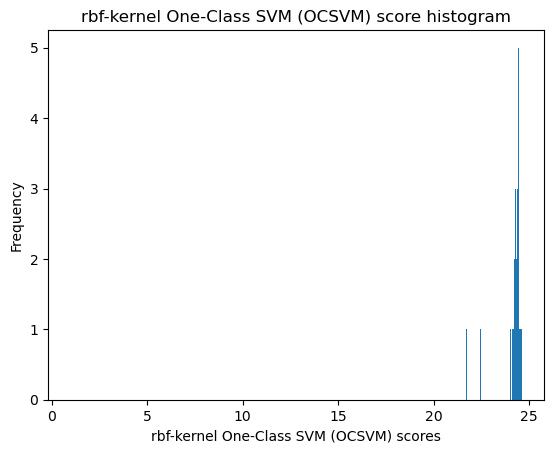

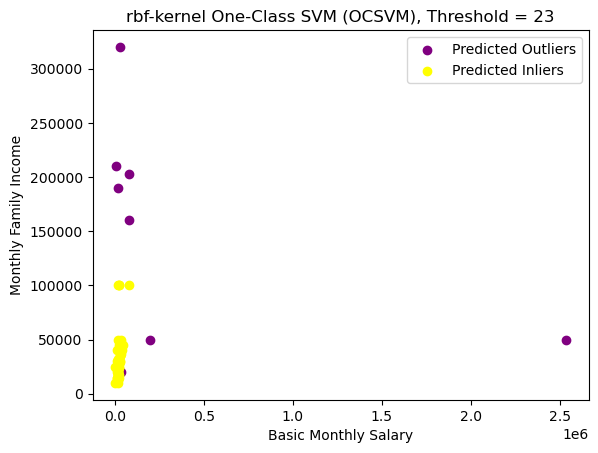

Number of predicted outliers: 8


,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanOthers,payInsurance,loanSSS,payFamilySupport,loanPagIbig,loanGSIS,loanPersonal,houseHasPensioner,houseHasPrivateEmployee,houseHasBusiness,houseHasFreelancer,houseHasGovtEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,pred_outlier
14,5415,"LAMOSTE, JO-ANN",36,2534900,3,2,5,50000.0,5000,5000,5000,5000,4000,5000,2000,5000,1000,5000,10000,10000,1000,2500,4500,5000,500,5000,5000,5000,5000,2500,2500,5500,5000,5000,5000,5000,500,500,100,1,1,5000,1,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0,True
32,9274,"ALMUETE, CRISTEL",35,200000,3,2,3,50000.0,2000,1000,500,1000,100,100,1500,2000,1000,1000,1000,1000,500,500,2000,1000,500,500,500,1000,500,700,500,100,100,100,100,1000,100,100,100,100,100,1000,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,True
114,10596,"ALERE, DINOS",40,19000,1,0,0,190000.0,1,3,4,3,1,1,1,2,2,1,4,4,5,5,4500,2,6,6,6,6,6,8,2,8,8,8,8,6,9,9,9,9,9,10,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,True
126,10618,"CALDERON, JESSICA",29,80000,3,2,4,160000.0,4000,1000,500,500,100,100,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,0,True
162,10679,"GONEZ, JAMES",25,80000,3,2,3,203000.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,1,0,0,0,0,0,0,1,0,0,0,1,1,0,1,True
677,11863,"DANGANI, SHARON",36,37000,3,5,5,20000.0,20,50,120,12,20,100,5000,100,120,100,100,100,500,600,500,1000,80,150,200,50,100,60,100,200000,2000,2699,200,200,50,50,50,60,90,500,0,0,0,1,0,0,1,0,0,1,0,0,1,0,1,1,True
702,11903,"SARAMAN, MANJAN",32,5000,3,2,2,210000.0,6000,200,200,600,100,100,200,200,200,200,200,200,100,100,1200,200,100,200,200,200,200,100,100,100,2,100,100,100,100,100,100,100,100,7000,0,0,0,1,0,0,0,0,0,0,0,1,1,1,0,0,True
706,11909,"GELAGA, BERDENIA",50,32000,3,1,1,320002.0,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,True


[14, 32, 114, 126, 162, 677, 702, 706]


In [10]:
k = 'rbf'

scores = plot_hist_ocsvm(ho_t01_num, kernel=k,
                         bins=1_000)

ho_t01_outliers = plot_ocsvm(ho_t01_num, k, scores, 23)
print(ho_t01_outliers)

# EDA on Dataset

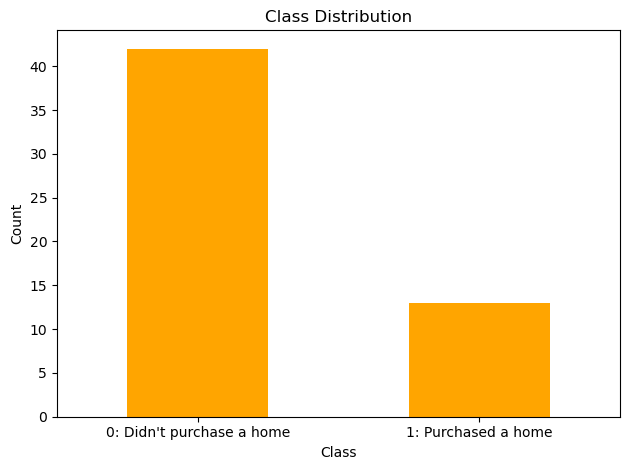

In [11]:
df = ho_t01
class_counts = df['home_ownership_class'].value_counts()
class_counts = class_counts.rename({0: "0: Didn't purchase a home",
                                    1: "1: Purchased a home"})

# Plot
# plt.figure(figsize=(10, 6))
class_counts.plot(kind='bar', color='orange')
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.xticks(rotation=0)
plt.tight_layout()
plt.show()


In [10]:
pd.__version__

'1.5.3'

# HO_T01: Original

In [21]:
# ho_t01

# HO_T02: OHE Original, VarThresh

In [12]:
ho_t02 = ho_t01.copy()
ho_t02 = pd.get_dummies(ho_t02, columns=['gender'], prefix='gender', drop_first='True')
ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

In [13]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t02_X = ho_t02.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t02_y = ho_t02.copy()[['home_ownership_class']]
# ho_t02_y

In [14]:
from sklearn.feature_selection import VarianceThreshold

In [15]:
df = ho_t02_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t02_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 25
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_RIZAL', 'province_UNKNOWN', 'job_ARMED FORCES', 'job_ASSOCIATE PROFESSIONAL', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_NONE', 'job_PROFESIONAL', 'job_UNKNOWN']


In [16]:
ho_t02_X_f02 = ho_t02.copy().drop(columns=filtered_out_columns)
# ho_t02_X_f02 = ho_t02_X_f02.copy().drop(columns=cols_to_drop)
ho_t02_X_f02

ho_t02 = ho_t02_X_f02.copy()

In [18]:
ho_t02.shape

(55, 54)

# HO_T03: OHE, VarThresh, Removed correlated features

In [51]:
ho_t03 = ho_t01.copy()
ho_t03 = pd.get_dummies(ho_t03, columns=['gender'], prefix='gender', drop_first='True')
ho_t03 = pd.get_dummies(ho_t03, columns=['province'], prefix='province')
ho_t03 = pd.get_dummies(ho_t03, columns=['job'], prefix='job')
# ho_t02

In [52]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t03_X = ho_t03.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t03_y = ho_t03.copy()[['home_ownership_class']]
# ho_t02_y

In [53]:
df = ho_t03_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t03_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 25
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_RIZAL', 'province_UNKNOWN', 'job_ARMED FORCES', 'job_ASSOCIATE PROFESSIONAL', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_NONE', 'job_PROFESIONAL', 'job_UNKNOWN']


In [54]:
ho_t03_X_f02 = ho_t03_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema', 'dineOut', 'personalCare', 'hygiene', 'smoking'
]
ho_t03_X_f02 = ho_t03_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t03_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t03_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,leisure,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_SERVICE AND SALES
0,40.0,30000.0,3.0,1.0,3.0,30000.0,3000.0,1000.0,1500.0,1000.0,1500.0,2000.0,500.0,300.0,200.0,100.0,100.0,500.0,600.0,4600.0,500.0,500.0,100.0,50.0,1000.0,1200.0,100.0,1000.0,1000.0,1000.0,0.0,15000.0,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0
1,36.0,2534900.0,3.0,2.0,5.0,50000.0,5000.0,5000.0,5000.0,4000.0,5000.0,2000.0,5000.0,1000.0,5000.0,10000.0,10000.0,1000.0,2500.0,4500.0,5000.0,5000.0,5000.0,2500.0,2500.0,5500.0,5000.0,5000.0,5000.0,5000.0,100.0,5000.0,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
2,35.0,200000.0,3.0,2.0,3.0,50000.0,2000.0,500.0,1000.0,100.0,100.0,1500.0,2000.0,1000.0,1000.0,1000.0,1000.0,500.0,500.0,2000.0,1000.0,500.0,500.0,700.0,500.0,100.0,100.0,100.0,100.0,1000.0,100.0,1000.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0
3,26.0,25000.0,1.0,5.0,3.0,25000.0,7000.0,1500.0,400.0,0.0,0.0,1500.0,200.0,300.0,500.0,1235.0,1411.0,600.0,600.0,2500.0,0.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,500.0,500.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
4,40.0,19000.0,3.0,1.0,9.0,24000.0,10000.0,1000.0,1500.0,300.0,1500.0,200.0,1800.0,1500.0,500.0,1000.0,500.0,280.0,1500.0,3000.0,500.0,250.0,1000.0,600.0,0.0,2500.0,2000.0,3000.0,500.0,3000.0,0.0,5000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
5,30.0,33000.0,3.0,3.0,5.0,50000.0,3500.0,100.0,50.0,30.0,100.0,100.0,100.0,100.0,100.0,3000.0,1500.0,500.0,2000.0,1500.0,1500.0,500.0,500.0,300.0,300.0,100.0,100.0,100.0,100.0,100.0,100.0,500.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
6,40.0,19000.0,1.0,0.0,0.0,190000.0,1.0,4.0,3.0,1.0,1.0,1.0,2.0,2.0,1.0,4.0,4.0,5.0,5.0,4500.0,2.0,6.0,6.0,8.0,2.0,8.0,8.0,8.0,8.0,6.0,9.0,10.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,1.0
7,29.0,80000.0,3.0,2.0,4.0,160000.0,4000.0,500.0,500.0,100.0,100.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0
8,25.0,18500.0,2.0,2.0,2.0,50000.0,2000.0,500.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,500.0,500.0,150.0,300.0,2000.0,500.0,1.0,500.0,300.0,1399.0,1.0,1.0,1.0,1.0,1.0,1.0,2500.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
9,30.0,17000.0,2.0,1.0,2.0,17000.0,5000.0,1000.0,500.0,500.0,500.0,500.0,1000.0,2000.0,500.0,5000.0,1000.0,500.0,500.0,2000.0,2000.0,500.0,1000.0,360.0,100.0,1000.0,1000.0,1000.0,1000.0,1000.0,100.0,2000.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [55]:
ho_t03_X_f02 = ho_t03.copy().drop(columns=filtered_out_columns)
ho_t03_X_f02 = ho_t03_X_f02.copy().drop(columns=cols_to_drop)
ho_t03_X_f02

ho_t03 = ho_t03_X_f02.copy()

In [56]:
ho_t03.shape

(55, 46)

# HO_T04: OHE, Removed Outliers, VarThresh

In [37]:
ho_t04 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t04

In [38]:
ho_t04.shape

(47, 61)

In [39]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t04))
print(f"Number of positive class points: {(ho_t04['home_ownership_class'] == 1).sum()}, {(ho_t04['home_ownership_class'] == 1).sum() / len(ho_t04) :.1%}")
print(f"Number of negative class points: {(ho_t04['home_ownership_class'] == 0).sum()}, {(ho_t04['home_ownership_class'] == 0).sum() / len(ho_t04) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 55
Number of positive class points: 13, 23.6%
Number of negative class points: 42, 76.4%

OUTLIERS REMOVED


IndexError: positional indexers are out-of-bounds

In [40]:
ho_t04 = pd.get_dummies(ho_t04, columns=['gender'], prefix='gender', drop_first='True')
ho_t04 = pd.get_dummies(ho_t04, columns=['province'], prefix='province')
ho_t04 = pd.get_dummies(ho_t04, columns=['job'], prefix='job')
# ho_t02

In [41]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t04_X = ho_t04.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t04_y = ho_t04.copy()[['home_ownership_class']]
# ho_t02_y

In [42]:
df = ho_t04_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t04_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 21
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_BULACAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_FOREIGN COUNTRY', 'province_RIZAL', 'province_UNKNOWN', 'job_ARMED FORCES', 'job_ASSOCIATE PROFESSIONAL', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_NONE', 'job_PROFESIONAL']


In [43]:
ho_t04_X_f02 = ho_t04_X_f01.copy()
# cols_to_drop = [
#     'smallLottery', 'otherVices', 'alcohol', 'cinema'
# ]
# ho_t04_X_f02 = ho_t04_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t04_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t04_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)

tuition | emergency | Correlation: 0.9003956828764941
cinema | dineOut | Correlation: 0.9820333934187448
cinema | personalCare | Correlation: 0.9822157195279813
cinema | informalLenders | Correlation: 0.9431033740642378
cinema | smoking | Correlation: 0.9805574553861145
cinema | alcohol | Correlation: 0.9844671130265842
cinema | gambling | Correlation: 0.983042095113583
cinema | smallLottery | Correlation: 0.9809627434584268
cinema | otherVices | Correlation: 0.9831424034517278
dineOut | personalCare | Correlation: 0.9763884628325739
dineOut | informalLenders | Correlation: 0.9314654154896501
dineOut | smoking | Correlation: 0.9720854540501711
dineOut | alcohol | Correlation: 0.9820840088879421
dineOut | gambling | Correlation: 0.9749412954173906
dineOut | smallLottery | Correlation: 0.9722589190601746
dineOut | otherVices | Correlation: 0.9697521612457731
personalCare | informalLenders | Correlation: 0.9071494373868333
personalCare | smoking | Correlation: 0.9913420697876214
personalC

,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,loanPersonal,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_SERVICE AND SALES
0,40.0,30000.0,3.0,1.0,3.0,30000.0,3000.0,2000.0,1000.0,1500.0,1000.0,1500.0,2000.0,500.0,300.0,200.0,100.0,100.0,500.0,600.0,4600.0,500.0,200.0,200.0,500.0,100.0,100.0,50.0,1000.0,1200.0,100.0,1000.0,1000.0,1000.0,10.0,10.0,0.0,50.0,20.0,15000.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0
1,26.0,25000.0,1.0,5.0,3.0,25000.0,7000.0,1500.0,1500.0,400.0,0.0,0.0,1500.0,200.0,300.0,500.0,1235.0,1411.0,600.0,600.0,2500.0,0.0,0.0,0.0,0.0,500.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,500.0,300.0,500.0,200.0,100.0,500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,40.0,19000.0,3.0,1.0,9.0,24000.0,10000.0,2000.0,1000.0,1500.0,300.0,1500.0,200.0,1800.0,1500.0,500.0,1000.0,500.0,280.0,1500.0,3000.0,500.0,0.0,100.0,250.0,150.0,1000.0,600.0,0.0,2500.0,2000.0,3000.0,500.0,3000.0,0.0,0.0,0.0,500.0,200.0,5000.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
3,30.0,33000.0,3.0,3.0,5.0,50000.0,3500.0,150.0,100.0,50.0,30.0,100.0,100.0,100.0,100.0,100.0,3000.0,1500.0,500.0,2000.0,1500.0,1500.0,200.0,500.0,500.0,200.0,500.0,300.0,300.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,100.0,500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
4,25.0,18500.0,2.0,2.0,2.0,50000.0,2000.0,1000.0,500.0,500.0,1.0,1.0,1.0,1.0,1.0,1.0,500.0,500.0,150.0,300.0,2000.0,500.0,1.0,1.0,1.0,500.0,500.0,300.0,1399.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
5,30.0,17000.0,2.0,1.0,2.0,17000.0,5000.0,1000.0,1000.0,500.0,500.0,500.0,500.0,1000.0,2000.0,500.0,5000.0,1000.0,500.0,500.0,2000.0,2000.0,1000.0,500.0,500.0,500.0,1000.0,360.0,100.0,1000.0,1000.0,1000.0,1000.0,1000.0,150.0,500.0,100.0,100.0,100.0,2000.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
6,38.0,45000.0,3.0,3.0,6.0,45000.0,10000.0,2000.0,1000.0,100.0,200.0,500.0,500.0,300.0,500.0,100.0,1000.0,1000.0,300.0,2500.0,4000.0,500.0,500.0,500.0,500.0,300.0,1000.0,100.0,1700.0,100.0,100.0,100.0,100.0,100.0,1000.0,100.0,100.0,100.0,100.0,3000.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
7,34.0,16200.0,3.0,2.0,3.0,16200.0,5000.0,500.0,500.0,300.0,50.0,500.0,100.0,100.0,2.0,1.0,500.0,100.0,100.0,200.0,1500.0,500.0,300.0,200.0,200.0,200.0,400.0,100.0,500.0,1.0,1.0,1.0,1.0,11.0,2.0,1.0,1.0,1.0,1.0,3000.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0
8,35.0,80000.0,3.0,6.0,4.0,100000.0,5000.0,5000.0,5000.0,1000.0,1000.0,2000.0,5000.0,5000.0,2000.0,5000.0,5000.0,5000.0,2000.0,2000.0,4000.0,4000.0,1000.0,1000.0,1000.0,1000.0,4000.0,2000.0,2000.0,2000.0,1000.0,2000.0,1000.0,1000.0,500.0,500.0,1000.0,0.0,0.0,4000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0
9,52.0,11300.0,1.0,1.0,4.0,11300.0,3000.0,500.0,200.0,1000.0,1.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,300.0,400.0,2500.0,1.0,1.0,1.0,1.0,70.0,1.0,100.0,300.0,1.0,1.0,1.0,1.0,400.0,1.0,1.0,1.0,1.0,1.0,2000.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0


In [44]:
ho_t04_X_f02 = ho_t04.copy().drop(columns=filtered_out_columns)
# ho_t04_X_f02 = ho_t04_X_f02.copy().drop(columns=cols_to_drop)
ho_t04_X_f02

ho_t04 = ho_t04_X_f02.copy()

# HO_T05: OHE, Removed Outliers, VarThresh, Removed highly correlated features

In [62]:
ho_t05 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [46]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t05))
print(f"Number of positive class points: {(ho_t05['home_ownership_class'] == 1).sum()}, {(ho_t05['home_ownership_class'] == 1).sum() / len(ho_t05) :.1%}")
print(f"Number of negative class points: {(ho_t05['home_ownership_class'] == 0).sum()}, {(ho_t05['home_ownership_class'] == 0).sum() / len(ho_t05) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 55
Number of positive class points: 13, 23.6%
Number of negative class points: 42, 76.4%

OUTLIERS REMOVED


IndexError: positional indexers are out-of-bounds

In [63]:
ho_t05 = pd.get_dummies(ho_t05, columns=['gender'], prefix='gender', drop_first='True')
ho_t05 = pd.get_dummies(ho_t05, columns=['province'], prefix='province')
ho_t05 = pd.get_dummies(ho_t05, columns=['job'], prefix='job')
# ho_t02

In [64]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t05_X = ho_t05.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t05_y = ho_t05.copy()[['home_ownership_class']]
# ho_t02_y

In [65]:
df = ho_t05_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t05_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 21
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_BULACAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_FOREIGN COUNTRY', 'province_RIZAL', 'province_UNKNOWN', 'job_ARMED FORCES', 'job_ASSOCIATE PROFESSIONAL', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_NONE', 'job_PROFESIONAL']


In [66]:
ho_t05_X_f02 = ho_t05_X_f01.copy()
cols_to_drop = [
    'smallLottery', 'otherVices', 'alcohol', 'cinema', 'smoking', 'dineOut', 'personalCare', 'tuition', 'informalLenders'
]
ho_t05_X_f02 = ho_t05_X_f01.drop(columns=cols_to_drop)

# Calculate the correlation matrix
correlation_matrix = ho_t05_X_f02.corr()

# Find pairs of columns where the correlation is greater than 0.8
# This will ignore the diagonal which will always be 1 (self correlation)
to_drop = set()
for i in range(len(correlation_matrix)):
    for j in range(i+1, len(correlation_matrix)):
        if correlation_matrix.iloc[i, j] >= 0.9:
            colname = correlation_matrix.columns[j]  # Getting the column name
            to_drop.add(colname)
            print(correlation_matrix.columns[i], "|", colname, "| Correlation:",
                  correlation_matrix.iloc[i, j])

print("\nAfter dropping correlated features:")
ho_t05_X_f02
# ho_t02_X_f02 = ho_t02.copy().drop(columns=cols_to_drop)


After dropping correlated features:


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,leisure,clothing,mobileLoad,internet,vehicleLoan,companyLoan,privateLoans,governmentLoans,gambling,savings,loanSSS,payFamilySupport,loanPagIbig,loanPersonal,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_SERVICE AND SALES
0,40.0,30000.0,3.0,1.0,3.0,30000.0,3000.0,2000.0,1000.0,1500.0,1000.0,1500.0,500.0,300.0,200.0,100.0,100.0,500.0,600.0,4600.0,500.0,500.0,100.0,50.0,1000.0,1200.0,1000.0,1000.0,1000.0,0.0,15000.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0
1,26.0,25000.0,1.0,5.0,3.0,25000.0,7000.0,1500.0,1500.0,400.0,0.0,0.0,200.0,300.0,500.0,1235.0,1411.0,600.0,600.0,2500.0,0.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,40.0,19000.0,3.0,1.0,9.0,24000.0,10000.0,2000.0,1000.0,1500.0,300.0,1500.0,1800.0,1500.0,500.0,1000.0,500.0,280.0,1500.0,3000.0,500.0,250.0,1000.0,600.0,0.0,2500.0,3000.0,500.0,3000.0,0.0,5000.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
3,30.0,33000.0,3.0,3.0,5.0,50000.0,3500.0,150.0,100.0,50.0,30.0,100.0,100.0,100.0,100.0,3000.0,1500.0,500.0,2000.0,1500.0,1500.0,500.0,500.0,300.0,300.0,100.0,100.0,100.0,100.0,100.0,500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
4,25.0,18500.0,2.0,2.0,2.0,50000.0,2000.0,1000.0,500.0,500.0,1.0,1.0,1.0,1.0,1.0,500.0,500.0,150.0,300.0,2000.0,500.0,1.0,500.0,300.0,1399.0,1.0,1.0,1.0,1.0,1.0,2500.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
5,30.0,17000.0,2.0,1.0,2.0,17000.0,5000.0,1000.0,1000.0,500.0,500.0,500.0,1000.0,2000.0,500.0,5000.0,1000.0,500.0,500.0,2000.0,2000.0,500.0,1000.0,360.0,100.0,1000.0,1000.0,1000.0,1000.0,100.0,2000.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
6,38.0,45000.0,3.0,3.0,6.0,45000.0,10000.0,2000.0,1000.0,100.0,200.0,500.0,300.0,500.0,100.0,1000.0,1000.0,300.0,2500.0,4000.0,500.0,500.0,1000.0,100.0,1700.0,100.0,100.0,100.0,100.0,100.0,3000.0,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0,1.0,0.0
7,34.0,16200.0,3.0,2.0,3.0,16200.0,5000.0,500.0,500.0,300.0,50.0,500.0,100.0,2.0,1.0,500.0,100.0,100.0,200.0,1500.0,500.0,200.0,400.0,100.0,500.0,1.0,1.0,1.0,11.0,1.0,3000.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0
8,35.0,80000.0,3.0,6.0,4.0,100000.0,5000.0,5000.0,5000.0,1000.0,1000.0,2000.0,5000.0,2000.0,5000.0,5000.0,5000.0,2000.0,2000.0,4000.0,4000.0,1000.0,4000.0,2000.0,2000.0,2000.0,2000.0,1000.0,1000.0,1000.0,4000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0,1.0
9,52.0,11300.0,1.0,1.0,4.0,11300.0,3000.0,500.0,200.0,1000.0,1.0,1.0,500.0,1.0,1.0,1.0,1.0,300.0,400.0,2500.0,1.0,1.0,1.0,100.0,300.0,1.0,1.0,1.0,400.0,1.0,2000.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0


In [67]:
ho_t05_X_f02 = ho_t05.copy().drop(columns=filtered_out_columns)
ho_t05_X_f02 = ho_t05_X_f02.copy().drop(columns=cols_to_drop)
ho_t05_X_f02

ho_t05 = ho_t05_X_f02.copy()
ho_t05.shape

(47, 46)

# HO_T06: OHE, Removed Outliers, VarThresh, Removed highly correlated features via VIF

In [68]:
ho_t06 = ho_t01.copy().drop(ho_t01_outliers)

# ho_t05

In [69]:
print('BEFORE OUTLIER REMOVAL')
print('Number of data points:', len(ho_t01))
print(f"Number of positive class points: {(ho_t01['home_ownership_class'] == 1).sum()}, {(ho_t01['home_ownership_class'] == 1).sum() / len(ho_t01) :.1%}")
print(f"Number of negative class points: {(ho_t01['home_ownership_class'] == 0).sum()}, {(ho_t01['home_ownership_class'] == 0).sum() / len(ho_t01) :.1%}")

print('\nOUTLIERS REMOVED')
print('Number of outliers:', len(ho_t01.iloc[ho_t01_outliers]))
print(f"Number of positive class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 1).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")
print(f"Number of negative class outliers: {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum()}, {(ho_t01.iloc[ho_t01_outliers]['home_ownership_class'] == 0).sum() / len(ho_t01.iloc[ho_t01_outliers]) :.1%}")

print('\nAFTER OUTLIER REMOVAL')
print('Number of data points:', len(ho_t06))
print(f"Number of positive class points: {(ho_t06['home_ownership_class'] == 1).sum()}, {(ho_t06['home_ownership_class'] == 1).sum() / len(ho_t06) :.1%}")
print(f"Number of negative class points: {(ho_t06['home_ownership_class'] == 0).sum()}, {(ho_t06['home_ownership_class'] == 0).sum() / len(ho_t06) :.1%}")

BEFORE OUTLIER REMOVAL
Number of data points: 55
Number of positive class points: 13, 23.6%
Number of negative class points: 42, 76.4%

OUTLIERS REMOVED


IndexError: positional indexers are out-of-bounds

In [70]:
ho_t06 = pd.get_dummies(ho_t06, columns=['gender'], prefix='gender', drop_first='True')
ho_t06 = pd.get_dummies(ho_t06, columns=['province'], prefix='province')
ho_t06 = pd.get_dummies(ho_t06, columns=['job'], prefix='job')
# ho_t02

In [71]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t06_X = ho_t06.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t06_y = ho_t06.copy()[['home_ownership_class']]
# ho_t02_y

In [72]:
df = ho_t06_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t06_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 21
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_BULACAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_FOREIGN COUNTRY', 'province_RIZAL', 'province_UNKNOWN', 'job_ARMED FORCES', 'job_ASSOCIATE PROFESSIONAL', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'job_ELEMENTARY OCCUPATION', 'job_MACHINE OPERATOR', 'job_NONE', 'job_PROFESIONAL']


In [73]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t06_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\statsmodels\stats\outliers_influence.py:198: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


In [74]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['age',
 'basicMonthlySalary',
 'internet',
 'vehicleLoan',
 'informalLenders',
 'companyLoan',
 'privateLoans',
 'governmentLoans',
 'smoking',
 'alcohol',
 'gambling',
 'smallLottery',
 'otherVices',
 'savings',
 'loanSSS',
 'payFamilySupport',
 'loanPagIbig',
 'loanPersonal',
 'houseHasPrivateEmployee',
 'houseHasOFW',
 'houseOnlyFamily',
 'houseExtendedFamily',
 'gender_MALE',
 'province_CAVITE',
 'province_METRO MANILA',
 'mobileLoad',
 'clothing',
 'personalCare',
 'tuition',
 'preferredNetDisposableIncomeId',
 'workingFamilyCount',
 'residentsCount',
 'monthlyFamilyIncome',
 'food',
 'hygiene',
 'houseCleaning',
 'fare',
 'parking',
 'gasoline',
 'allowance',
 'leisure',
 'uniform',
 'otherEducation',
 'emergency',
 'medicine',
 'water',
 'electricity',
 'rent',
 'repair',
 'cinema',
 'dineOut',
 'job_SERVICE AND SALES']

In [75]:
ho_t06_X_f02 = ho_t06.copy().drop(columns=filtered_out_columns)
ho_t06_X_f02 = ho_t06_X_f02.copy().drop(columns=columns_to_remove)
ho_t06_X_f02

ho_t06 = ho_t06_X_f02.copy()

# HO_T07 (discarded): OHE, VarThresh, Removed highly correlated features via VIF

In [204]:
ho_t07 = ho_t01.copy()

# ho_t05

In [205]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [206]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [207]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [208]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [209]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [ ]:
ho_t07_X_f02 = ho_t07.copy().drop(columns=filtered_out_columns)
ho_t07_X_f02 = ho_t07_X_f02.copy().drop(columns=columns_to_remove)
ho_t07_X_f02

ho_t07 = ho_t07_X_f02.copy()

# HO_T07: OHE, VarThresh, Added new features (retained only those won't be removed by VIF)

In [60]:
df = ho_t01.copy()

# df['monthlyFamilyIncome - basicMonthlySalary'] = df['monthlyFamilyIncome'] - df['basicMonthlySalary']
df['monthlyVices'] = (
    df['smoking'] + df['alcohol'] + df['gambling'] +
    df['smallLottery'] + df['otherVices']
)
df['monthlyUtilityBills'] = (
    df['water'] + df['electricity'] + df['rent'] +
    df['internet'] + df['mobileLoad']
)
df['totalMonthlyExpenses'] = (
    df['food'] + df['hygiene'] + df['houseCleaning'] +
    df['fare'] + df['parking'] + df['gasoline'] +
    df['tuition'] + df['allowance'] + df['uniform'] +
    df['otherEducation'] + df['emergency'] + df['medicine'] +
    df['repair'] + df['cinema'] + df['dineOut'] +
    df['leisure'] + df['personalCare'] + df['clothing'] +
    df['vehicleLoan'] + df['monthlyUtilityBills'] +
    df['informalLenders'] + df['companyLoan'] + df['privateLoans'] +
    df['governmentLoans'] + df['monthlyVices']
)
# df['monthlyFamilyIncome - totalMonthlyExpenses'] = df['monthlyFamilyIncome'] - df['totalMonthlyExpenses']
# df['basicMonthlySalary - totalMonthlyExpenses'] = df['basicMonthlySalary'] - df['totalMonthlyExpenses']
# df['monthlyFamilyIncome / workingFamilyCount'] = np.where(
#     df['workingFamilyCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['workingFamilyCount']
# )
# df['monthlyFamilyIncome / residentsCount'] = np.where(
#     df['residentsCount'] == 0,
#     df['monthlyFamilyIncome'],
#     df['monthlyFamilyIncome'] / df['residentsCount']
# )
df['basicMonthlySalary / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['basicMonthlySalary'] / df['monthlyFamilyIncome']
)
df['totalMonthlyExpenses / basicMonthlySalary'] = np.where(
    df['basicMonthlySalary'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['basicMonthlySalary']
)
df['totalMonthlyExpenses / monthlyFamilyIncome'] = np.where(
    df['monthlyFamilyIncome'] == 0,
    0,
    df['totalMonthlyExpenses'] / df['monthlyFamilyIncome']
)
# df['monthlyVices / basicMonthlySalary'] = np.where(
#     df['basicMonthlySalary'] == 0,
#     0,
#     df['monthlyVices'] / df['basicMonthlySalary']
# )

ho_t07 = df.copy()

In [61]:
ho_t07 = pd.get_dummies(ho_t07, columns=['gender'], prefix='gender', drop_first='True')
ho_t07 = pd.get_dummies(ho_t07, columns=['province'], prefix='province')
ho_t07 = pd.get_dummies(ho_t07, columns=['job'], prefix='job')
# ho_t02

In [62]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t07_X = ho_t07.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t07_y = ho_t07.copy()[['home_ownership_class']]
# ho_t02_y

In [63]:
df = ho_t07_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t07_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 50
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee', 'province_AGUSAN DEL NORTE', 'province_AKLAN', 'province_ALBAY', 'province_BATAAN', 'province_BATANGAS', 'province_BULACAN', 'province_CAGAYAN', 'province_CAMARINES SUR', 'province_CEBU', 'province_COTABATO', 'province_DAVAO DEL SUR', 'province_EASTERN SAMAR', 'province_FOREIGN COUNTRY', 'province_ILOCOS NORTE', 'province_ILOILO', 'province_ISABELA', 'province_LAGUNA', 'province_LEYTE', 'province_MARINDUQUE', 'province_MISAMIS OCCIDENTAL', 'province_NEGROS OCCIDENTAL', 'province_NUEVA ECIJA', 'province_ORIENTAL MINDORO', 'province_PANGASINAN', 'province_QUEZON', 'province_QUIRINO', 'province_RIZAL', 'province_ROMBLON', 'province_SOUTH COTABATO', 'province_TARLAC', 'province_UNKNOWN', 'province_ZAMBOANGA DEL NORTE', 'job_AGRICULTURAL', 'job_ARMED FORCES', 'job_CLERICAL SUPPORT', 'job_CRAFT AND TRADE', 'jo

In [64]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t07_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

divide by zero encountered in scalar divide


In [65]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['vehicleLoan',
 'gambling',
 'rent',
 'repair',
 'cinema',
 'dineOut',
 'leisure',
 'personalCare',
 'clothing',
 'mobileLoad',
 'internet',
 'smallLottery',
 'informalLenders',
 'companyLoan',
 'privateLoans',
 'governmentLoans',
 'smoking',
 'electricity',
 'water',
 'medicine',
 'houseCleaning',
 'totalMonthlyExpenses',
 'monthlyUtilityBills',
 'monthlyVices',
 'otherVices',
 'food',
 'hygiene',
 'fare',
 'emergency',
 'parking',
 'gasoline',
 'tuition',
 'allowance',
 'uniform',
 'otherEducation',
 'alcohol',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

# HO_T08: Dropped cat features, VarThresh

In [66]:
ho_t08 = ho_t01.copy().drop(columns=['gender', 'province', 'job'])

# ho_t05

In [67]:
# ho_t02 = ho_t02_full.copy()
# ho_t02 = pd.get_dummies(ho_t02_full, columns=['gender'], prefix='gender', drop_first='True')
# ho_t02 = pd.get_dummies(ho_t02, columns=['province'], prefix='province')
# ho_t02 = pd.get_dummies(ho_t02, columns=['job'], prefix='job')
# ho_t02

ho_t08_X = ho_t08.copy().drop(['userId', 'lastFirstName', 'home_ownership_class'], axis=1)
ho_t08_y = ho_t08.copy()[['home_ownership_class']]
# ho_t02_y

In [68]:
df = ho_t08_X
selector = VarianceThreshold(threshold=0.15)
filtered_data = selector.fit_transform(df)

df_mod = pd.DataFrame(filtered_data, columns=df.columns[selector.get_support()])

# display(df_mod)
retained_columns_mask = selector.get_support()

filtered_out_columns = df.columns[~retained_columns_mask].tolist()

ho_t08_X_f01 = df_mod
print('Number of columns:', len(filtered_out_columns))
print('Removed columns:', filtered_out_columns)

Number of columns: 8
Removed columns: ['loanOthers', 'payInsurance', 'loanGSIS', 'loanPersonal', 'houseHasPensioner', 'houseHasBusiness', 'houseHasFreelancer', 'houseHasGovtEmployee']


In [69]:
from statsmodels.stats.outliers_influence import variance_inflation_factor

# calculate VIF for each feature
df = ho_t08_X_f01
vif = pd.DataFrame()
vif["VIF Factor"] = [variance_inflation_factor(df.values, i) for i in range(df.shape[1])]
vif["features"] = df.columns
vif_sorted = vif.sort_values(by="VIF Factor", ascending=False)
# vif_sorted

In [70]:
# Identify columns to be removed
columns_to_remove = vif_sorted[vif_sorted['VIF Factor'] > 10]['features'].to_list()
columns_to_remove

['smallLottery',
 'gambling',
 'otherVices',
 'age',
 'houseOnlyFamily',
 'preferredNetDisposableIncomeId']

In [71]:
ho_t08 = ho_t08.copy().drop(columns=filtered_out_columns)
# ho_t08_X_f02 = ho_t08_X_f02.copy().drop(columns=columns_to_remove)
ho_t08

ho_t08 = ho_t08.copy()

In [72]:
ho_t08

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class
0,370,"IBALI, HOWARD",24,19000,2,3,3,40000.0,1000,500,200,200,0,0,0,50,0,0,500,450,0,0,0,0,0,0,0,0,0,50,0,0,0,0,0,0,0,0,0,0,0,2000,0,0,0,1,1,0,1,1
1,1025,"PATALINGHOG, KIMBERLY",26,15000,3,2,4,30000.0,5000,3000,2000,2000,0,0,0,0,0,0,2000,0,200,200,1000,500,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2000,1,1,1,1,0,1,0,0
2,1105,"TEMILLOSO, DENNIS",40,20000,2,0,3,30000.0,3000,500,300,200,50,50,500,100,100,50,500,100,200,500,0,200,0,100,100,100,200,200,200,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,1,0,0,1,0
3,1719,"OSCARES, ELMER",32,21200,2,0,5,12000.0,2000,500,200,392,0,0,0,0,0,0,100,0,200,200,3000,0,0,0,0,100,200,400,0,0,0,0,0,876,0,0,0,0,0,500,1,0,0,1,0,1,0,1
4,2081,"LEGASPI, MANNY",39,19800,2,0,0,25000.0,5000,2000,1000,1500,0,0,1000,500,1500,0,0,1000,300,1900,0,1000,0,1000,1000,1500,1500,500,1600,0,0,0,0,0,0,0,0,0,0,10000,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1065,12850,"LIPANGO, ARVIN",34,19000,2,2,4,19000.0,5000,1000,1000,1,1,1,1000,500,1,1000,1000,500,200,1500,5000,1000,1,1,1,1,1,500,1,1,1,1,1,1,1,1,1,1,1,2000,0,0,0,1,0,1,0,0
1066,12852,"TEJADA, JERIC",27,20000,2,1,1,20000.0,5000,500,400,280,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,200,0,0,0,0,0,1672,0,0,0,0,0,500,1,0,1,1,0,0,0,0
1067,12853,"RAMOS, RHEALYN",27,13962,1,2,4,40000.0,4,2,1,3,1,1,0,0,0,0,30000,1000,150,1000,2000,500,0,1000,0,0,0,300,0,0,0,500,0,0,0,0,0,0,0,2000,0,0,0,1,0,1,0,0
1068,12854,"BURGOS, LIEZEL",48,51000,2,0,5,51000.0,5000,3000,1500,2000,0,0,15000,9000,0,0,1000,1000,300,800,0,0,0,500,500,300,500,300,800,0,0,0,0,0,0,0,0,0,0,1000,0,0,0,0,1,0,0,0


# Functions for Classification Modeling and Others

In [76]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [42]:
# ho_t02.info()

In [77]:
ho_t02['userId'] = ho_t02['userId'].astype('str')
ho_t02 = adjust_data_types(ho_t02)
ho_t02.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 55 entries, 12 to 1065
Data columns (total 54 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          55 non-null     object 
 1   lastFirstName                   55 non-null     object 
 2   age                             55 non-null     float64
 3   basicMonthlySalary              55 non-null     float64
 4   preferredNetDisposableIncomeId  55 non-null     float64
 5   workingFamilyCount              55 non-null     float64
 6   residentsCount                  55 non-null     float64
 7   monthlyFamilyIncome             55 non-null     float64
 8   food                            55 non-null     float64
 9   hygiene                         55 non-null     float64
 10  houseCleaning                   55 non-null     float64
 11  fare                            55 non-null     float64
 12  parking                         55 

In [78]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler, PowerTransformer, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.pipeline import Pipeline

from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import MultinomialNB
from sklearn.linear_model import SGDClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier, AdaBoostClassifier
from lightgbm import LGBMClassifier
from xgboost.sklearn import XGBClassifier

from sklearn.feature_selection import RFE, RFECV, VarianceThreshold

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, make_scorer, confusion_matrix, roc_curve
from sklearn.model_selection import GridSearchCV, StratifiedKFold, permutation_test_score
from sklearn.base import clone


from imblearn.metrics import geometric_mean_score
import shap

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler

from imblearn.pipeline import Pipeline
# from sklearn.pipeline import Pipeline

import dice_ml

from catboost import CatBoostClassifier

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)
UserConfigValidationException will be deprecated from dice_ml.utils. Please import UserConfigValidationException from raiutils.exceptions.


In [79]:
def specificity_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn + fp)
    return specificity

specificity_scorer = make_scorer(specificity_score)

def npv_score(y_true, y_pred):
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    npv = tn / (tn + fn)
    return npv

npv_scorer = make_scorer(npv_score)

g_mean_scorer = make_scorer(geometric_mean_score)


skf = StratifiedKFold(10, shuffle=True, random_state=0)

# def get_cat_cols(df):
#     one_hot_encoded_columns = []

#     for idx, column in enumerate(df.columns):
#         if df[column].nunique() == 2 and set(df[column].unique()) == {0, 1}:
#             one_hot_encoded_columns.append(idx)

#     return one_hot_encoded_columns

def get_cat_cols(df):
    return df.select_dtypes(include=['object']).columns.tolist()

# get_cat_cols(ho_t02)
# cat_cols = get_cat_cols(ho_t02)
# num_cols = [col for col in ho_t02.columns if col not in cat_cols]
# cat_cols, num_cols

In [80]:
from sklearn.decomposition import PCA

from imblearn.over_sampling import SMOTE, ADASYN, SMOTENC, RandomOverSampler
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours, TomekLinks
from imblearn.combine import SMOTEENN, SMOTETomek


from sklearn.base import BaseEstimator, TransformerMixin

class DropCategoricalFeatures(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass

    def fit(self, X, y=None):
        return self

    def transform(self, X, y=None):
        # Assuming X is a DataFrame
        non_categorical_cols = X.select_dtypes(exclude=['object']).columns.tolist()
        return X[non_categorical_cols]


def knn_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]
    
    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', KNeighborsClassifier())
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_neighbors': list(range(1, 16)),
        'classifier__metric': ['euclidean', 'cosine', 'hamming', 'braycurtis',
                               'chebyshev', 'canberra', 'cityblock', 'sqeuclidean'
                              ]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

#         y_hat = modified_estimator.predict_proba(X_test)[:, 1]

#         fpr, tpr, thresholds = roc_curve(y_test, y_hat)
#         gmeans = np.sqrt(tpr * (1-fpr))
#         ix = np.argmax(gmeans)
#         print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

#         plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
#         plt.plot(fpr, tpr, marker='.', label='Original')
#         plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

#         plt.xlabel('False Positive Rate')
#         plt.ylabel('True Positive Rate')
#         plt.legend()

#         plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def svm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', SVC(random_state=random_state, max_iter=1000,
                           verbose=True))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__probability': [True, False],
        'classifier__kernel': ['linear', 'poly', 'rbf', 'sigmoid']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def logreg_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
#         ('drop_categorical', None),
#         ('encoder', None),
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LogisticRegression(random_state=random_state, max_iter=1000))
    ])

    param_grid = {
#         'drop_categorical': [None, DropCategoricalFeatures()]
#         'encoder': [None, OneHotEncoder(sparse_output=False)],
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__C': list(np.logspace(-6, 6, num=13)),
        'classifier__penalty': ['l2', None],
        'classifier__solver': ['liblinear', 'lbfgs', 'newton-cholesky']
#         'classifier__penalty': ['l1', l2', 'elasticnet', 'None']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = end_time - start_time

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df



def dt_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]


    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', DecisionTreeClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(), 
#             RobustScaler(),
#             MinMaxScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
            SMOTEENN(random_state=random_state),
            SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
            TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
#         'classifier__max_depth': [3],
# #         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [1],
#         'classifier__max_depth': [2, 5],
#         'classifier__min_samples_split': [3],
#         'classifier__min_samples_leaf': [3],
# #         'classifier__max_features': ['auto', 'sqrt', 'log2', None],
#         'classifier__criterion': ["entropy", "log_loss"]
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [1],
#         'classifier__min_samples_leaf': [2, 3],
        'classifier__max_depth': [2, 3, 5],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [1, 2, 3],
        'classifier__max_features': ['auto', 'sqrt', 'log2', None],
        'classifier__criterion': ["gini", "entropy", "log_loss"]
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.decomposition import TruncatedSVD

def rf_class2(df, scorer, label_col, random_state=0):
#     df_majority = df[df.home_ownership_class == 0]
#     df_minority = df[df.home_ownership_class == 1]

# #     display(df_majority)
# #     display(df_minority)
# #     print(len(df_majority), len(df_minority))
#     # Randomly downsample majority class
#     df_majority_downsampled = df_majority.sample(frac=0.2,
#                                                  random_state=random_state)
#     df = pd.concat([df_majority_downsampled, df_minority], axis=0)

    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)

#     n_components = X_scaled.shape[1]  # Maximum number of components
#     svd = TruncatedSVD(n_components=n_components)
#     X_svd = svd.fit_transform(X_scaled)

#     # Step 3: Find number of components that explain at least 90% variance
#     cum_variance = np.cumsum(svd.explained_variance_ratio_)
#     num_components = np.argmax(cum_variance >= 0.90) + 1  # +1 because Python indexing starts from 0
#     X_selected = X_svd[:, :num_components]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

#     X_resampled, y_resampled = RandomOverSampler(random_state=random_state).fit_resample(X_train, y_train)
#     class_counts_original = np.bincount(y_train.astype(int))
#     class_counts_resampled = np.bincount(y_resampled.astype(int))

    # Assuming 0 is the majority class, calculate its upweight factor
#     majority_class_original = class_counts_original[0]
#     majority_class_resampled = class_counts_resampled[0]
#     upweight_factor = majority_class_original / majority_class_resampled

#     minority_class_original = class_counts_original[1]
#     minority_class_resampled = class_counts_resampled[1]
#     downweight_factor = minority_class_original / minority_class_resampled

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', RandomForestClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)
        ],
        'classifier__n_estimators': [200, 300],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__oob_score': [True, False],
        'classifier__criterion': ["gini", "entropy", "log_loss"]

#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__oob_score': [True, False],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
    }
#         'classifier__n_estimators': [200, 250, 300],
# #         'classifier__max_depth': [2, 3, 4],
#         'classifier__max_depth': [2],
#         'classifier__class_weight': [{0: 263/807, 1:1}],
#         'classifier__oob_score': [True],
# #         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__min_samples_split': [3, 4],
#         'classifier__min_samples_leaf': [3, 4],
#         'classifier__criterion': ["gini", "entropy", "log_loss"]
#     }
    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
#                                cv=10, scoring=scorer,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
#         modified_estimator = best_estimator
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def gbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', GradientBoostingClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
        'classifier__n_estimators': [200, 250],
        'classifier__max_depth': [2, 3],
        'classifier__min_samples_leaf': [2, 3],
        'classifier__min_samples_split': [2, 3],
        'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def lgbm_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     plt.figure(figsize=(10, 6))
#     plt.plot(range(1, len(explained_var_ratio)+1), cumulative_explained_var, marker='o', linestyle='--')
#     plt.title('Cumulative Explained Variance Plot')
#     plt.xlabel('Number of Components')
#     plt.ylabel('Cumulative Explained Variance')
#     plt.grid(True)
#     plt.show()

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', LGBMClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [400, 450],
#         'classifier__learning_rate': [0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
#         'classifier__max_depth': [2, 3],
#         'classifier__boosting_type': ['gbdt', 'dart', 'goss']

        'classifier__n_estimators': [200, 300, 400],
        'classifier__learning_rate': [0.1, 0.01],
#         'classifier__num_leaves': [20, 25],
#         'classifier__min_child_samples': [40, 45],
#         'classifier__class_weight': [{0: 263/807, 1:1}, {0: 1, 1:807/263}],
#         'classifier__class_weight': [{0: 1, 1:807/263}],
        'classifier__max_depth': [2, 3],
        'classifier__boosting_type': ['gbdt', 'dart', 'goss']
    }
#         'classifier__num_leaves': [20, 31, 40],
#         'classifier__min_child_samples': [10, 20, 30],
#         'classifier__max_depth': [-1, 5, 10],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def xgb_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', XGBClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
#         'resampling': [SMOTE(random_state=random_state),
#                        SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
#                        ADASYN(random_state=random_state),
# #                        RandomOverSampler(random_state=random_state),
#                        RandomUnderSampler(random_state=random_state)],
#         'scaler': [RobustScaler(),
#                    PowerTransformer()],
#         'resampling': [SMOTENC(categorical_features=get_cat_cols(X),
#                                random_state=random_state),
        'resampling': [SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
# #         'classifier__n_estimators': [200, 250],
#         'classifier__learning_rate': [2, 3],
# #         'classifier__max_depth': [2, 3],
#         'classifier__max_leaves': [5],
#         'classifier__grow_policy': ['depthwise', 'lossguide']
        'classifier__n_estimators': [200, 250],
        'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__max_depth': [None, 2, 3],
        'classifier__max_leaves': [10, 20, 30],
        'classifier__grow_policy': ['depthwise', 'lossguide']
    }
#         'classifier__max_depth': [None, 5, 10],
#         'classifier__max_leaves': [0, 10, 20],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def adaboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', AdaBoostClassifier(
            random_state=random_state))
    ])

    param_grid = {
#         'scaler': [
#             StandardScaler(),
#             MinMaxScaler(),
#             RobustScaler()
#         ],
        'resampling': [
            SMOTE(random_state=random_state),
            ADASYN(random_state=random_state),
#             SMOTEENN(random_state=random_state),
#             SMOTETomek(random_state=random_state),
            EditedNearestNeighbours(),
#             TomekLinks(),
            RandomOverSampler(random_state=random_state),
            RandomUnderSampler(random_state=random_state)],
        'classifier__n_estimators': [200, 300],
        'classifier__estimator': [DecisionTreeClassifier(
            random_state=random_state,
#             criterion='entropy', max_depth=3,
#             min_samples_leaf=2, min_samples_split=2
        ),
                                  RandomForestClassifier(
            random_state=random_state,
#             max_depth=3, min_samples_leaf=2,
#             min_samples_split=2, n_estimators=250,
#             oob_score=True
                                                        )],
#         'classifier__learning_rate': [0.01, 0.1, 1],
        'classifier__algorithm': ['SAMME', 'SAMME.R']
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]


        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

from sklearn.linear_model import RidgeClassifier

def ridge_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

#     scaler = RobustScaler()
#     X_scaled = scaler.fit_transform(X)
#     pca = PCA().fit(X_scaled)

#     # 2. Plot the cumulative explained variance
#     explained_var_ratio = pca.explained_variance_ratio_
#     cumulative_explained_var = np.cumsum(explained_var_ratio)

#     # 3. Find the number of components that explain up to 90% of the variance
#     num_components = np.argmax(cumulative_explained_var >= 0.90) + 1
#     print(f"Number of components that explain up to 90% of variance: {num_components}")

#     # Refit PCA with the selected number of components
#     pca_90 = PCA(n_components=num_components)
#     X = pca_90.fit_transform(X_scaled)

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    cat_cols = get_cat_cols(X_train)
    num_cols = [col for col in X_train.columns if col not in cat_cols]
    
    cat_transformer = Pipeline([
        ('onehot', OneHotEncoder(handle_unknown='ignore'))
    ])
    
    num_transformer = Pipeline([
        ('variance_threshold', VarianceThreshold(threshold=0.15))
    ])
    
    preprocessor = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols),
            ('cat', cat_transformer, cat_cols)
        ],
        remainder='passthrough'
    )

    preprocessor_num = ColumnTransformer(
        transformers = [
            ('num', num_transformer, num_cols)
        ],
        remainder='drop'
    )

    preprocessor_drop_cat = ColumnTransformer(
        transformers = [
            ('num', 'passthrough', num_cols)
        ],
        remainder='drop'
    )

    pipeline = Pipeline([
#         ('preprocessor', None),
        ('preprocessor', preprocessor_drop_cat),
#         ('scaler', None),
        ('resampling', None),
        ('var_threshold', VarianceThreshold(threshold=0.15)),
        ('classifier', RidgeClassifier(max_iter=1000, random_state=random_state))
    ])

    param_grid = {
#         'preprocessor': [
#             preprocessor_drop_cat,
#             preprocessor,
#             preprocessor_num            
#         ],
        'resampling': [ADASYN(random_state=random_state),
                       SMOTEENN(random_state=random_state),
                       SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
                       TomekLinks(),
                       RandomUnderSampler(random_state=random_state)],
        'classifier__alpha': [0.01, 0.1, 1, 10, 100, 1000],
        'classifier__solver': ['auto', 'svd', 'cholesky', 'lsqr', 'sag', 'saga'],
    }

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=10, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

        modified_estimator = clone(best_estimator)
        if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
            isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
            modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
        modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)
        
        end_time = time.time()
        elapsed_time = (end_time - start_time) / 60

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

def catboost_class2(df, scorer, label_col, random_state=0):
    X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
    y = df.loc[:, label_col]

    X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                        test_size=0.25,
                                                        stratify=y,
                                                        random_state=random_state)

    pipeline = Pipeline([
        ('scaler', RobustScaler()),
        ('resampling', None),
        ('classifier', CatBoostClassifier(random_state=random_state))
    ])

    param_grid = {
#         'scaler': [StandardScaler(),
#                    MinMaxScaler(),
#                    RobustScaler()
#                   ],
        'resampling': [
            SMOTE(random_state=random_state),
                       ADASYN(random_state=random_state),
#                        SMOTEENN(random_state=random_state),
#                        SMOTETomek(random_state=random_state),
                       EditedNearestNeighbours(),
#                        TomekLinks(),
                       RandomOverSampler(random_state=random_state),
                       RandomUnderSampler(random_state=random_state)],
#         'classifier__n_estimators': [200],
#         'classifier__max_depth': [None],
#         'classifier__min_samples_leaf': [3],
#         'classifier__min_samples_split': [5],
#         'classifier__learning_rate': [0.1]
#         'classifier__n_estimators': [200, 250],
#         'classifier__max_depth': [2, 3],
#         'classifier__min_samples_leaf': [2, 3],
#         'classifier__min_samples_split': [2, 3],
#         'classifier__learning_rate': [0.1]
    }
#         'loss': ['log_loss', 'deviance', 'exponential']
#         'min_samples_leaf': [1, 2, 3],
#         'min_samples_split': [2, 3, 5],

    start_time_cv = time.time()
    grid_search = GridSearchCV(pipeline, param_grid,
                               cv=skf, scoring=scorer,
                               n_jobs=-1,
                               verbose=4, return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_params = grid_search.best_params_
    best_score = grid_search.best_score_
    best_estimator = grid_search.best_estimator_
    cv_results = grid_search.cv_results_
    end_time_cv = time.time()

    print("Best Hyperparameters:", best_params)
    print("Best Validation Score (G-mean):", best_score)
    print('Best Estimator:', best_estimator)
    print('Mean Train Score (G-mean)', np.mean(cv_results['mean_train_score']))
    print('Std Train Score (G-mean)', np.mean(cv_results['std_train_score']))
    elapsed_time_cv = (end_time_cv - start_time_cv)
    print(f'GridSearchCV Runtime: {elapsed_time_cv} secs')

    num_runs = 5
    metrics_per_run = []

    for run in range(num_runs):
        modified_random_state = random_state + run

        start_time = time.time()
        X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                            test_size=0.25,
                                                            stratify=y,
                                                            random_state=modified_random_state)

#         modified_estimator = best_estimator
        modified_estimator = clone(best_estimator)
#         if not (isinstance(best_estimator.named_steps['resampling'], EditedNearestNeighbours) or
#             isinstance(best_estimator.named_steps['resampling'], TomekLinks)):
#             modified_estimator.named_steps['resampling'].set_params(random_state=modified_random_state)
#         modified_estimator.named_steps['classifier'].set_params(random_state=modified_random_state)
        modified_estimator.fit(X_train, y_train)

        y_pred = modified_estimator.predict(X_test)

        end_time = time.time()
        elapsed_time = (end_time - start_time)

        accuracy = accuracy_score(y_test, y_pred)
        precision = precision_score(y_test, y_pred)
        recall = recall_score(y_test, y_pred)
        f1 = f1_score(y_test, y_pred)
        specificity = specificity_score(y_test, y_pred)
        npv = npv_score(y_test, y_pred)
        g_mean = geometric_mean_score(y_test, y_pred)

        print(f"Run {run + 1} - Random State: {modified_random_state}")
        print(f"Test G-mean: {g_mean}")

        y_hat = modified_estimator.predict_proba(X_test)[:, 1]

        fpr, tpr, thresholds = roc_curve(y_test, y_hat)
        gmeans = np.sqrt(tpr * (1-fpr))
        ix = np.argmax(gmeans)
        print('Best Threshold=%f, G-Mean=%.3f' % (thresholds[ix], gmeans[ix]))

        plt.plot([0,1], [0,1], linestyle='--', label='No Skill')
        plt.plot(fpr, tpr, marker='.', label='Original')
        plt.scatter(fpr[ix], tpr[ix], marker='o', color='black', label='Best')

        plt.xlabel('False Positive Rate')
        plt.ylabel('True Positive Rate')
        plt.legend()

        plt.show()

        metrics_per_run.append({
            'Random State': modified_random_state,
            'Test Accuracy': accuracy,
            'Test Precision': precision,
            'Test Recall': recall,
            'Test F1 Score': f1,
            'Test Specificity': specificity,
            'Test G-mean': g_mean,
            'Test NPV': npv,
            'Runtime': elapsed_time
        })

    metrics_df = pd.DataFrame(metrics_per_run)

    avg_metrics = metrics_df.mean()
    std_metrics = metrics_df.std()

    print('Ave Test G-mean:', avg_metrics['Test G-mean'])
    print('Stdev Test G-mean:', std_metrics['Test G-mean'])
    print("Ave Test Specificity:", avg_metrics['Test Specificity'])
    print("Ave Test Recall:", avg_metrics['Test Recall'])
    print('Ave Test NPV:', avg_metrics['Test NPV'])
    print("Ave Test Accuracy:", avg_metrics['Test Accuracy'])
    print("Ave Test Precision:", avg_metrics['Test Precision'])
    print("Ave Test F1-Score:", avg_metrics['Test F1 Score'])
    print("Ave Runtime:", avg_metrics['Runtime'])

    model_info = {
        'best_params': best_params,
        'best_cv_score': best_score,
        'mean_train_score': np.mean(cv_results['mean_train_score']),
        'std_train_score': np.mean(cv_results['std_train_score']),
        'average_runtime': avg_metrics['Runtime'],
        'average_test_g_mean': avg_metrics['Test G-mean'],
        'stdev_test_g_mean': std_metrics['Test G-mean'],
        'average_test_specificity': avg_metrics['Test Specificity'],
        'average_test_recall': avg_metrics['Test Recall'],
        'average_test_npv': avg_metrics['Test NPV'],
        'average_test_accuracy': avg_metrics['Test Accuracy'],
        'average_test_precision': avg_metrics['Test Precision'],
        'average_test_f1_score': avg_metrics['Test F1 Score']
    }

    return grid_search, best_estimator, model_info, metrics_df

# HO-T02 runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1256 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 5, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3833333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=5,
                                        max_features='sqrt', min_samples_leaf=3,
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 24.753707885742188 secs
Run 1 - Random State: 0
Test G-mean: 0.4605661864718383
Best Threshold=0.500000, G-Mean=0.798


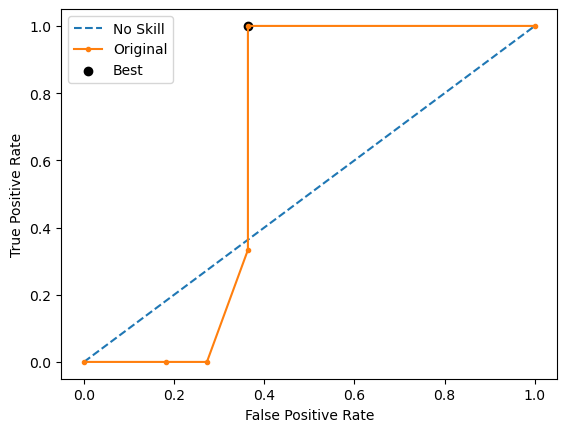

Run 2 - Random State: 1
Test G-mean: 0.5222329678670935
Best Threshold=1.000000, G-Mean=0.550


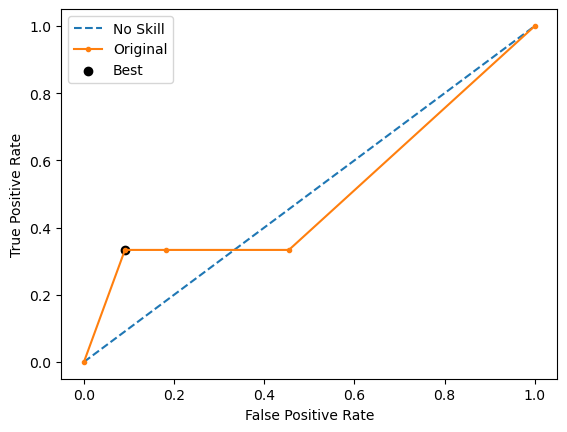

Run 3 - Random State: 2
Test G-mean: 0.5222329678670935
Best Threshold=0.666667, G-Mean=0.522


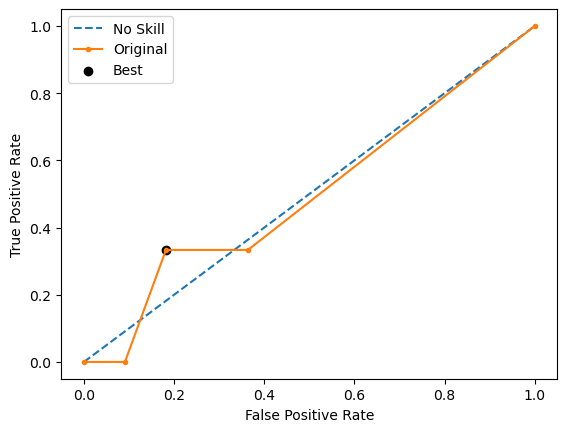

Run 4 - Random State: 3
Test G-mean: 0.4923659639173309
Best Threshold=0.666667, G-Mean=0.492


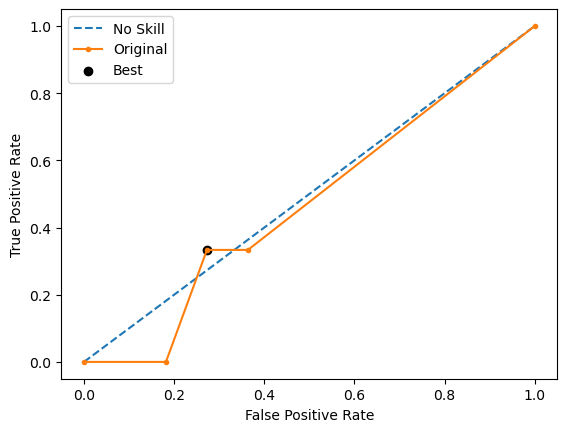

Run 5 - Random State: 4
Test G-mean: 0.4923659639173309
Best Threshold=1.000000, G-Mean=0.577


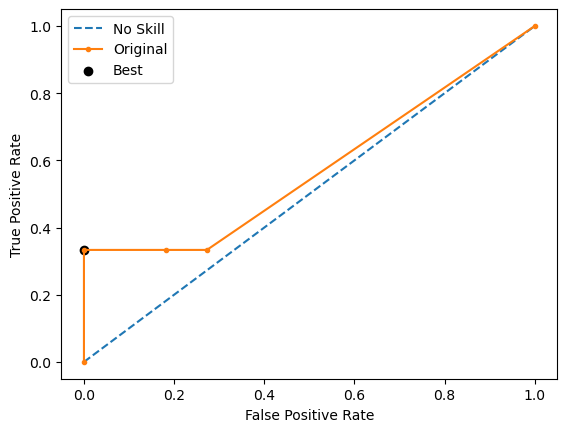

Ave Test G-mean: 0.49795281000813735
Stdev Test G-mean: 0.025686754608364455
Ave Test Specificity: 0.7454545454545455
Ave Test Recall: 0.3333333333333333
Ave Test NPV: 0.8028282828282828
Ave Test Accuracy: 0.6571428571428571
Ave Test Precision: 0.2733333333333333
Ave Test F1-Score: 0.2976190476190476
Ave Runtime: 0.02084827423095703


In [81]:
ho_t02_dt_gs, ho_t02_dt_be, ho_t02_dt_model_info, ho_t02_dt_metrics_df = dt_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'classifier__oob_score': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.275
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=2,
                                        n_estimators=200, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.8152556754247933
Std Train Score (G-mean) 0.07467434518411079
GridSearchCV Runtime: 122.15641117095947 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=0.340384, G-Mean=0.603


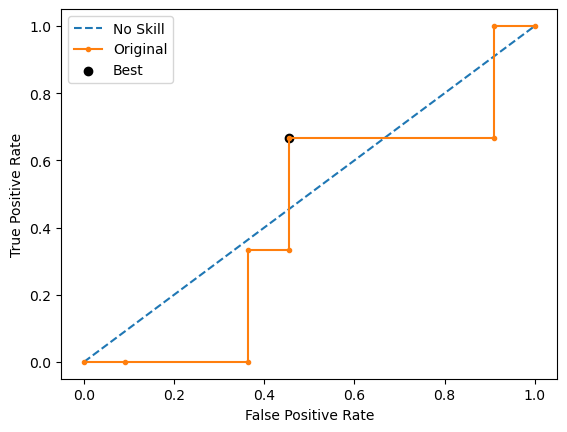

Run 2 - Random State: 1
Test G-mean: 0.6513389472789296
Best Threshold=0.609353, G-Mean=0.739


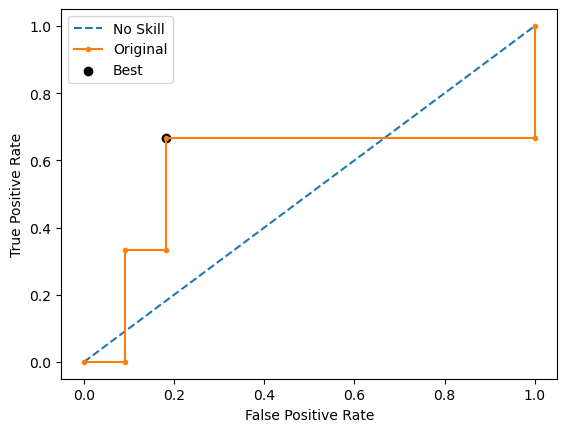

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.416129, G-Mean=0.853


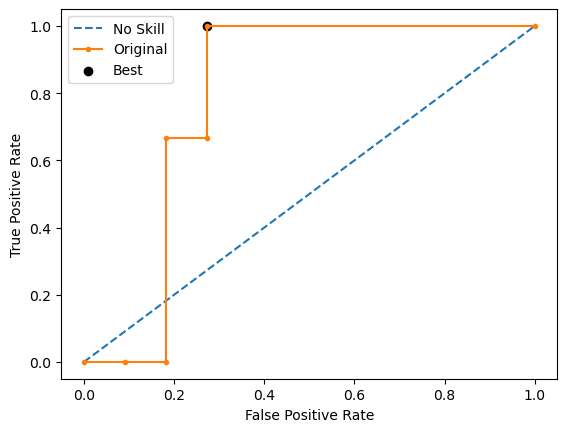

Run 4 - Random State: 3
Test G-mean: 0.4605661864718383
Best Threshold=0.423181, G-Mean=0.739


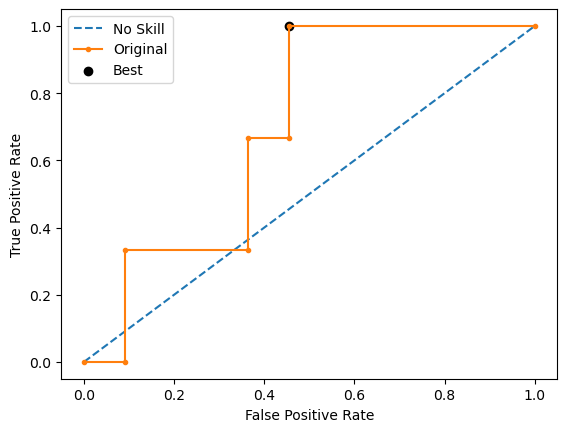

Run 5 - Random State: 4
Test G-mean: 0.4605661864718383
Best Threshold=0.342583, G-Mean=0.651


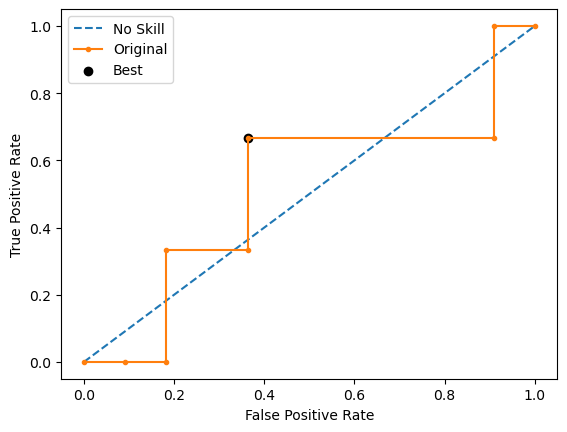

Ave Test G-mean: 0.31449426404452124
Stdev Test G-mean: 0.2974691739913244
Ave Test Specificity: 0.6909090909090909
Ave Test Recall: 0.26666666666666666
Ave Test NPV: 0.7815656565656566
Ave Test Accuracy: 0.6
Ave Test Precision: 0.14666666666666667
Ave Test F1-Score: 0.18888888888888888
Ave Runtime: 0.18544416427612304


In [82]:
ho_t02_rf_gs, ho_t02_rf_be, ho_t02_rf_model_info, ho_t02_rf_metrics_df = rf_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits


Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': None, 'classifier__solver': 'lbfgs', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.25
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, penalty=None,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 5.95582389831543 secs
Run 1 - Random State: 0
Test G-mean: 0.34815531191139565
Best Threshold=0.106863, G-Mean=0.426



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

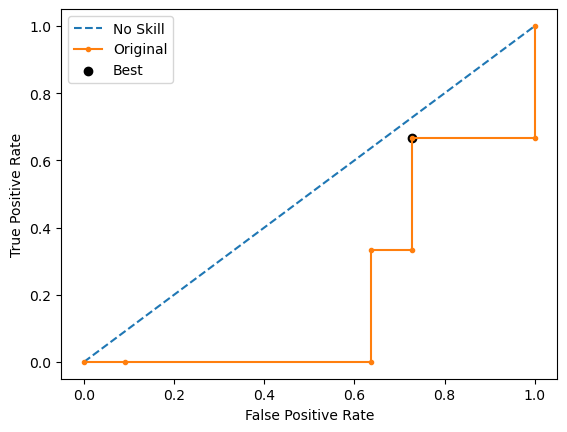

Setting penalty=None will ignore the C and l1_ratio parameters


Run 2 - Random State: 1
Test G-mean: 0.6513389472789296
Best Threshold=1.000000, G-Mean=0.739


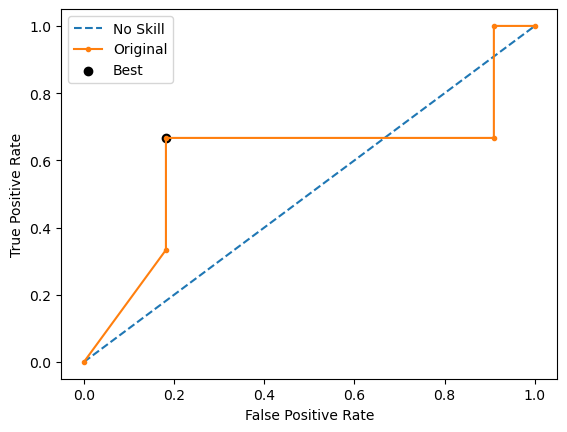

Run 3 - Random State: 2
Test G-mean: 0.8528028654224418
Best Threshold=0.943952, G-Mean=0.853


Setting penalty=None will ignore the C and l1_ratio parameters


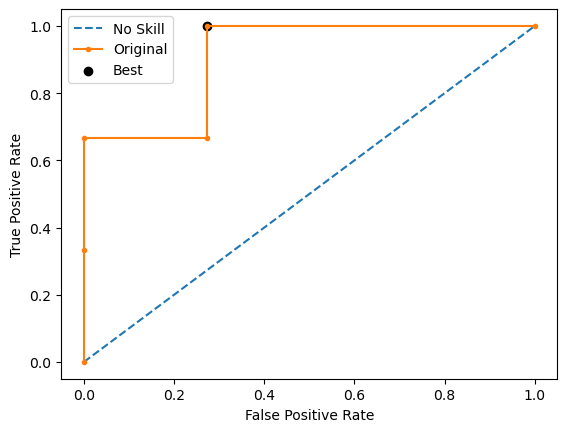

Run 4 - Random State: 3
Test G-mean: 0.30151134457776363
Best Threshold=0.966309, G-Mean=0.426


Setting penalty=None will ignore the C and l1_ratio parameters


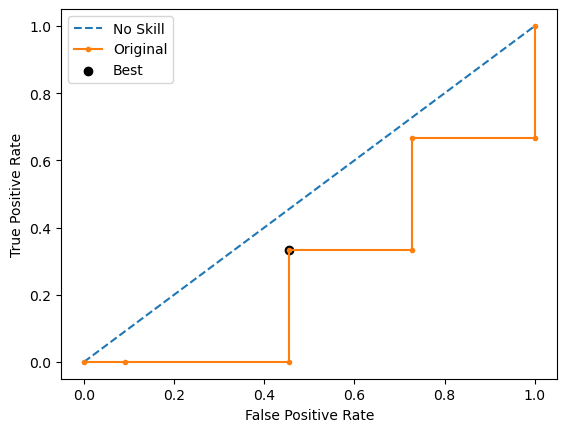

Run 5 - Random State: 4
Test G-mean: 0.0
Best Threshold=0.000000, G-Mean=0.674


Setting penalty=None will ignore the C and l1_ratio parameters


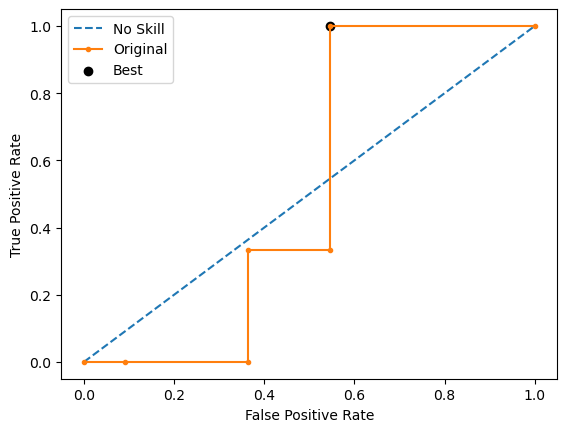

Ave Test G-mean: 0.43076169383810614
Stdev Test G-mean: 0.33009778068210044
Ave Test Specificity: 0.5272727272727272
Ave Test Recall: 0.4666666666666667
Ave Test NPV: 0.7683333333333333
Ave Test Accuracy: 0.5142857142857142
Ave Test Precision: 0.21388888888888888
Ave Test F1-Score: 0.2919191919191919
Ave Runtime: 0.019783735275268555


In [83]:
ho_t02_logreg_gs, ho_t02_logreg_be, ho_t02_logreg_model_info, ho_t02_logreg_metrics_df = logreg_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'poly', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.35
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='poly', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.6651012888223287
Std Train Score (G-mean) 0.09980555266546937
GridSearchCV Runtime: 7.649784088134766 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=0.486274, G-Mean=0.461


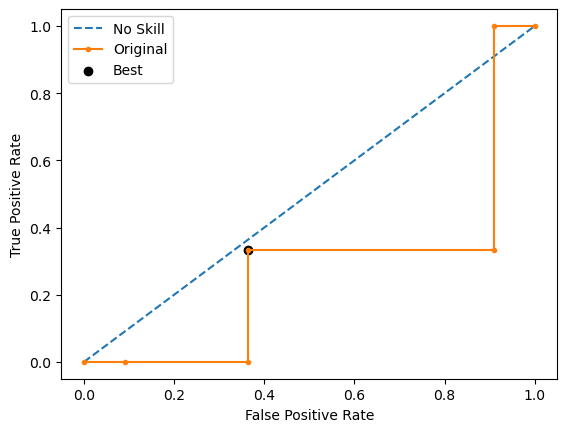

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.6963106238227913
Best Threshold=0.506776, G-Mean=0.778


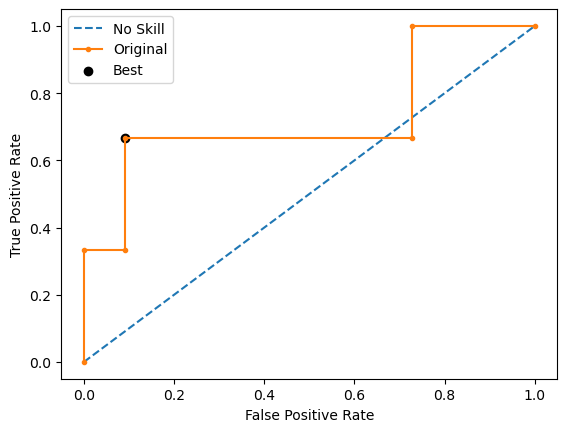

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.486730, G-Mean=0.522


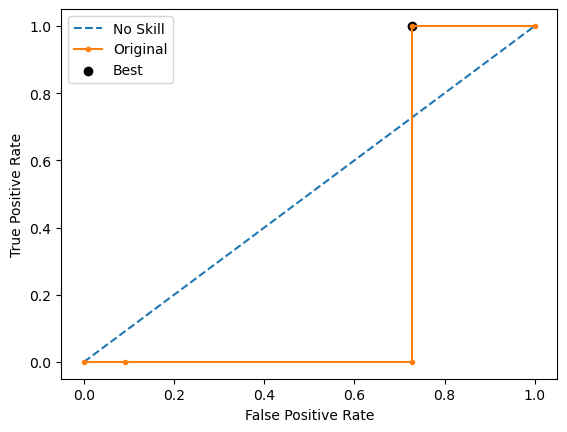

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.816496580927726
Best Threshold=0.491270, G-Mean=0.816


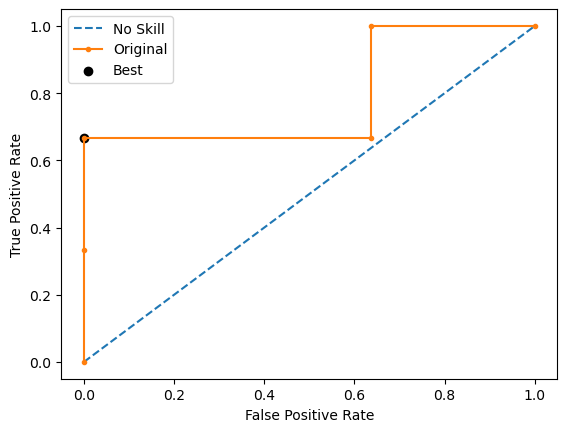

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.0
Best Threshold=0.516826, G-Mean=0.550


Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


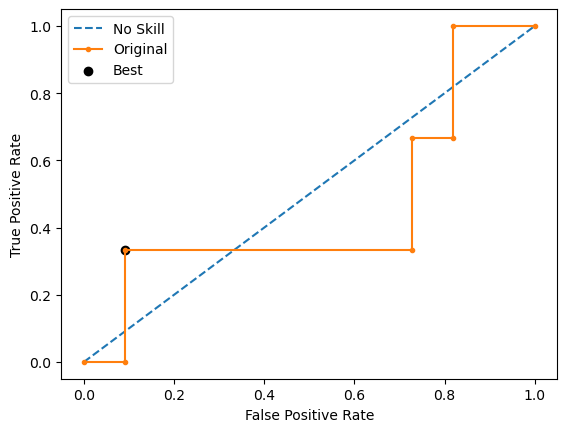

Ave Test G-mean: 0.3025614409501035
Stdev Test G-mean: 0.41647269531331127
Ave Test Specificity: 0.8181818181818181
Ave Test Recall: 0.26666666666666666
Ave Test NPV: 0.8015873015873016
Ave Test Accuracy: 0.7
Ave Test Precision: 0.27999999999999997
Ave Test F1-Score: 0.26
Ave Runtime: 0.02694091796875


In [84]:
ho_t02_svm_gs, ho_t02_svm_be, ho_t02_svm_model_info, ho_t02_svm_metrics_df = svm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

In [85]:
ho_t02_knn_gs, ho_t02_knn_be, ho_t02_knn_model_info, ho_t02_knn_metrics_df = knn_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 13, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.4666666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=13))])
Mean Train Score (G-mean) 0.48818872455615825
Std Train Score (G-mean) 0.12194813784031801
GridSearchCV Runtime: 8.871546506881714 secs
Run 1 - Random State: 0
Test G-mean: 0.3892494720807615
Run 2 - Random State: 1
Test G-mean: 0.5504818825631803
Run 3 - Random State: 2
Test G-mean: 0.8528028654224418
Run 4 - Random State: 3
Test G-mean: 0.7385489458759964
Run 5 - Random State: 4
Test G-mean: 0.4923659639173309
Ave Test G-mean: 0.6046898259719422
Stdev Test G-mean: 0.1880478938509291
Ave Test Specificity: 0.6363636363636364
Ave Test Recall: 0.6
Ave Test NPV: 0.8495238095

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.2833333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=3,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8341054963805543
Std Train Score (G-mean) 0.026357585805104257
GridSearchCV Runtime: 18.886526584625244 secs
Run 1 - Random State: 0
Test G-mean: 0.3892494720807615
Best Threshold=0.206670, G-Mean=0.603


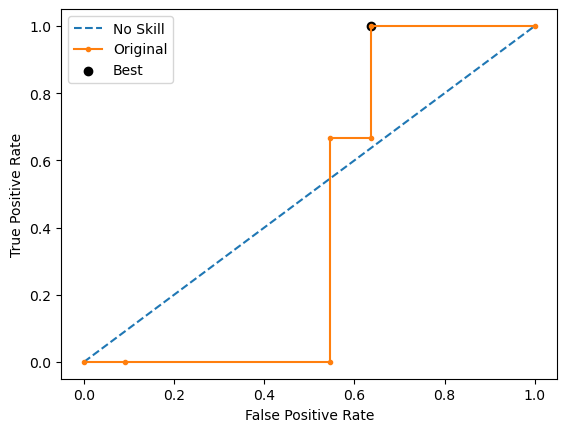

Run 2 - Random State: 1
Test G-mean: 0.5504818825631803
Best Threshold=1.000000, G-Mean=0.603


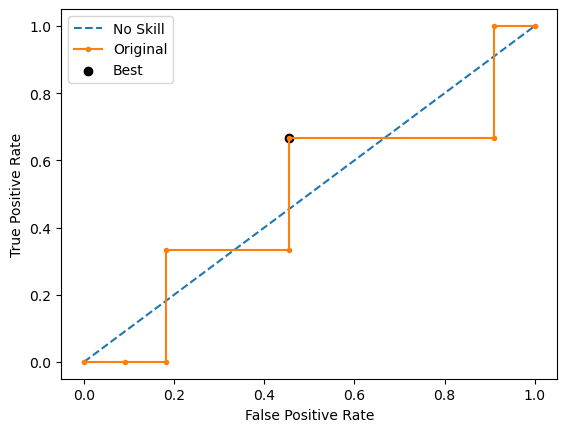

Run 3 - Random State: 2
Test G-mean: 0.8528028654224418
Best Threshold=1.000000, G-Mean=0.905


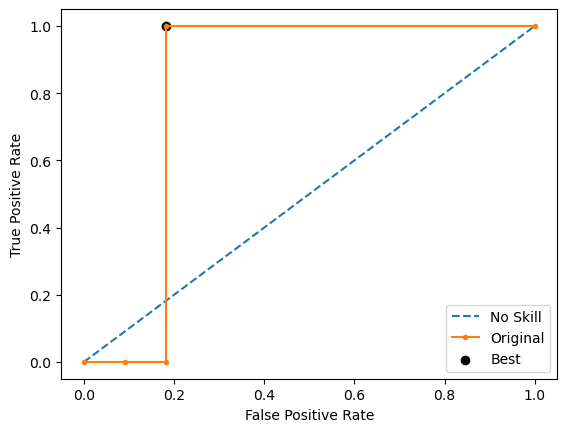

Run 4 - Random State: 3
Test G-mean: 0.7385489458759964
Best Threshold=0.995591, G-Mean=0.798


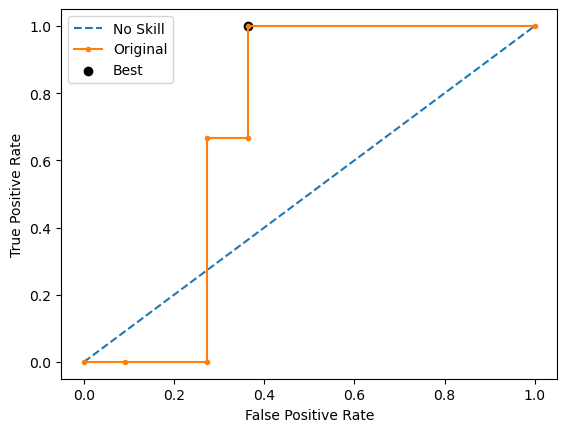

Run 5 - Random State: 4
Test G-mean: 0.5504818825631803
Best Threshold=0.999924, G-Mean=0.651


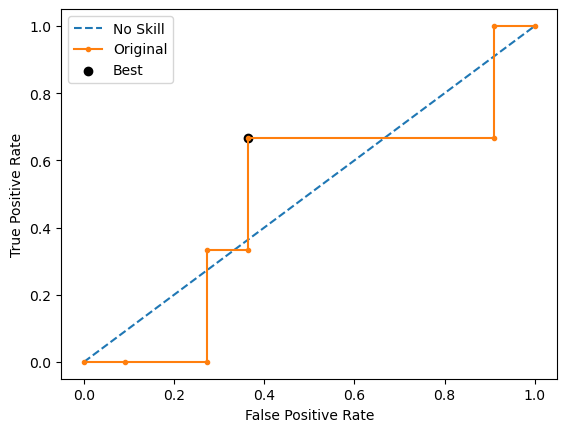

Ave Test G-mean: 0.616313009701112
Stdev Test G-mean: 0.18103480374558864
Ave Test Specificity: 0.5272727272727272
Ave Test Recall: 0.7333333333333333
Ave Test NPV: 0.8761904761904761
Ave Test Accuracy: 0.5714285714285714
Ave Test Precision: 0.30357142857142855
Ave Test F1-Score: 0.4278787878787879
Ave Runtime: 0.12033209800720215


In [90]:
ho_t02_gbm_gs, ho_t02_gbm_be, ho_t02_gbm_model_info, ho_t02_gbm_metrics_df = gbm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.35
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constraints=None, learning_rate=0.01,
            

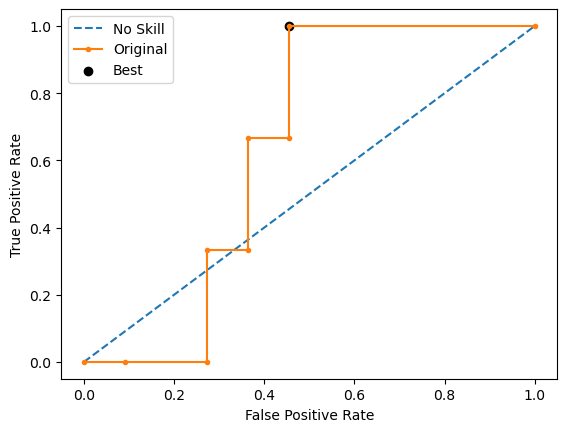

Run 2 - Random State: 1
Test G-mean: 0.7784989441615229
Best Threshold=0.594036, G-Mean=0.816


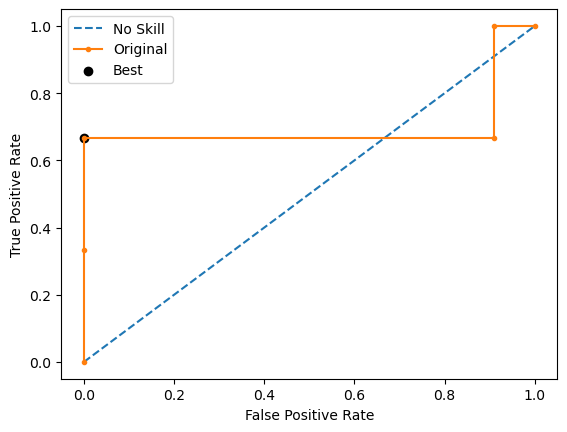

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.320381, G-Mean=0.853


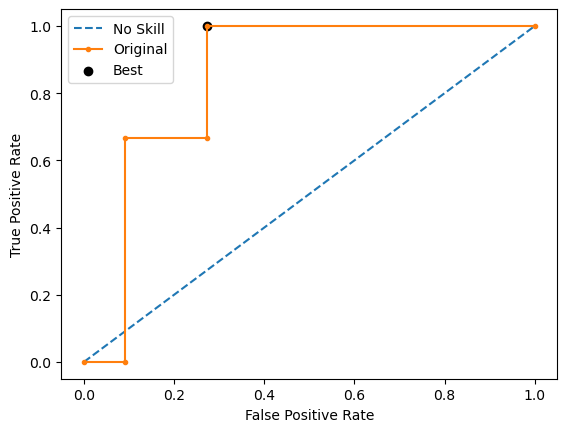

Run 4 - Random State: 3
Test G-mean: 0.6030226891555271
Best Threshold=0.419104, G-Mean=0.739


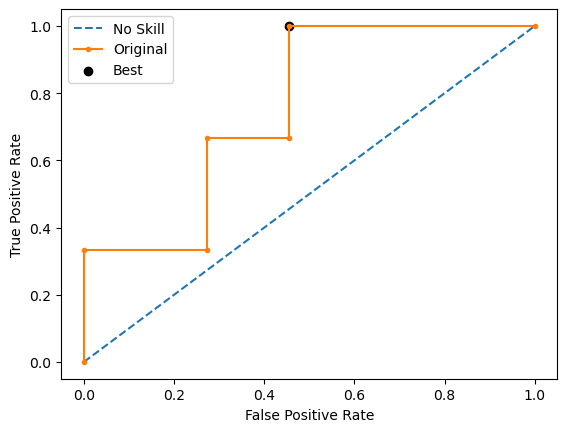

Run 5 - Random State: 4
Test G-mean: 0.6030226891555271
Best Threshold=0.156650, G-Mean=0.739


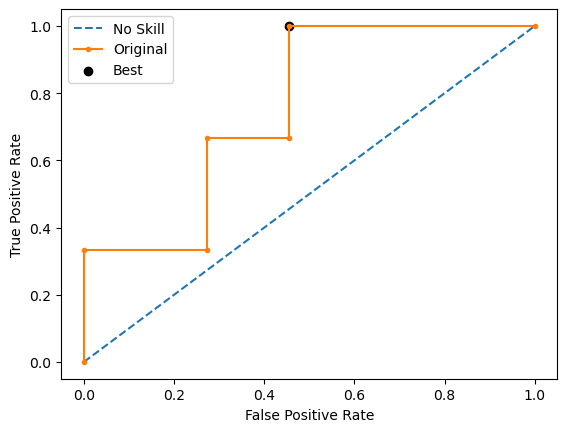

Ave Test G-mean: 0.39690886449451546
Stdev Test G-mean: 0.3693406624519242
Ave Test Specificity: 0.7272727272727273
Ave Test Recall: 0.4
Ave Test NPV: 0.8239760239760239
Ave Test Accuracy: 0.6571428571428571
Ave Test Precision: 0.24761904761904763
Ave Test F1-Score: 0.29333333333333333
Ave Runtime: 0.09479770660400391


In [87]:
ho_t02_xgb_gs, ho_t02_xgb_be, ho_t02_xgb_model_info, ho_t02_xgb_metrics_df = xgb_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.225
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8550923322034002
Std Train Score (G-mean) 0.03248384146993161
GridSearchCV Runtime: 2.7672033309936523 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


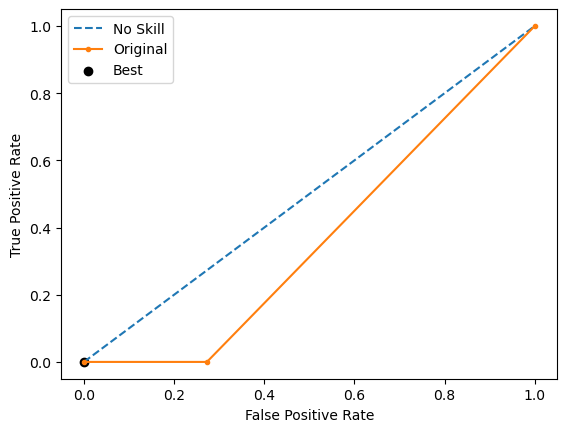

Run 2 - Random State: 1
Test G-mean: 0.6513389472789296
Best Threshold=0.880797, G-Mean=0.651


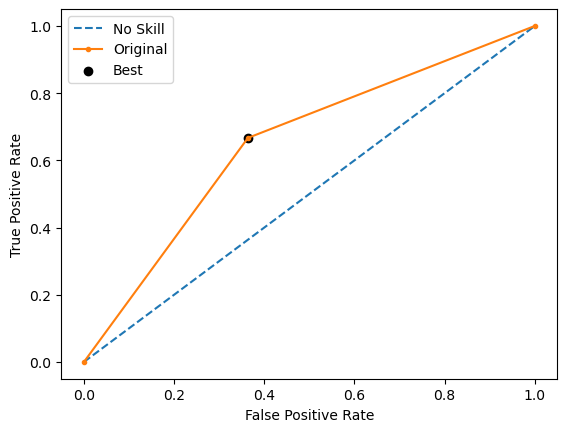

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


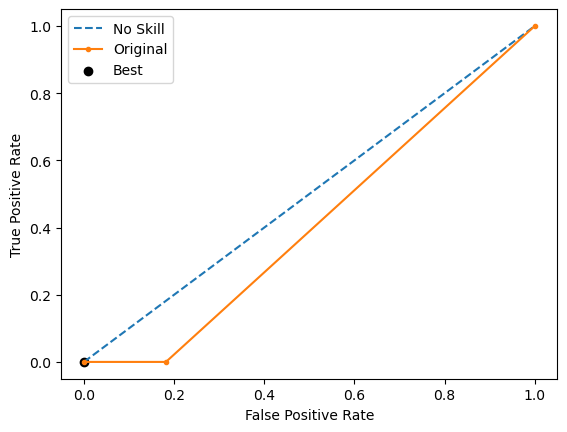

Run 4 - Random State: 3
Test G-mean: 0.4264014327112209
Best Threshold=0.880797, G-Mean=0.426


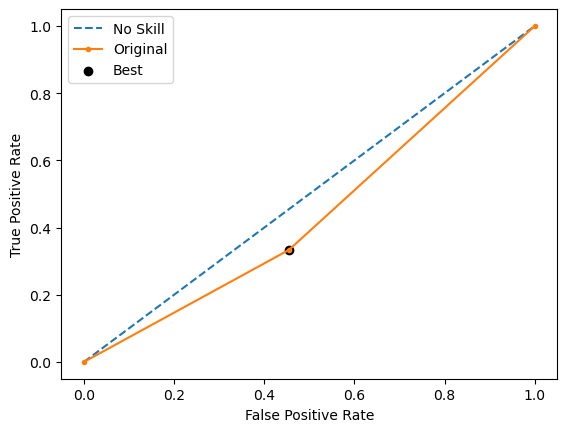

Run 5 - Random State: 4
Test G-mean: 0.4923659639173309
Best Threshold=0.880797, G-Mean=0.492


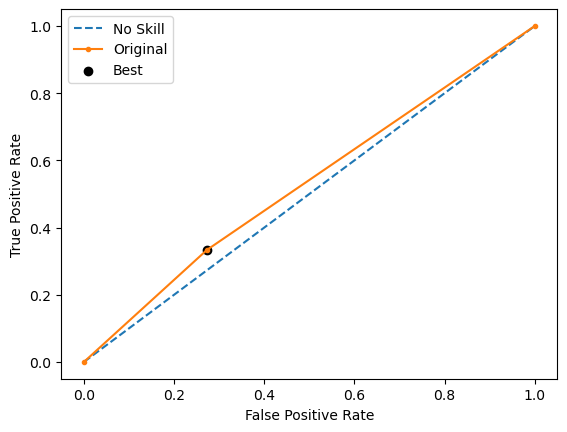

Ave Test G-mean: 0.3140212687814962
Stdev Test G-mean: 0.29809313236350515
Ave Test Specificity: 0.690909090909091
Ave Test Recall: 0.26666666666666666
Ave Test NPV: 0.7804545454545455
Ave Test Accuracy: 0.6
Ave Test Precision: 0.15
Ave Test F1-Score: 0.19047619047619047
Ave Runtime: 0.0861180305480957


In [88]:
ho_t02_adaboost_gs, ho_t02_adaboost_be, ho_t02_adaboost_model_info, ho_t02_adaboost_metrics_df = adaboost_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 31, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000531 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 671
[LightGBM] [Info] Number of data points in the train set: 62, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive 

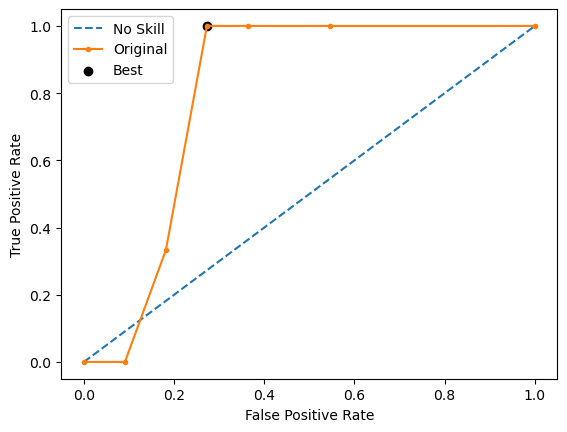

[LightGBM] [Info] Number of positive: 31, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000054 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 681
[LightGBM] [Info] Number of data points in the train set: 62, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

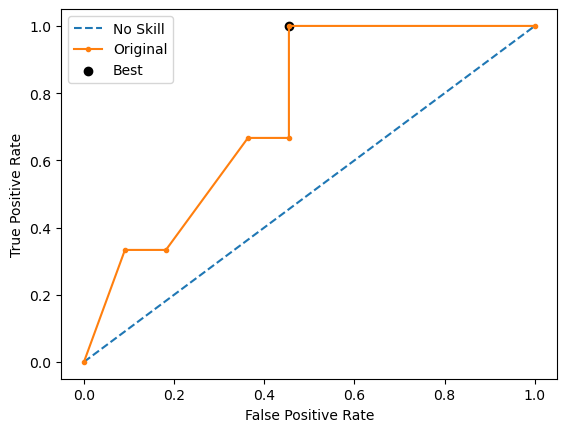

[LightGBM] [Info] Number of positive: 31, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000148 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 683
[LightGBM] [Info] Number of data points in the train set: 62, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

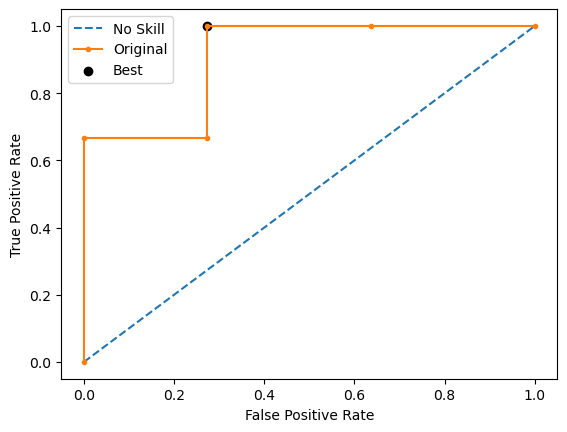

[LightGBM] [Info] Number of positive: 31, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 643
[LightGBM] [Info] Number of data points in the train set: 62, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

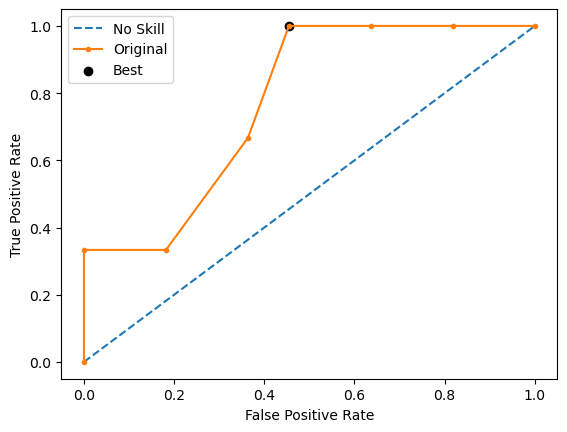

[LightGBM] [Info] Number of positive: 31, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 672
[LightGBM] [Info] Number of data points in the train set: 62, number of used features: 50
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

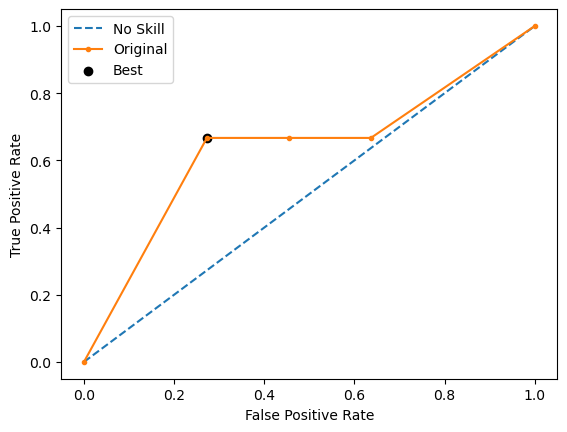

Ave Test G-mean: 0.4828572970923594
Stdev Test G-mean: 0.2824414267028605
Ave Test Specificity: 0.8
Ave Test Recall: 0.4
Ave Test NPV: 0.8355777555777555
Ave Test Accuracy: 0.7142857142857142
Ave Test Precision: 0.3238095238095238
Ave Test F1-Score: 0.340952380952381
Ave Runtime: 0.049769020080566405


In [91]:
ho_t02_lgbm_gs, ho_t02_lgbm_be, ho_t02_lgbm_model_info, ho_t02_lgbm_metrics_df = lgbm_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.001939
0:	learn: 0.6926308	total: 142ms	remaining: 2m 22s
1:	learn: 0.6915838	total: 144ms	remaining: 1m 11s
2:	learn: 0.6902381	total: 158ms	remaining: 52.4s
3:	learn: 0.6892913	total: 160ms	remaining: 39.9s
4:	learn: 0.6882541	total: 163ms	remaining: 32.5s
5:	learn: 0.6871920	total: 165ms	remaining: 27.3s
6:	learn: 0.6861533	total: 167ms	remaining: 23.7s
7:	learn: 0.6848279	total: 168ms	remaining: 20.9s
8:	learn: 0.6839124	total: 170ms	remaining: 18.7s
9:	learn: 0.6831573	total: 172ms	remaining: 17s
10:	learn: 0.6821559	total: 173ms	remaining: 15.6s
11:	learn: 0.6806424	total: 175ms	remaining: 14.4s
12:	learn: 0.6795670	total: 176ms	remaining: 13.4s
13:	learn: 0.6783878	total: 178ms	remaining: 12.6s
14:	learn: 0.6771921	total: 180ms	remaining: 11.8s
15:	learn: 0.6761231	total: 182ms	remaining: 11.2s
16:	learn: 0.6750825	total: 184ms	remaining: 10.6s
17:	learn: 0.6739168	total: 185ms	remaining: 10.1s
18:	learn: 0.6725632	total: 187ms	remaining: 9.63s
19:	learn: 

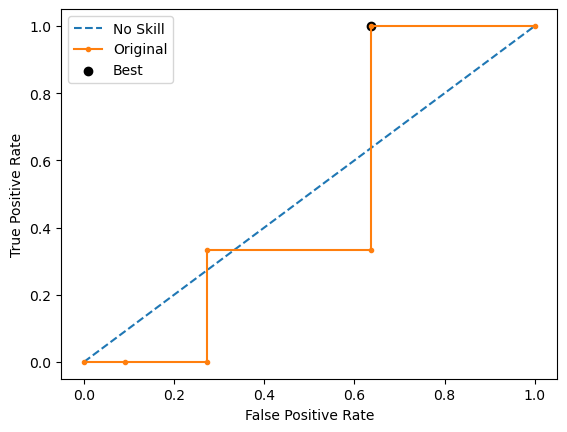

Learning rate set to 0.001939
0:	learn: 0.6917125	total: 1.96ms	remaining: 1.96s
1:	learn: 0.6907631	total: 15.7ms	remaining: 7.85s
2:	learn: 0.6900582	total: 16.8ms	remaining: 5.58s
3:	learn: 0.6891647	total: 18.4ms	remaining: 4.58s
4:	learn: 0.6877926	total: 19.6ms	remaining: 3.91s
5:	learn: 0.6868686	total: 20.8ms	remaining: 3.45s
6:	learn: 0.6858096	total: 22.1ms	remaining: 3.14s
7:	learn: 0.6846765	total: 23.4ms	remaining: 2.9s
8:	learn: 0.6832229	total: 24.6ms	remaining: 2.71s
9:	learn: 0.6817173	total: 26ms	remaining: 2.58s
10:	learn: 0.6805880	total: 27.3ms	remaining: 2.45s
11:	learn: 0.6796616	total: 28.7ms	remaining: 2.36s
12:	learn: 0.6784078	total: 30.2ms	remaining: 2.29s
13:	learn: 0.6776589	total: 31.9ms	remaining: 2.25s
14:	learn: 0.6766210	total: 33.3ms	remaining: 2.19s
15:	learn: 0.6754775	total: 34.6ms	remaining: 2.13s
16:	learn: 0.6741158	total: 35.8ms	remaining: 2.07s
17:	learn: 0.6728188	total: 37.1ms	remaining: 2.02s
18:	learn: 0.6717137	total: 38.3ms	remaining: 1

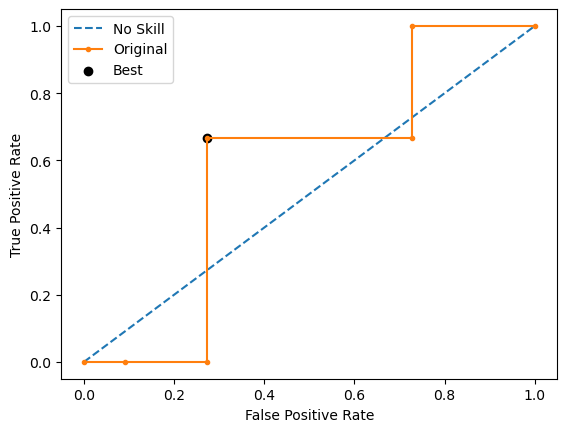

Learning rate set to 0.001939
0:	learn: 0.6918129	total: 1.67ms	remaining: 1.67s
1:	learn: 0.6899743	total: 4.29ms	remaining: 2.14s
2:	learn: 0.6887442	total: 6.29ms	remaining: 2.09s
3:	learn: 0.6876906	total: 8.25ms	remaining: 2.05s
4:	learn: 0.6863025	total: 10.2ms	remaining: 2.02s
5:	learn: 0.6854423	total: 11.9ms	remaining: 1.98s
6:	learn: 0.6842358	total: 13.7ms	remaining: 1.95s
7:	learn: 0.6831412	total: 16.2ms	remaining: 2.01s
8:	learn: 0.6817066	total: 22.2ms	remaining: 2.44s
9:	learn: 0.6804355	total: 23.7ms	remaining: 2.35s
10:	learn: 0.6793847	total: 25.1ms	remaining: 2.26s
11:	learn: 0.6779263	total: 26.4ms	remaining: 2.17s
12:	learn: 0.6766438	total: 27.6ms	remaining: 2.1s
13:	learn: 0.6753657	total: 28.9ms	remaining: 2.03s
14:	learn: 0.6741918	total: 29.7ms	remaining: 1.95s
15:	learn: 0.6725091	total: 31ms	remaining: 1.9s
16:	learn: 0.6712951	total: 32.1ms	remaining: 1.85s
17:	learn: 0.6699059	total: 33.2ms	remaining: 1.81s
18:	learn: 0.6681963	total: 34ms	remaining: 1.75

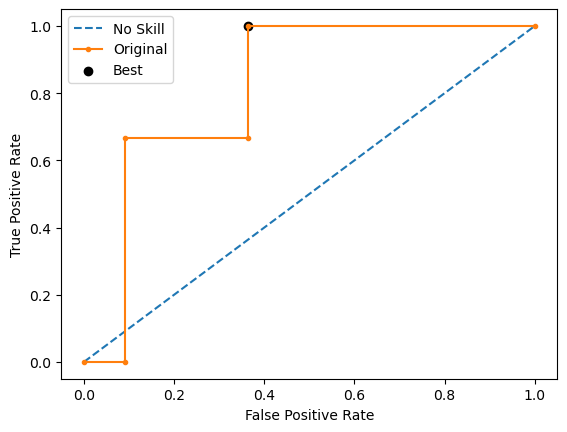

Learning rate set to 0.001939
0:	learn: 0.6916950	total: 1.75ms	remaining: 1.75s
1:	learn: 0.6901948	total: 3.78ms	remaining: 1.89s
2:	learn: 0.6893333	total: 4.95ms	remaining: 1.65s
3:	learn: 0.6881439	total: 6.63ms	remaining: 1.65s
4:	learn: 0.6870265	total: 8.12ms	remaining: 1.62s
5:	learn: 0.6854456	total: 10.2ms	remaining: 1.69s
6:	learn: 0.6844229	total: 12.3ms	remaining: 1.74s
7:	learn: 0.6833487	total: 13.9ms	remaining: 1.72s
8:	learn: 0.6821872	total: 15.6ms	remaining: 1.72s
9:	learn: 0.6809731	total: 17.1ms	remaining: 1.7s
10:	learn: 0.6800340	total: 18.7ms	remaining: 1.68s
11:	learn: 0.6788507	total: 20.3ms	remaining: 1.67s
12:	learn: 0.6774848	total: 21.7ms	remaining: 1.65s
13:	learn: 0.6763134	total: 23.2ms	remaining: 1.63s
14:	learn: 0.6751401	total: 24.6ms	remaining: 1.62s
15:	learn: 0.6738319	total: 26.2ms	remaining: 1.61s
16:	learn: 0.6725857	total: 27.5ms	remaining: 1.59s
17:	learn: 0.6714466	total: 28.9ms	remaining: 1.58s
18:	learn: 0.6704355	total: 29.8ms	remaining:

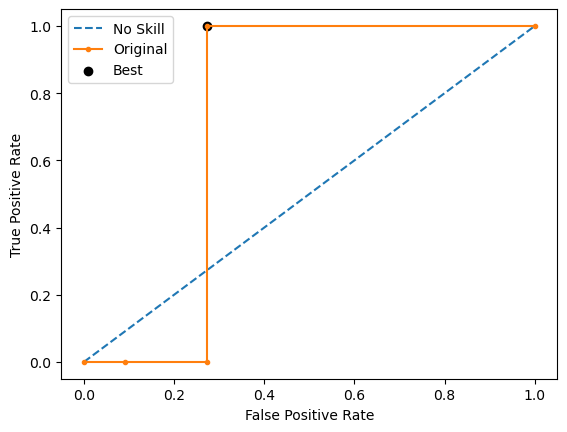

Learning rate set to 0.001939
0:	learn: 0.6917215	total: 1.89ms	remaining: 1.89s
1:	learn: 0.6901824	total: 3.43ms	remaining: 1.71s
2:	learn: 0.6889638	total: 5.23ms	remaining: 1.74s
3:	learn: 0.6877862	total: 7.18ms	remaining: 1.79s
4:	learn: 0.6868027	total: 9.2ms	remaining: 1.83s
5:	learn: 0.6853637	total: 10.8ms	remaining: 1.79s
6:	learn: 0.6841312	total: 12.6ms	remaining: 1.79s
7:	learn: 0.6830344	total: 14.2ms	remaining: 1.76s
8:	learn: 0.6815532	total: 15.8ms	remaining: 1.75s
9:	learn: 0.6802827	total: 17.6ms	remaining: 1.75s
10:	learn: 0.6787576	total: 19.4ms	remaining: 1.74s
11:	learn: 0.6773186	total: 20.8ms	remaining: 1.72s
12:	learn: 0.6757466	total: 22.3ms	remaining: 1.69s
13:	learn: 0.6749243	total: 23.8ms	remaining: 1.68s
14:	learn: 0.6733780	total: 39.1ms	remaining: 2.57s
15:	learn: 0.6720874	total: 40.6ms	remaining: 2.49s
16:	learn: 0.6708200	total: 41.7ms	remaining: 2.41s
17:	learn: 0.6690348	total: 43ms	remaining: 2.35s
18:	learn: 0.6684560	total: 43.9ms	remaining: 2

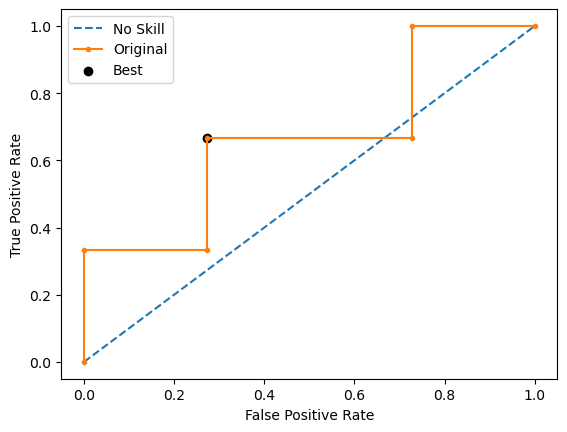

Ave Test G-mean: 0.6163578552060891
Stdev Test G-mean: 0.13248767992318894
Ave Test Specificity: 0.6000000000000001
Ave Test Recall: 0.6666666666666666
Ave Test NPV: 0.8692063492063491
Ave Test Accuracy: 0.6142857142857143
Ave Test Precision: 0.3173015873015873
Ave Test F1-Score: 0.4238095238095238
Ave Runtime: 1.5398875713348388


In [92]:
ho_t02_catboost_gs, ho_t02_catboost_be, ho_t02_catboost_model_info, ho_t02_catboost_metrics_df = catboost_class2(ho_t02, 'precision',
                                                            'home_ownership_class', random_state=0)

In [93]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t02_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t02_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t02_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
9,CatBoost,0.616358,0.132488,0.250000,0.888176,0.600000,0.666667,0.317302,0.423810,0.614286
5,Gradient Boosting Machine (GBM),0.616313,0.181035,0.283333,0.834105,0.527273,0.733333,0.303571,0.427879,0.571429
0,k-Nearest Neighbors,0.604690,0.188048,0.466667,0.488189,0.636364,0.600000,0.328571,0.417489,0.628571
3,Decision Tree,0.497953,0.025687,0.383333,NaN,0.745455,0.333333,0.273333,0.297619,0.657143
6,LightGBM,0.482857,0.282441,0.383333,0.427361,0.800000,0.400000,0.323810,0.340952,0.714286
2,Logistic Regression,0.430762,0.330098,0.250000,NaN,0.527273,0.466667,0.213889,0.291919,0.514286
7,Extreme Gradient Boosting (XGBoost),0.396909,0.369341,0.350000,0.846635,0.727273,0.400000,0.247619,0.293333,0.657143
4,Random Forest,0.314494,0.297469,0.275000,0.815256,0.690909,0.266667,0.146667,0.188889,0.600000
8,AdaBoost,0.314021,0.298093,0.225000,0.855092,0.690909,0.266667,0.150000,0.190476,0.600000
1,SVM Classifier,0.302561,0.416473,0.350000,0.665101,0.818182,0.266667,0.280000,0.260000,0.700000


In [94]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t02_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.714286,LightGBM
Highest Test G-mean,0.616358,CatBoost
Highest Test Recall,0.733333,Gradient Boosting Machine (GBM)
Highest Test Precision,0.328571,k-Nearest Neighbors
Highest Test Specificity,0.818182,SVM Classifier
Highest Test F1-score,0.427879,Gradient Boosting Machine (GBM)


# HO-T03 Runs

In [95]:
ho_t03.shape, ho_t02.shape

((55, 46), (55, 54))

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
1988 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.38333333333333336
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, max_features='sqrt',
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 68.17767214775085 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


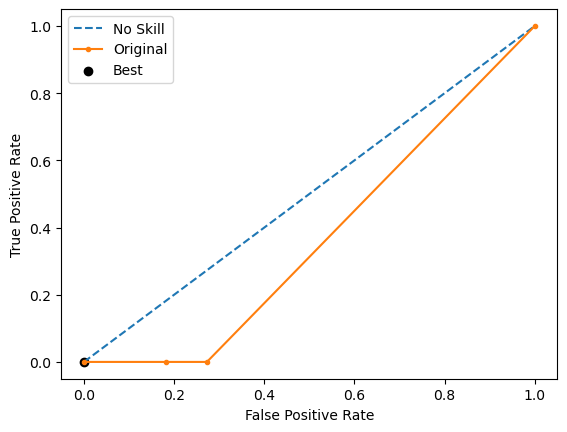

Run 2 - Random State: 1
Test G-mean: 0.4264014327112209
Best Threshold=1.000000, G-Mean=0.550


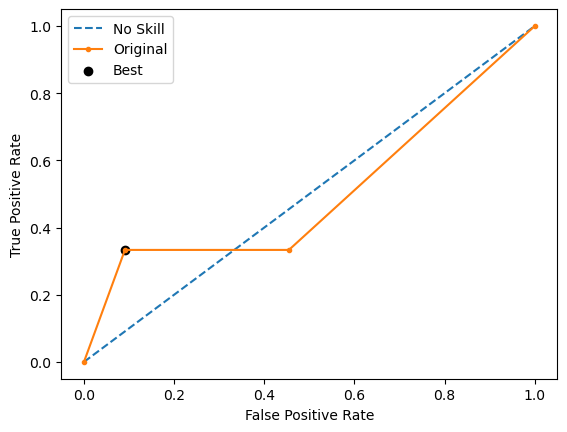

Run 3 - Random State: 2
Test G-mean: 0.7385489458759964
Best Threshold=1.000000, G-Mean=0.739


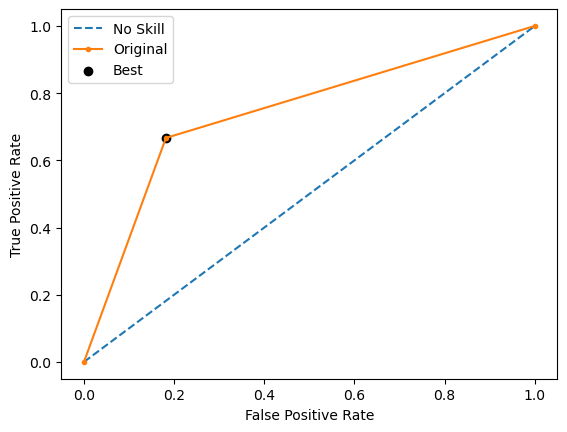

Run 4 - Random State: 3
Test G-mean: 0.6513389472789296
Best Threshold=0.666667, G-Mean=0.651


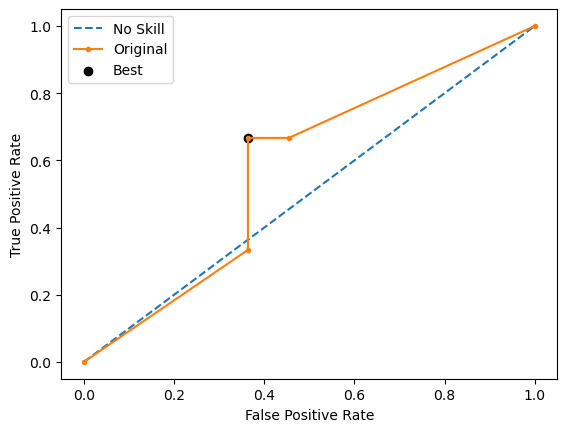

Run 5 - Random State: 4
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


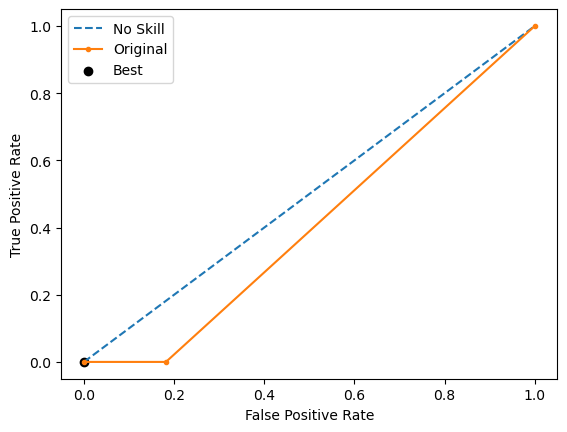

Ave Test G-mean: 0.36325786517322933
Stdev Test G-mean: 0.35061865625779637
Ave Test Specificity: 0.7272727272727273
Ave Test Recall: 0.3333333333333333
Ave Test NPV: 0.805
Ave Test Accuracy: 0.6428571428571428
Ave Test Precision: 0.2
Ave Test F1-Score: 0.24761904761904763
Ave Runtime: 0.01420130729675293


In [96]:
ho_t03_dt_gs, ho_t03_dt_be, ho_t03_dt_model_info, ho_t03_dt_metrics_df = dt_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.2833333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0,
                                    solver='liblinear'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 14.720220804214478 secs
Run 1 - Random State: 0
Test G-mean: 0.6513389472789296
Best Threshold=0.691551, G-Mean=0.651



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

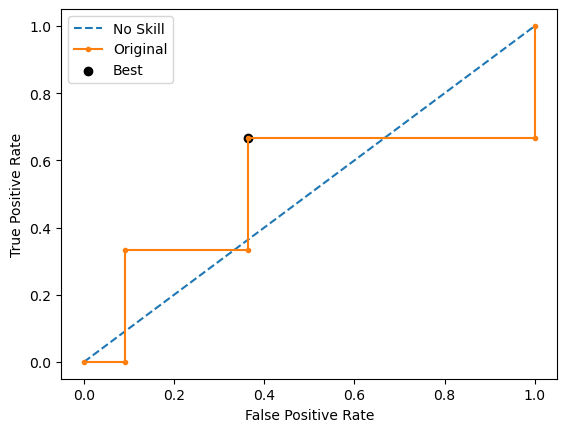

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=0.837924, G-Mean=0.651


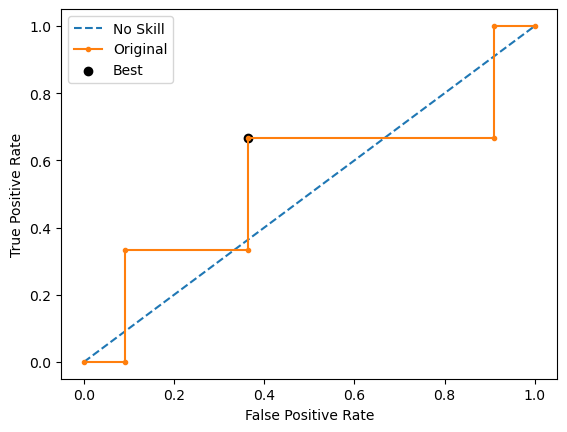

Run 3 - Random State: 2
Test G-mean: 0.7977240352174656
Best Threshold=0.783223, G-Mean=0.905


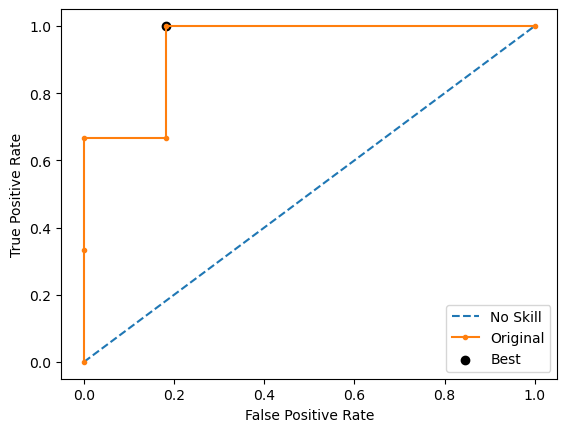

Run 4 - Random State: 3
Test G-mean: 0.4264014327112209
Best Threshold=0.793009, G-Mean=0.798


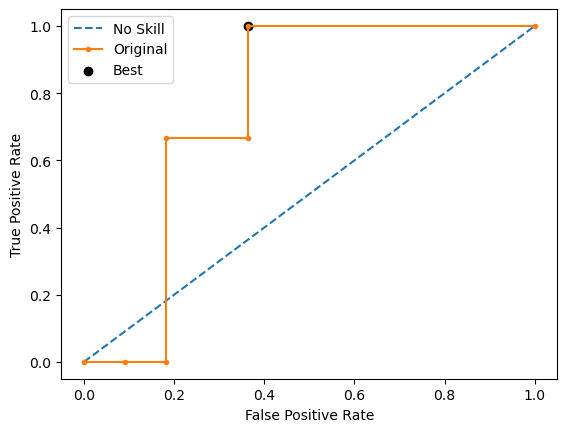

Run 5 - Random State: 4
Test G-mean: 0.4264014327112209
Best Threshold=0.575175, G-Mean=0.492


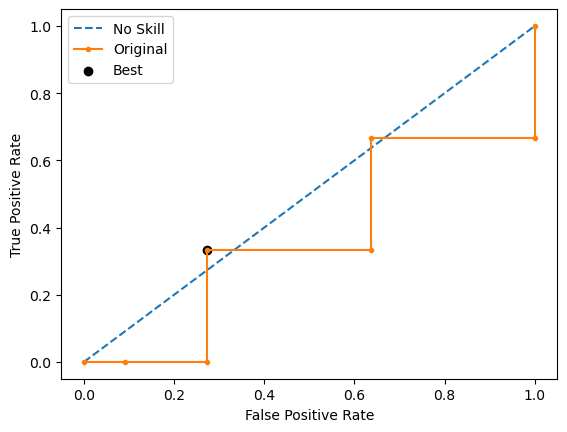

Ave Test G-mean: 0.5809777074148729
Stdev Test G-mean: 0.1582745283625731
Ave Test Specificity: 0.509090909090909
Ave Test Recall: 0.7333333333333333
Ave Test NPV: 0.8964285714285716
Ave Test Accuracy: 0.5571428571428572
Ave Test Precision: 0.29285714285714287
Ave Test F1-Score: 0.4133333333333334
Ave Runtime: 0.01726555824279785


In [97]:
ho_t03_logreg_gs, ho_t03_logreg_be, ho_t03_logreg_model_info, ho_t03_logreg_metrics_df = logreg_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 100.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4333333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 SVC(C=100.0, kernel='sigmoid', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.6566357885288227
Std Train Score (G-mean) 0.10517315456734432
GridSearchCV Runtime: 19.54076075553894 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.6513389472789296
Best Threshold=0.336934, G-Mean=0.696


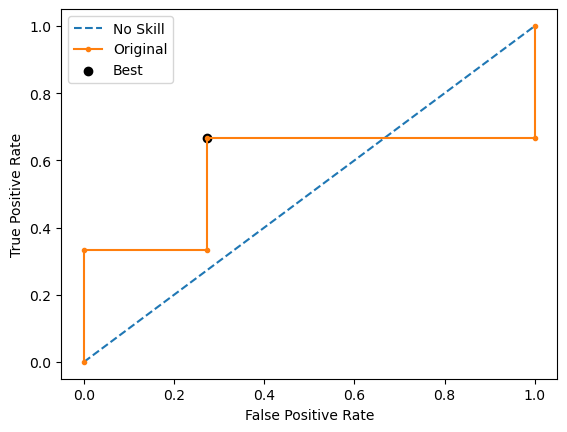

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5222329678670935
Best Threshold=0.374077, G-Mean=0.651


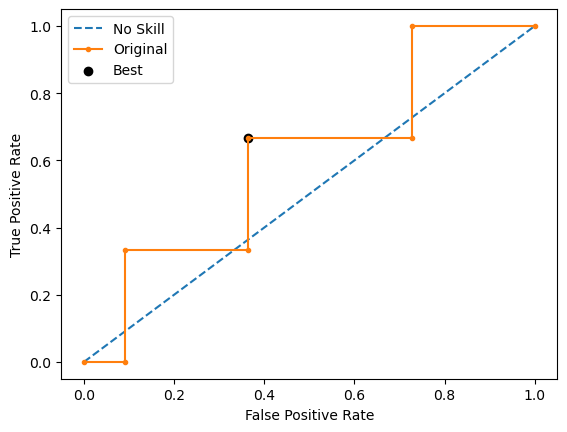

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6030226891555271
Best Threshold=0.997059, G-Mean=0.778


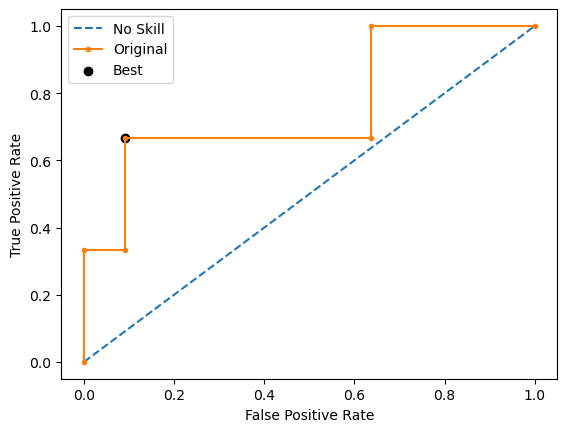

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.7385489458759964
Best Threshold=0.415028, G-Mean=0.853


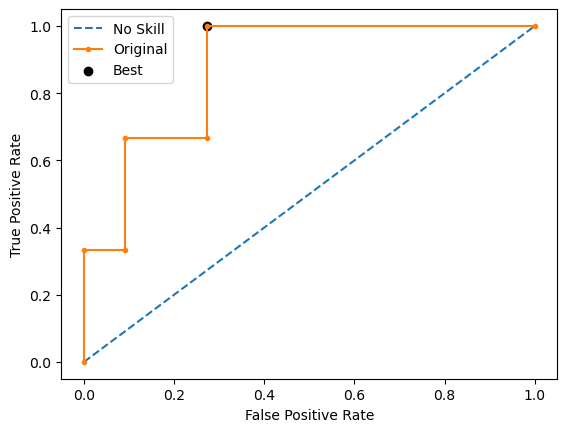

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5504818825631803
Best Threshold=0.341787, G-Mean=0.674


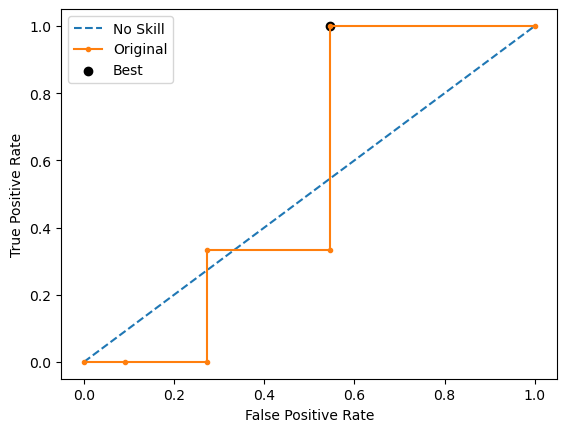

Ave Test G-mean: 0.6131250865481455
Stdev Test G-mean: 0.0858473213291409
Ave Test Specificity: 0.6
Ave Test Recall: 0.6666666666666666
Ave Test NPV: 0.8767316017316018
Ave Test Accuracy: 0.6142857142857143
Ave Test Precision: 0.31547619047619047
Ave Test F1-Score: 0.41737373737373734
Ave Runtime: 0.01660184860229492


In [98]:
ho_t03_svm_gs, ho_t03_svm_be, ho_t03_svm_model_info, ho_t03_svm_metrics_df = svm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

In [99]:
ho_t03_knn_gs, ho_t03_knn_be, ho_t03_knn_model_info, ho_t03_knn_metrics_df = knn_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 11, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.55
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=11))])
Mean Train Score (G-mean) 0.514642065841189
Std Train Score (G-mean) 0.12645101883028814
GridSearchCV Runtime: 26.562851905822754 secs
Run 1 - Random State: 0
Test G-mean: 0.4605661864718383
Run 2 - Random State: 1
Test G-mean: 0.4923659639173309
Run 3 - Random State: 2
Test G-mean: 0.6963106238227913
Run 4 - Random State: 3
Test G-mean: 0.7385489458759964
Run 5 - Random State: 4
Test G-mean: 0.6513389472789296
Ave Test G-mean: 0.6078261334733772
Stdev Test G-mean: 0.12432604958829989
Ave Test Specificity: 0.7090909090909

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                        

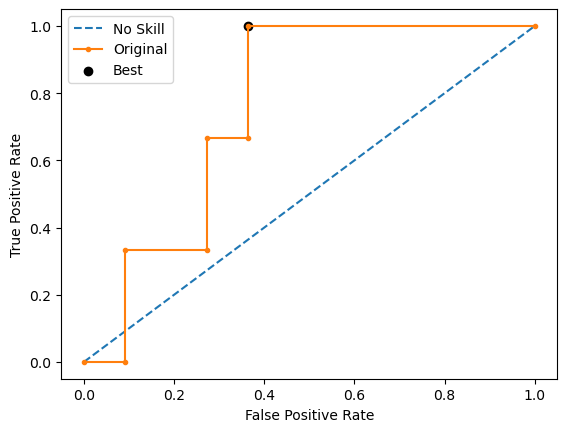

Run 2 - Random State: 1
Test G-mean: 0.5222329678670935
Best Threshold=0.261446, G-Mean=0.651


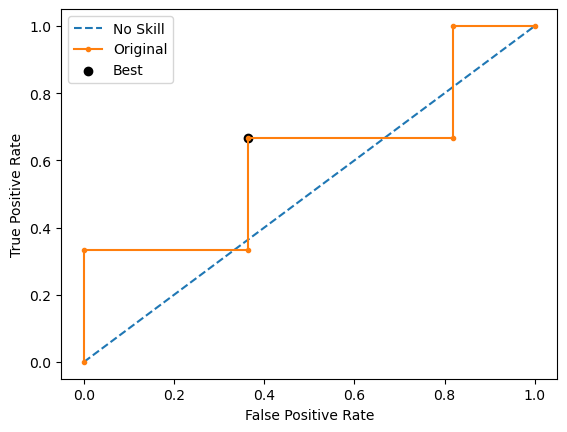

Run 3 - Random State: 2
Test G-mean: 0.5504818825631802
Best Threshold=0.203865, G-Mean=0.739


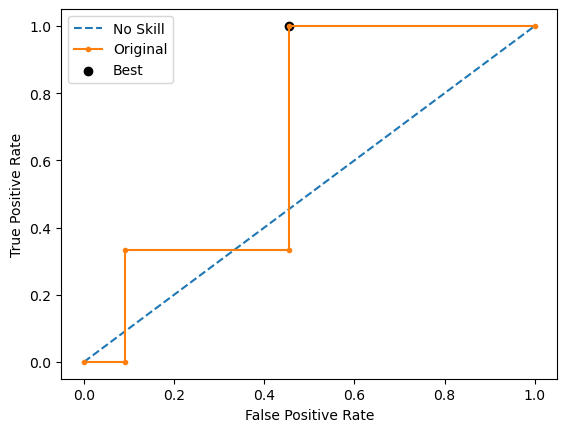

Run 4 - Random State: 3
Test G-mean: 0.6963106238227913
Best Threshold=0.502441, G-Mean=0.696


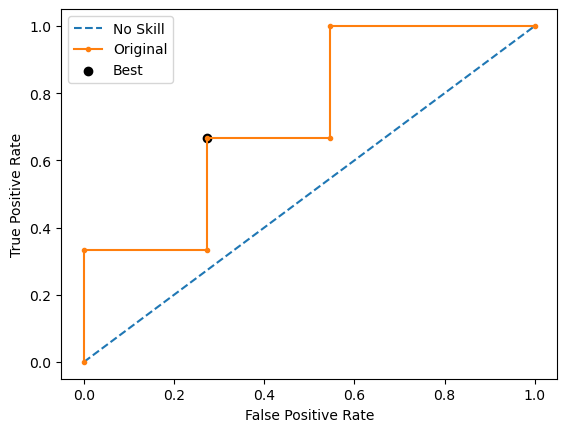

Run 5 - Random State: 4
Test G-mean: 0.6030226891555271
Best Threshold=0.888030, G-Mean=0.816


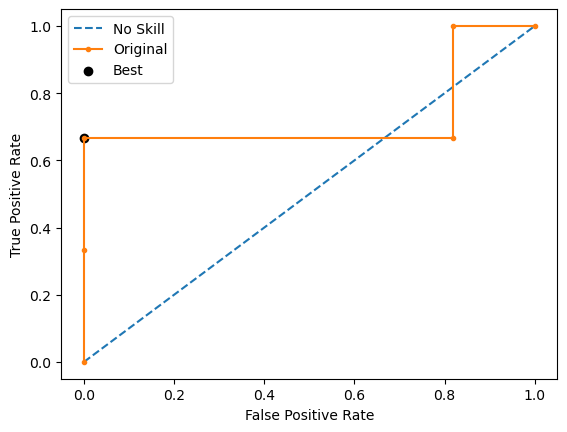

Ave Test G-mean: 0.5728828254651845
Stdev Test G-mean: 0.08014519340203824
Ave Test Specificity: 0.7454545454545454
Ave Test Recall: 0.4666666666666666
Ave Test NPV: 0.8395093795093794
Ave Test Accuracy: 0.6857142857142857
Ave Test Precision: 0.3538095238095238
Ave Test F1-Score: 0.38380952380952377
Ave Runtime: 0.08953008651733399


In [100]:
ho_t03_xgb_gs, ho_t03_xgb_be, ho_t03_xgb_model_info, ho_t03_xgb_metrics_df = xgb_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[LightGBM] [Info] Number of positive: 30, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000618 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 547
[LightGBM] [Info] Number of data points in the train set: 61, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491803 -> initscore=-0.032790
[LightGBM] [Info] Start training from score -0.032790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM

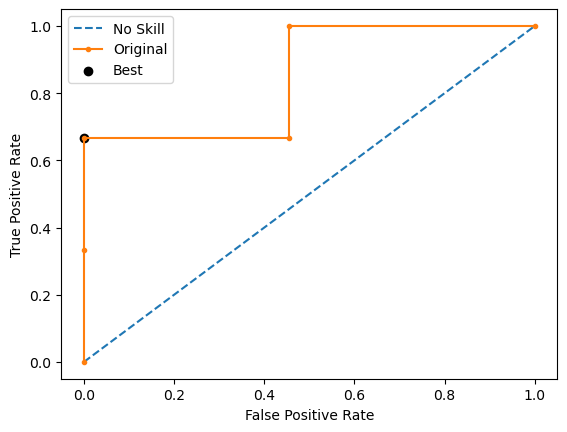

[LightGBM] [Info] Number of positive: 34, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000138 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 593
[LightGBM] [Info] Number of data points in the train set: 65, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.523077 -> initscore=0.092373
[LightGBM] [Info] Start training from score 0.092373
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

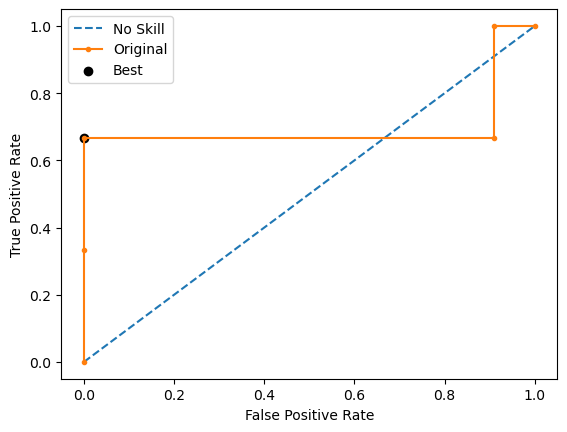

[LightGBM] [Info] Number of positive: 29, number of negative: 31
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 538
[LightGBM] [Info] Number of data points in the train set: 60, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483333 -> initscore=-0.066691
[LightGBM] [Info] Start training from score -0.066691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

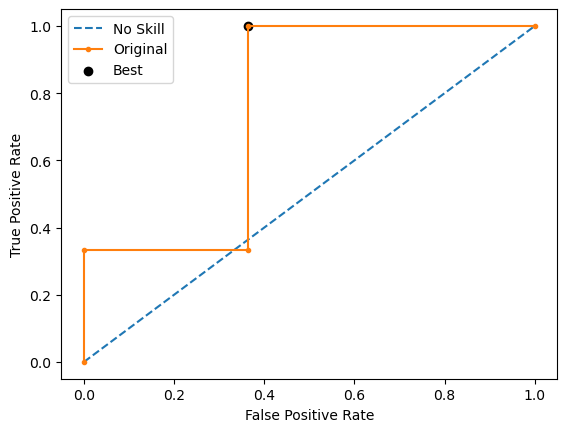

[LightGBM] [Info] Number of positive: 28, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000251 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 59, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.474576 -> initscore=-0.101783
[LightGBM] [Info] Start training from score -0.101783
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

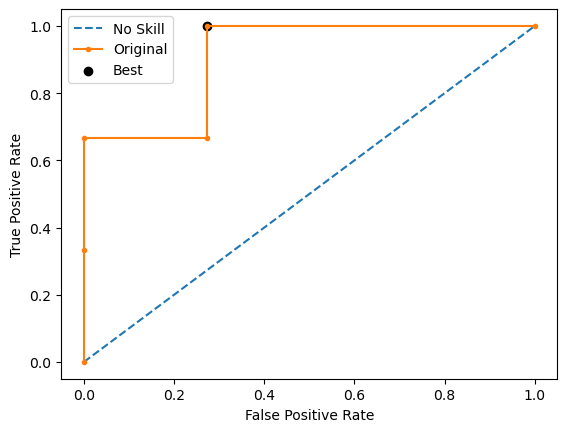

[LightGBM] [Info] Number of positive: 29, number of negative: 31
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000272 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 539
[LightGBM] [Info] Number of data points in the train set: 60, number of used features: 42
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483333 -> initscore=-0.066691
[LightGBM] [Info] Start training from score -0.066691
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

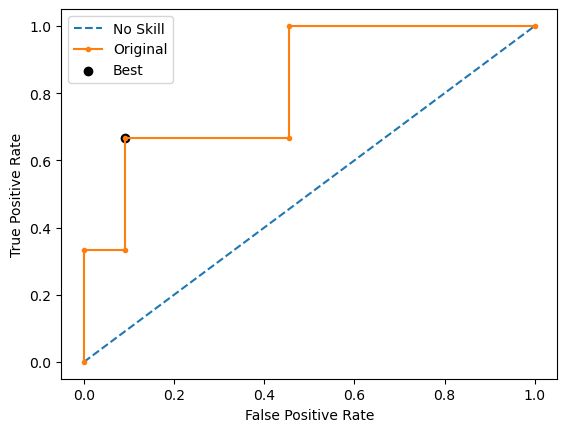

Ave Test G-mean: 0.6684076737225303
Stdev Test G-mean: 0.157709576340112
Ave Test Specificity: 0.8
Ave Test Recall: 0.5999999999999999
Ave Test NPV: 0.8839926739926739
Ave Test Accuracy: 0.7571428571428571
Ave Test Precision: 0.6071428571428571
Ave Test F1-Score: 0.5304761904761904
Ave Runtime: 0.06070342063903809


In [101]:
ho_t03_lgbm_gs, ho_t03_lgbm_be, ho_t03_lgbm_model_info, ho_t03_lgbm_metrics_df = lgbm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.4666666666666666
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8373805026243109
Std Train Score (G-mean) 0.028981406721918335
GridSearchCV Runtime: 21.550211191177368 secs
Run 1 - Random State: 0
Test G-mean: 0.4923659639173309
Best Threshold=0.000000, G-Mean=0.674


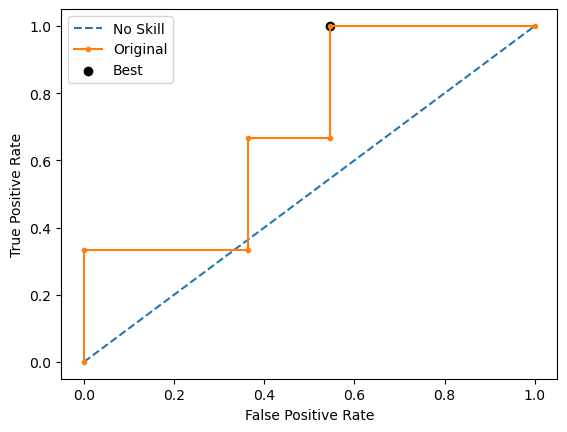

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=1.000000, G-Mean=0.778


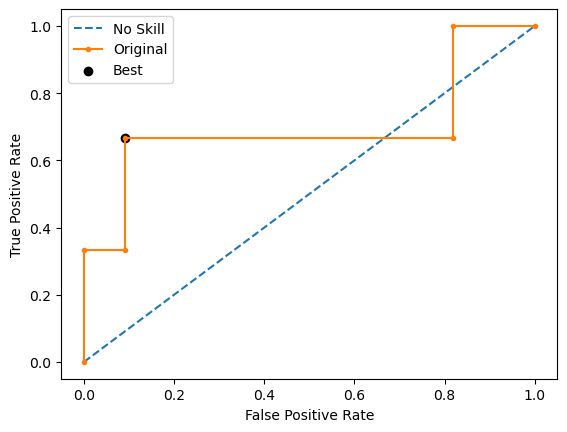

Run 3 - Random State: 2
Test G-mean: 0.4264014327112209
Best Threshold=0.000000, G-Mean=0.674


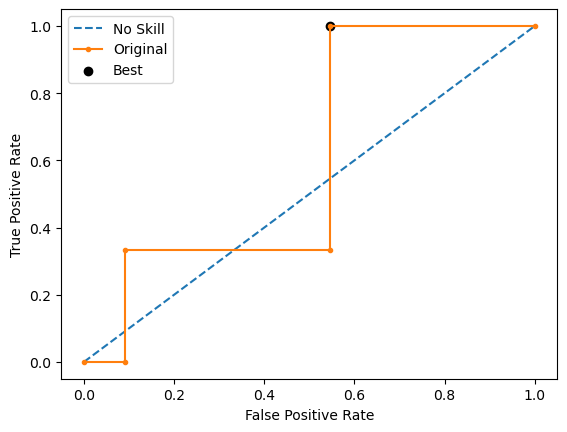

Run 4 - Random State: 3
Test G-mean: 0.34815531191139565
Best Threshold=1.000000, G-Mean=0.348


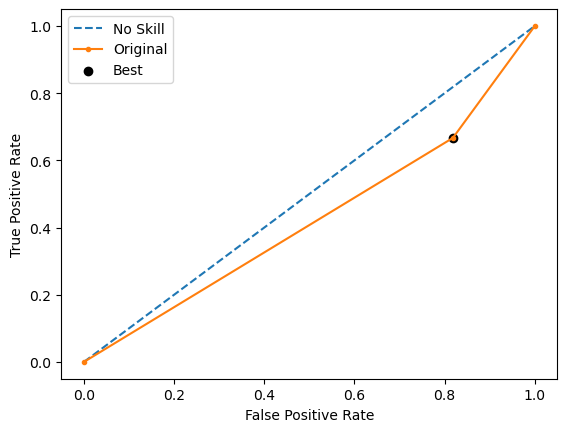

Run 5 - Random State: 4
Test G-mean: 0.4605661864718383
Best Threshold=0.008865, G-Mean=0.798


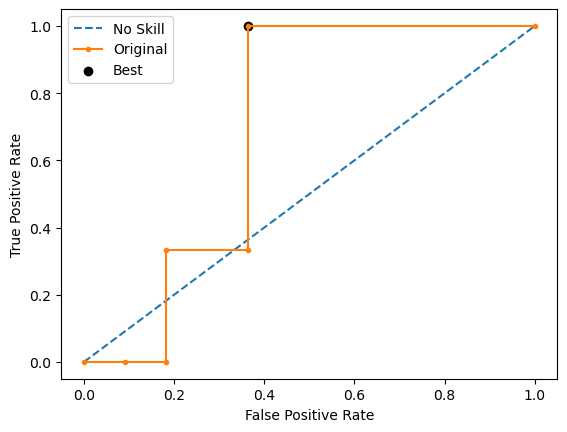

Ave Test G-mean: 0.46610231683346254
Stdev Test G-mean: 0.09348164582488026
Ave Test Specificity: 0.5272727272727272
Ave Test Recall: 0.4666666666666667
Ave Test NPV: 0.7703174603174603
Ave Test Accuracy: 0.5142857142857142
Ave Test Precision: 0.21683982683982683
Ave Test F1-Score: 0.2887301587301587
Ave Runtime: 0.18311104774475098


In [102]:
ho_t03_gbm_gs, ho_t03_gbm_be, ho_t03_gbm_model_info, ho_t03_gbm_metrics_df = gbm_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.225
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.8546791625557105
Std Train Score (G-mean) 0.03432306533333543
GridSearchCV Runtime: 5.5918169021606445 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


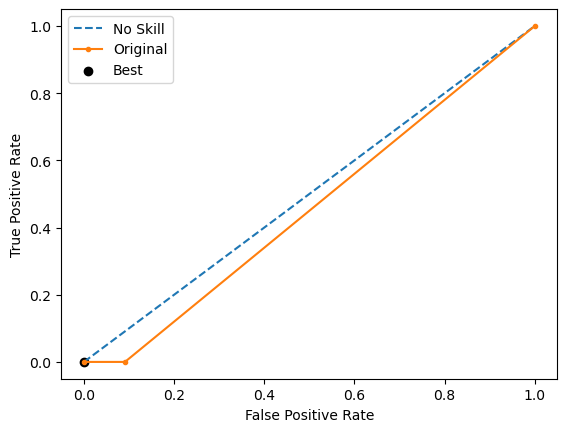

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=0.880797, G-Mean=0.603


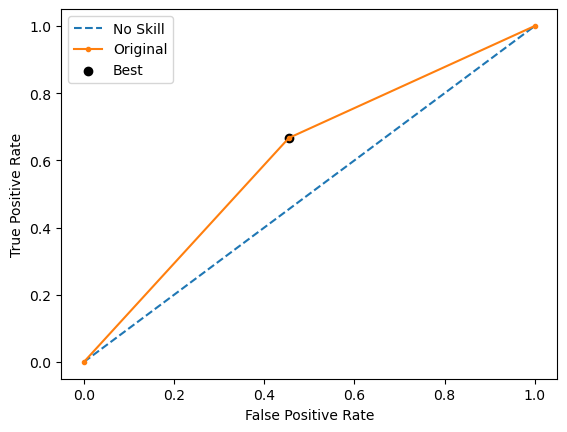

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


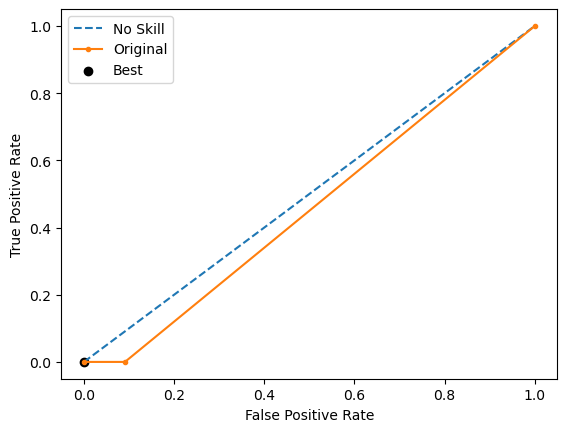

Run 4 - Random State: 3
Test G-mean: 0.6513389472789296
Best Threshold=0.880797, G-Mean=0.651


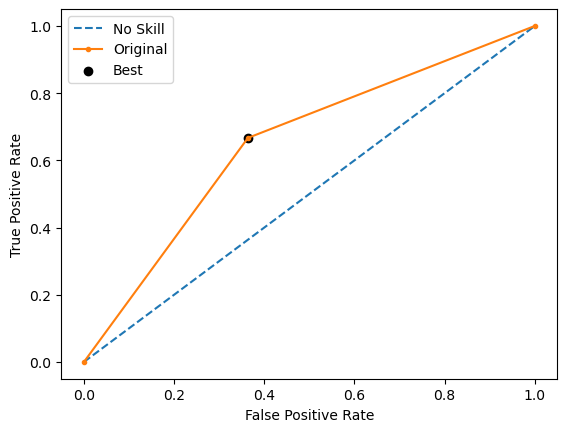

Run 5 - Random State: 4
Test G-mean: 0.4923659639173309
Best Threshold=0.880797, G-Mean=0.492


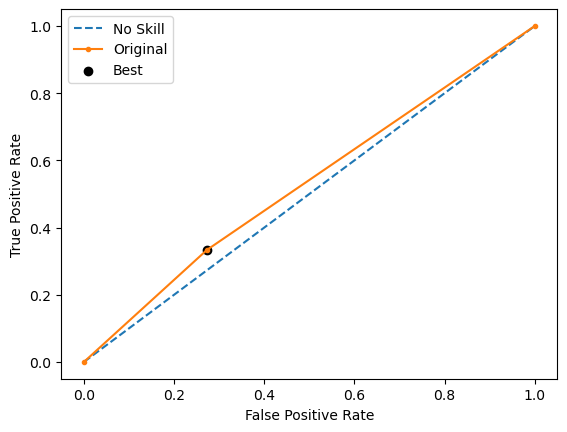

Ave Test G-mean: 0.3493455200703576
Stdev Test G-mean: 0.3240723562481407
Ave Test Specificity: 0.7454545454545455
Ave Test Recall: 0.3333333333333333
Ave Test NPV: 0.8141208791208792
Ave Test Accuracy: 0.6571428571428571
Ave Test Precision: 0.1738095238095238
Ave Test F1-Score: 0.22603174603174603
Ave Runtime: 0.10955100059509278


In [103]:
ho_t03_adaboost_gs, ho_t03_adaboost_be, ho_t03_adaboost_model_info, ho_t03_adaboost_metrics_df = adaboost_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.3583333333333333
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.8058149967972917
Std Train Score (G-mean) 0.0733202469396461
GridSearchCV Runtime: 177.04920172691345 secs
Run 1 - Random State: 0
Test G-mean: 0.4605661864718383
Best Threshold=0.377928, G-Mean=0.522


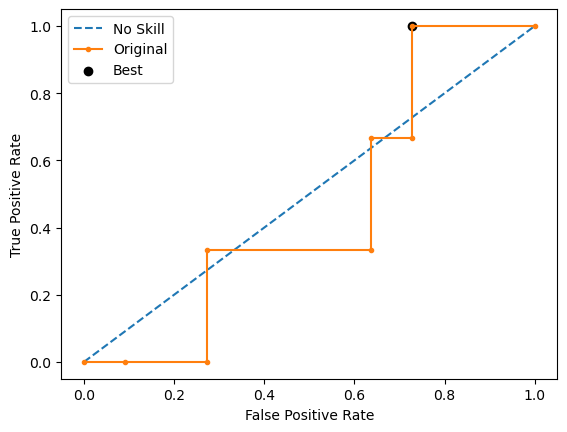

Run 2 - Random State: 1
Test G-mean: 0.6030226891555271
Best Threshold=0.577563, G-Mean=0.739


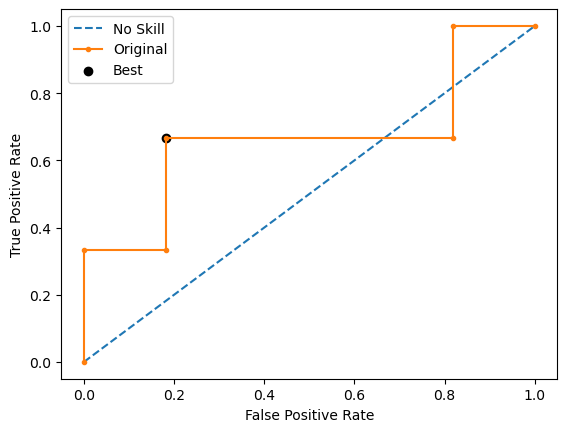

Run 3 - Random State: 2
Test G-mean: 0.7977240352174656
Best Threshold=0.732587, G-Mean=0.816


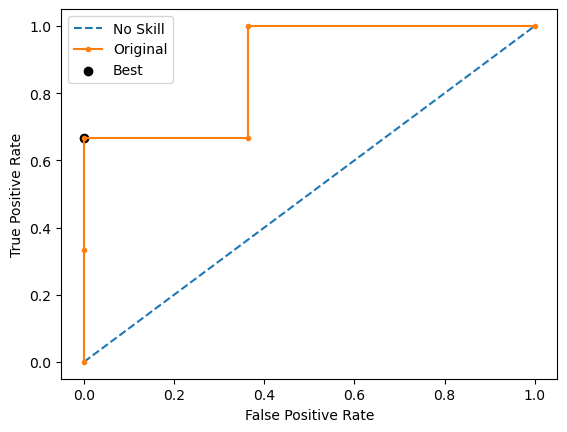

Run 4 - Random State: 3
Test G-mean: 0.6030226891555271
Best Threshold=0.564490, G-Mean=0.696


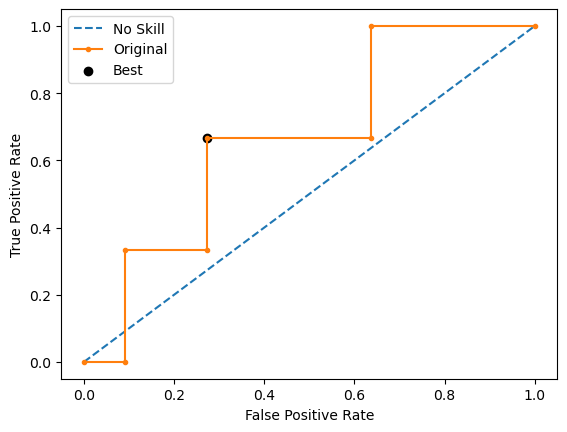

Run 5 - Random State: 4
Test G-mean: 0.4264014327112209
Best Threshold=0.630269, G-Mean=0.696


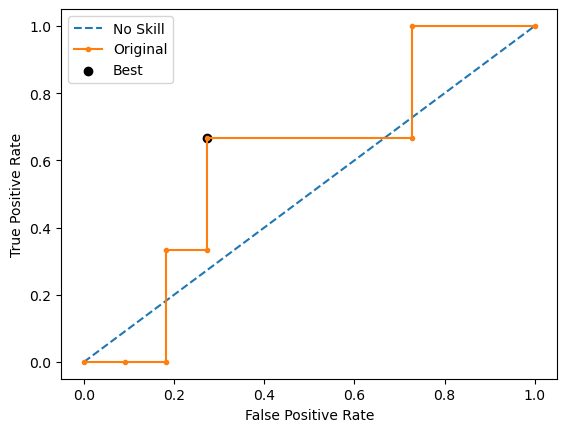

Ave Test G-mean: 0.5781474065423158
Stdev Test G-mean: 0.14688740510823953
Ave Test Specificity: 0.5272727272727271
Ave Test Recall: 0.6666666666666666
Ave Test NPV: 0.8484126984126984
Ave Test Accuracy: 0.5571428571428572
Ave Test Precision: 0.27999999999999997
Ave Test F1-Score: 0.3915384615384615
Ave Runtime: 0.253458833694458


In [104]:
ho_t03_rf_gs, ho_t03_rf_be, ho_t03_rf_model_info, ho_t03_rf_metrics_df = rf_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.002305
0:	learn: 0.6916715	total: 1.73ms	remaining: 1.73s
1:	learn: 0.6900191	total: 3.57ms	remaining: 1.78s
2:	learn: 0.6886443	total: 5.31ms	remaining: 1.76s
3:	learn: 0.6872971	total: 6.92ms	remaining: 1.72s
4:	learn: 0.6856407	total: 8.57ms	remaining: 1.71s
5:	learn: 0.6844940	total: 10.1ms	remaining: 1.68s
6:	learn: 0.6832165	total: 11.7ms	remaining: 1.67s
7:	learn: 0.6812552	total: 13.3ms	remaining: 1.65s
8:	learn: 0.6798412	total: 14.9ms	remaining: 1.64s
9:	learn: 0.6783400	total: 16.7ms	remaining: 1.65s
10:	learn: 0.6763548	total: 18.5ms	remaining: 1.66s
11:	learn: 0.6748565	total: 20.4ms	remaining: 1.68s
12:	learn: 0.6730659	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6719607	total: 24.6ms	remaining: 1.73s
14:	learn: 0.6694594	total: 26.7ms	remaining: 1.75s
15:	learn: 0.6679210	total: 28.7ms	remaining: 1.76s
16:	learn: 0.6662449	total: 30.3ms	remaining: 1.75s
17:	learn: 0.6649128	total: 32.1ms	

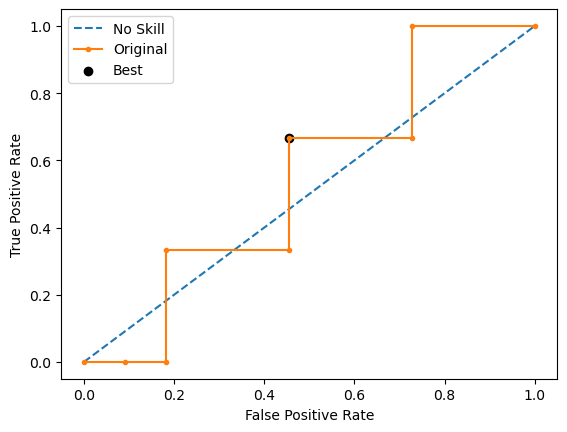

Learning rate set to 0.002204
0:	learn: 0.6917777	total: 1.74ms	remaining: 1.74s
1:	learn: 0.6901206	total: 4.49ms	remaining: 2.24s
2:	learn: 0.6885364	total: 5.81ms	remaining: 1.93s
3:	learn: 0.6869355	total: 8.06ms	remaining: 2.01s
4:	learn: 0.6852751	total: 9.78ms	remaining: 1.95s
5:	learn: 0.6831191	total: 10.8ms	remaining: 1.79s
6:	learn: 0.6814668	total: 12.1ms	remaining: 1.71s
7:	learn: 0.6801750	total: 13.3ms	remaining: 1.65s
8:	learn: 0.6792562	total: 14.3ms	remaining: 1.57s
9:	learn: 0.6780137	total: 15.5ms	remaining: 1.53s
10:	learn: 0.6759500	total: 16.7ms	remaining: 1.5s
11:	learn: 0.6743924	total: 18.4ms	remaining: 1.52s
12:	learn: 0.6732993	total: 20.3ms	remaining: 1.54s
13:	learn: 0.6715537	total: 21.8ms	remaining: 1.53s
14:	learn: 0.6702427	total: 23.2ms	remaining: 1.52s
15:	learn: 0.6688485	total: 24.5ms	remaining: 1.5s
16:	learn: 0.6673415	total: 25.8ms	remaining: 1.49s
17:	learn: 0.6654835	total: 27ms	remaining: 1.47s
18:	learn: 0.6639531	total: 28.5ms	remaining: 1.

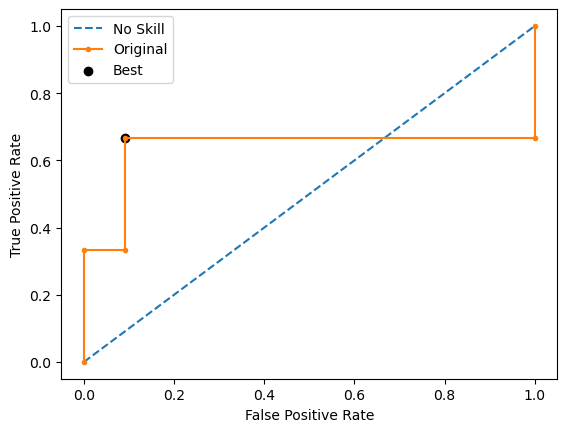

Learning rate set to 0.002168
0:	learn: 0.6917654	total: 1.57ms	remaining: 1.57s
1:	learn: 0.6903474	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6891957	total: 4.49ms	remaining: 1.49s
3:	learn: 0.6870757	total: 5.94ms	remaining: 1.48s
4:	learn: 0.6857293	total: 7.28ms	remaining: 1.45s
5:	learn: 0.6846506	total: 8.89ms	remaining: 1.47s
6:	learn: 0.6831796	total: 10.3ms	remaining: 1.46s
7:	learn: 0.6815227	total: 11.7ms	remaining: 1.45s
8:	learn: 0.6799372	total: 13.4ms	remaining: 1.47s
9:	learn: 0.6784348	total: 15ms	remaining: 1.48s
10:	learn: 0.6766143	total: 16.9ms	remaining: 1.52s
11:	learn: 0.6753789	total: 18.4ms	remaining: 1.51s
12:	learn: 0.6742388	total: 19.7ms	remaining: 1.5s
13:	learn: 0.6730417	total: 20.8ms	remaining: 1.47s
14:	learn: 0.6718177	total: 22ms	remaining: 1.44s
15:	learn: 0.6706486	total: 23.1ms	remaining: 1.42s
16:	learn: 0.6691271	total: 24.2ms	remaining: 1.4s
17:	learn: 0.6677967	total: 25.4ms	remaining: 1.39s
18:	learn: 0.6660851	total: 26.6ms	remaining: 1.38

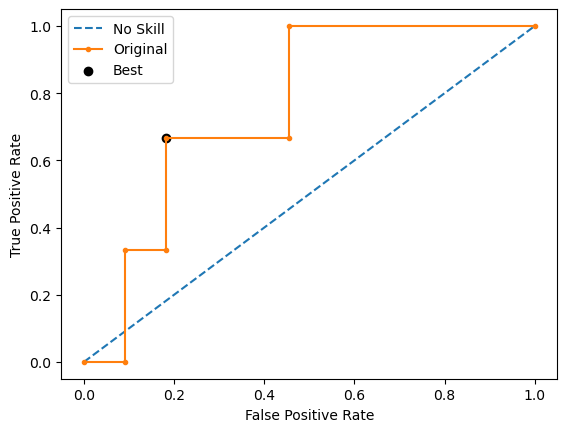

Learning rate set to 0.002095
0:	learn: 0.6916885	total: 1.86ms	remaining: 1.86s
1:	learn: 0.6902321	total: 3.45ms	remaining: 1.72s
2:	learn: 0.6887253	total: 4.91ms	remaining: 1.63s
3:	learn: 0.6880609	total: 7.41ms	remaining: 1.84s
4:	learn: 0.6863680	total: 9.49ms	remaining: 1.89s
5:	learn: 0.6850581	total: 11.1ms	remaining: 1.83s
6:	learn: 0.6828218	total: 12.6ms	remaining: 1.79s
7:	learn: 0.6815543	total: 14.2ms	remaining: 1.76s
8:	learn: 0.6803872	total: 15.4ms	remaining: 1.69s
9:	learn: 0.6790409	total: 16.7ms	remaining: 1.65s
10:	learn: 0.6777012	total: 18ms	remaining: 1.62s
11:	learn: 0.6761279	total: 19.3ms	remaining: 1.59s
12:	learn: 0.6742767	total: 20.7ms	remaining: 1.57s
13:	learn: 0.6728180	total: 22.1ms	remaining: 1.56s
14:	learn: 0.6714805	total: 23.4ms	remaining: 1.54s
15:	learn: 0.6701857	total: 24.7ms	remaining: 1.52s
16:	learn: 0.6692890	total: 26.1ms	remaining: 1.51s
17:	learn: 0.6681976	total: 27.4ms	remaining: 1.5s
18:	learn: 0.6673079	total: 28.7ms	remaining: 1

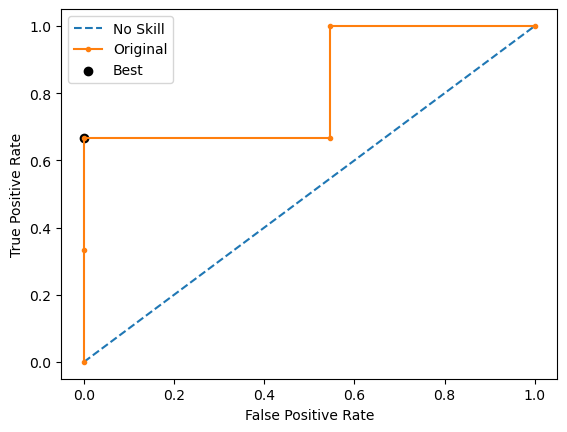

Learning rate set to 0.002305
0:	learn: 0.6918860	total: 1.51ms	remaining: 1.51s
1:	learn: 0.6904485	total: 2.99ms	remaining: 1.49s
2:	learn: 0.6888633	total: 4.64ms	remaining: 1.54s
3:	learn: 0.6877060	total: 6.45ms	remaining: 1.6s
4:	learn: 0.6856986	total: 7.95ms	remaining: 1.58s
5:	learn: 0.6841350	total: 9.19ms	remaining: 1.52s
6:	learn: 0.6821701	total: 10.8ms	remaining: 1.54s
7:	learn: 0.6804357	total: 12.5ms	remaining: 1.55s
8:	learn: 0.6790280	total: 14ms	remaining: 1.54s
9:	learn: 0.6771619	total: 15.5ms	remaining: 1.53s
10:	learn: 0.6751744	total: 17.2ms	remaining: 1.55s
11:	learn: 0.6727984	total: 18.9ms	remaining: 1.56s
12:	learn: 0.6711822	total: 20.6ms	remaining: 1.56s
13:	learn: 0.6692562	total: 21.6ms	remaining: 1.52s
14:	learn: 0.6679197	total: 22.8ms	remaining: 1.5s
15:	learn: 0.6665030	total: 24ms	remaining: 1.48s
16:	learn: 0.6642187	total: 25.3ms	remaining: 1.46s
17:	learn: 0.6630306	total: 26.6ms	remaining: 1.45s
18:	learn: 0.6618472	total: 27.8ms	remaining: 1.43

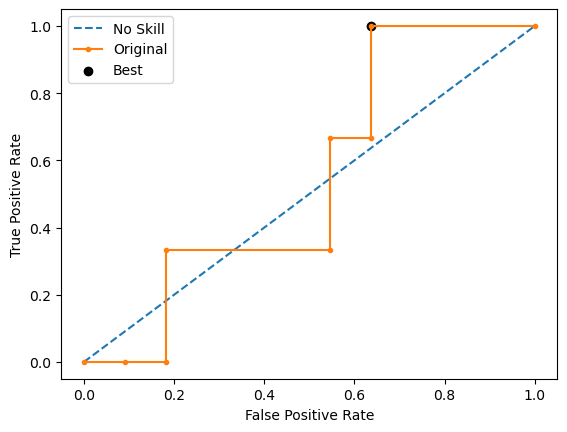

Ave Test G-mean: 0.5909937415005061
Stdev Test G-mean: 0.10187096668697179
Ave Test Specificity: 0.7818181818181819
Ave Test Recall: 0.4666666666666667
Ave Test NPV: 0.8453030303030303
Ave Test Accuracy: 0.7142857142857142
Ave Test Precision: 0.3833333333333333
Ave Test F1-Score: 0.40698412698412706
Ave Runtime: 1.6560128688812257


In [105]:
ho_t03_catboost_gs, ho_t03_catboost_be, ho_t03_catboost_model_info, ho_t03_catboost_metrics_df = catboost_class2(ho_t03, 'precision',
                                                            'home_ownership_class', random_state=0)

In [106]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t03_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t03_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t03_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
6,LightGBM,0.668408,0.157710,0.350000,0.428111,0.800000,0.600000,0.607143,0.530476,0.757143
1,SVM Classifier,0.613125,0.085847,0.433333,0.656636,0.600000,0.666667,0.315476,0.417374,0.614286
0,k-Nearest Neighbors,0.607826,0.124326,0.550000,0.514642,0.709091,0.533333,0.336667,0.410317,0.671429
9,CatBoost,0.590994,0.101871,0.283333,0.890266,0.781818,0.466667,0.383333,0.406984,0.714286
2,Logistic Regression,0.580978,0.158275,0.283333,NaN,0.509091,0.733333,0.292857,0.413333,0.557143
4,Random Forest,0.578147,0.146887,0.358333,0.805815,0.527273,0.666667,0.280000,0.391538,0.557143
7,Extreme Gradient Boosting (XGBoost),0.572883,0.080145,0.300000,0.838975,0.745455,0.466667,0.353810,0.383810,0.685714
5,Gradient Boosting Machine (GBM),0.466102,0.093482,0.466667,0.837381,0.527273,0.466667,0.216840,0.288730,0.514286
3,Decision Tree,0.363258,0.350619,0.383333,NaN,0.727273,0.333333,0.200000,0.247619,0.642857
8,AdaBoost,0.349346,0.324072,0.225000,0.854679,0.745455,0.333333,0.173810,0.226032,0.657143


In [107]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t03_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.757143,LightGBM
Highest Test G-mean,0.668408,LightGBM
Highest Test Recall,0.733333,Logistic Regression
Highest Test Precision,0.607143,LightGBM
Highest Test Specificity,0.800000,LightGBM
Highest Test F1-score,0.530476,LightGBM


# HO-T04 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits


The least populated class in y has only 8 members, which is less than n_splits=10.


Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 5, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.4
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=5,
                                        max_features='log2', random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 75.98927974700928 secs
Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2328 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

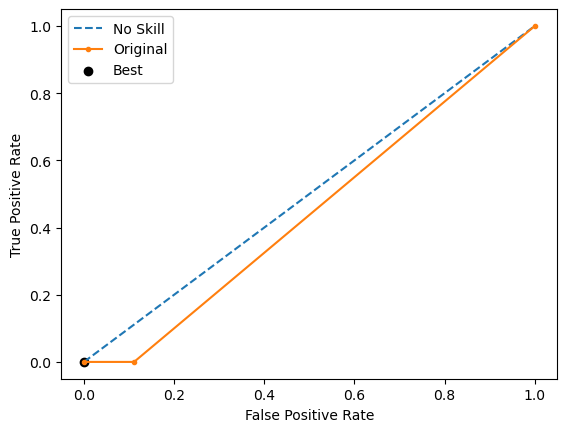

Run 2 - Random State: 1
Test G-mean: 0.5091750772173155
Best Threshold=0.470588, G-Mean=0.667


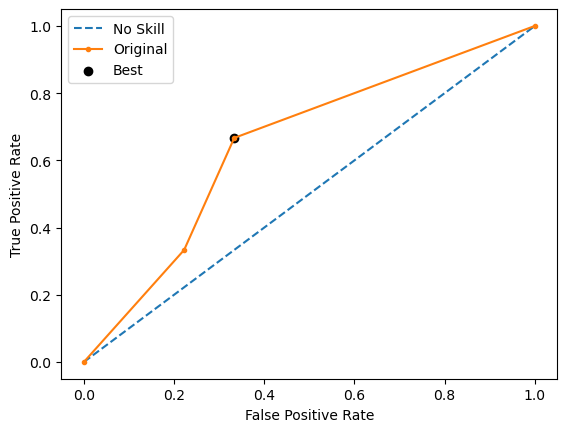

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=inf, G-Mean=0.000


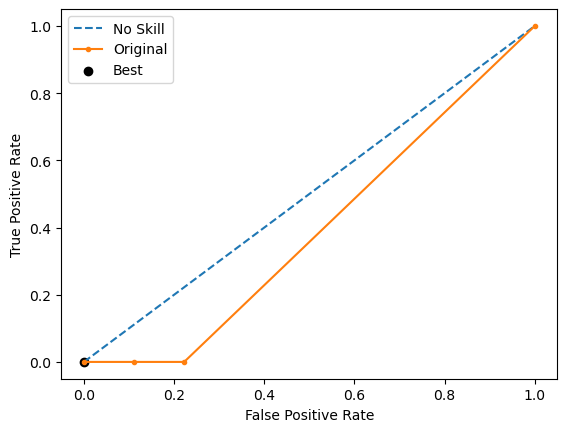

Run 4 - Random State: 3
Test G-mean: 0.43033148291193524
Best Threshold=0.400000, G-Mean=0.544


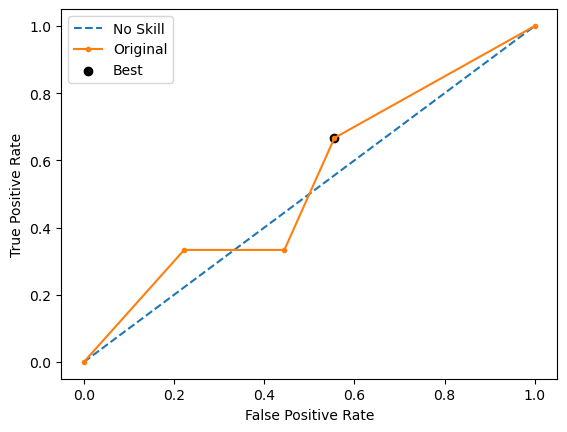

Run 5 - Random State: 4
Test G-mean: 0.43033148291193524
Best Threshold=1.000000, G-Mean=0.509


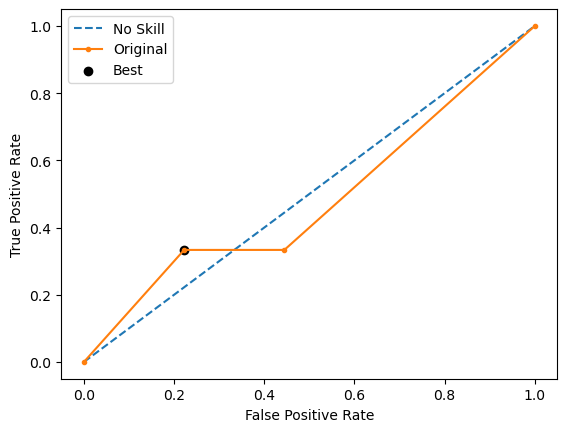

Ave Test G-mean: 0.27396760860823716
Stdev Test G-mean: 0.25215985842172045
Ave Test Specificity: 0.711111111111111
Ave Test Recall: 0.2
Ave Test NPV: 0.7267243867243869
Ave Test Accuracy: 0.5833333333333333
Ave Test Precision: 0.14666666666666667
Ave Test F1-Score: 0.16666666666666666
Ave Runtime: 0.009282064437866212


In [108]:
ho_t04_dt_gs, ho_t04_dt_be, ho_t04_dt_model_info, ho_t04_dt_metrics_df = dt_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits


The least populated class in y has only 8 members, which is less than n_splits=10.

650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs

Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': 'l2', 'classifier__solver': 'liblinear', 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.25
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, random_state=0,
                                    solver='liblinear'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 16.289377689361572 secs
Run 1 - Random State: 0
Test G-mean: 0.38490017945975047
Best Threshold=0.500172, G-Mean=0.667


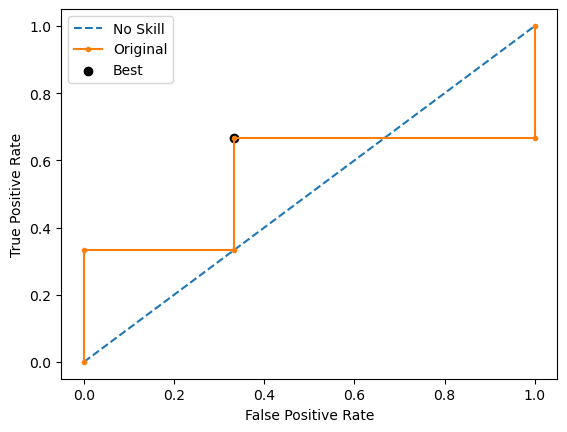

Run 2 - Random State: 1
Test G-mean: 0.0
Best Threshold=0.500141, G-Mean=0.667


invalid value encountered in scalar divide


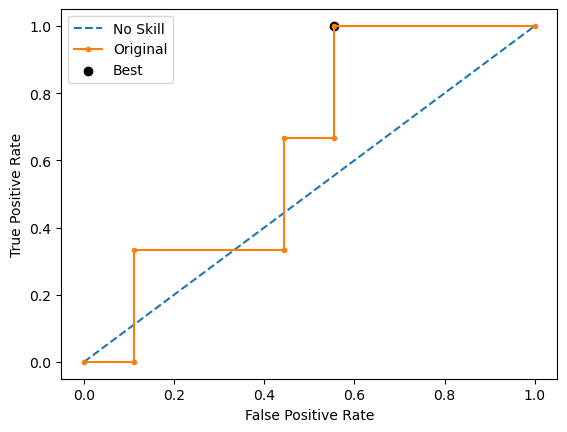

Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.499871, G-Mean=0.385


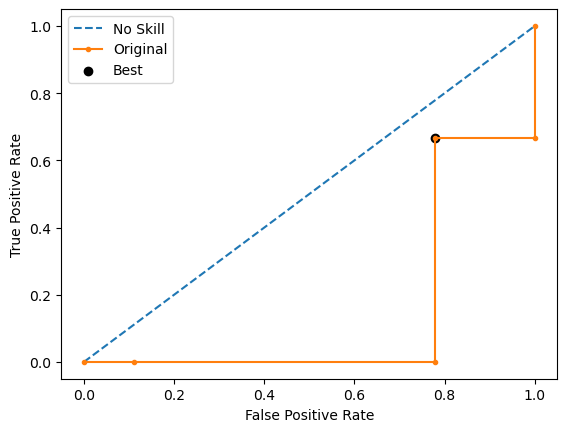

Run 4 - Random State: 3
Test G-mean: 0.4714045207910317
Best Threshold=0.500106, G-Mean=0.816


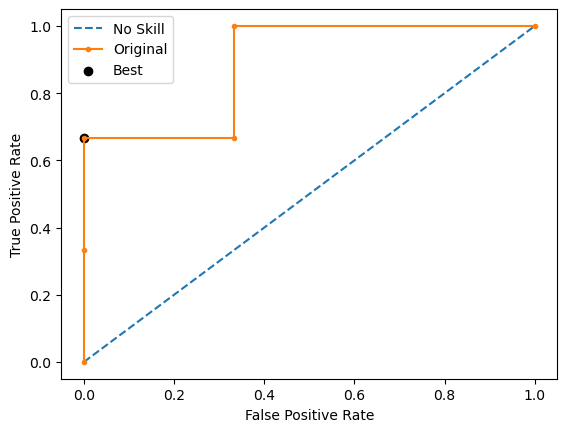

Run 5 - Random State: 4
Test G-mean: 0.6666666666666666
Best Threshold=0.500970, G-Mean=0.816


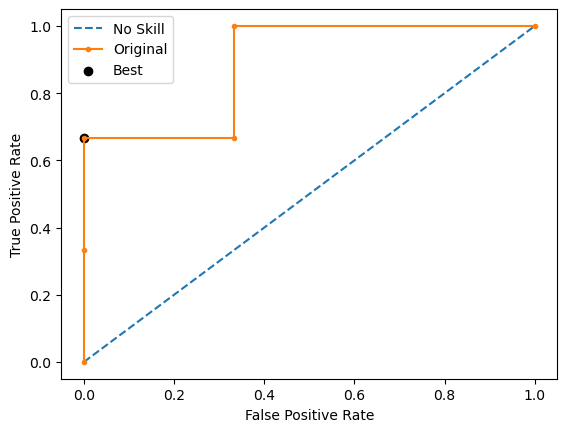

Ave Test G-mean: 0.30459427338348977
Stdev Test G-mean: 0.29619523034847056
Ave Test Specificity: 0.24444444444444446
Ave Test Recall: 0.7333333333333333
Ave Test NPV: 0.7916666666666666
Ave Test Accuracy: 0.3666666666666667
Ave Test Precision: 0.22944444444444442
Ave Test F1-Score: 0.34806526806526805
Ave Runtime: 0.009260463714599609


In [109]:
ho_t04_logreg_gs, ho_t04_logreg_be, ho_t04_logreg_model_info, ho_t04_logreg_metrics_df = logreg_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits


The least populated class in y has only 8 members, which is less than n_splits=10.


[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.3
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, kernel='sigmoid', max_iter=1000, probability=True,
                     random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.7755532358052497
Std Train Score (G-mean) 0.12512091969619354
GridSearchCV Runtime: 20.43131399154663 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.0
Best Threshold=0.425971, G-Mean=0.577


invalid value encountered in scalar divide


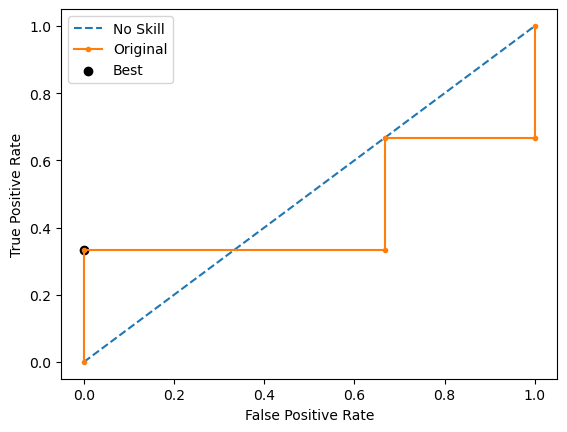

invalid value encountered in scalar divide


[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.0
Best Threshold=0.490743, G-Mean=0.544


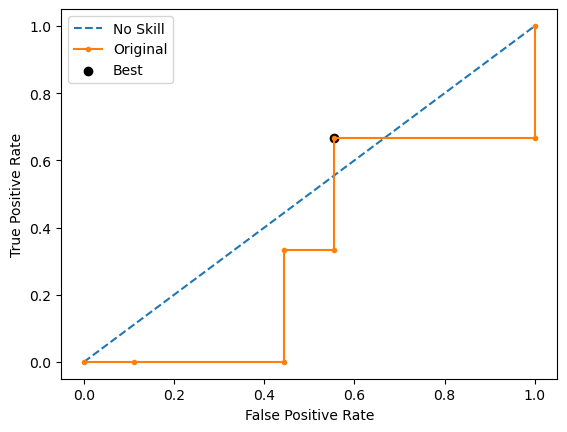

[LibSVM]

Precision is ill-defined and being set to 0.0 due to no predicted samples. Use `zero_division` parameter to control this behavior.


Run 3 - Random State: 2
Test G-mean: 0.0
Best Threshold=0.528814, G-Mean=0.882


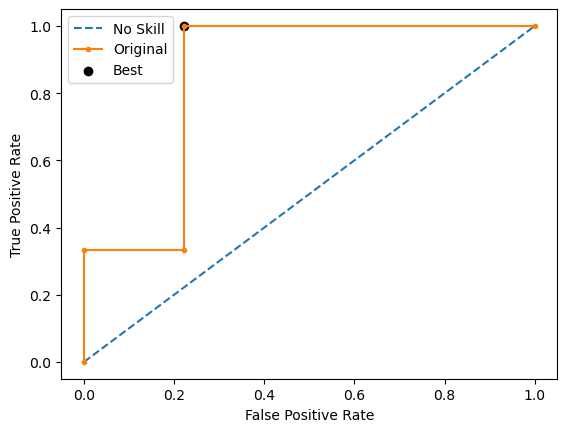

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.0
Best Threshold=0.490743, G-Mean=0.577


invalid value encountered in scalar divide


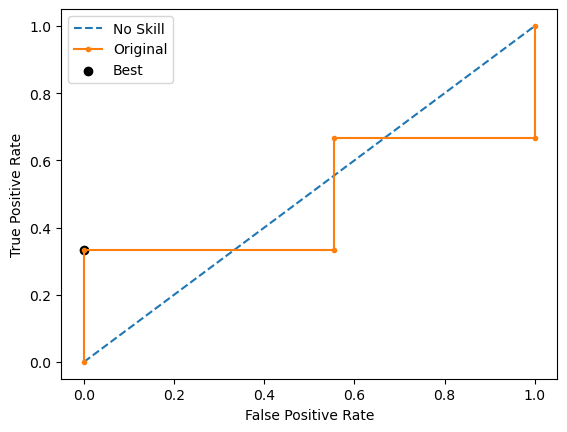

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.7200822998230956
Best Threshold=0.528814, G-Mean=0.385


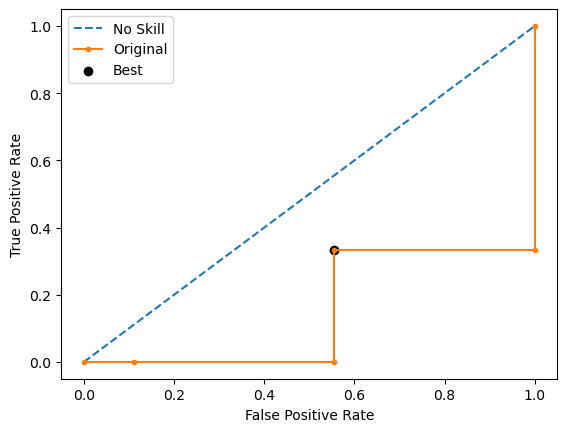

Ave Test G-mean: 0.14401645996461912
Stdev Test G-mean: 0.3220305943597653
Ave Test Specificity: 0.3555555555555555
Ave Test Recall: 0.7333333333333333
Ave Test NPV: 0.8125
Ave Test Accuracy: 0.45
Ave Test Precision: 0.25
Ave Test F1-Score: 0.35428571428571437
Ave Runtime: 0.027201080322265626


In [110]:
ho_t04_svm_gs, ho_t04_svm_be, ho_t04_svm_model_info, ho_t04_svm_metrics_df = svm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

In [111]:
ho_t04_knn_gs, ho_t04_knn_be, ho_t04_knn_model_info, ho_t04_knn_metrics_df = knn_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


The least populated class in y has only 8 members, which is less than n_splits=10.


Best Hyperparameters: {'classifier__metric': 'hamming', 'classifier__n_neighbors': 9, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.41666666666666663
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='hamming', n_neighbors=9))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 29.85844874382019 secs
Run 1 - Random State: 0
Test G-mean: 0.4714045207910317
Run 2 - Random State: 1
Test G-mean: 0.5443310539518172
Run 3 - Random State: 2
Test G-mean: 0.5443310539518172
Run 4 - Random State: 3
Test G-mean: 0.7200822998230956
Run 5 - Random State: 4
Test G-mean: 0.0
Ave Test G-mean: 0.45602978570355235
Stdev Test G-mean: 0.270886279686326
Ave Test Specificity: 0.711111111111111
Ave Test Recall: 0.4
Ave Test NPV: 0.7783333333333333
Ave Test Accuracy: 0.6333333333333334
Ave 

One or more of the test scores are non-finite: [0.2        0.1        0.05       0.1        0.25       0.1
 0.         0.         0.1        0.         0.25       0.13333333
 0.1        0.13333333 0.13333333 0.25       0.15       0.
 0.13333333 0.         0.3        0.23333333 0.         0.33333333
 0.         0.2        0.2        0.         0.15       0.
 0.15       0.3        0.         0.2        0.         0.3
 0.2        0.         0.05       0.         0.3        0.15
 0.         0.05       0.1        0.3        0.1        0.
 0.05       0.         0.3        0.2        0.         0.1
 0.03333333 0.3        0.1        0.         0.2        0.
 0.3        0.3        0.         0.3        0.         0.3
 0.1        0.         0.2        0.         0.3        0.1
 0.         0.2               nan 0.25       0.25       0.18333333
 0.25       0.15       0.25       0.15       0.         0.25
 0.05       0.23333333 0.2        0.1        0.23333333 0.08333333
 0.15       0.2        0.  

In [112]:
ho_t04_xgb_gs, ho_t04_xgb_be, ho_t04_xgb_model_info, ho_t04_xgb_metrics_df = xgb_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

The least populated class in y has only 8 members, which is less than n_splits=10.


Fitting 10 folds for each of 540 candidates, totalling 5400 fits


Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002426 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 707
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

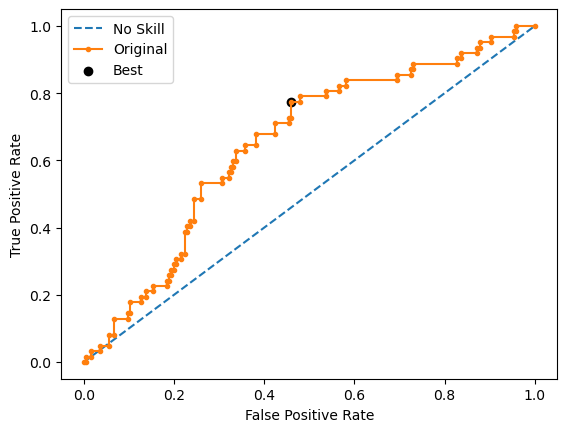

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001031 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 718
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

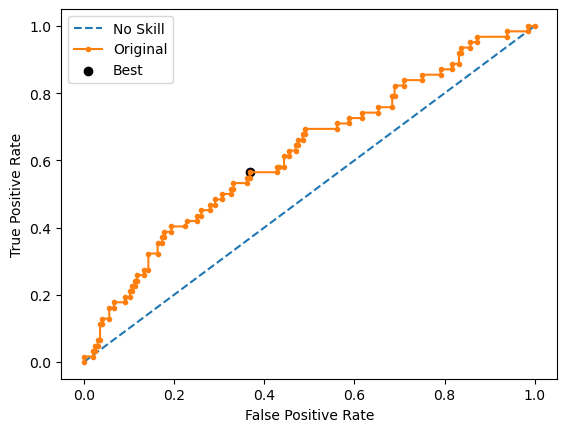

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000987 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 712
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

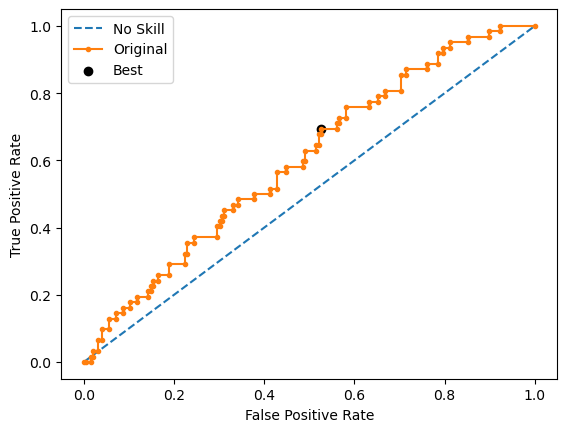

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001124 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 726
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 52
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

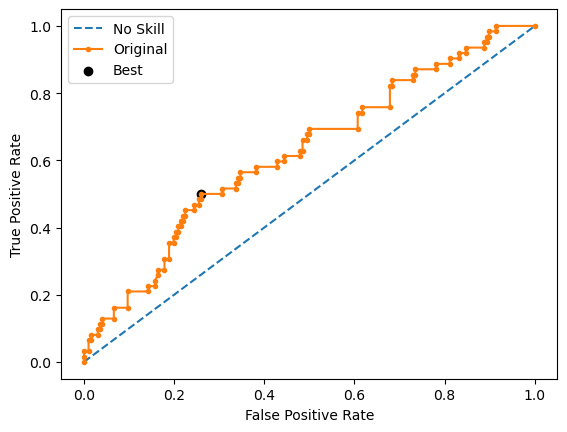

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001330 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 701
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 49
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

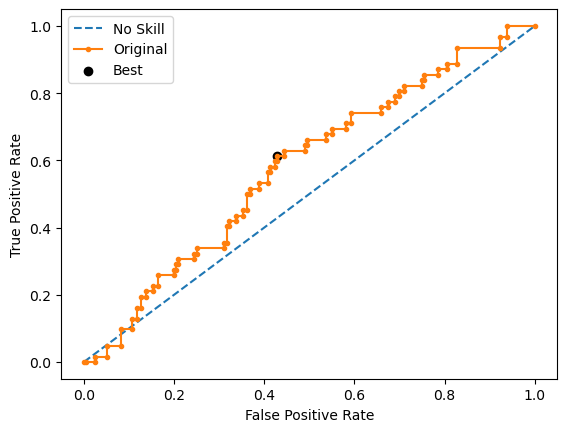

Ave Test G-mean: 0.5921028348222019
Stdev Test G-mean: 0.02883261836274458
Ave Test Specificity: 0.6214285714285714
Ave Test Recall: 0.5677419354838709
Ave Test NPV: 0.8202319796664259
Ave Test Accuracy: 0.6085271317829457
Ave Test Precision: 0.3218362919045908
Ave Test F1-Score: 0.4099620423940956
Ave Runtime: 0.20270166397094727


In [ ]:
ho_t04_lgbm_gs, ho_t04_lgbm_be, ho_t04_lgbm_model_info, ho_t04_lgbm_metrics_df = lgbm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5911804668139743
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9483786822029643
Std Train Score (G-mean) 0.0055816521260718
GridSearchCV Runtime: 16.010417699813843 secs
Run 1 - Random State: 0
Test G-mean: 0.601183822262458
Best Threshold=0.880797, G-Mean=0.601


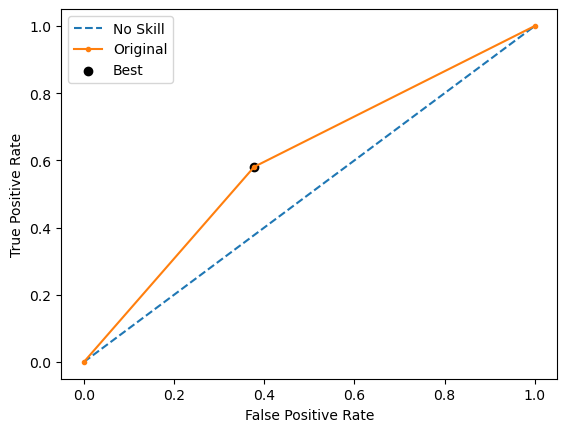

Run 2 - Random State: 1
Test G-mean: 0.580572009143728
Best Threshold=0.880797, G-Mean=0.581


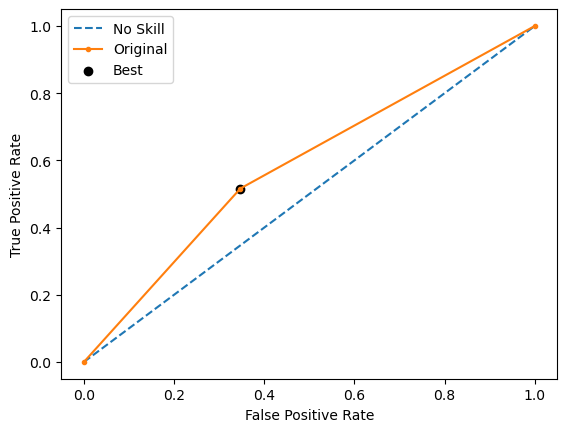

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.880797, G-Mean=0.556


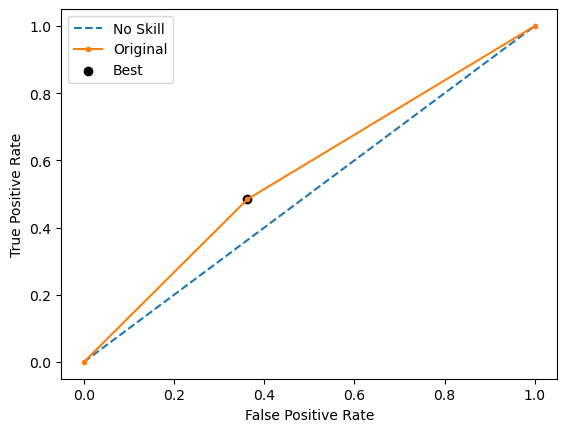

Run 4 - Random State: 3
Test G-mean: 0.5887356041438042
Best Threshold=0.880797, G-Mean=0.589


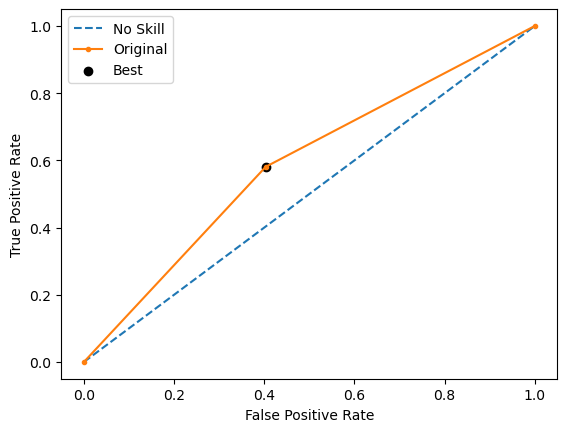

Run 5 - Random State: 4
Test G-mean: 0.5684687168417007
Best Threshold=0.880797, G-Mean=0.568


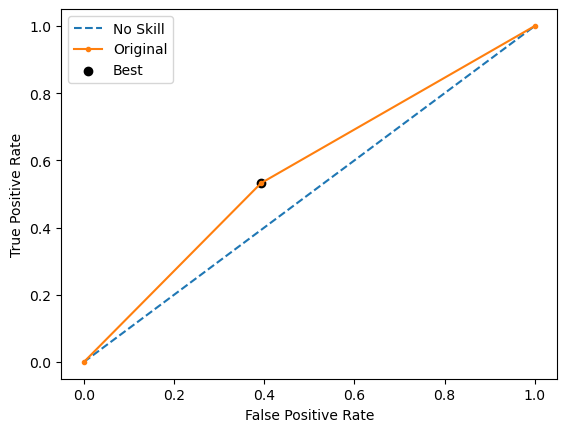

Ave Test G-mean: 0.5788939977708838
Stdev Test G-mean: 0.017691909850058078
Ave Test Specificity: 0.6234693877551021
Ave Test Recall: 0.5387096774193548
Ave Test NPV: 0.8105730245575445
Ave Test Accuracy: 0.6031007751937985
Ave Test Precision: 0.31146918170077875
Ave Test F1-Score: 0.39445302606331245
Ave Runtime: 0.29434571266174314


In [ ]:
ho_t04_adaboost_gs, ho_t04_adaboost_be, ho_t04_adaboost_model_info, ho_t04_adaboost_metrics_df = adaboost_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.569496788354359
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8832905760613396
Std Train Score (G-mean) 0.009894942354084993
GridSearchCV Runtime: 113.32110786437988 secs
Run 1 - Random State: 0
Test G-mean: 0.5511971530352403
Best Threshold=0.443356, G-Mean=0.608


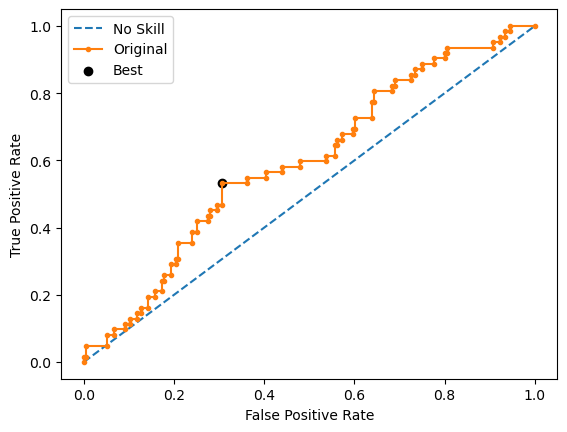

Run 2 - Random State: 1
Test G-mean: 0.5374396179933225
Best Threshold=0.432180, G-Mean=0.572


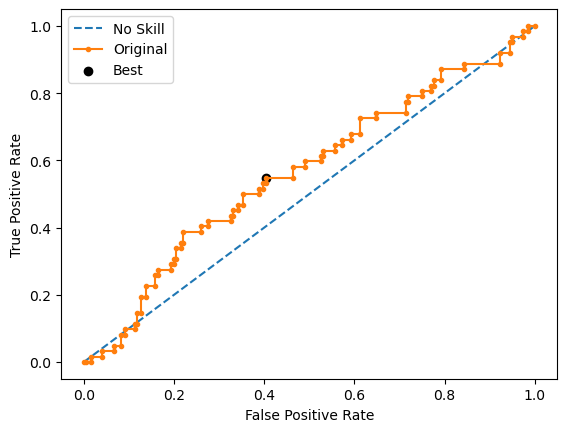

Run 3 - Random State: 2
Test G-mean: 0.5105857690125177
Best Threshold=0.283692, G-Mean=0.584


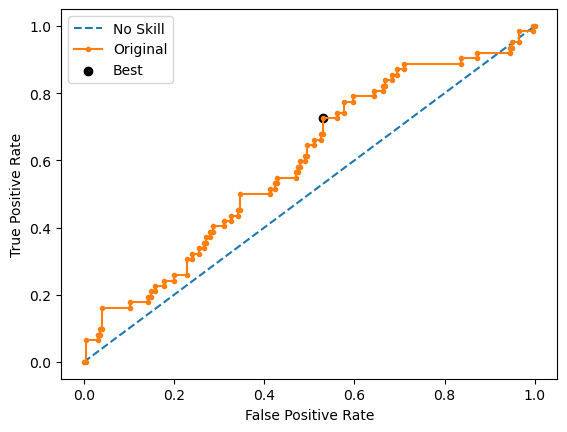

Run 4 - Random State: 3
Test G-mean: 0.533443728973888
Best Threshold=0.324085, G-Mean=0.625


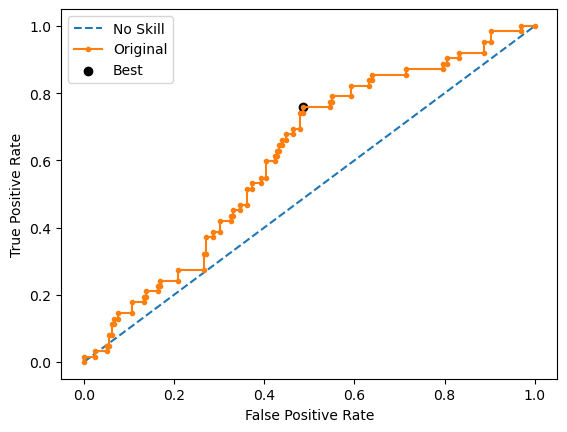

Run 5 - Random State: 4
Test G-mean: 0.47136572685434985
Best Threshold=0.397780, G-Mean=0.566


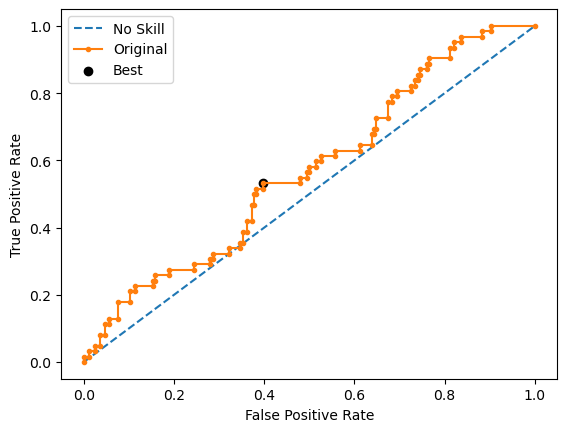

Ave Test G-mean: 0.5208063991738637
Stdev Test G-mean: 0.03126021974224556
Ave Test Specificity: 0.703061224489796
Ave Test Recall: 0.3870967741935484
Ave Test NPV: 0.7839058603557907
Ave Test Accuracy: 0.6271317829457365
Ave Test Precision: 0.2920392567435058
Ave Test F1-Score: 0.3325622048202667
Ave Runtime: 0.5068301200866699


In [ ]:
ho_t04_gbm_gs, ho_t04_gbm_be, ho_t04_gbm_model_info, ho_t04_gbm_metrics_df = gbm_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5867223262619821
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=2,
                                        min_samples_leaf=2, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.6142979946444345
Std Train Score (G-mean) 0.022890461687223782
GridSearchCV Runtime: 377.7622067928314 secs
Run 1 - Random State: 0
Test G-mean: 0.6165908950002709
Best Threshold=0.490636, G-Mean=0.

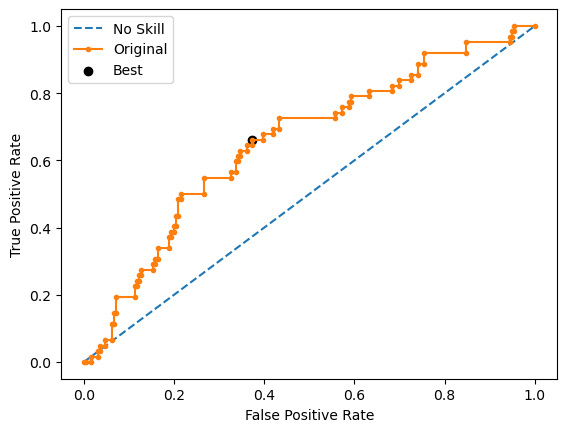

Run 2 - Random State: 1
Test G-mean: 0.6006360464564467
Best Threshold=0.492155, G-Mean=0.618


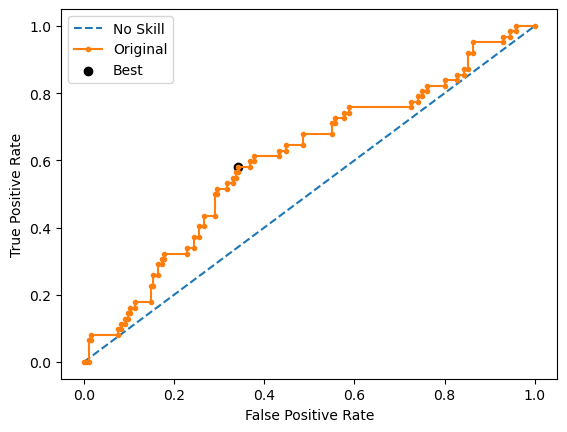

Run 3 - Random State: 2
Test G-mean: 0.5612574052230482
Best Threshold=0.482957, G-Mean=0.589


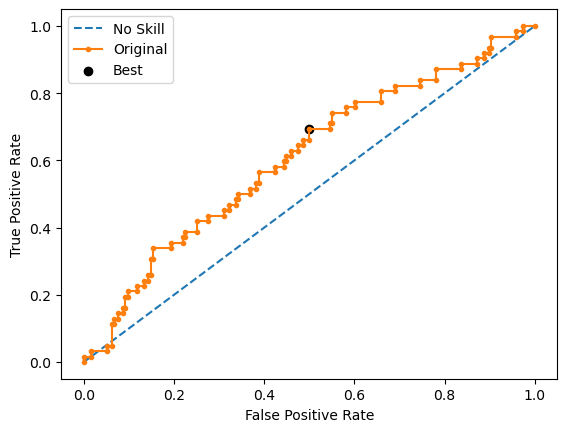

Run 4 - Random State: 3
Test G-mean: 0.6242836579493493
Best Threshold=0.498552, G-Mean=0.630


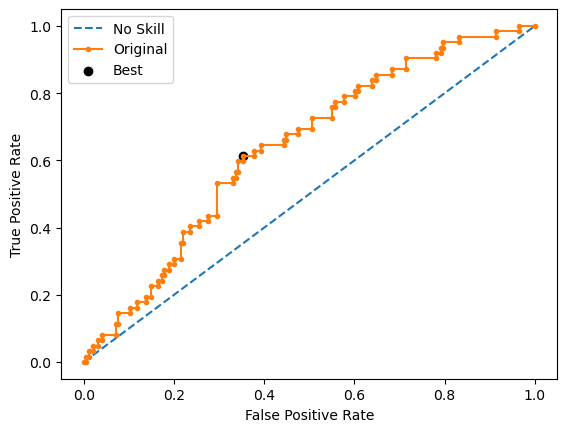

Run 5 - Random State: 4
Test G-mean: 0.5785842292490759
Best Threshold=0.505205, G-Mean=0.598


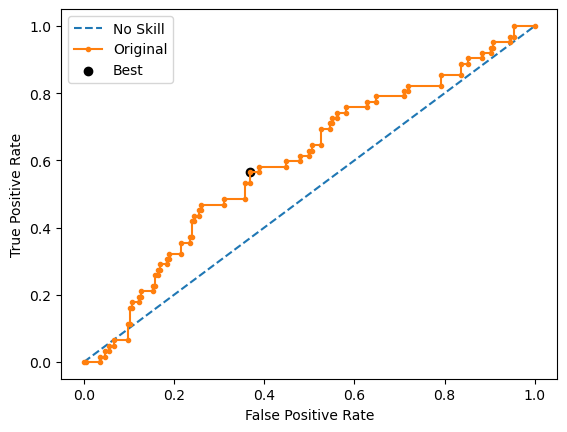

Ave Test G-mean: 0.5962704467756382
Stdev Test G-mean: 0.026246116122420154
Ave Test Specificity: 0.6551020408163265
Ave Test Recall: 0.5451612903225806
Ave Test NPV: 0.8200197816319441
Ave Test Accuracy: 0.6286821705426358
Ave Test Precision: 0.3343827245914533
Ave Test F1-Score: 0.41363612767624575
Ave Runtime: 0.5741176605224609


In [ ]:
ho_t04_rf_gs, ho_t04_rf_be, ho_t04_rf_model_info, ho_t04_rf_metrics_df = rf_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.006754
0:	learn: 0.6912202	total: 2.73ms	remaining: 2.73s
1:	learn: 0.6901033	total: 5.14ms	remaining: 2.56s
2:	learn: 0.6886959	total: 7.49ms	remaining: 2.49s
3:	learn: 0.6878366	total: 9.56ms	remaining: 2.38s
4:	learn: 0.6868945	total: 11.9ms	remaining: 2.37s
5:	learn: 0.6858509	total: 14.5ms	remaining: 2.4s
6:	learn: 0.6850191	total: 16.5ms	remaining: 2.34s
7:	learn: 0.6839898	total: 18.6ms	remaining: 2.31s
8:	learn: 0.6827189	total: 20.4ms	remaining: 2.25s
9:	learn: 0.6813587	total: 22.3ms	remaining: 2.21s
10:	learn: 0.6798945	total: 24.4ms	remaining: 2.2s
11:	learn: 0.6787746	total: 26.7ms	remaining: 2.2s
12:	learn: 0.6776396	total: 28.7ms	remaining: 2.18s
13:	learn: 0.6768444	total: 30.8ms	remaining: 2.17s
14:	learn: 0.6758580	total: 32.9ms	remaining: 2.16s
15:	learn: 0.6750210	total: 35ms	remaining: 2.15s
16:	learn: 0.6738575	total: 37.2ms	remaining: 2.15s
17:	learn: 0.6730025	total: 39.6ms	remaining: 2.16s
18:	learn: 0.6716720	total: 41.4ms	remaining: 2.1

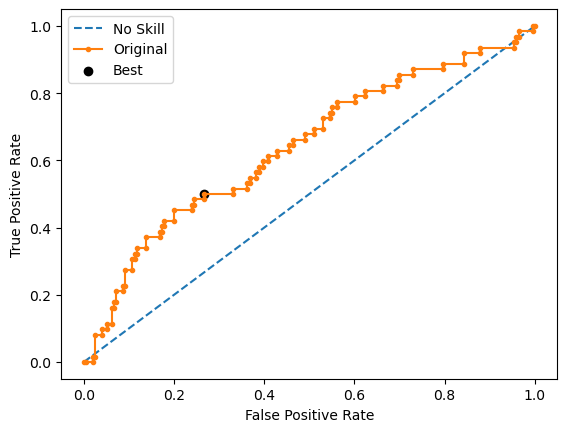

Learning rate set to 0.006754
0:	learn: 0.6917289	total: 3.06ms	remaining: 3.06s
1:	learn: 0.6902904	total: 5.46ms	remaining: 2.72s
2:	learn: 0.6887415	total: 7.86ms	remaining: 2.61s
3:	learn: 0.6872900	total: 10.2ms	remaining: 2.55s
4:	learn: 0.6860188	total: 12.7ms	remaining: 2.53s
5:	learn: 0.6850444	total: 15ms	remaining: 2.48s
6:	learn: 0.6836120	total: 17.8ms	remaining: 2.52s
7:	learn: 0.6826308	total: 19.7ms	remaining: 2.44s
8:	learn: 0.6809650	total: 21.6ms	remaining: 2.38s
9:	learn: 0.6793503	total: 23.6ms	remaining: 2.33s
10:	learn: 0.6783052	total: 25.6ms	remaining: 2.3s
11:	learn: 0.6769061	total: 27.6ms	remaining: 2.27s
12:	learn: 0.6759778	total: 29.8ms	remaining: 2.26s
13:	learn: 0.6751908	total: 31.8ms	remaining: 2.24s
14:	learn: 0.6740277	total: 33.7ms	remaining: 2.21s
15:	learn: 0.6729283	total: 35.7ms	remaining: 2.19s
16:	learn: 0.6716298	total: 37.5ms	remaining: 2.17s
17:	learn: 0.6696057	total: 39.3ms	remaining: 2.14s
18:	learn: 0.6680976	total: 41.3ms	remaining: 2

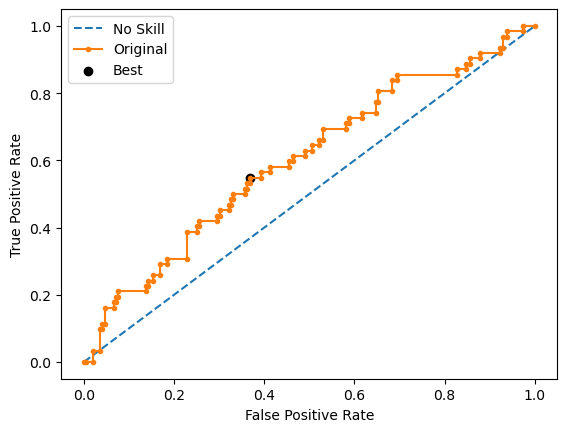

Learning rate set to 0.006754
0:	learn: 0.6925900	total: 4.96ms	remaining: 4.95s
1:	learn: 0.6912428	total: 9.78ms	remaining: 4.88s
2:	learn: 0.6903214	total: 14.7ms	remaining: 4.9s
3:	learn: 0.6891849	total: 20.6ms	remaining: 5.13s
4:	learn: 0.6882245	total: 25.8ms	remaining: 5.13s
5:	learn: 0.6869975	total: 30.4ms	remaining: 5.04s
6:	learn: 0.6860357	total: 34.7ms	remaining: 4.93s
7:	learn: 0.6856075	total: 38.3ms	remaining: 4.75s
8:	learn: 0.6844440	total: 42.3ms	remaining: 4.65s
9:	learn: 0.6839372	total: 45.3ms	remaining: 4.49s
10:	learn: 0.6828732	total: 48.6ms	remaining: 4.37s
11:	learn: 0.6822025	total: 51ms	remaining: 4.2s
12:	learn: 0.6814569	total: 53.6ms	remaining: 4.07s
13:	learn: 0.6806074	total: 55.9ms	remaining: 3.94s
14:	learn: 0.6797781	total: 57.9ms	remaining: 3.81s
15:	learn: 0.6792976	total: 60ms	remaining: 3.69s
16:	learn: 0.6783452	total: 62.2ms	remaining: 3.59s
17:	learn: 0.6772332	total: 64.3ms	remaining: 3.51s
18:	learn: 0.6758575	total: 66.2ms	remaining: 3.42

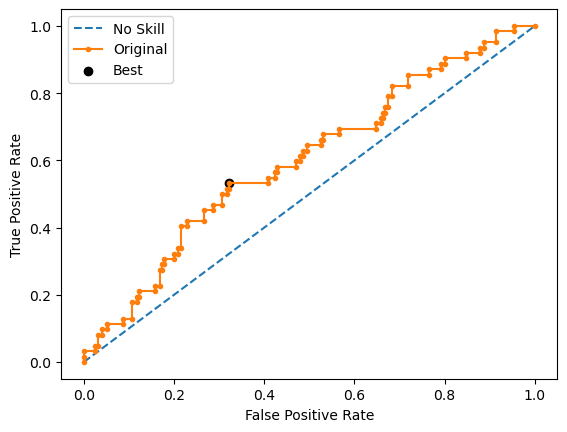

Learning rate set to 0.006754
0:	learn: 0.6921698	total: 4.15ms	remaining: 4.14s
1:	learn: 0.6908277	total: 7.65ms	remaining: 3.82s
2:	learn: 0.6895982	total: 10.6ms	remaining: 3.53s
3:	learn: 0.6882903	total: 13ms	remaining: 3.23s
4:	learn: 0.6870308	total: 15.5ms	remaining: 3.08s
5:	learn: 0.6859095	total: 19ms	remaining: 3.14s
6:	learn: 0.6846291	total: 22.4ms	remaining: 3.18s
7:	learn: 0.6833793	total: 25ms	remaining: 3.1s
8:	learn: 0.6820021	total: 27.1ms	remaining: 2.98s
9:	learn: 0.6804164	total: 28.8ms	remaining: 2.85s
10:	learn: 0.6789586	total: 30.4ms	remaining: 2.74s
11:	learn: 0.6781544	total: 32.5ms	remaining: 2.67s
12:	learn: 0.6769886	total: 34.5ms	remaining: 2.62s
13:	learn: 0.6759117	total: 36.8ms	remaining: 2.59s
14:	learn: 0.6746674	total: 39.1ms	remaining: 2.56s
15:	learn: 0.6739820	total: 40.8ms	remaining: 2.51s
16:	learn: 0.6726952	total: 42.4ms	remaining: 2.45s
17:	learn: 0.6717030	total: 44.2ms	remaining: 2.41s
18:	learn: 0.6701852	total: 46ms	remaining: 2.38s
1

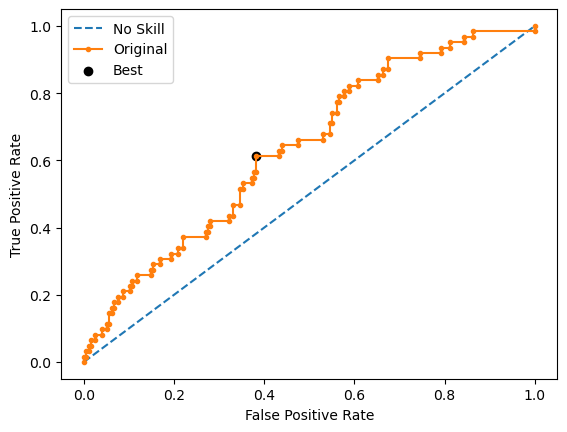

Learning rate set to 0.006754
0:	learn: 0.6923820	total: 1.98ms	remaining: 1.98s
1:	learn: 0.6918217	total: 3.92ms	remaining: 1.95s
2:	learn: 0.6908313	total: 5.84ms	remaining: 1.94s
3:	learn: 0.6897882	total: 7.56ms	remaining: 1.88s
4:	learn: 0.6888118	total: 9.38ms	remaining: 1.87s
5:	learn: 0.6872772	total: 11.3ms	remaining: 1.88s
6:	learn: 0.6860441	total: 13.1ms	remaining: 1.85s
7:	learn: 0.6850615	total: 15ms	remaining: 1.87s
8:	learn: 0.6835670	total: 16.9ms	remaining: 1.86s
9:	learn: 0.6823291	total: 18.6ms	remaining: 1.84s
10:	learn: 0.6810308	total: 20.5ms	remaining: 1.84s
11:	learn: 0.6796718	total: 22.3ms	remaining: 1.84s
12:	learn: 0.6783633	total: 24.2ms	remaining: 1.83s
13:	learn: 0.6773526	total: 26.1ms	remaining: 1.83s
14:	learn: 0.6766391	total: 27.7ms	remaining: 1.82s
15:	learn: 0.6759354	total: 29.7ms	remaining: 1.82s
16:	learn: 0.6748091	total: 31.5ms	remaining: 1.82s
17:	learn: 0.6734633	total: 33.6ms	remaining: 1.83s
18:	learn: 0.6719152	total: 35.3ms	remaining: 

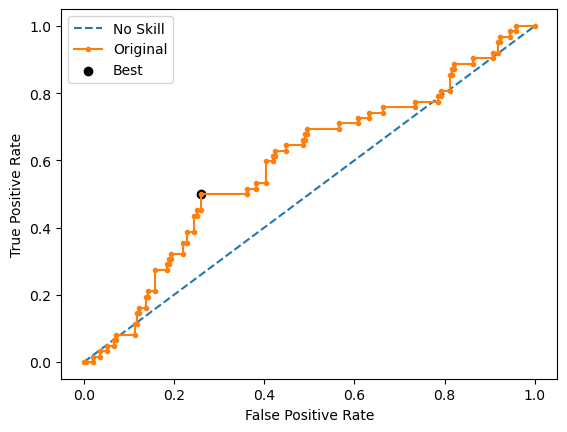

Ave Test G-mean: 0.5881992688619447
Stdev Test G-mean: 0.009463946498823914
Ave Test Specificity: 0.613265306122449
Ave Test Recall: 0.5677419354838709
Ave Test NPV: 0.8183035752136407
Ave Test Accuracy: 0.6023255813953489
Ave Test Precision: 0.31746401567392013
Ave Test F1-Score: 0.40624796443573485
Ave Runtime: 2.0170587062835694


In [ ]:
ho_t04_catboost_gs, ho_t04_catboost_be, ho_t04_catboost_model_info, ho_t04_catboost_metrics_df = catboost_class2(ho_t04, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t04_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t04_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t04_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.611687,0.041561,0.573521,NaN,0.590816,0.635484,0.332645,0.435697,0.601550
4,Random Forest,0.596270,0.026246,0.586722,0.614298,0.655102,0.545161,0.334383,0.413636,0.628682
6,LightGBM,0.592103,0.028833,0.610242,0.737797,0.621429,0.567742,0.321836,0.409962,0.608527
9,CatBoost,0.588199,0.009464,0.594784,0.946857,0.613265,0.567742,0.317464,0.406248,0.602326
2,Logistic Regression,0.579215,0.025098,0.566396,NaN,0.636735,0.529032,0.314800,0.394322,0.610853
8,AdaBoost,0.578894,0.017692,0.591180,0.948379,0.623469,0.538710,0.311469,0.394453,0.603101
7,Extreme Gradient Boosting (XGBoost),0.541323,0.032543,0.591274,0.851856,0.650000,0.451613,0.290235,0.353203,0.602326
5,Gradient Boosting Machine (GBM),0.520806,0.031260,0.569497,0.883291,0.703061,0.387097,0.292039,0.332562,0.627132
1,SVM Classifier,0.520429,0.041414,0.546502,0.289425,0.486735,0.570968,0.259745,0.355601,0.506977
0,k-Nearest Neighbors,0.519724,0.027181,0.582620,0.693216,0.585714,0.464516,0.261445,0.334010,0.556589


In [ ]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t04_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.628682,Random Forest
Highest Test G-mean,0.611687,Decision Tree
Highest Test Recall,0.635484,Decision Tree
Highest Test Precision,0.334383,Random Forest
Highest Test Specificity,0.703061,Gradient Boosting Machine (GBM)
Highest Test F1-score,0.435697,Decision Tree


# HO-T05 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2220 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__max_features': 'sqrt', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5882193401183704
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=3, max_features='sqrt',
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 152.04352164268494 secs
Run 1 - Random State: 0
Test G-mean: 0.5679618342470648
Best Threshold=0.638235, G-Mean=0.568


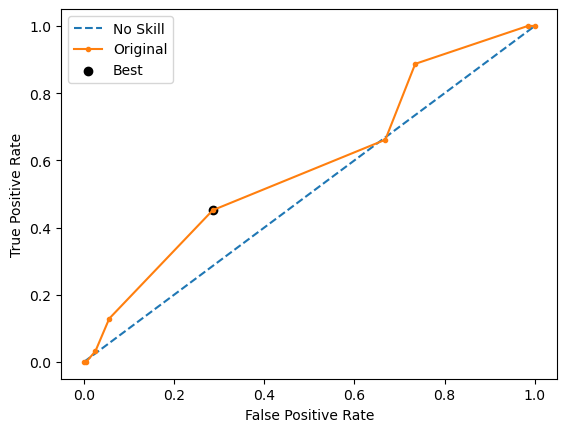

Run 2 - Random State: 1
Test G-mean: 0.6282912027221439
Best Threshold=0.560102, G-Mean=0.628


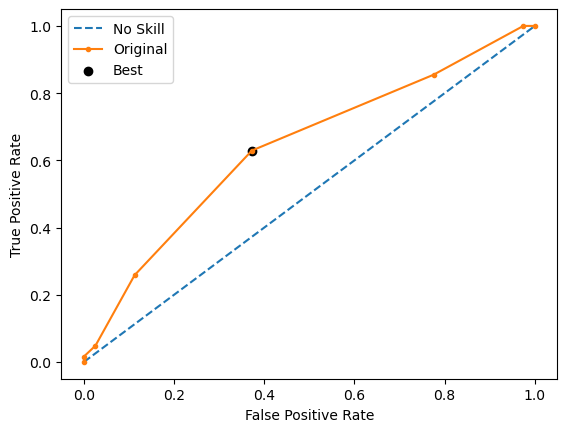

Run 3 - Random State: 2
Test G-mean: 0.6277015346403589
Best Threshold=0.572864, G-Mean=0.639


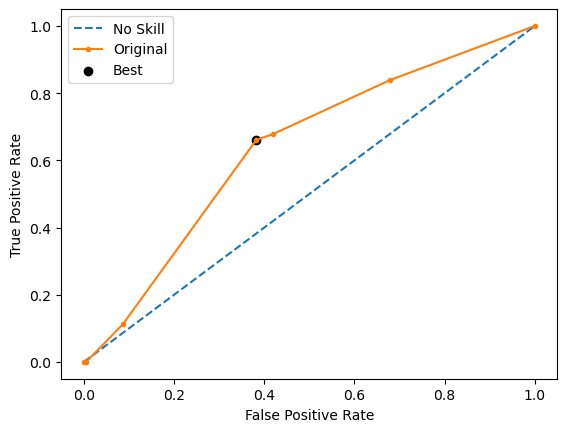

Run 4 - Random State: 3
Test G-mean: 0.5828354563599033
Best Threshold=0.559829, G-Mean=0.599


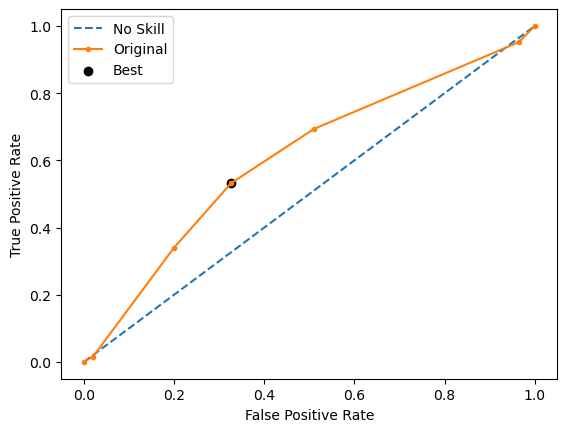

Run 5 - Random State: 4
Test G-mean: 0.5717884811269289
Best Threshold=0.600543, G-Mean=0.572


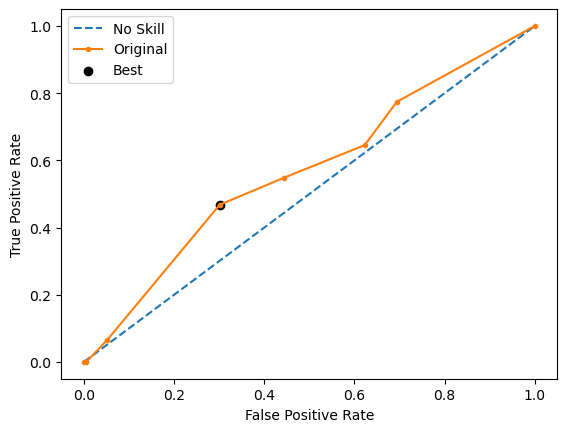

Ave Test G-mean: 0.5957157018192799
Stdev Test G-mean: 0.029970596168164648
Ave Test Specificity: 0.6224489795918368
Ave Test Recall: 0.5838709677419354
Ave Test NPV: 0.8276949369735256
Ave Test Accuracy: 0.6131782945736435
Ave Test Precision: 0.33010041034234583
Ave Test F1-Score: 0.41792585418380124
Ave Runtime: 0.02564659118652344


In [ ]:
ho_t05_dt_gs, ho_t05_dt_be, ho_t05_dt_model_info, ho_t05_dt_metrics_df = dt_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__penalty': None, 'classifier__solver': 'lbfgs', 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5614600299693807
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1e-06, max_iter=1000, penalty=None,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 63.53556227684021 secs
Run 1 - Random State: 0
Test G-mean: 0.58184628163935
Best Threshold=0.510044, G-Mean=0.591


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


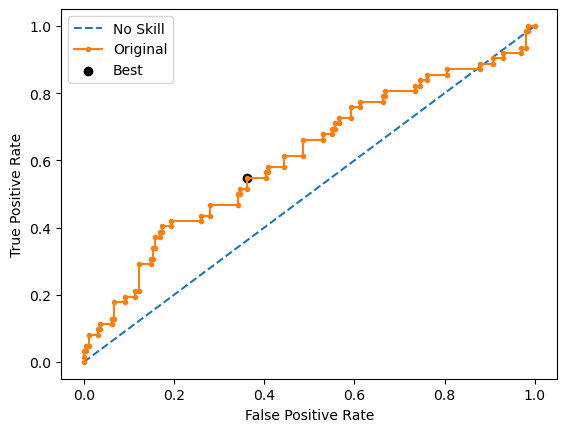

Setting penalty=None will ignore the C and l1_ratio parameters
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 2 - Random State: 1
Test G-mean: 0.569192051803901
Best Threshold=0.541754, G-Mean=0.574


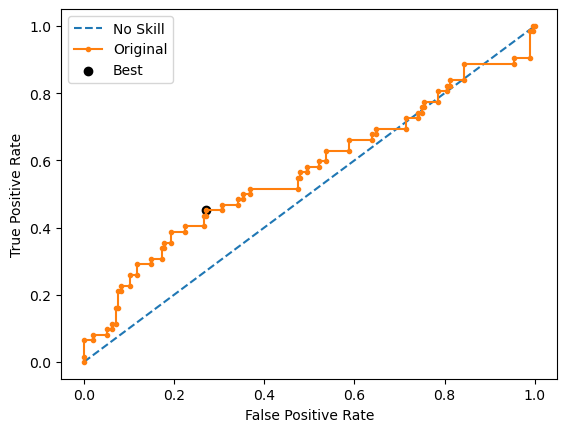

Setting penalty=None will ignore the C and l1_ratio parameters


Run 3 - Random State: 2
Test G-mean: 0.5636714267085828
Best Threshold=0.512322, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


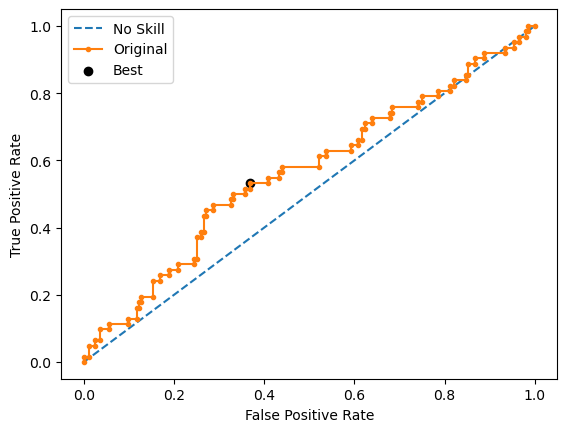

Setting penalty=None will ignore the C and l1_ratio parameters
lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


Run 4 - Random State: 3
Test G-mean: 0.5951996915414691
Best Threshold=0.488220, G-Mean=0.610


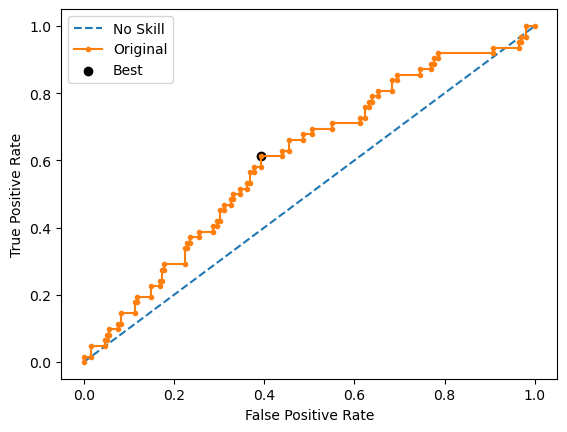

Setting penalty=None will ignore the C and l1_ratio parameters


Run 5 - Random State: 4
Test G-mean: 0.539273888233625
Best Threshold=0.489920, G-Mean=0.565


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


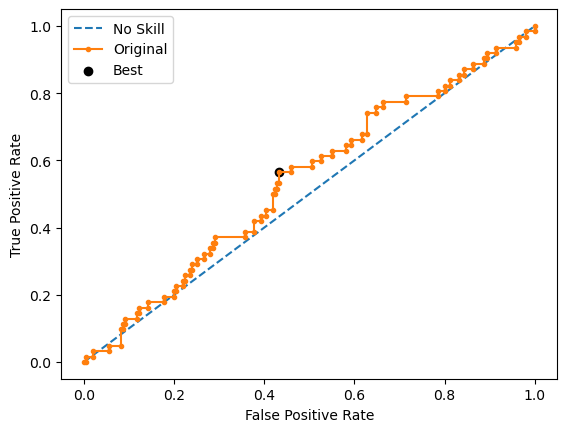

Ave Test G-mean: 0.5698366679853856
Stdev Test G-mean: 0.02097631414358341
Ave Test Specificity: 0.6142857142857143
Ave Test Recall: 0.5290322580645161
Ave Test NPV: 0.8046909529665209
Ave Test Accuracy: 0.5937984496124031
Ave Test Precision: 0.30299596398147177
Ave Test F1-Score: 0.3851475266183639
Ave Runtime: 0.63923659324646


In [ ]:
ho_t05_logreg_gs, ho_t05_logreg_be, ho_t05_logreg_model_info, ho_t05_logreg_metrics_df = logreg_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits


[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 100000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5429950763900592
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=100000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2872778417050305
Std Train Score (G-mean) 0.04560825876753685
GridSearchCV Runtime: 132.39731216430664 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.5034443575988877
Best Threshold=0.500000, G-Mean=0.346


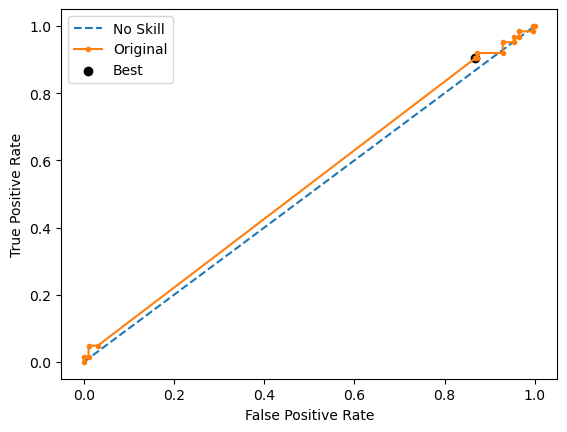

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 2 - Random State: 1
Test G-mean: 0.5263779371505743
Best Threshold=0.505006, G-Mean=0.305


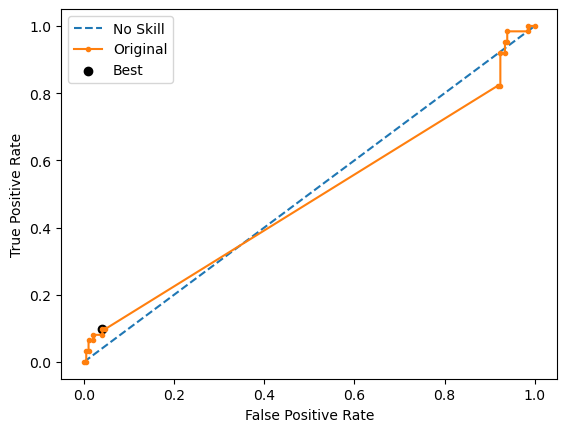

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5284063760237141
Best Threshold=0.511266, G-Mean=0.443


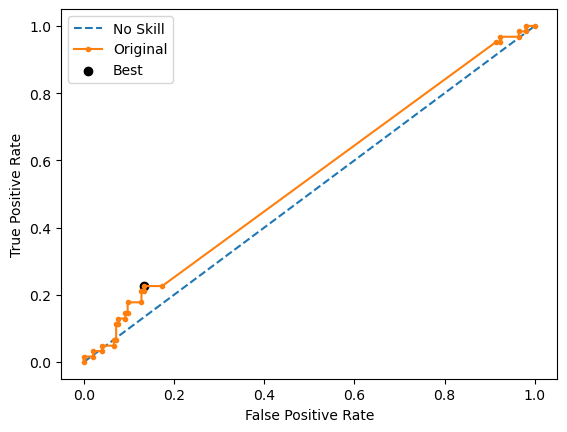

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 4 - Random State: 3
Test G-mean: 0.5497021756333007
Best Threshold=0.500000, G-Mean=0.396


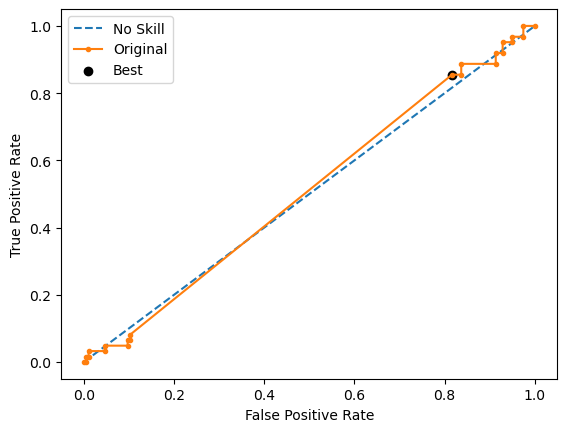

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 5 - Random State: 4
Test G-mean: 0.5562500231154435
Best Threshold=0.494494, G-Mean=0.143


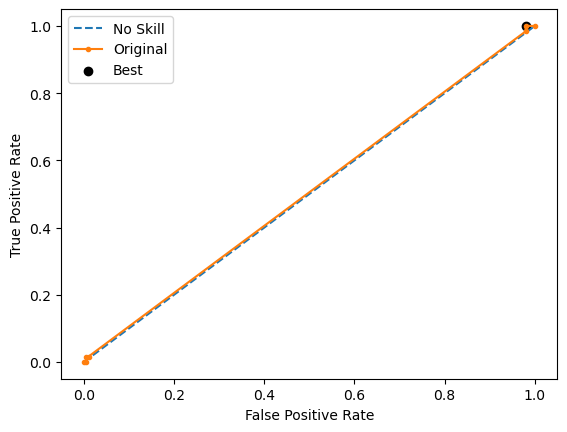

Ave Test G-mean: 0.5328361739043841
Stdev Test G-mean: 0.02096354661171347
Ave Test Specificity: 0.4897959183673469
Ave Test Recall: 0.5935483870967742
Ave Test NPV: 0.792879955744053
Ave Test Accuracy: 0.5147286821705427
Ave Test Precision: 0.2696568187294416
Ave Test F1-Score: 0.36899079871828794
Ave Runtime: 0.35968632698059083


In [ ]:
ho_t05_svm_gs, ho_t05_svm_be, ho_t05_svm_model_info, ho_t05_svm_metrics_df = svm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t05_knn_gs, ho_t05_knn_be, ho_t05_knn_model_info, ho_t05_knn_metrics_df = knn_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits


Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 11, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5582815646133021
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=11))])
Mean Train Score (G-mean) 0.69379125155105
Std Train Score (G-mean) 0.014689486936425258
GridSearchCV Runtime: 112.72086524963379 secs
Run 1 - Random State: 0
Test G-mean: 0.4807006078538353
Run 2 - Random State: 1
Test G-mean: 0.47031708100177233
Run 3 - Random State: 2
Test G-mean: 0.5654206052395802
Run 4 - Random State: 3
Test G-mean: 0.5057275636779099
Run 5 - Random State: 4
Test G-mean: 0.5052391738356632
Ave Test G-mean: 0.5054810063217522
Stdev Test G-mean: 0.03688985153144814
Ave Test Specificity: 0.5306122448979591
Ave Test Recall: 0.4838709677419355
Ave Test NPV: 0.7645108496408456
Ave T

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5903444676005928
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
                               interaction_constrai

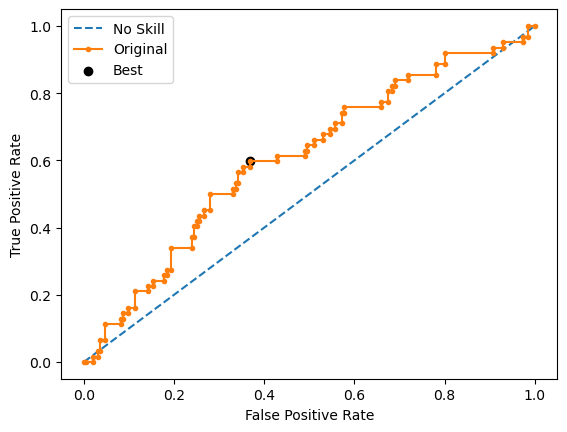

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.397429, G-Mean=0.631


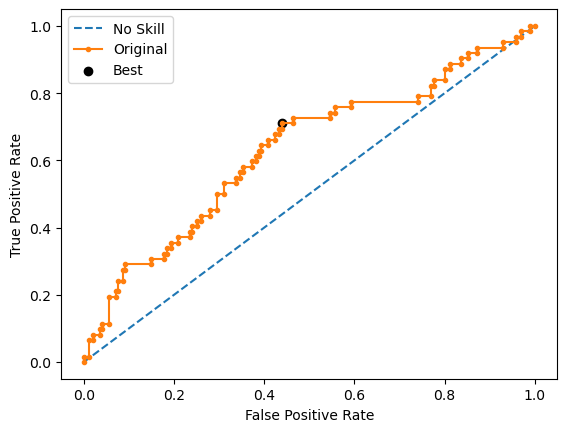

Run 3 - Random State: 2
Test G-mean: 0.5312021964706288
Best Threshold=0.382905, G-Mean=0.594


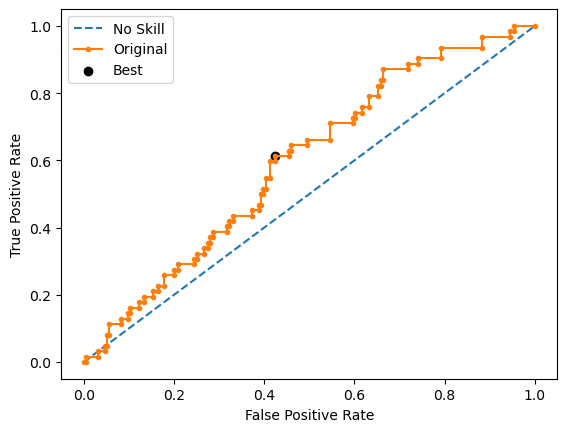

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.642425, G-Mean=0.587


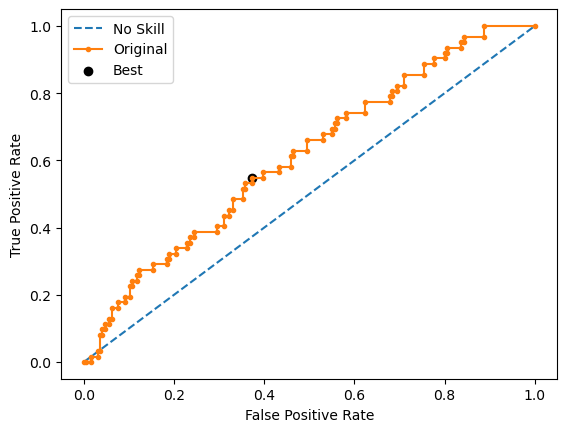

Run 5 - Random State: 4
Test G-mean: 0.5521667178180558
Best Threshold=0.666844, G-Mean=0.594


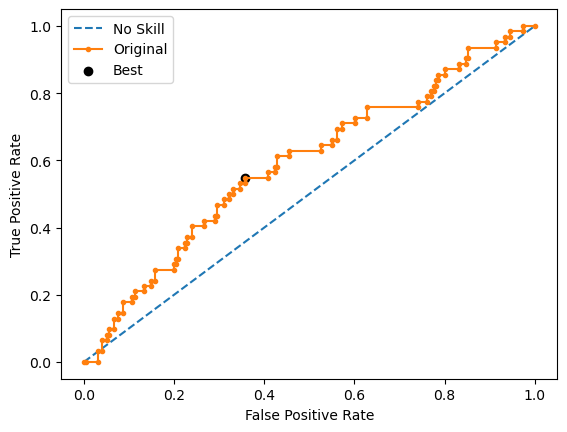

Ave Test G-mean: 0.5723916519163362
Stdev Test G-mean: 0.031446415182837424
Ave Test Specificity: 0.5806122448979592
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8109762192024684
Ave Test Accuracy: 0.5782945736434109
Ave Test Precision: 0.3018463409697703
Ave Test F1-Score: 0.3934647403911834
Ave Runtime: 0.3626582145690918


In [ ]:
ho_t05_xgb_gs, ho_t05_xgb_be, ho_t05_xgb_model_info, ho_t05_xgb_metrics_df = xgb_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.002390 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 689
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

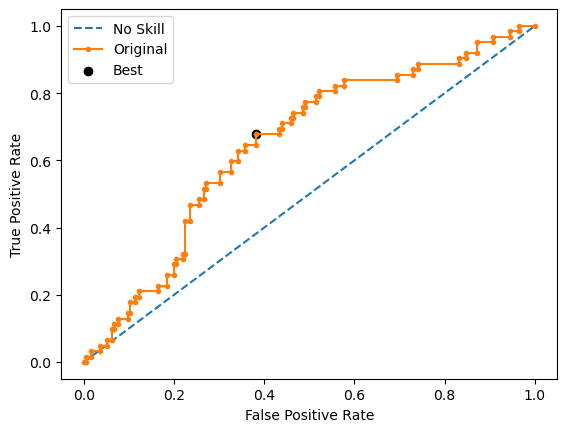

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.001117 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 700
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits w

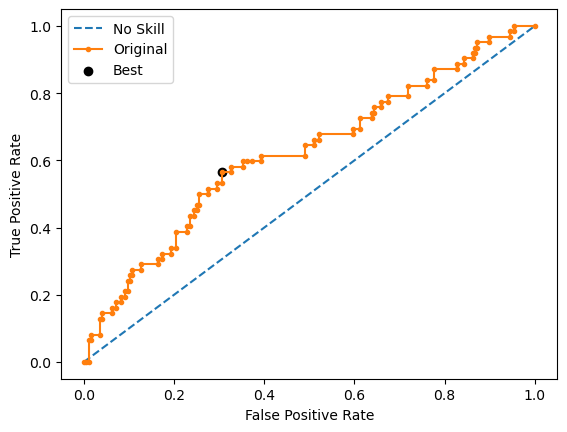

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000888 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 693
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

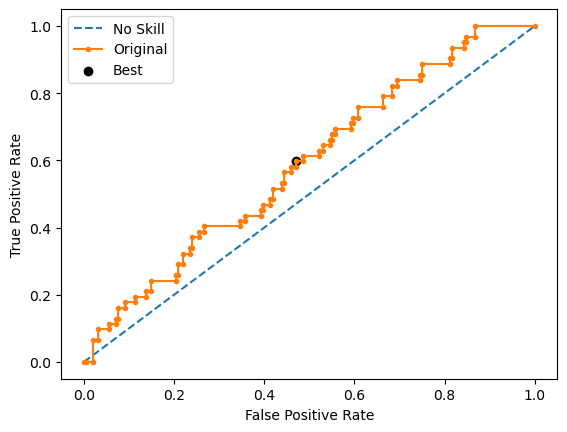

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001462 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 693
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 48
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

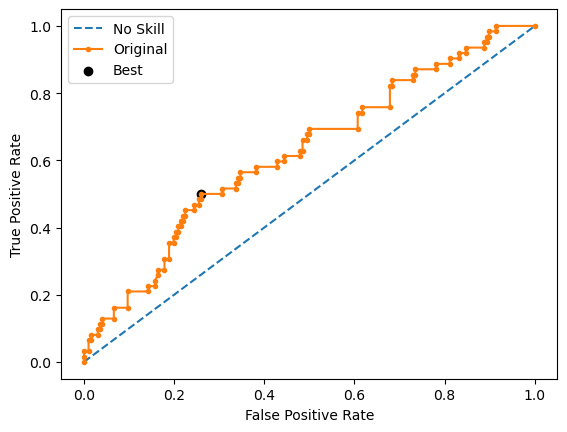

[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 684
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 47
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positiv

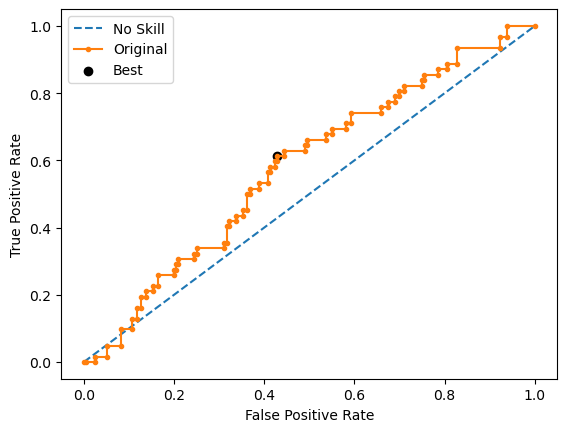

Ave Test G-mean: 0.5945713161869624
Stdev Test G-mean: 0.046127515612995135
Ave Test Specificity: 0.6244897959183674
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8222443176286957
Ave Test Accuracy: 0.6116279069767442
Ave Test Precision: 0.32455987922037877
Ave Test F1-Score: 0.4129134669771542
Ave Runtime: 0.21028051376342774


In [ ]:
ho_t05_lgbm_gs, ho_t05_lgbm_be, ho_t05_lgbm_model_info, ho_t05_lgbm_metrics_df = lgbm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits


Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.587471696840875
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9478261660647472
Std Train Score (G-mean) 0.005565821749660911
GridSearchCV Runtime: 15.005309343338013 secs
Run 1 - Random State: 0
Test G-mean: 0.6060915267313265
Best Threshold=0.880797, G-Mean=0.606


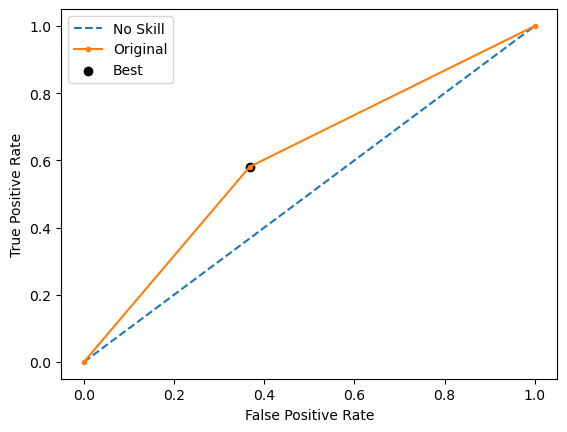

Run 2 - Random State: 1
Test G-mean: 0.6071767407189163
Best Threshold=0.880797, G-Mean=0.607


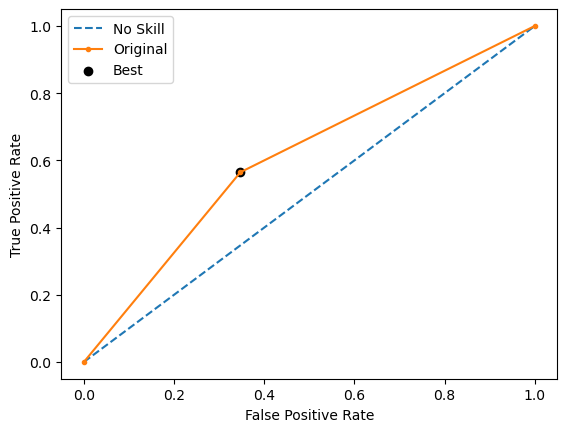

Run 3 - Random State: 2
Test G-mean: 0.5669467095138409
Best Threshold=0.880797, G-Mean=0.567


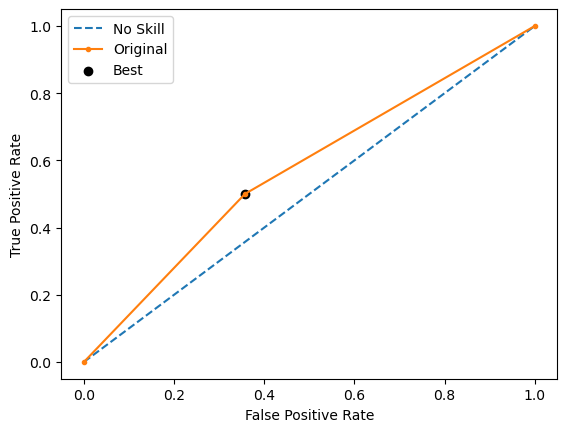

Run 4 - Random State: 3
Test G-mean: 0.5878963512522154
Best Threshold=0.880797, G-Mean=0.588


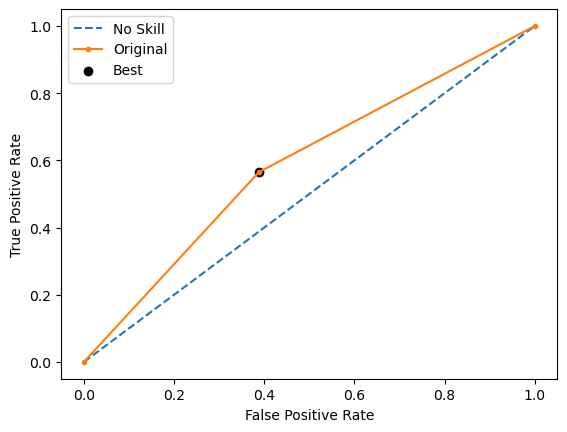

Run 5 - Random State: 4
Test G-mean: 0.5465494128601982
Best Threshold=0.880797, G-Mean=0.547


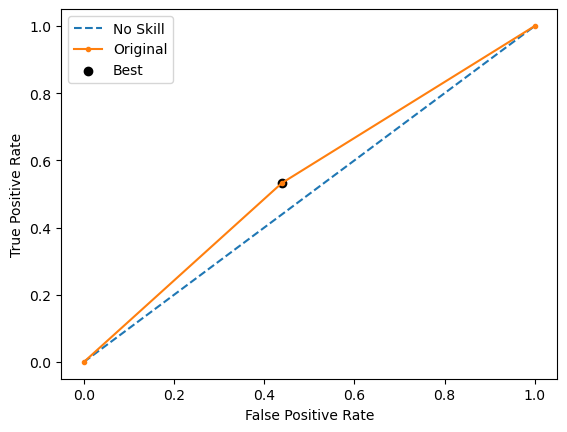

Ave Test G-mean: 0.5829321482152994
Stdev Test G-mean: 0.026115311950578902
Ave Test Specificity: 0.620408163265306
Ave Test Recall: 0.5483870967741936
Ave Test NPV: 0.8125428652134545
Ave Test Accuracy: 0.6031007751937985
Ave Test Precision: 0.3145392182660844
Ave Test F1-Score: 0.3994810191202375
Ave Runtime: 0.3101449489593506


In [ ]:
ho_t05_adaboost_gs, ho_t05_adaboost_be, ho_t05_adaboost_model_info, ho_t05_adaboost_metrics_df = adaboost_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5828116611563584
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8833761066250382
Std Train Score (G-mean) 0.010514679929685893
GridSearchCV Runtime: 149.15361618995667 secs
Run 1 - Random State: 0
Test G-mean: 0.5497021756333007
Best Threshold=0.591010, G-Mean=0.585


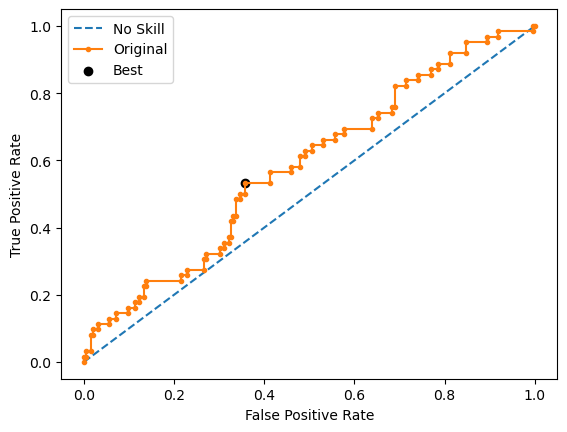

Run 2 - Random State: 1
Test G-mean: 0.5696978398265997
Best Threshold=0.678212, G-Mean=0.582


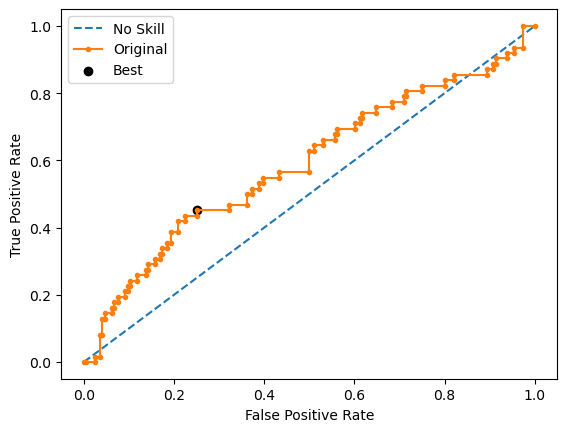

Run 3 - Random State: 2
Test G-mean: 0.5294176810178568
Best Threshold=0.504854, G-Mean=0.529


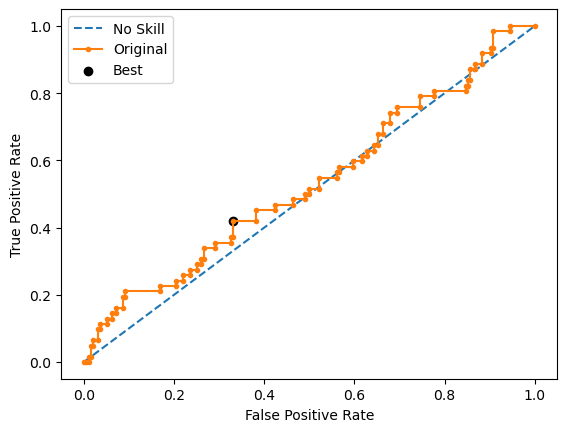

Run 4 - Random State: 3
Test G-mean: 0.5864949276826683
Best Threshold=0.529375, G-Mean=0.602


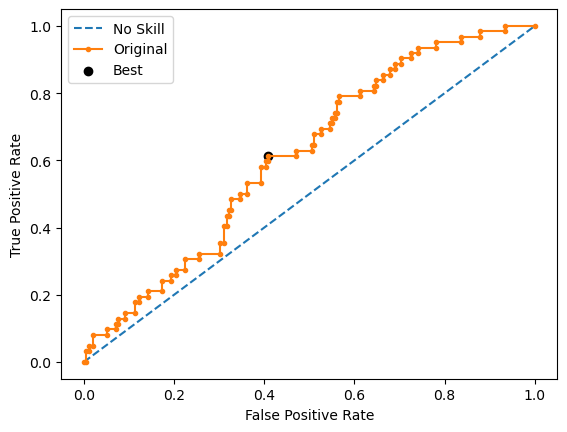

Run 5 - Random State: 4
Test G-mean: 0.56542060523958
Best Threshold=0.449592, G-Mean=0.579


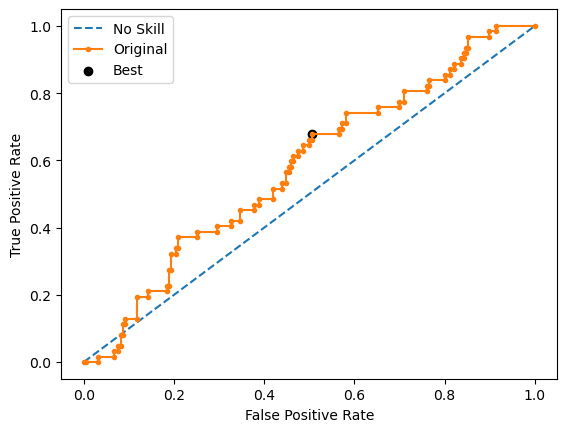

Ave Test G-mean: 0.5601466458800012
Stdev Test G-mean: 0.021602246106122304
Ave Test Specificity: 0.5755102040816327
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8030899046720947
Ave Test Accuracy: 0.5697674418604651
Ave Test Precision: 0.29127941791513523
Ave Test F1-Score: 0.3798617504315097
Ave Runtime: 0.6361113071441651


In [ ]:
ho_t05_gbm_gs, ho_t05_gbm_be, ho_t05_gbm_model_info, ho_t05_gbm_metrics_df = gbm_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits


Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.595930959178998
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=2, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6099318861568523
Std Train Score (G-mean) 0.024214352161286905
GridSearchCV Runtime: 344.96700978279114 secs
Run 1 - Random State: 0
Test G-mean: 0.6315571110069641
Best Threshold=0.495801, G-Mean=0.655


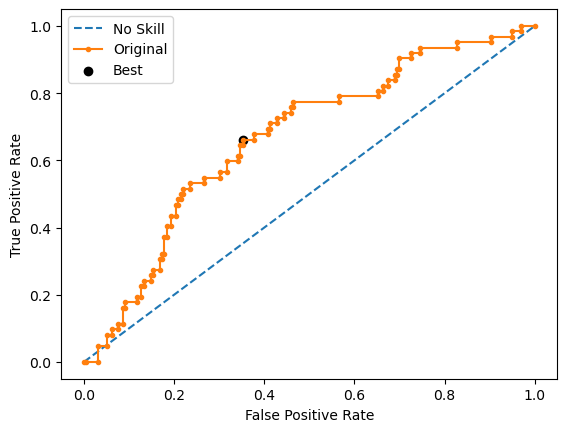

Run 2 - Random State: 1
Test G-mean: 0.5815633512644206
Best Threshold=0.493450, G-Mean=0.603


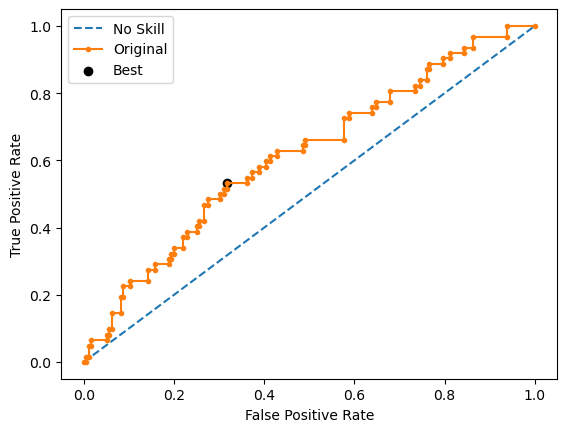

Run 3 - Random State: 2
Test G-mean: 0.5850901473955347
Best Threshold=0.492791, G-Mean=0.610


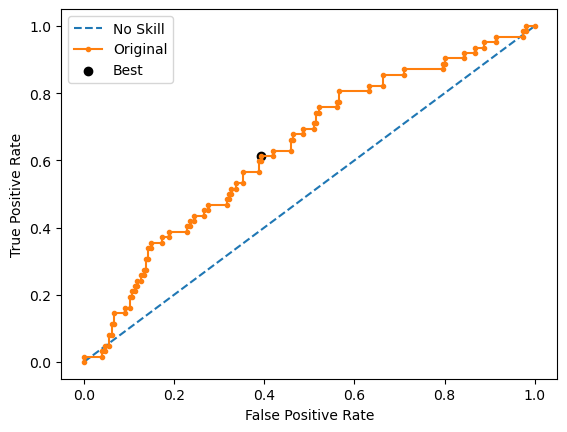

Run 4 - Random State: 3
Test G-mean: 0.601183822262458
Best Threshold=0.508115, G-Mean=0.617


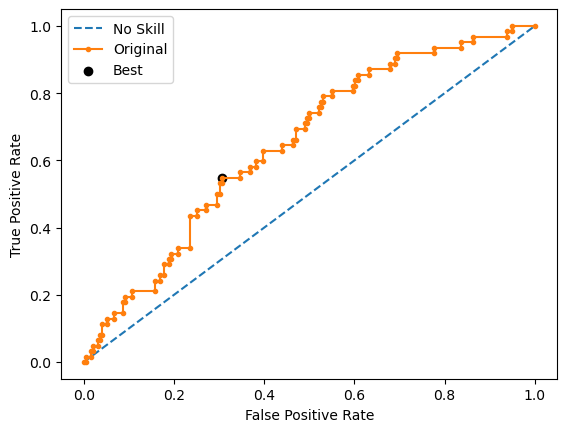

Run 5 - Random State: 4
Test G-mean: 0.5755181996745907
Best Threshold=0.505181, G-Mean=0.598


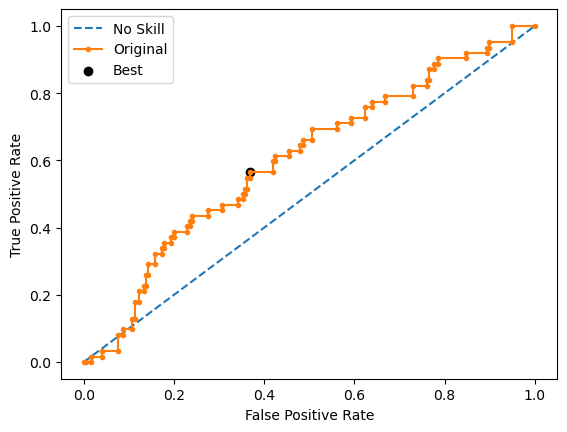

Ave Test G-mean: 0.5949825263207936
Stdev Test G-mean: 0.02254412200611578
Ave Test Specificity: 0.6479591836734695
Ave Test Recall: 0.5483870967741935
Ave Test NPV: 0.8194155913142911
Ave Test Accuracy: 0.624031007751938
Ave Test Precision: 0.3310702454346537
Ave Test F1-Score: 0.4120867167403376
Ave Runtime: 0.44906344413757326


In [ ]:
ho_t05_rf_gs, ho_t05_rf_be, ho_t05_rf_model_info, ho_t05_rf_metrics_df = rf_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits


Learning rate set to 0.006754
0:	learn: 0.6917977	total: 2.97ms	remaining: 2.96s
1:	learn: 0.6902348	total: 4.81ms	remaining: 2.4s
2:	learn: 0.6893033	total: 8.51ms	remaining: 2.83s
3:	learn: 0.6885068	total: 11.8ms	remaining: 2.94s
4:	learn: 0.6875450	total: 14.9ms	remaining: 2.96s
5:	learn: 0.6861445	total: 17.4ms	remaining: 2.88s
6:	learn: 0.6853292	total: 19.9ms	remaining: 2.82s
7:	learn: 0.6845619	total: 22.5ms	remaining: 2.79s
8:	learn: 0.6833746	total: 24.7ms	remaining: 2.71s
9:	learn: 0.6821821	total: 26.9ms	remaining: 2.66s
10:	learn: 0.6809110	total: 29.5ms	remaining: 2.65s
11:	learn: 0.6797924	total: 31.7ms	remaining: 2.61s
12:	learn: 0.6787607	total: 34ms	remaining: 2.58s
13:	learn: 0.6772935	total: 36.3ms	remaining: 2.56s
14:	learn: 0.6761927	total: 38.3ms	remaining: 2.51s
15:	learn: 0.6751500	total: 40.3ms	remaining: 2.48s
16:	learn: 0.6738294	total: 42.6ms	remaining: 2.46s
17:	learn: 0.6727370	total: 44.5ms	remaining: 2.43s
18:	learn: 0.6716259	total: 46.1ms	remaining: 2

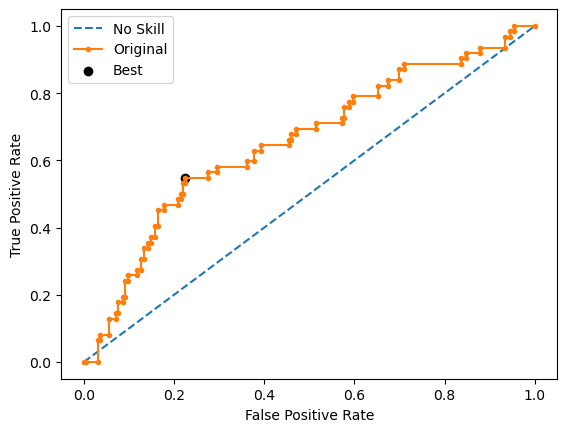

Learning rate set to 0.006754
0:	learn: 0.6914433	total: 3.87ms	remaining: 3.86s
1:	learn: 0.6900294	total: 8.45ms	remaining: 4.22s
2:	learn: 0.6886887	total: 13.2ms	remaining: 4.38s
3:	learn: 0.6876392	total: 18.1ms	remaining: 4.5s
4:	learn: 0.6864282	total: 23.2ms	remaining: 4.62s
5:	learn: 0.6847816	total: 28ms	remaining: 4.64s
6:	learn: 0.6831166	total: 32.2ms	remaining: 4.57s
7:	learn: 0.6815465	total: 35.1ms	remaining: 4.36s
8:	learn: 0.6804804	total: 40.8ms	remaining: 4.49s
9:	learn: 0.6788058	total: 44.6ms	remaining: 4.42s
10:	learn: 0.6772484	total: 48.2ms	remaining: 4.33s
11:	learn: 0.6750571	total: 51.9ms	remaining: 4.28s
12:	learn: 0.6733833	total: 55.6ms	remaining: 4.22s
13:	learn: 0.6724862	total: 62ms	remaining: 4.36s
14:	learn: 0.6709660	total: 66.7ms	remaining: 4.38s
15:	learn: 0.6693293	total: 71.6ms	remaining: 4.4s
16:	learn: 0.6678461	total: 74.4ms	remaining: 4.3s
17:	learn: 0.6666597	total: 78.4ms	remaining: 4.28s
18:	learn: 0.6654598	total: 83.2ms	remaining: 4.3s


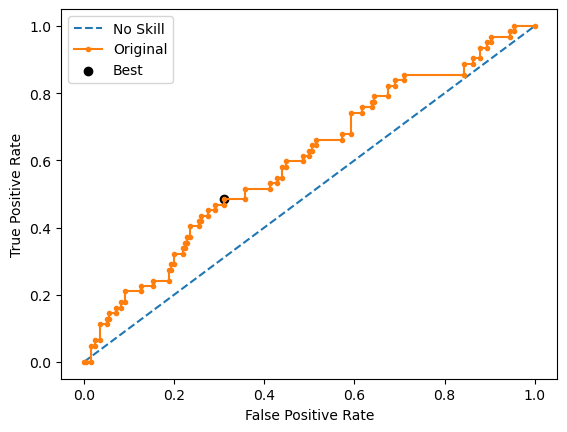

Learning rate set to 0.006754
0:	learn: 0.6924791	total: 4.21ms	remaining: 4.21s
1:	learn: 0.6909744	total: 8.97ms	remaining: 4.47s
2:	learn: 0.6900791	total: 14.7ms	remaining: 4.89s
3:	learn: 0.6893194	total: 19.4ms	remaining: 4.83s
4:	learn: 0.6887967	total: 24.8ms	remaining: 4.93s
5:	learn: 0.6876795	total: 28.9ms	remaining: 4.79s
6:	learn: 0.6867252	total: 32.1ms	remaining: 4.55s
7:	learn: 0.6860541	total: 34.2ms	remaining: 4.25s
8:	learn: 0.6852618	total: 37.6ms	remaining: 4.14s
9:	learn: 0.6844782	total: 40.2ms	remaining: 3.98s
10:	learn: 0.6835143	total: 42.7ms	remaining: 3.84s
11:	learn: 0.6824772	total: 45.5ms	remaining: 3.74s
12:	learn: 0.6815703	total: 47ms	remaining: 3.57s
13:	learn: 0.6808079	total: 48.7ms	remaining: 3.43s
14:	learn: 0.6800360	total: 50.8ms	remaining: 3.33s
15:	learn: 0.6792798	total: 53.2ms	remaining: 3.27s
16:	learn: 0.6781292	total: 55.2ms	remaining: 3.19s
17:	learn: 0.6772525	total: 56.7ms	remaining: 3.09s
18:	learn: 0.6764761	total: 58.6ms	remaining: 

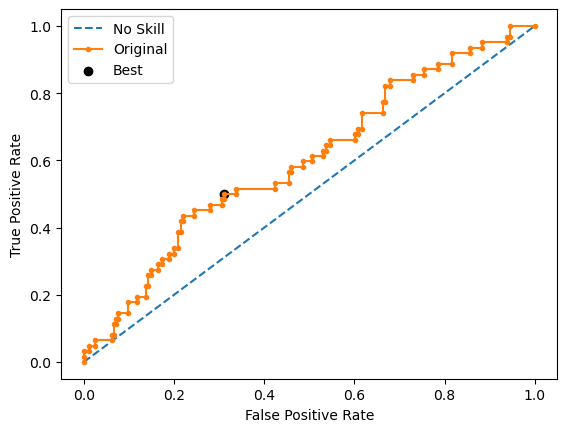

Learning rate set to 0.006754
0:	learn: 0.6922129	total: 3.1ms	remaining: 3.1s
1:	learn: 0.6912579	total: 7.15ms	remaining: 3.57s
2:	learn: 0.6903449	total: 10.5ms	remaining: 3.5s
3:	learn: 0.6887396	total: 13ms	remaining: 3.24s
4:	learn: 0.6879495	total: 16.7ms	remaining: 3.32s
5:	learn: 0.6867959	total: 20.9ms	remaining: 3.47s
6:	learn: 0.6852498	total: 25ms	remaining: 3.54s
7:	learn: 0.6835548	total: 28.3ms	remaining: 3.51s
8:	learn: 0.6825712	total: 31.6ms	remaining: 3.48s
9:	learn: 0.6809767	total: 34.9ms	remaining: 3.45s
10:	learn: 0.6797229	total: 38.2ms	remaining: 3.43s
11:	learn: 0.6781012	total: 42.5ms	remaining: 3.5s
12:	learn: 0.6770691	total: 46ms	remaining: 3.49s
13:	learn: 0.6766071	total: 47.9ms	remaining: 3.37s
14:	learn: 0.6753485	total: 51ms	remaining: 3.35s
15:	learn: 0.6736385	total: 54.2ms	remaining: 3.33s
16:	learn: 0.6718781	total: 56.7ms	remaining: 3.28s
17:	learn: 0.6708526	total: 59.1ms	remaining: 3.23s
18:	learn: 0.6693183	total: 61.9ms	remaining: 3.19s
19:	

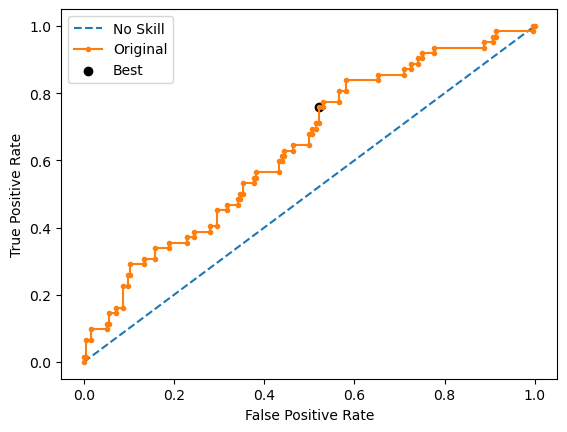

Learning rate set to 0.006754
0:	learn: 0.6914568	total: 5.25ms	remaining: 5.24s
1:	learn: 0.6902125	total: 10.8ms	remaining: 5.4s
2:	learn: 0.6887068	total: 16.3ms	remaining: 5.4s
3:	learn: 0.6874764	total: 22.1ms	remaining: 5.51s
4:	learn: 0.6860968	total: 27.5ms	remaining: 5.47s
5:	learn: 0.6846044	total: 32.7ms	remaining: 5.41s
6:	learn: 0.6838692	total: 36.6ms	remaining: 5.19s
7:	learn: 0.6832762	total: 40.2ms	remaining: 4.98s
8:	learn: 0.6825057	total: 44.1ms	remaining: 4.86s
9:	learn: 0.6814077	total: 46.7ms	remaining: 4.62s
10:	learn: 0.6804399	total: 50.4ms	remaining: 4.53s
11:	learn: 0.6791093	total: 53.6ms	remaining: 4.42s
12:	learn: 0.6777054	total: 55.3ms	remaining: 4.2s
13:	learn: 0.6770722	total: 56.9ms	remaining: 4.01s
14:	learn: 0.6761980	total: 59.6ms	remaining: 3.92s
15:	learn: 0.6749047	total: 62.4ms	remaining: 3.83s
16:	learn: 0.6739490	total: 65.4ms	remaining: 3.78s
17:	learn: 0.6730143	total: 67.6ms	remaining: 3.69s
18:	learn: 0.6711545	total: 70.1ms	remaining: 3

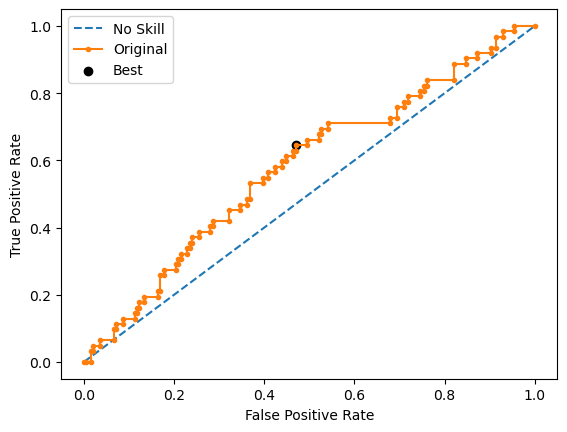

Ave Test G-mean: 0.5814443187899833
Stdev Test G-mean: 0.018374617350089432
Ave Test Specificity: 0.6091836734693877
Ave Test Recall: 0.5580645161290322
Ave Test NPV: 0.8136491858338042
Ave Test Accuracy: 0.5968992248062015
Ave Test Precision: 0.31170357468316395
Ave Test F1-Score: 0.39914401146298845
Ave Runtime: 1.5967380046844482


In [ ]:
ho_t05_catboost_gs, ho_t05_catboost_be, ho_t05_catboost_model_info, ho_t05_catboost_metrics_df = catboost_class2(ho_t05, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t05_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t05_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t05_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.595716,0.029971,0.588219,NaN,0.622449,0.583871,0.330100,0.417926,0.613178
4,Random Forest,0.594983,0.022544,0.595931,0.609932,0.647959,0.548387,0.331070,0.412087,0.624031
6,LightGBM,0.594571,0.046128,0.611386,0.738260,0.624490,0.570968,0.324560,0.412913,0.611628
8,AdaBoost,0.582932,0.026115,0.587472,0.947826,0.620408,0.548387,0.314539,0.399481,0.603101
9,CatBoost,0.581444,0.018375,0.598435,0.947852,0.609184,0.558065,0.311704,0.399144,0.596899
7,Extreme Gradient Boosting (XGBoost),0.572392,0.031446,0.590344,0.851932,0.580612,0.570968,0.301846,0.393465,0.578295
2,Logistic Regression,0.569837,0.020976,0.561460,NaN,0.614286,0.529032,0.302996,0.385148,0.593798
5,Gradient Boosting Machine (GBM),0.560147,0.021602,0.582812,0.883376,0.575510,0.551613,0.291279,0.379862,0.569767
1,SVM Classifier,0.532836,0.020964,0.542995,0.287278,0.489796,0.593548,0.269657,0.368991,0.514729
0,k-Nearest Neighbors,0.505481,0.036890,0.558282,0.693791,0.530612,0.483871,0.246144,0.325966,0.519380


In [ ]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t05_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.624031,Random Forest
Highest Test G-mean,0.595716,Decision Tree
Highest Test Recall,0.593548,SVM Classifier
Highest Test Precision,0.331070,Random Forest
Highest Test Specificity,0.647959,Random Forest
Highest Test F1-score,0.417926,Decision Tree


# HO-T06 Runs

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits



4320 fits failed out of a total of 17280.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
2141 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1145, in wrapper
    estimator._validate_params()
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 638, in _

Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 110.61709713935852 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


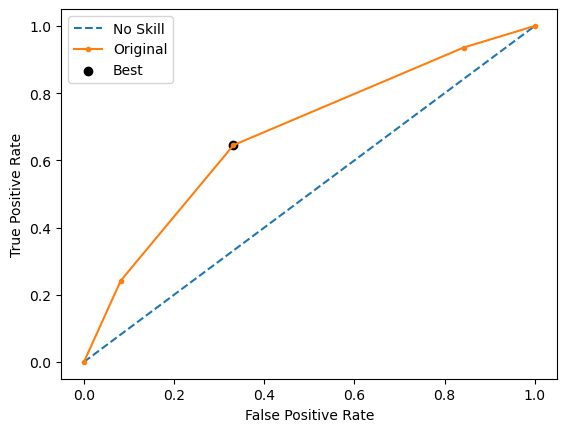

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


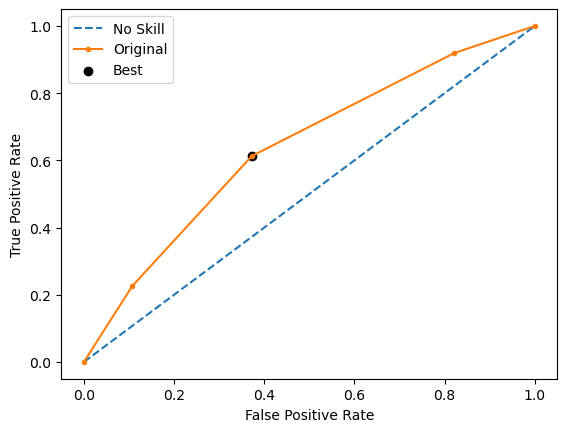

Run 3 - Random State: 2
Test G-mean: 0.6415757839135445
Best Threshold=0.544160, G-Mean=0.642


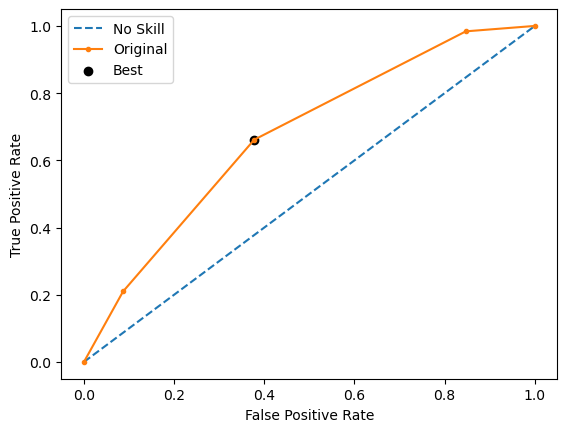

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


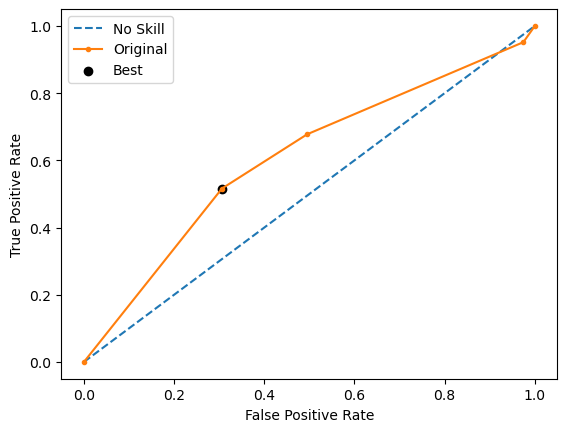

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


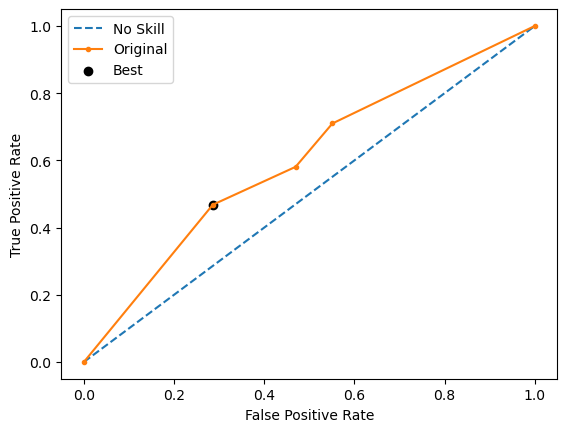

Ave Test G-mean: 0.6116872427478487
Stdev Test G-mean: 0.04156076174606436
Ave Test Specificity: 0.5908163265306122
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835604694092089
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3326449471612906
Ave Test F1-Score: 0.4356965853779212
Ave Runtime: 0.014374446868896485


In [ ]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\model_selection\_validation.py", line 729, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\base.py", line 1152, in wrapper
    return fit_method(estimator, *args, **kwargs)
  File "c:\Users\Carlo\mambaforge\envs\myenv\lib\site-packages\sklearn\linear_mod

Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5407262229941359
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 LogisticRegression(C=1000000.0, max_iter=1000,
                                    random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 49.16239643096924 secs
Run 1 - Random State: 0
Test G-mean: 0.5866352206945261
Best Threshold=0.498398, G-Mean=0.595


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


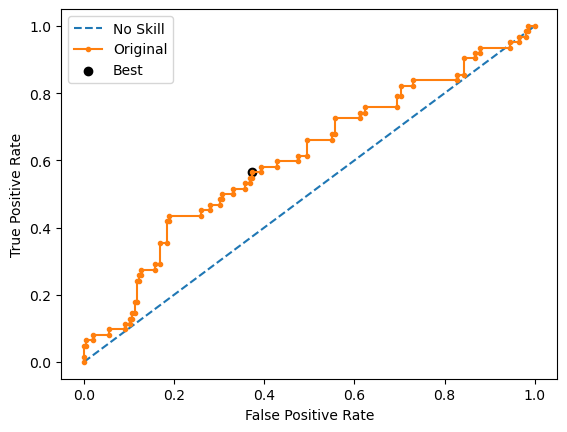

Run 2 - Random State: 1
Test G-mean: 0.5395789937110657
Best Threshold=0.451954, G-Mean=0.584


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


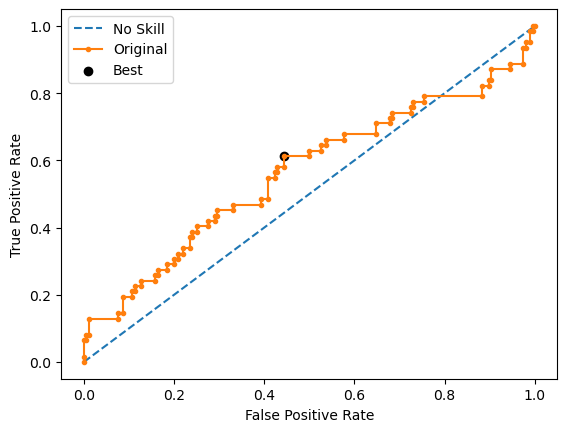

Run 3 - Random State: 2
Test G-mean: 0.5280168968110512
Best Threshold=0.513453, G-Mean=0.547


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


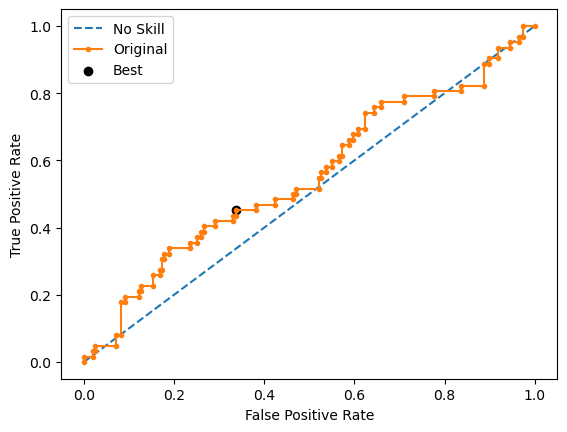

Run 4 - Random State: 3
Test G-mean: 0.5736563715788933
Best Threshold=0.441269, G-Mean=0.611


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


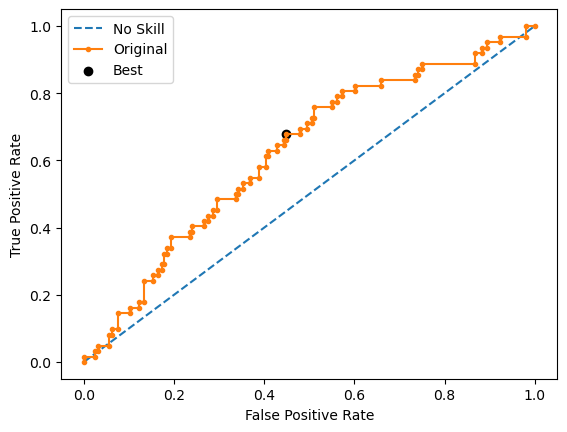

Run 5 - Random State: 4
Test G-mean: 0.4718891759072044
Best Threshold=0.415607, G-Mean=0.575


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


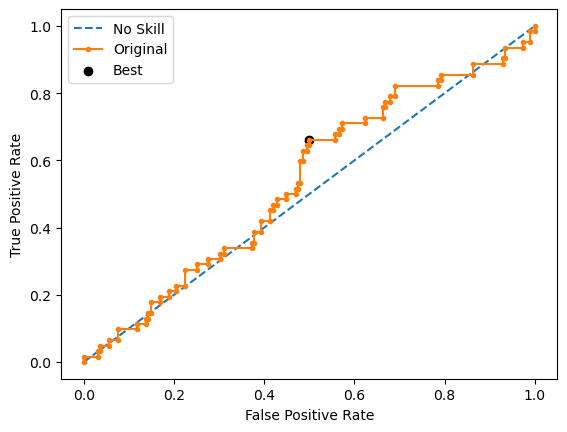

Ave Test G-mean: 0.5399553317405481
Stdev Test G-mean: 0.044973440906130195
Ave Test Specificity: 0.6306122448979592
Ave Test Recall: 0.4645161290322581
Ave Test NPV: 0.7886325397803154
Ave Test Accuracy: 0.5906976744186047
Ave Test Precision: 0.28381210911577753
Ave Test F1-Score: 0.352206146376896
Ave Runtime: 0.2909082889556885


In [ ]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, 'precision',
                       'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': SMOTE(random_state=0)}
Best Validation Score (G-mean): 0.5385868057379548
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', SMOTE(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.2875372679815223
Std Train Score (G-mean) 0.041880632126316444
GridSearchCV Runtime: 54.07827019691467 secs
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 1 - Random State: 0
Test G-mean: 0.561037433666403
Best Threshold=0.500000, G-Mean=0.441


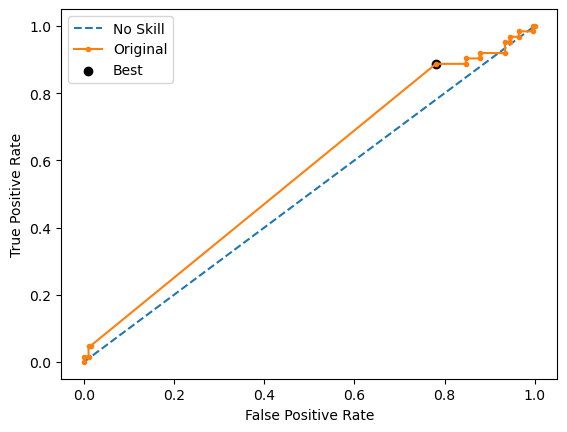

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.507676424709084
Best Threshold=0.506332, G-Mean=0.345


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


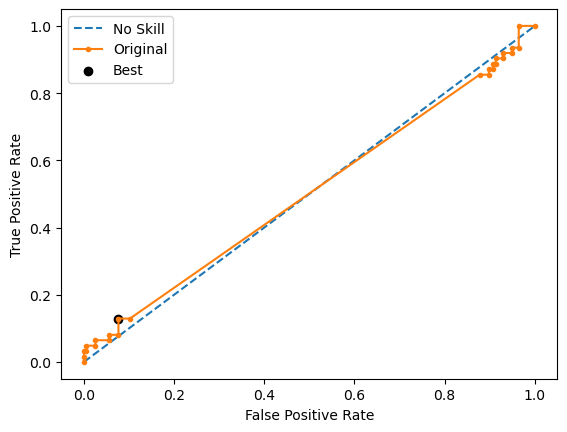

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.5378222735191904
Best Threshold=0.513109, G-Mean=0.437


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


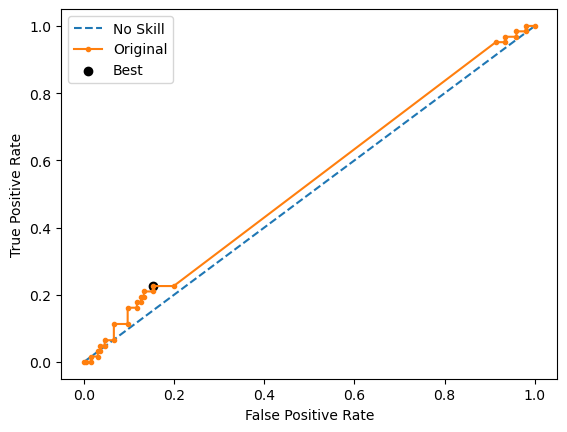

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5248906591678238
Best Threshold=0.500000, G-Mean=0.396


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


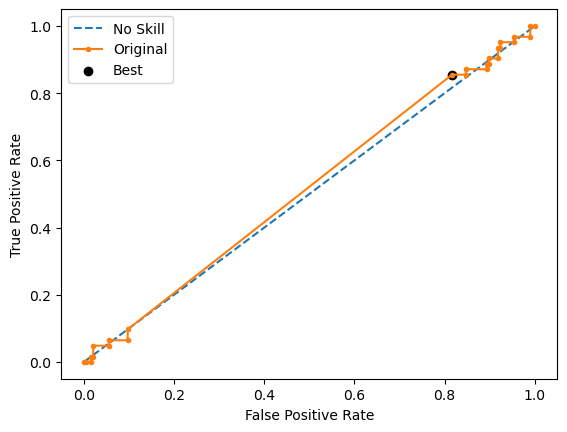

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.49337280177095355
Best Threshold=0.505415, G-Mean=0.277


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


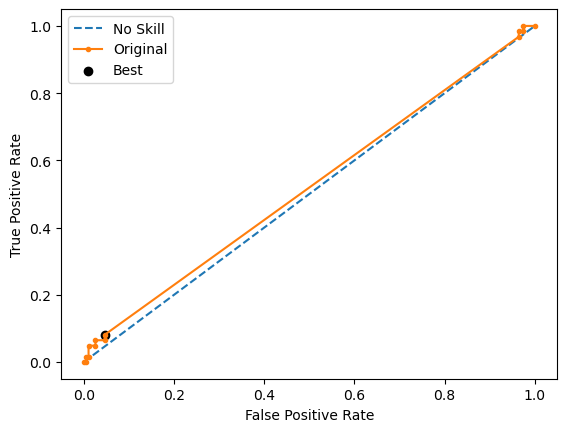

Ave Test G-mean: 0.5249599185666909
Stdev Test G-mean: 0.026284487701645733
Ave Test Specificity: 0.5081632653061223
Ave Test Recall: 0.5516129032258065
Ave Test NPV: 0.7846982839260506
Ave Test Accuracy: 0.5186046511627908
Ave Test Precision: 0.2601434575516043
Ave Test F1-Score: 0.35258426660871295
Ave Runtime: 0.13523101806640625


In [ ]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'braycurtis', 'classifier__n_neighbors': 14, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.5551739420431089
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='braycurtis', n_neighbors=14))])
Mean Train Score (G-mean) 0.6882488586018697
Std Train Score (G-mean) 0.015106552621573476
GridSearchCV Runtime: 29.84093141555786 secs
Run 1 - Random State: 0
Test G-mean: 0.4280911287135166
Run 2 - Random State: 1
Test G-mean: 0.4553825555391872
Run 3 - Random State: 2
Test G-mean: 0.5730104831718917
Run 4 - Random State: 3
Test G-mean: 0.5163552828658922
Run 5 - Random State: 4
Test G-mean: 0.4678611003455939
Ave Test G-mean: 0.48814011012721636
Stdev Test G-mean: 0.05720413442783087
Ave Test Specificity: 0.656122448979591

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5695273785971662
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance

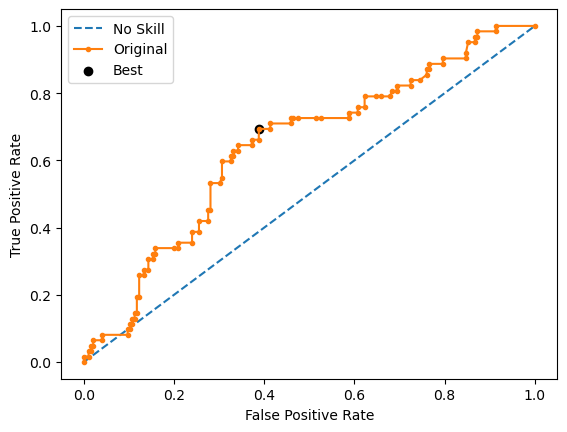

Run 2 - Random State: 1
Test G-mean: 0.6326636793264705
Best Threshold=0.493293, G-Mean=0.636


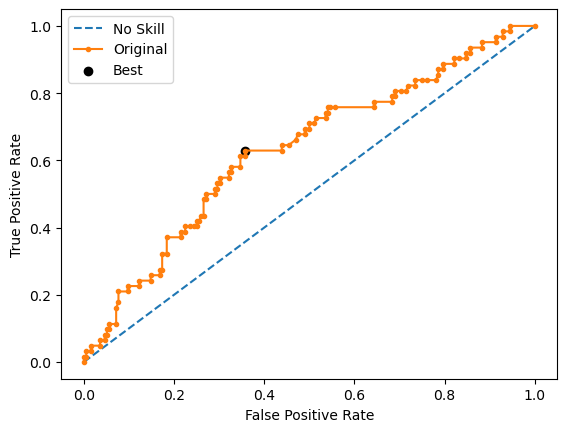

Run 3 - Random State: 2
Test G-mean: 0.5476774830239554
Best Threshold=0.458993, G-Mean=0.564


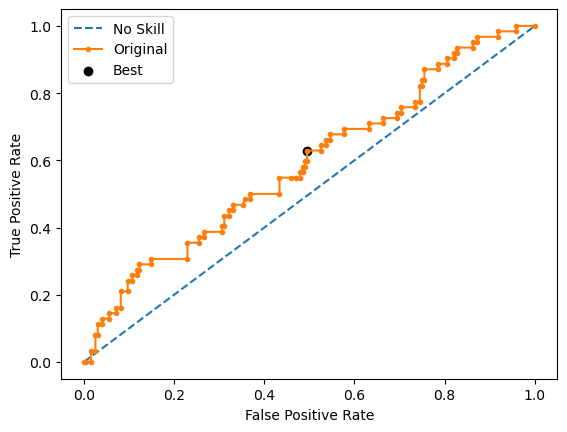

Run 4 - Random State: 3
Test G-mean: 0.6048683337050778
Best Threshold=0.481042, G-Mean=0.614


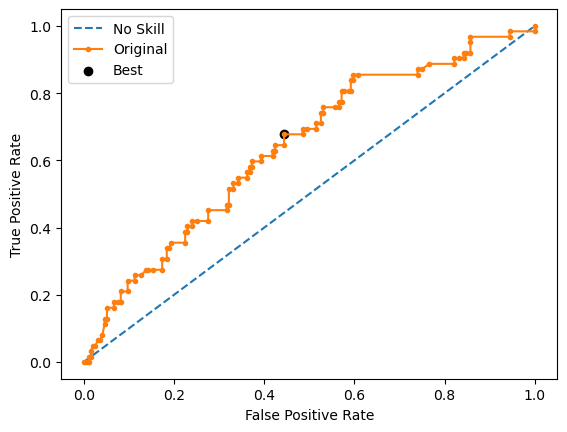

Run 5 - Random State: 4
Test G-mean: 0.5745880397335743
Best Threshold=0.543877, G-Mean=0.611


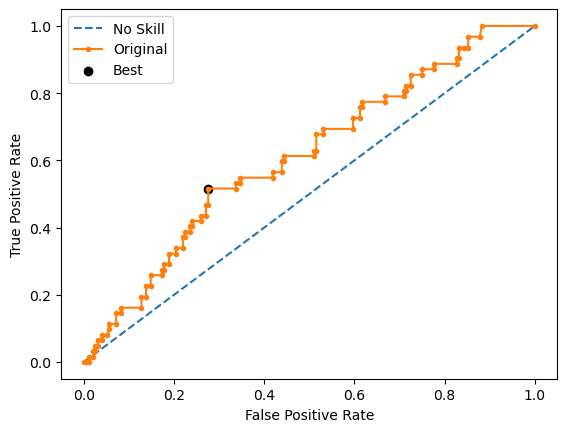

Ave Test G-mean: 0.5987521174719939
Stdev Test G-mean: 0.03748243903978868
Ave Test Specificity: 0.6428571428571429
Ave Test Recall: 0.5612903225806452
Ave Test NPV: 0.8229987307103309
Ave Test Accuracy: 0.6232558139534884
Ave Test Precision: 0.3320006269754075
Ave Test F1-Score: 0.4163508571460087
Ave Runtime: 0.07288060188293458


In [ ]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits


[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000766 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 661
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with po

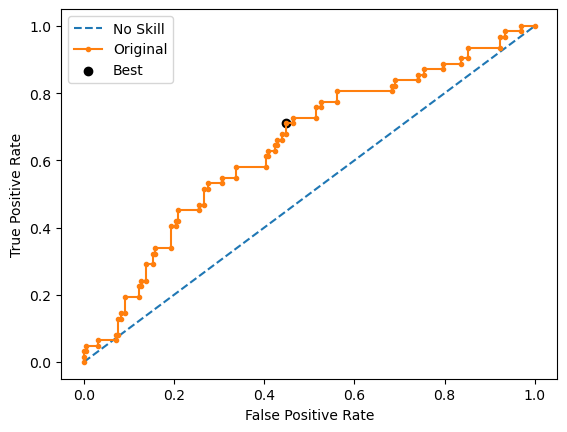

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000412 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 673
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

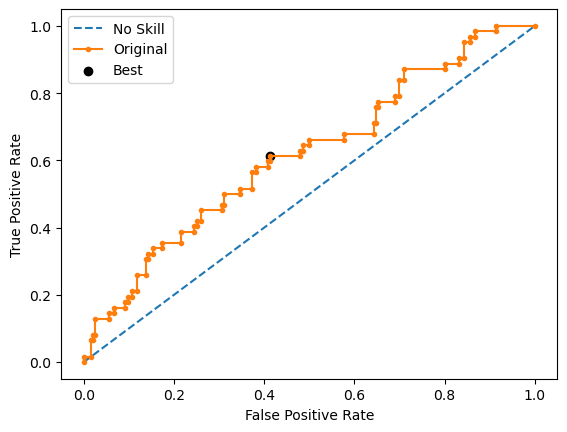

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000431 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 670
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

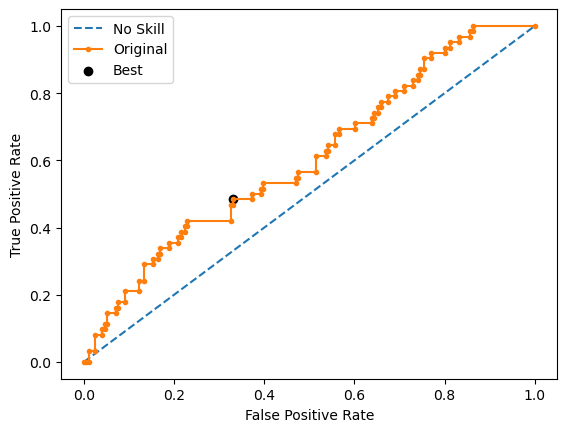

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000757 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 662
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

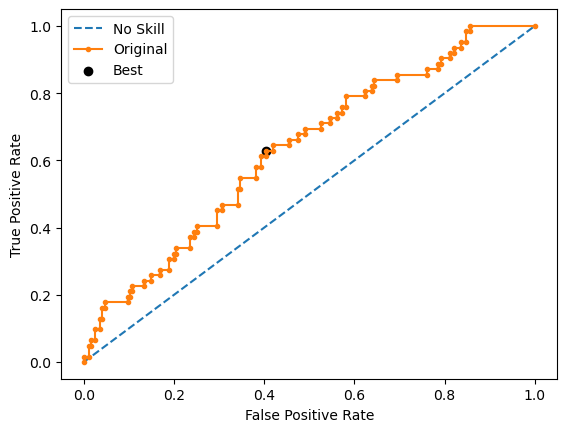

[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Warning] Found boosting=goss. For backwards compatibility reasons, LightGBM interprets this as boosting=gbdt, data_sample_strategy=goss.To suppress this warning, set data_sample_strategy=goss instead.
[LightGBM] [Info] Number of positive: 186, number of negative: 186
[LightGBM] [Warning] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000320 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 658
[LightGBM] [Info] Number of data points in the train set: 372, number of used features: 45
[LightGBM] [Info] Using GOSS
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further spl

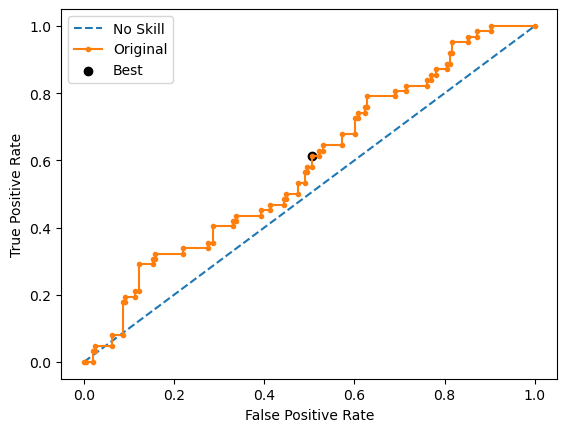

Ave Test G-mean: 0.5747302102021193
Stdev Test G-mean: 0.04083957545129802
Ave Test Specificity: 0.596938775510204
Ave Test Recall: 0.5548387096774194
Ave Test NPV: 0.8092833319187417
Ave Test Accuracy: 0.5868217054263567
Ave Test Precision: 0.3034309756775633
Ave Test F1-Score: 0.3921011022437177
Ave Runtime: 0.049849319458007815


In [ ]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5694582600112983
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9483809603185211
Std Train Score (G-mean) 0.0048070063615157175
GridSearchCV Runtime: 11.778687238693237 secs
Run 1 - Random State: 0
Test G-mean: 0.5976143046671969
Best Threshold=0.880797, G-Mean=0.598


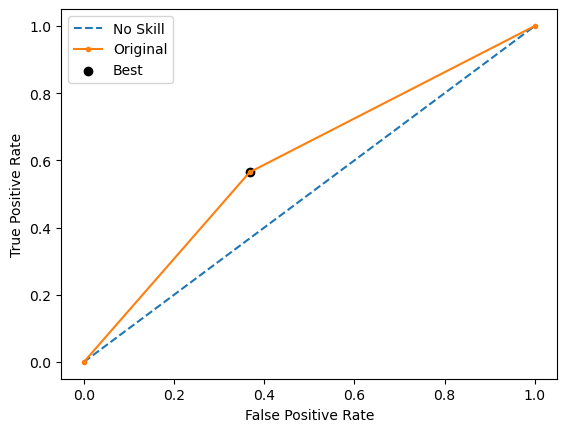

Run 2 - Random State: 1
Test G-mean: 0.5514956622112163
Best Threshold=0.880797, G-Mean=0.551


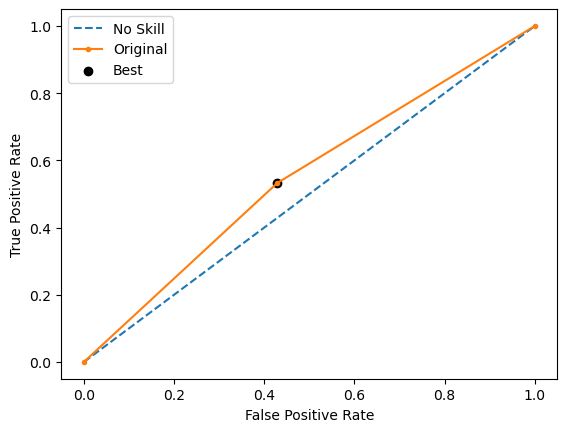

Run 3 - Random State: 2
Test G-mean: 0.5514956622112163
Best Threshold=0.880797, G-Mean=0.551


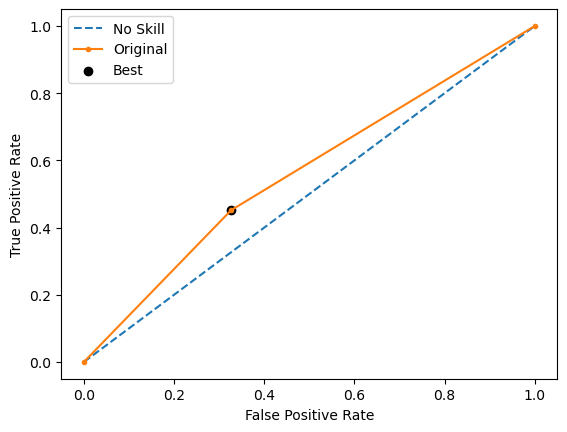

Run 4 - Random State: 3
Test G-mean: 0.6044600526368193
Best Threshold=0.880797, G-Mean=0.604


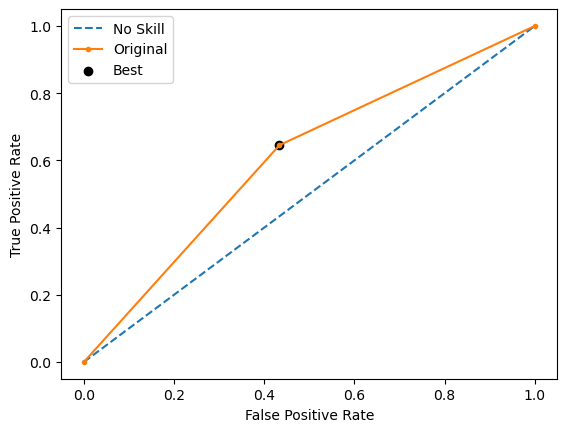

Run 5 - Random State: 4
Test G-mean: 0.5588329558532932
Best Threshold=0.880797, G-Mean=0.559


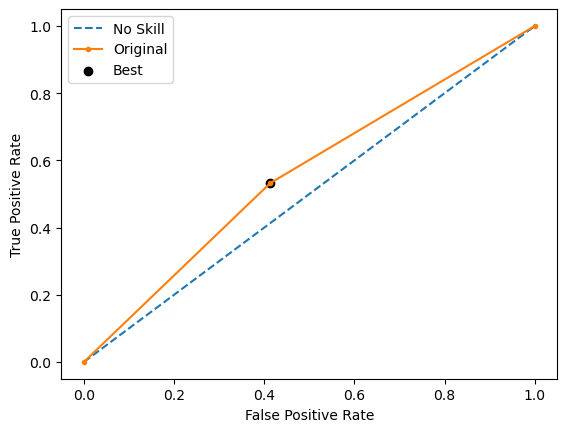

Ave Test G-mean: 0.5727797275159483
Stdev Test G-mean: 0.02608128895227308
Ave Test Specificity: 0.6061224489795919
Ave Test Recall: 0.5451612903225806
Ave Test NPV: 0.808779318856595
Ave Test Accuracy: 0.5914728682170542
Ave Test Precision: 0.30459511921741655
Ave Test F1-Score: 0.389872023499643
Ave Runtime: 0.17562179565429686


In [ ]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5768650062665048
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.6088025799686707
Std Train Score (G-mean) 0.022195997583714367
GridSearchCV Runtime: 317.2085425853729 secs
Run 1 - Random State: 0
Test G-mean: 0.6347413981520182
Best Threshold=0.487503, G-Mean=0.

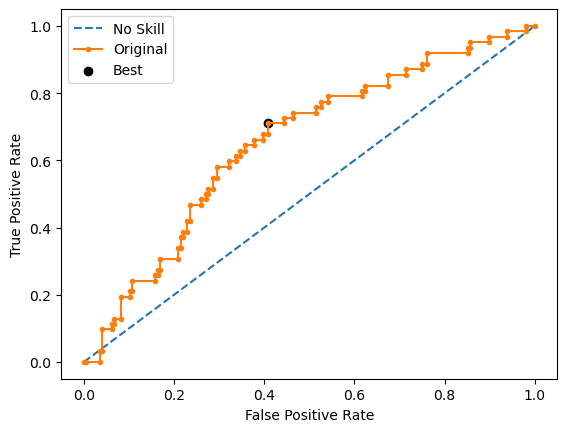

Run 2 - Random State: 1
Test G-mean: 0.6242836579493493
Best Threshold=0.502520, G-Mean=0.627


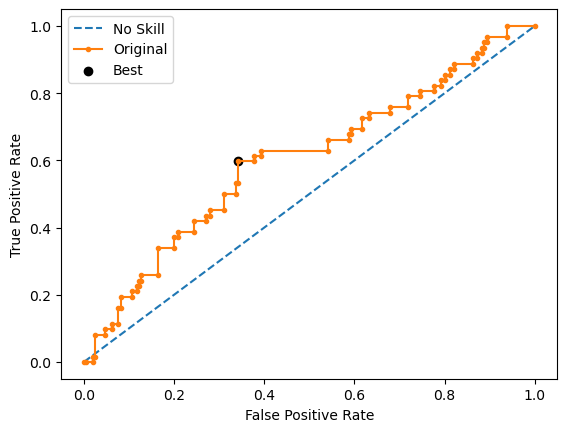

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.483924, G-Mean=0.589


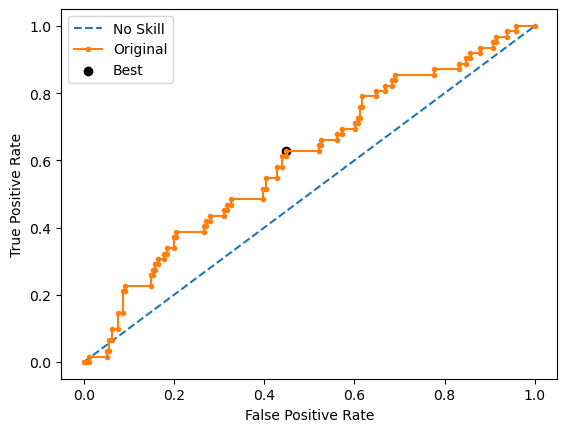

Run 4 - Random State: 3
Test G-mean: 0.591246215124694
Best Threshold=0.465005, G-Mean=0.621


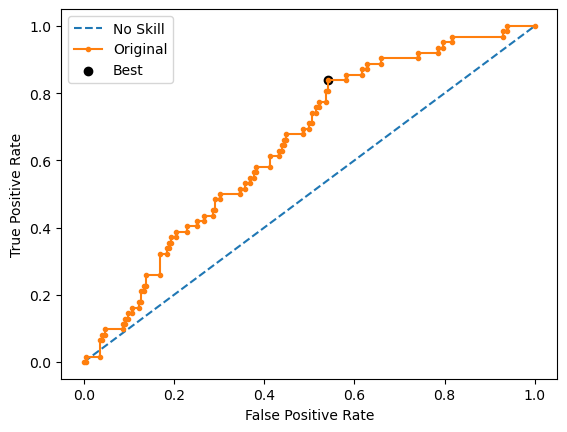

Run 5 - Random State: 4
Test G-mean: 0.6019362000578568
Best Threshold=0.509206, G-Mean=0.623


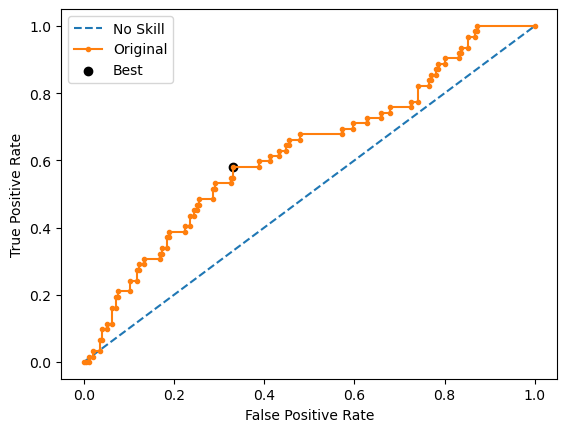

Ave Test G-mean: 0.6015434615493291
Stdev Test G-mean: 0.031002022889914615
Ave Test Specificity: 0.6387755102040816
Ave Test Recall: 0.567741935483871
Ave Test NPV: 0.8236238314622852
Ave Test Accuracy: 0.6217054263565892
Ave Test Precision: 0.33295230650884633
Ave Test F1-Score: 0.4192907178082785
Ave Runtime: 0.5586092948913575


In [ ]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits


Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5725397589609043
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8744686992050319
Std Train Score (G-mean) 0.011527105788742243
GridSearchCV Runtime: 147.76749396324158 secs
Run 1 - Random State: 0
Test G-mean: 0.5622828013112511
Best Threshold=0.555999, G-Mean=0.580


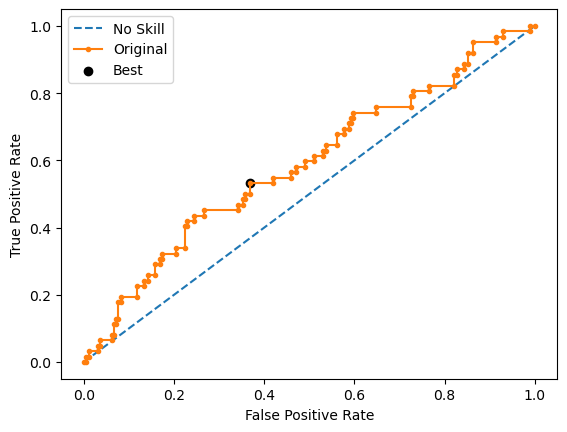

Run 2 - Random State: 1
Test G-mean: 0.5995389934010088
Best Threshold=0.521194, G-Mean=0.615


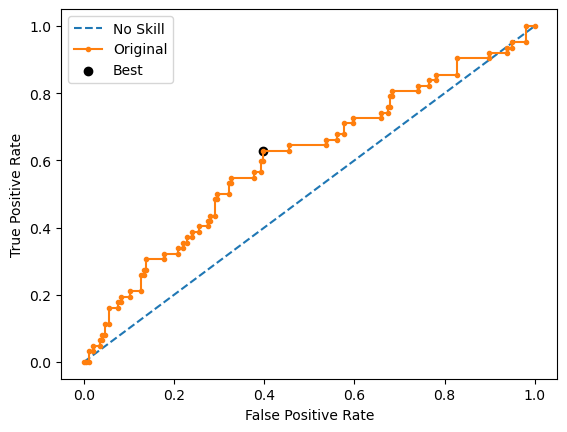

Run 3 - Random State: 2
Test G-mean: 0.484791750625621
Best Threshold=0.365845, G-Mean=0.529


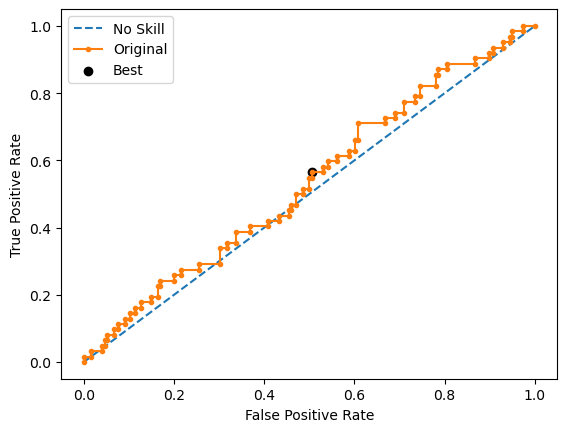

Run 4 - Random State: 3
Test G-mean: 0.5365201312326561
Best Threshold=0.446577, G-Mean=0.552


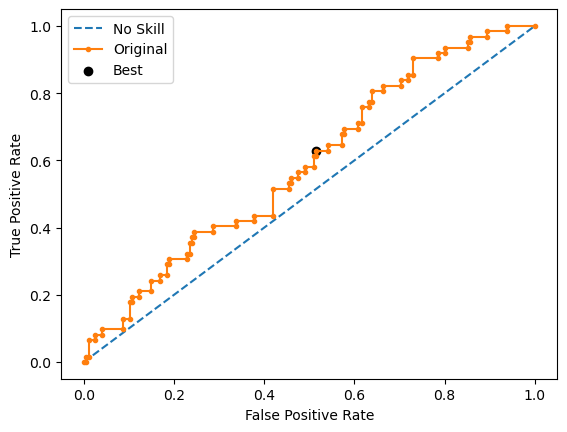

Run 5 - Random State: 4
Test G-mean: 0.568251536808238
Best Threshold=0.634908, G-Mean=0.584


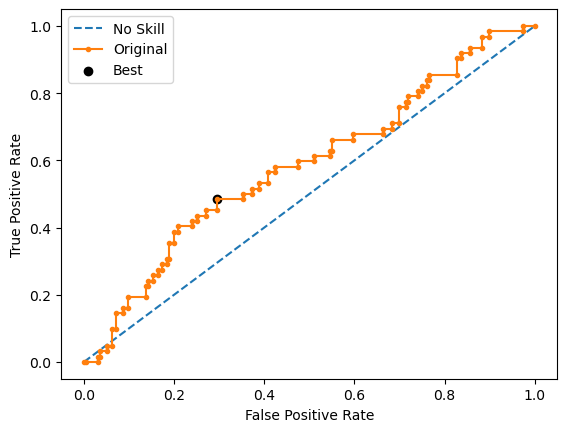

Ave Test G-mean: 0.550277042675755
Stdev Test G-mean: 0.042928826434967905
Ave Test Specificity: 0.5877551020408164
Ave Test Recall: 0.5258064516129031
Ave Test NPV: 0.7984004487718876
Ave Test Accuracy: 0.5728682170542636
Ave Test Precision: 0.28558126606907097
Ave Test F1-Score: 0.36823242588605715
Ave Runtime: 0.5479151725769043


In [ ]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6918734	total: 2.3ms	remaining: 2.3s
1:	learn: 0.6904773	total: 4.13ms	remaining: 2.06s
2:	learn: 0.6892748	total: 5.96ms	remaining: 1.98s
3:	learn: 0.6883518	total: 7.86ms	remaining: 1.96s
4:	learn: 0.6874894	total: 9.77ms	remaining: 1.95s
5:	learn: 0.6864793	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6849713	total: 13.7ms	remaining: 1.94s
7:	learn: 0.6835259	total: 15.4ms	remaining: 1.91s
8:	learn: 0.6820508	total: 17.3ms	remaining: 1.9s
9:	learn: 0.6808529	total: 19.3ms	remaining: 1.91s
10:	learn: 0.6794658	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6782565	total: 23.1ms	remaining: 1.9s
12:	learn: 0.6770542	total: 24.9ms	remaining: 1.89s
13:	learn: 0.6758270	total: 26.4ms	remaining: 1.86s
14:	learn: 0.6747007	total: 28.6ms	remaining: 1.88s
15:	learn: 0.6735646	total: 30.5ms	remaining: 1.88s
16:	learn: 0.6724274	total: 32.3ms	remaining: 1.87s
17:	learn: 0.6714028	total: 34.2ms	rema

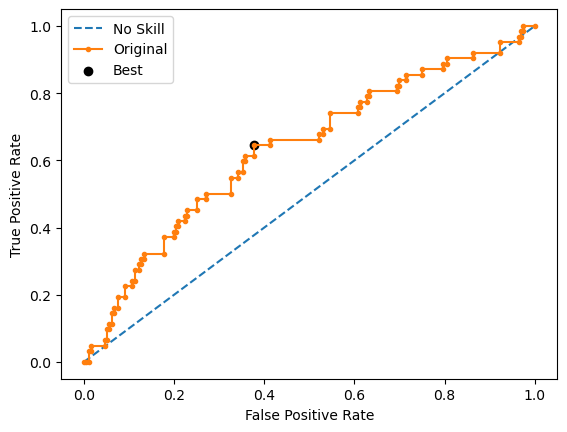

Learning rate set to 0.006754
0:	learn: 0.6909056	total: 2.25ms	remaining: 2.25s
1:	learn: 0.6892966	total: 4.33ms	remaining: 2.16s
2:	learn: 0.6879854	total: 7.01ms	remaining: 2.33s
3:	learn: 0.6869652	total: 8.63ms	remaining: 2.15s
4:	learn: 0.6857235	total: 10.7ms	remaining: 2.14s
5:	learn: 0.6845124	total: 12.5ms	remaining: 2.07s
6:	learn: 0.6829168	total: 14.4ms	remaining: 2.05s
7:	learn: 0.6809996	total: 16.4ms	remaining: 2.03s
8:	learn: 0.6789838	total: 18ms	remaining: 1.98s
9:	learn: 0.6771489	total: 19.6ms	remaining: 1.94s
10:	learn: 0.6755326	total: 21.5ms	remaining: 1.93s
11:	learn: 0.6742410	total: 23.3ms	remaining: 1.92s
12:	learn: 0.6725502	total: 25.3ms	remaining: 1.92s
13:	learn: 0.6705914	total: 27.2ms	remaining: 1.92s
14:	learn: 0.6692993	total: 29.1ms	remaining: 1.91s
15:	learn: 0.6680835	total: 31ms	remaining: 1.91s
16:	learn: 0.6669018	total: 32.8ms	remaining: 1.9s
17:	learn: 0.6658209	total: 34.6ms	remaining: 1.89s
18:	learn: 0.6646626	total: 36.5ms	remaining: 1.8

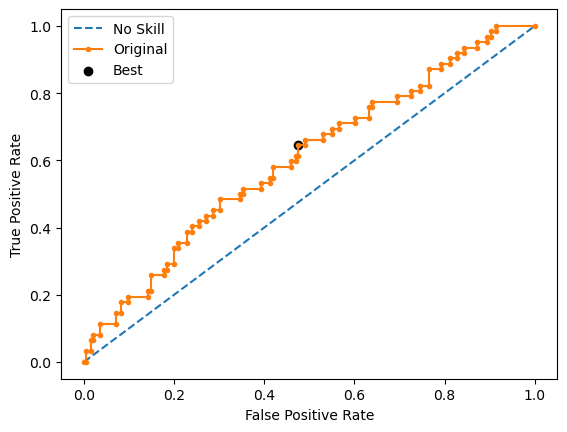

Learning rate set to 0.006754
0:	learn: 0.6912841	total: 2.86ms	remaining: 2.85s
1:	learn: 0.6900261	total: 5.43ms	remaining: 2.71s
2:	learn: 0.6889845	total: 7.32ms	remaining: 2.43s
3:	learn: 0.6882180	total: 9.1ms	remaining: 2.27s
4:	learn: 0.6870207	total: 11ms	remaining: 2.2s
5:	learn: 0.6858179	total: 12.7ms	remaining: 2.11s
6:	learn: 0.6851150	total: 14.5ms	remaining: 2.06s
7:	learn: 0.6832779	total: 16.6ms	remaining: 2.05s
8:	learn: 0.6823443	total: 18.6ms	remaining: 2.04s
9:	learn: 0.6812690	total: 20.5ms	remaining: 2.03s
10:	learn: 0.6800280	total: 22.4ms	remaining: 2.02s
11:	learn: 0.6792044	total: 24.3ms	remaining: 2s
12:	learn: 0.6783522	total: 26.1ms	remaining: 1.98s
13:	learn: 0.6772651	total: 27.8ms	remaining: 1.96s
14:	learn: 0.6763484	total: 29.5ms	remaining: 1.93s
15:	learn: 0.6753359	total: 31.4ms	remaining: 1.93s
16:	learn: 0.6745798	total: 33.3ms	remaining: 1.92s
17:	learn: 0.6740406	total: 35ms	remaining: 1.91s
18:	learn: 0.6730462	total: 36.8ms	remaining: 1.9s
19

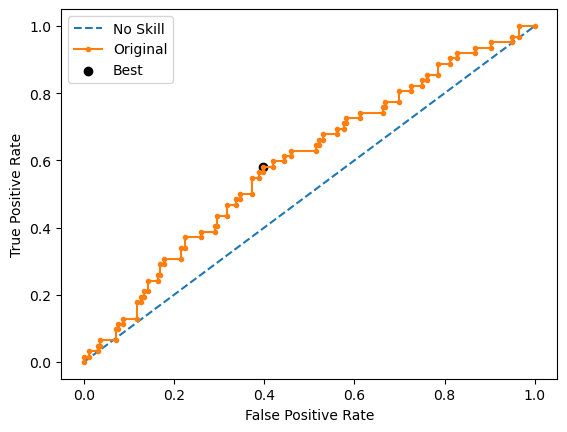

Learning rate set to 0.006754
0:	learn: 0.6916853	total: 1.8ms	remaining: 1.8s
1:	learn: 0.6903289	total: 3.79ms	remaining: 1.89s
2:	learn: 0.6890073	total: 5.58ms	remaining: 1.85s
3:	learn: 0.6876582	total: 7.43ms	remaining: 1.85s
4:	learn: 0.6870475	total: 9.27ms	remaining: 1.84s
5:	learn: 0.6853816	total: 11ms	remaining: 1.82s
6:	learn: 0.6842847	total: 13ms	remaining: 1.85s
7:	learn: 0.6824566	total: 14.8ms	remaining: 1.84s
8:	learn: 0.6813194	total: 16.5ms	remaining: 1.82s
9:	learn: 0.6800294	total: 18.5ms	remaining: 1.83s
10:	learn: 0.6789221	total: 20.3ms	remaining: 1.82s
11:	learn: 0.6774388	total: 22ms	remaining: 1.81s
12:	learn: 0.6757157	total: 24.1ms	remaining: 1.83s
13:	learn: 0.6746996	total: 26.2ms	remaining: 1.84s
14:	learn: 0.6730859	total: 27.9ms	remaining: 1.83s
15:	learn: 0.6718456	total: 29.7ms	remaining: 1.83s
16:	learn: 0.6709146	total: 31.4ms	remaining: 1.81s
17:	learn: 0.6697991	total: 33.2ms	remaining: 1.81s
18:	learn: 0.6687022	total: 35.2ms	remaining: 1.81s


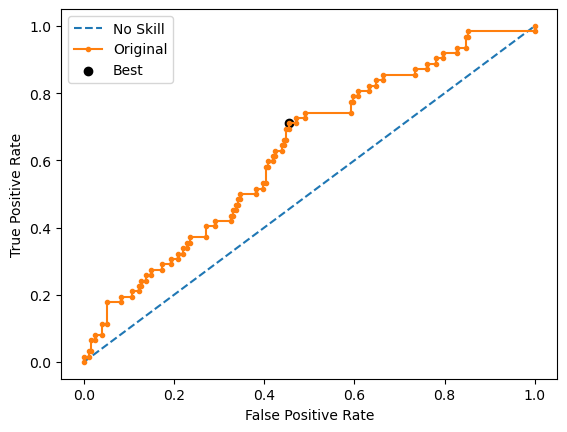

Learning rate set to 0.006754
0:	learn: 0.6921356	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6914337	total: 3.79ms	remaining: 1.89s
2:	learn: 0.6905395	total: 5.47ms	remaining: 1.82s
3:	learn: 0.6893376	total: 7.31ms	remaining: 1.82s
4:	learn: 0.6886264	total: 9.25ms	remaining: 1.84s
5:	learn: 0.6873547	total: 11.1ms	remaining: 1.84s
6:	learn: 0.6865741	total: 12.9ms	remaining: 1.83s
7:	learn: 0.6851301	total: 14.7ms	remaining: 1.83s
8:	learn: 0.6836135	total: 16.5ms	remaining: 1.82s
9:	learn: 0.6819828	total: 18.5ms	remaining: 1.83s
10:	learn: 0.6807787	total: 20.4ms	remaining: 1.84s
11:	learn: 0.6794977	total: 22.2ms	remaining: 1.83s
12:	learn: 0.6787670	total: 23.9ms	remaining: 1.81s
13:	learn: 0.6780396	total: 25.7ms	remaining: 1.81s
14:	learn: 0.6766027	total: 27.5ms	remaining: 1.8s
15:	learn: 0.6753885	total: 29.3ms	remaining: 1.8s
16:	learn: 0.6744288	total: 31ms	remaining: 1.79s
17:	learn: 0.6732602	total: 32.6ms	remaining: 1.78s
18:	learn: 0.6727781	total: 34.2ms	remaining: 1.

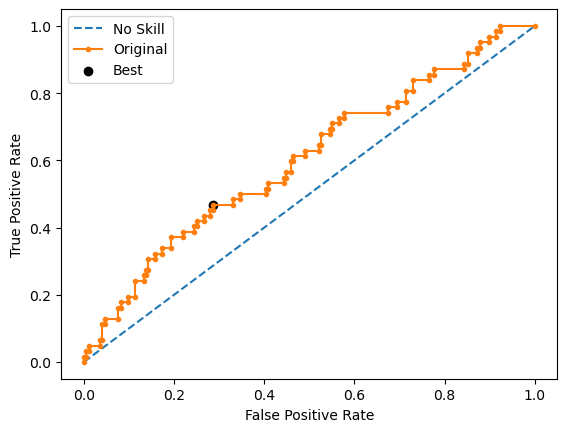

Ave Test G-mean: 0.5776264133640215
Stdev Test G-mean: 0.021888247073740607
Ave Test Specificity: 0.6081632653061224
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8109767151117362
Ave Test Accuracy: 0.5945736434108527
Ave Test Precision: 0.3092322828980502
Ave Test F1-Score: 0.3953285558011297
Ave Runtime: 1.9695753574371337


In [ ]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, 'precision',
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost', 'catboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost', 'CatBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall', 'Average Test Precision', 'Average Test F1-score',
    'Average Test Accuracy'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall,Average Test Precision,Average Test F1-score,Average Test Accuracy
3,Decision Tree,0.611687,0.041561,0.586133,NaN,0.590816,0.635484,0.332645,0.435697,0.601550
4,Random Forest,0.601543,0.031002,0.576865,0.608803,0.638776,0.567742,0.332952,0.419291,0.621705
7,Extreme Gradient Boosting (XGBoost),0.598752,0.037482,0.569527,0.849971,0.642857,0.561290,0.332001,0.416351,0.623256
9,CatBoost,0.577626,0.021888,0.560594,0.948444,0.608163,0.551613,0.309232,0.395329,0.594574
6,LightGBM,0.574730,0.040840,0.589313,0.735724,0.596939,0.554839,0.303431,0.392101,0.586822
8,AdaBoost,0.572780,0.026081,0.569458,0.948381,0.606122,0.545161,0.304595,0.389872,0.591473
5,Gradient Boosting Machine (GBM),0.550277,0.042929,0.572540,0.874469,0.587755,0.525806,0.285581,0.368232,0.572868
2,Logistic Regression,0.539955,0.044973,0.540726,NaN,0.630612,0.464516,0.283812,0.352206,0.590698
1,SVM Classifier,0.524960,0.026284,0.538587,0.287537,0.508163,0.551613,0.260143,0.352584,0.518605
0,k-Nearest Neighbors,0.488140,0.057204,0.555174,0.688249,0.656122,0.367742,0.251044,0.297900,0.586822


In [ ]:
best_scores_models = {
    'Best Score': [],
    'Best Model': []
}

indices = [
    'Highest Test Accuracy',
    'Highest Test G-mean',
    'Highest Test Recall',
    'Highest Test Precision',
    'Highest Test Specificity',
    'Highest Test F1-score'
]

# Corresponding column names in your original dataframe
columns = [
    'Average Test Accuracy',
    'Average Test G-mean',
    'Average Test Recall',
    'Average Test Precision',
    'Average Test Specificity',
    'Average Test F1-score'
]

df = ho_t06_summ
# Finding the best model for each metric
for col in columns:
    best_score = df[col].max()
    best_model = df.loc[df[col] == best_score, 'Classifier model'].values[0]
    
    best_scores_models['Best Score'].append(best_score)
    best_scores_models['Best Model'].append(best_model)

# Creating the new dataframe
best_df = pd.DataFrame(best_scores_models, index=indices)

# Displaying the new dataframe
best_df

,Best Score,Best Model
Highest Test Accuracy,0.623256,Extreme Gradient Boosting (XGBoost)
Highest Test G-mean,0.611687,Decision Tree
Highest Test Recall,0.635484,Decision Tree
Highest Test Precision,0.332952,Random Forest
Highest Test Specificity,0.656122,k-Nearest Neighbors
Highest Test F1-score,0.435697,Decision Tree


# HO-T06 Runs: StandardScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


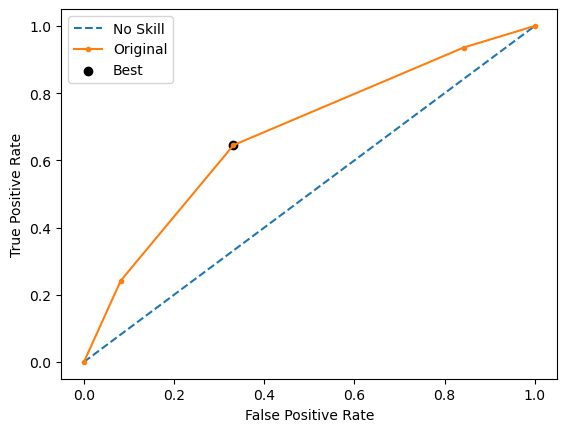

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


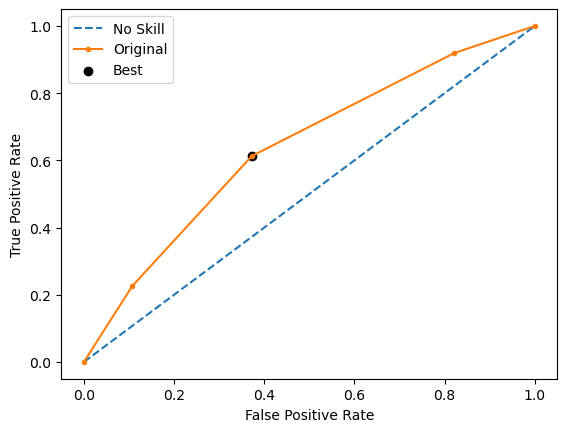

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


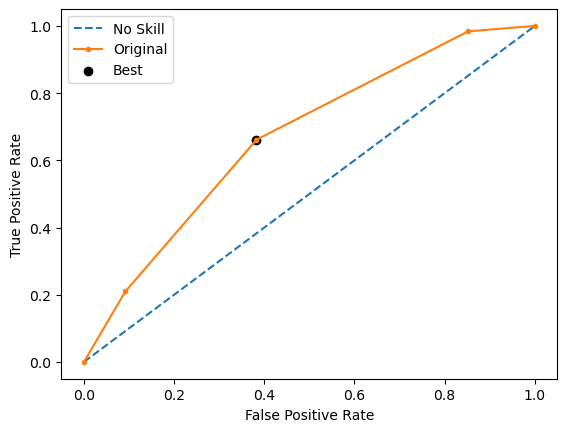

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


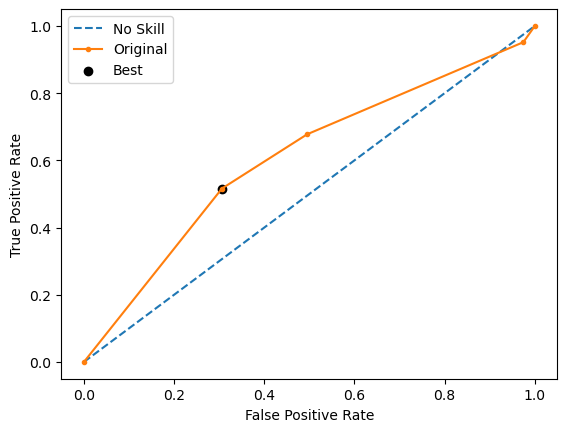

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


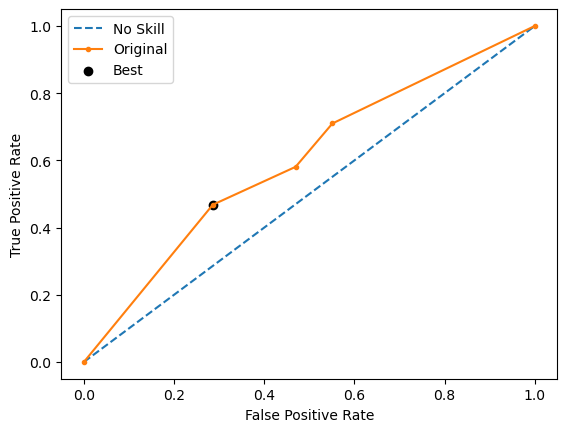

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

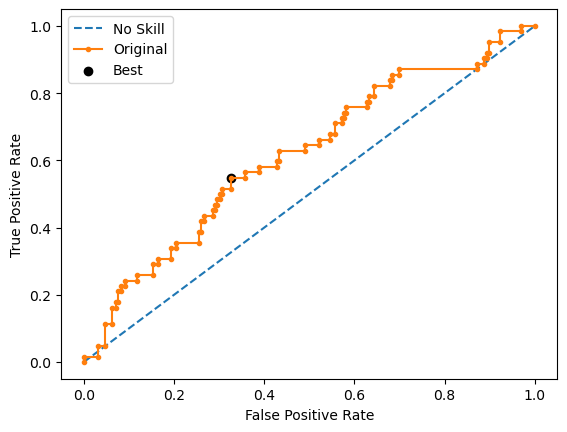

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


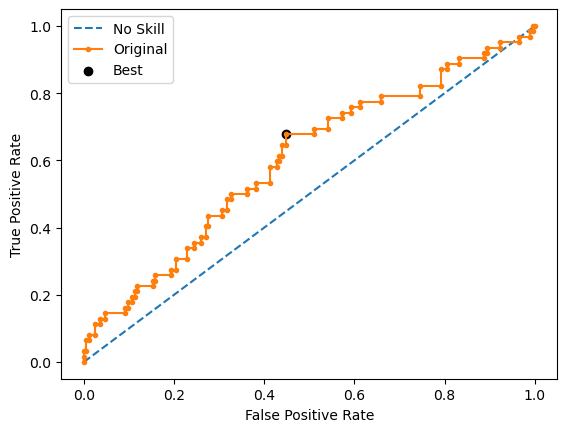

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


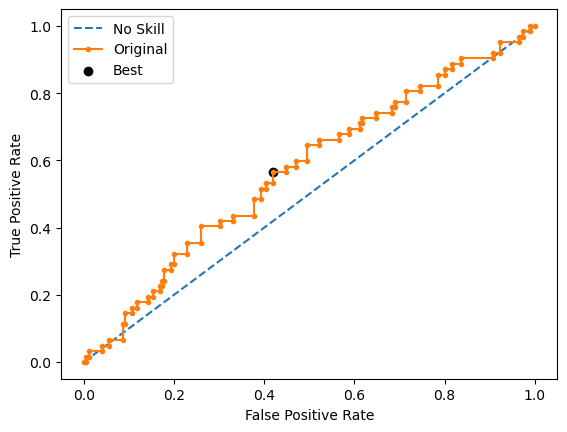

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


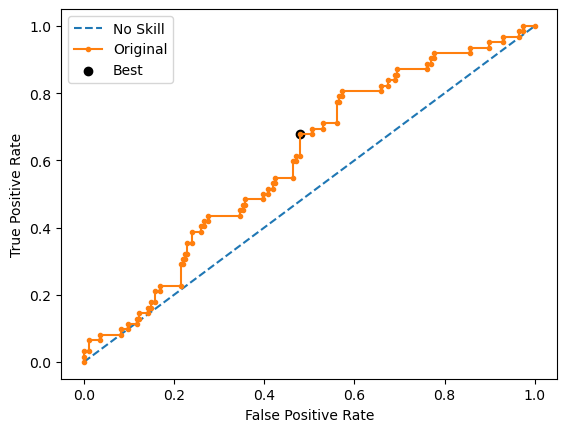

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


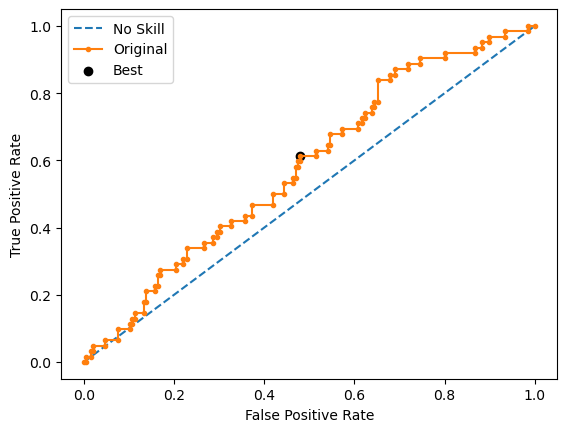

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


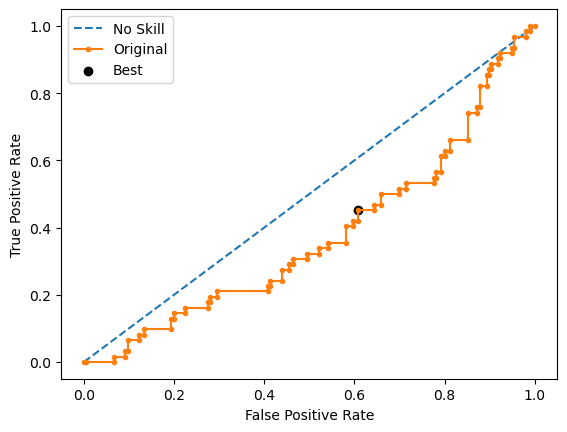

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


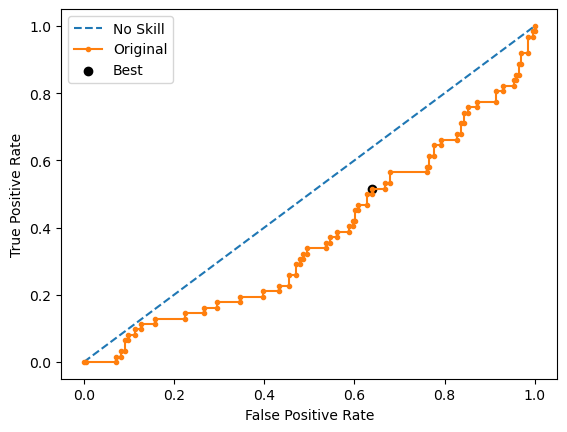

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


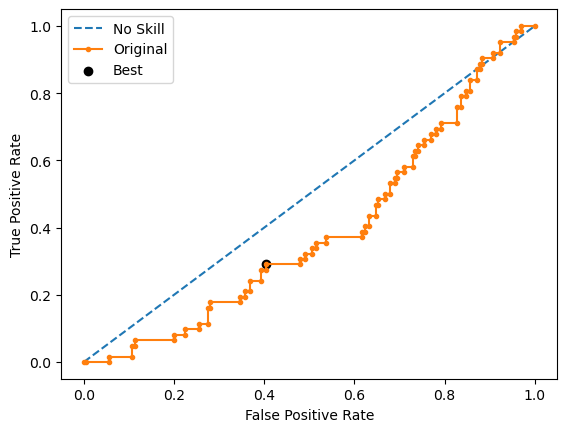

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


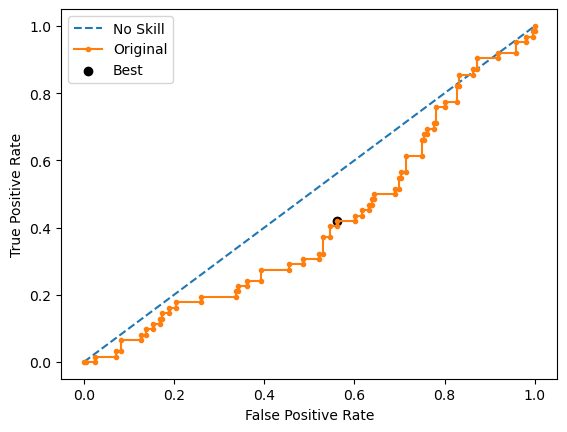

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


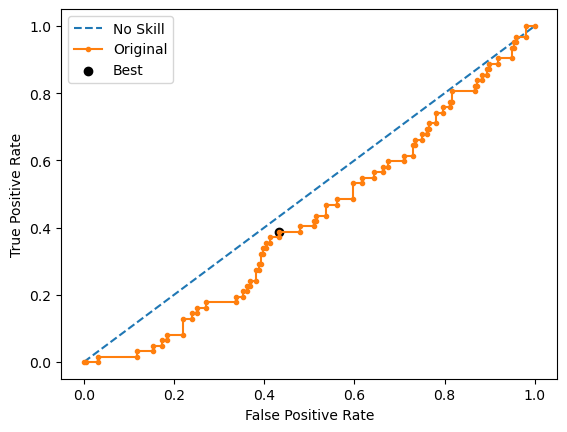

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5695273785971662
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_

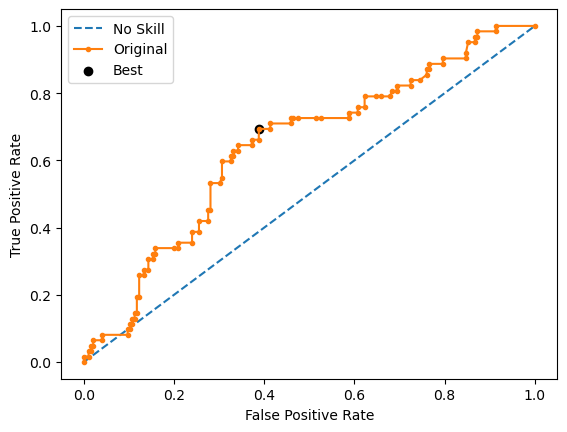

Run 2 - Random State: 1
Test G-mean: 0.6326636793264705
Best Threshold=0.493293, G-Mean=0.636


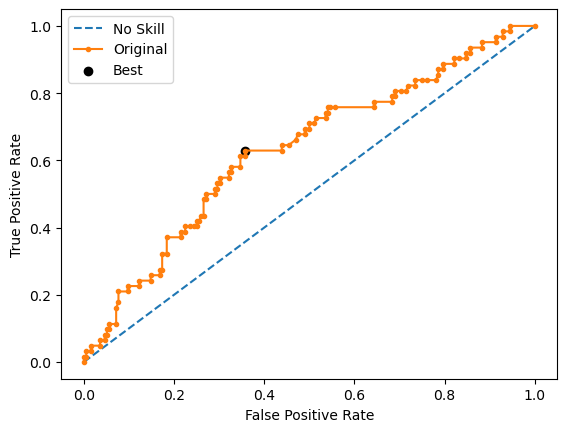

Run 3 - Random State: 2
Test G-mean: 0.5476774830239554
Best Threshold=0.458993, G-Mean=0.564


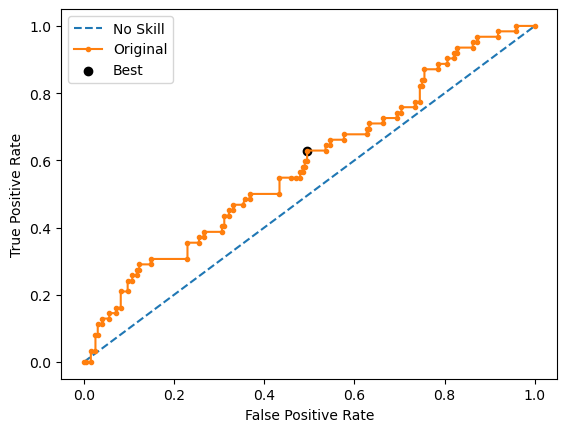

Run 4 - Random State: 3
Test G-mean: 0.6048683337050778
Best Threshold=0.481042, G-Mean=0.614


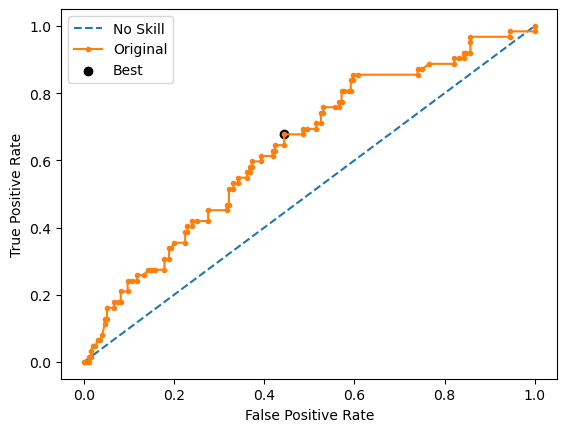

Run 5 - Random State: 4
Test G-mean: 0.5745880397335743
Best Threshold=0.543877, G-Mean=0.611


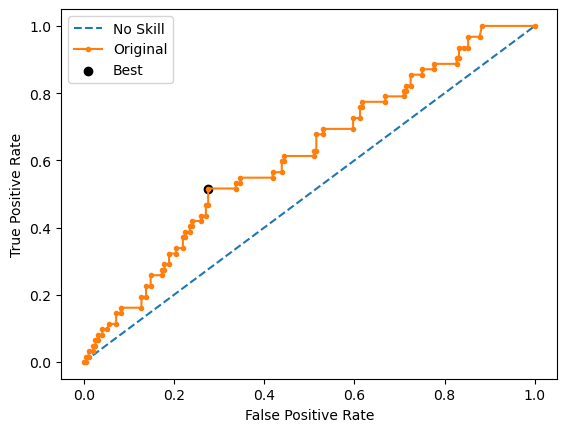

Ave Test G-mean: 0.5987521174719939
Stdev Test G-mean: 0.03748243903978868
Ave Test Specificity: 0.6428571428571429
Ave Test Recall: 0.5612903225806452
Ave Test NPV: 0.8229987307103309
Ave Test Accuracy: 0.6232558139534884
Ave Test Precision: 0.3320006269754075
Ave Test F1-Score: 0.4163508571460087
Ave Runtime: 0.19665169715881348


In [224]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'goss', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 3, 'classifier__n_estimators': 300, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.577998778688951
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='goss', learning_rate=0.01,
                                max_depth=3, n_estimators=300,
                                random_state=0))])
Mean Train Score (G-mean) 0.7598671718538652
Std Train Score (G-mean) 0.016532797612759057
GridSearchCV Runtime: 35.78956937789917 secs
Run 1 - Random State: 0
Test G-mean: 0.6109598099719176
Best Threshold=0.489740, G-Mean=0.626


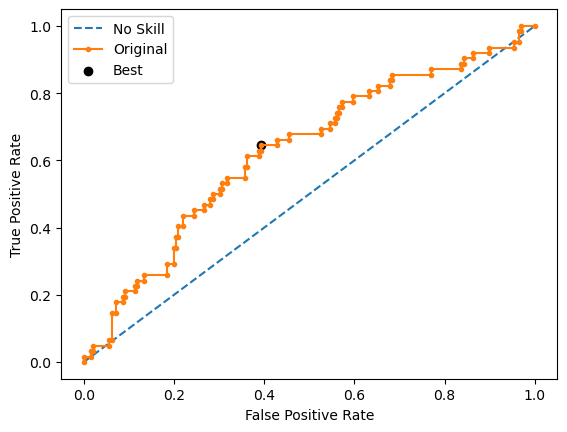

Run 2 - Random State: 1
Test G-mean: 0.6036426620632479
Best Threshold=0.542979, G-Mean=0.621


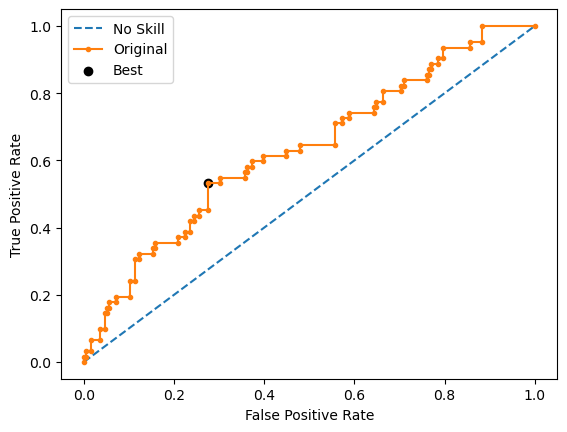

Run 3 - Random State: 2
Test G-mean: 0.6085305366932837
Best Threshold=0.503764, G-Mean=0.618


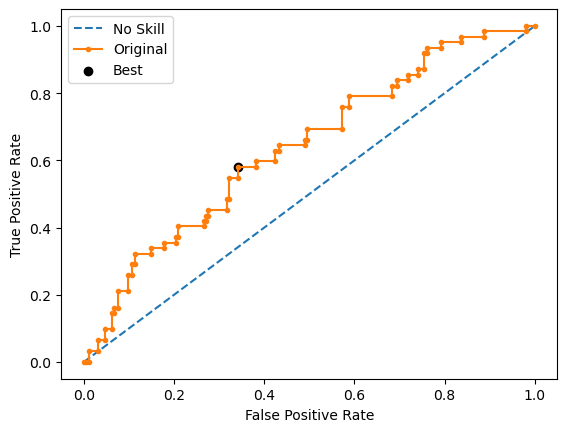

Run 4 - Random State: 3
Test G-mean: 0.5730104831718916
Best Threshold=0.472611, G-Mean=0.591


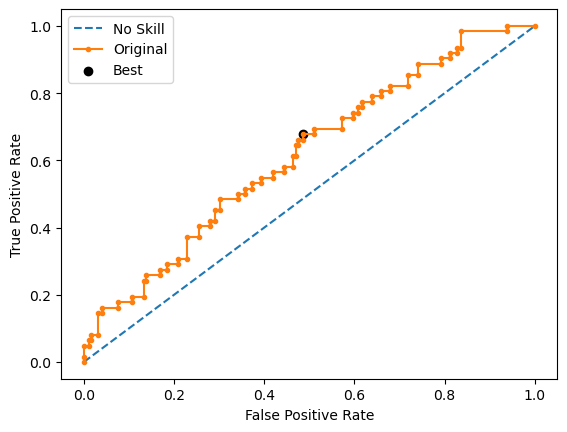

Run 5 - Random State: 4
Test G-mean: 0.5572846327942754
Best Threshold=0.554358, G-Mean=0.588


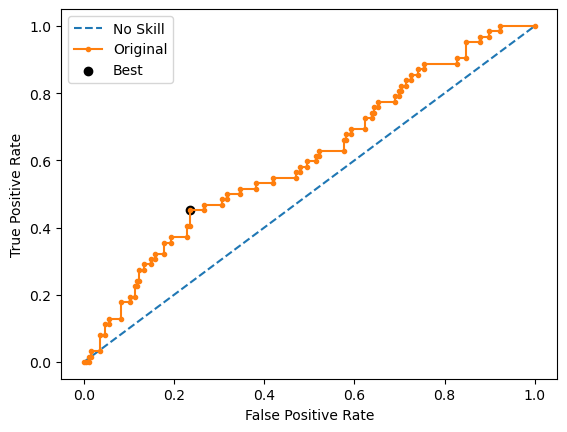

Ave Test G-mean: 0.5906856249389232
Stdev Test G-mean: 0.02411122756127123
Ave Test Specificity: 0.6112244897959184
Ave Test Recall: 0.5709677419354839
Ave Test NPV: 0.8178674166078368
Ave Test Accuracy: 0.6015503875968993
Ave Test Precision: 0.3182412107715316
Ave Test F1-Score: 0.40848232467154577
Ave Runtime: 0.3433506011962891


In [225]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5708017601192481
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9476864629106763
Std Train Score (G-mean) 0.0038326194544914087
GridSearchCV Runtime: 10.719450235366821 secs
Run 1 - Random State: 0
Test G-mean: 0.5937462102716796
Best Threshold=0.731059, G-Mean=0.594


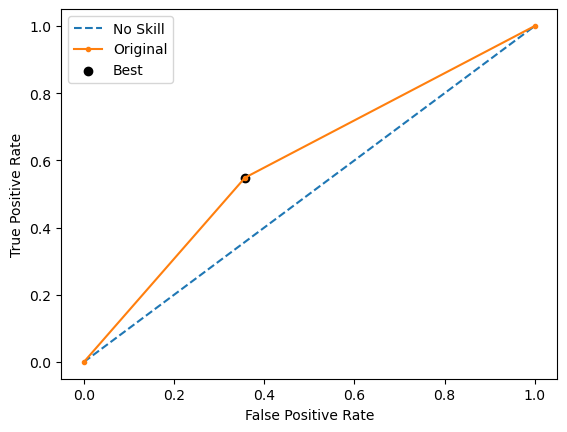

Run 2 - Random State: 1
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


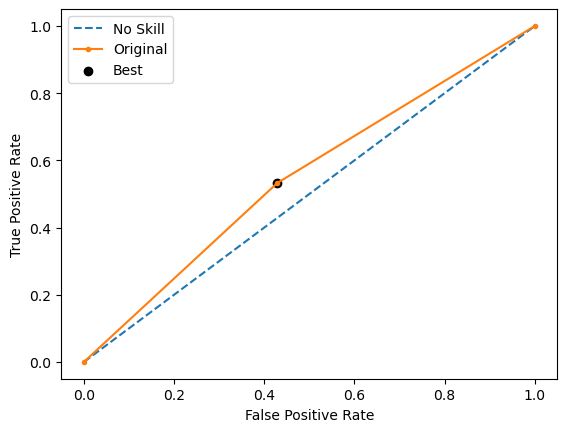

Run 3 - Random State: 2
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


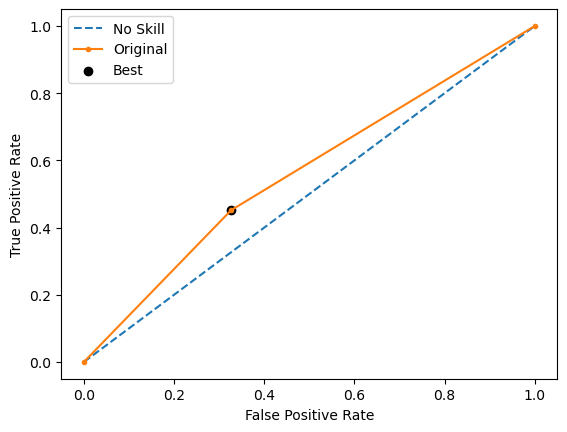

Run 4 - Random State: 3
Test G-mean: 0.6017310994101656
Best Threshold=0.731059, G-Mean=0.602


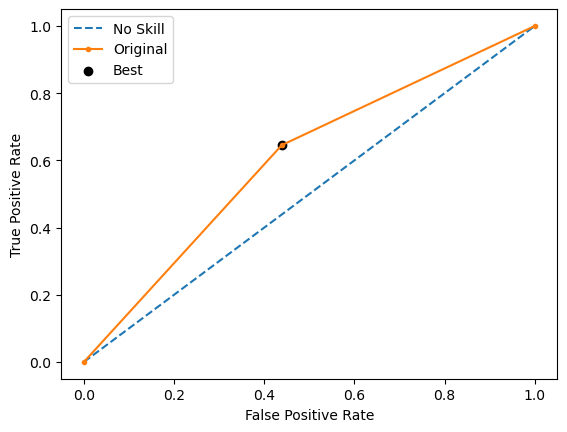

Run 5 - Random State: 4
Test G-mean: 0.5514956622112163
Best Threshold=0.731059, G-Mean=0.551


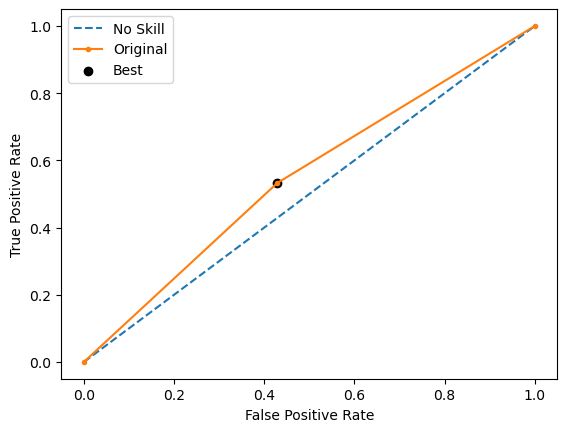

Ave Test G-mean: 0.5699928592630987
Stdev Test G-mean: 0.025485174455446857
Ave Test Specificity: 0.6040816326530611
Ave Test Recall: 0.5419354838709677
Ave Test NPV: 0.8070696713352443
Ave Test Accuracy: 0.5891472868217054
Ave Test Precision: 0.302566756914583
Ave Test F1-Score: 0.38724740006892266
Ave Runtime: 0.2264254570007324


In [226]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5680904738623496
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 GradientBoostingClassifier(min_samples_leaf=2,
                                            n_estimators=200,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8771095131586388
Std Train Score (G-mean) 0.010527366294144738
GridSearchCV Runtime: 88.82423067092896 secs
Run 1 - Random State: 0
Test G-mean: 0.5597892954492245
Best Threshold=0.555999, G-Mean=0.580


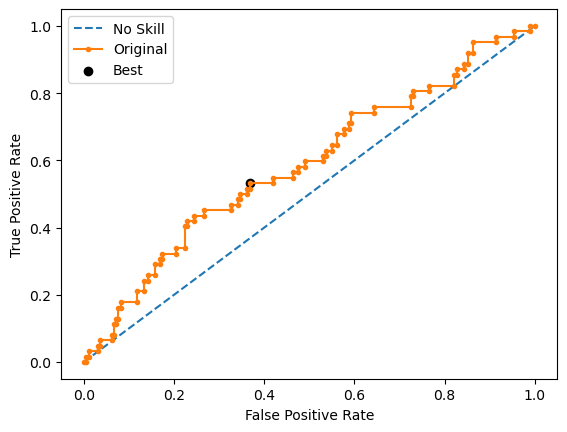

Run 2 - Random State: 1
Test G-mean: 0.5968564788564029
Best Threshold=0.521194, G-Mean=0.613


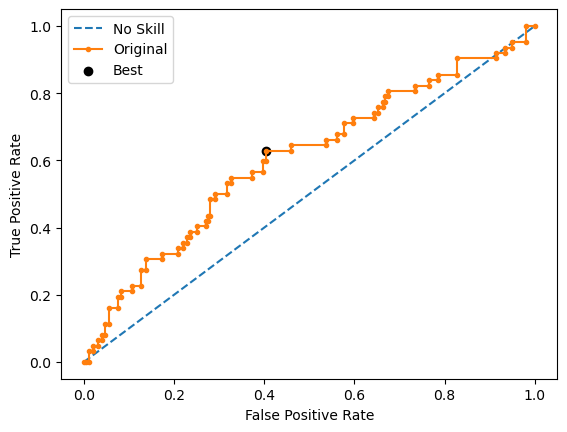

Run 3 - Random State: 2
Test G-mean: 0.48300613958372834
Best Threshold=0.295774, G-Mean=0.528


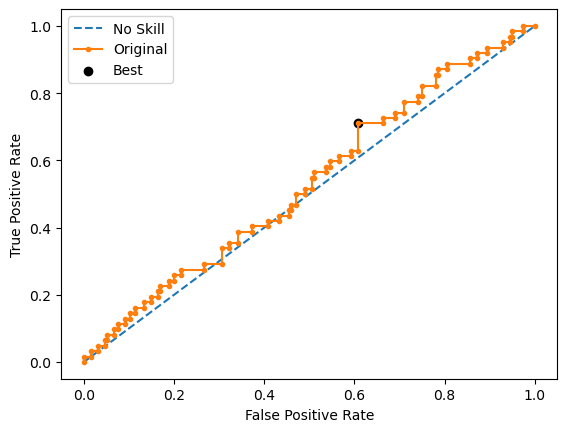

Run 4 - Random State: 3
Test G-mean: 0.5365201312326561
Best Threshold=0.446577, G-Mean=0.552


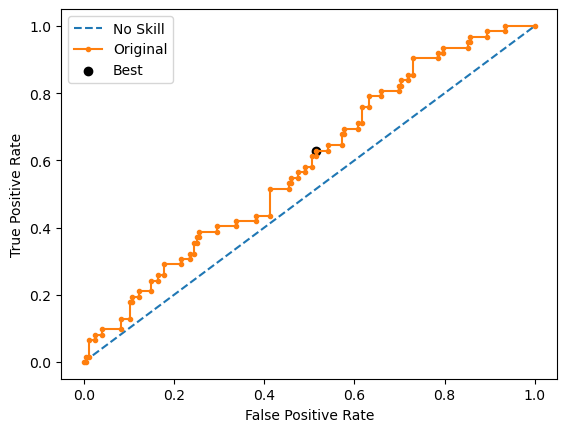

Run 5 - Random State: 4
Test G-mean: 0.568251536808238
Best Threshold=0.634908, G-Mean=0.582


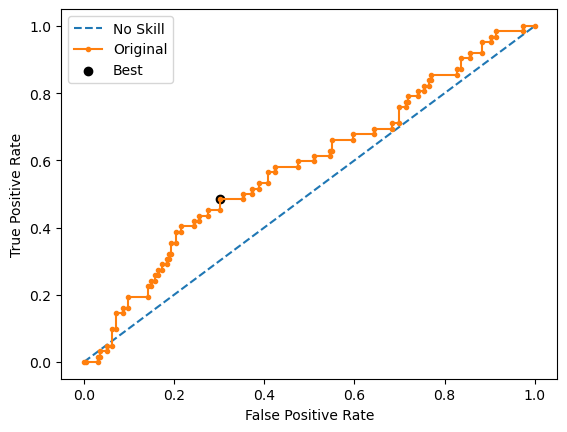

Ave Test G-mean: 0.54888471638605
Stdev Test G-mean: 0.04268531193466081
Ave Test Specificity: 0.5846938775510204
Ave Test Recall: 0.5258064516129031
Ave Test NPV: 0.7975992512186542
Ave Test Accuracy: 0.5705426356589147
Ave Test Precision: 0.2839449785968609
Ave Test F1-Score: 0.36694904582001353
Ave Runtime: 0.39573121070861816


In [228]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5767544617781283
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(criterion='entropy', max_depth=3,
                                        min_samples_leaf=3, n_estimators=300,
                                        oob_score=True, random_state=0))])
Mean Train Score (G-mean) 0.619682586626071
Std Train Score (G-mean) 0.02081374722807044
GridSearchCV Runtime: 357.49217915534973 secs
Run 1 - Random State: 0
Test G-mean: 0.6347413981520182
Best 

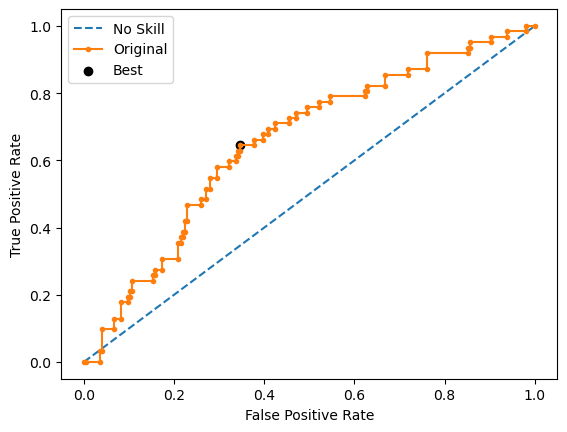

Run 2 - Random State: 1
Test G-mean: 0.6242836579493493
Best Threshold=0.500755, G-Mean=0.624


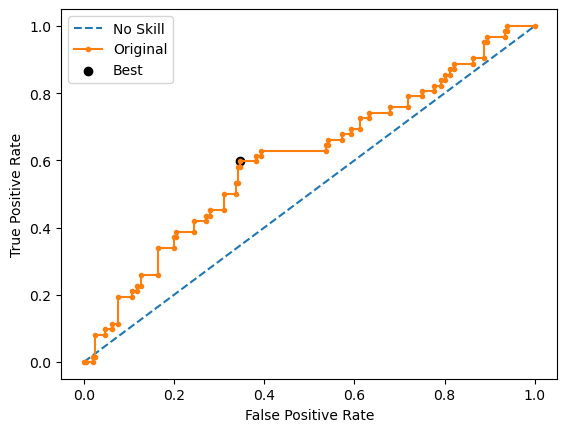

Run 3 - Random State: 2
Test G-mean: 0.5555098364627279
Best Threshold=0.483924, G-Mean=0.589


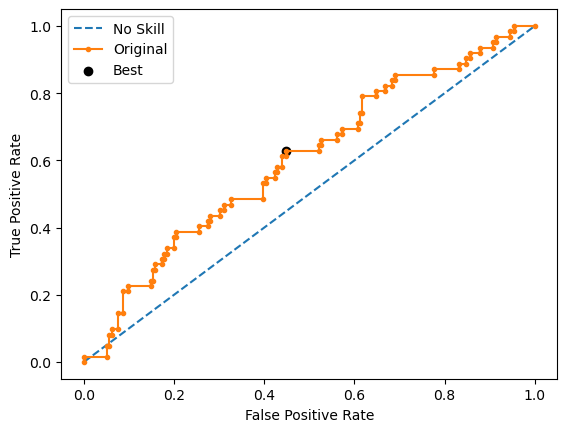

Run 4 - Random State: 3
Test G-mean: 0.591246215124694
Best Threshold=0.465005, G-Mean=0.621


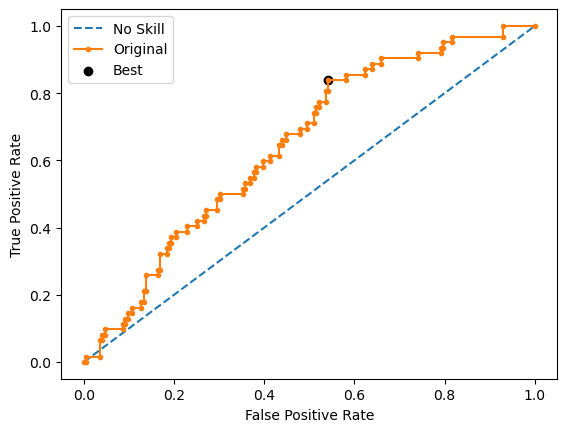

Run 5 - Random State: 4
Test G-mean: 0.6019362000578568
Best Threshold=0.509206, G-Mean=0.623


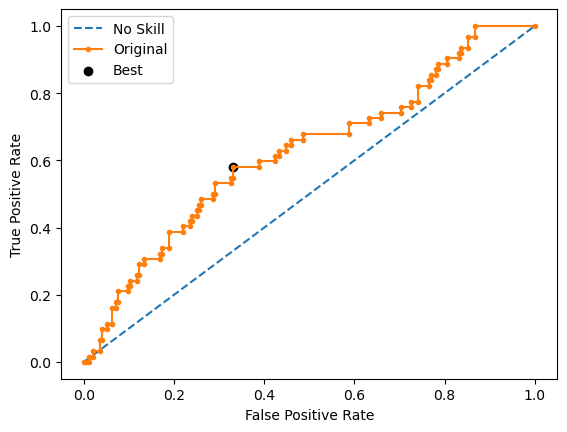

Ave Test G-mean: 0.6015434615493291
Stdev Test G-mean: 0.031002022889914615
Ave Test Specificity: 0.6387755102040816
Ave Test Recall: 0.567741935483871
Ave Test NPV: 0.8236238314622852
Ave Test Accuracy: 0.6217054263565892
Ave Test Precision: 0.33295230650884633
Ave Test F1-Score: 0.4192907178082785
Ave Runtime: 0.5530432224273681


In [227]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006754
0:	learn: 0.6918734	total: 2.08ms	remaining: 2.08s
1:	learn: 0.6904773	total: 4.3ms	remaining: 2.15s
2:	learn: 0.6892748	total: 6.39ms	remaining: 2.13s
3:	learn: 0.6883518	total: 9.02ms	remaining: 2.25s
4:	learn: 0.6874894	total: 11.3ms	remaining: 2.25s
5:	learn: 0.6864793	total: 13.7ms	remaining: 2.26s
6:	learn: 0.6849713	total: 15.7ms	remaining: 2.23s
7:	learn: 0.6835259	total: 17.8ms	remaining: 2.2s
8:	learn: 0.6820508	total: 19.8ms	remaining: 2.19s
9:	learn: 0.6808529	total: 21.9ms	remaining: 2.17s
10:	learn: 0.6794658	total: 23.9ms	remaining: 2.15s
11:	learn: 0.6782565	total: 26.2ms	remaining: 2.15s
12:	learn: 0.6770542	total: 28.4ms	remaining: 2.15s
13:	learn: 0.6758270	total: 30.5ms	remaining: 2.15s
14:	learn: 0.6747007	total: 32.6ms	remaining: 2.14s
15:	learn: 0.6735646	total: 34.5ms	remaining: 2.12s
16:	learn: 0.6724274	total: 36.5ms	remaining: 2.11s
17:	learn: 0.6714028	total: 38.5ms	re

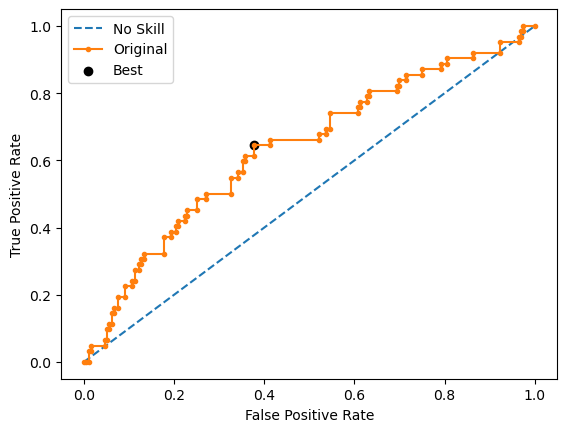

Learning rate set to 0.006754
0:	learn: 0.6909056	total: 4.65ms	remaining: 4.64s
1:	learn: 0.6892966	total: 6.37ms	remaining: 3.18s
2:	learn: 0.6879854	total: 8.06ms	remaining: 2.68s
3:	learn: 0.6869652	total: 10ms	remaining: 2.49s
4:	learn: 0.6857235	total: 12.1ms	remaining: 2.4s
5:	learn: 0.6845124	total: 13.8ms	remaining: 2.29s
6:	learn: 0.6829168	total: 15.5ms	remaining: 2.21s
7:	learn: 0.6809996	total: 17.3ms	remaining: 2.15s
8:	learn: 0.6789838	total: 19.2ms	remaining: 2.12s
9:	learn: 0.6771489	total: 20.9ms	remaining: 2.07s
10:	learn: 0.6755326	total: 22.7ms	remaining: 2.04s
11:	learn: 0.6742410	total: 24.4ms	remaining: 2.01s
12:	learn: 0.6725502	total: 26.4ms	remaining: 2.01s
13:	learn: 0.6705914	total: 28.2ms	remaining: 1.99s
14:	learn: 0.6692993	total: 30.3ms	remaining: 1.99s
15:	learn: 0.6680835	total: 32.1ms	remaining: 1.97s
16:	learn: 0.6669018	total: 33.8ms	remaining: 1.95s
17:	learn: 0.6658209	total: 35.8ms	remaining: 1.95s
18:	learn: 0.6646626	total: 37.4ms	remaining: 1

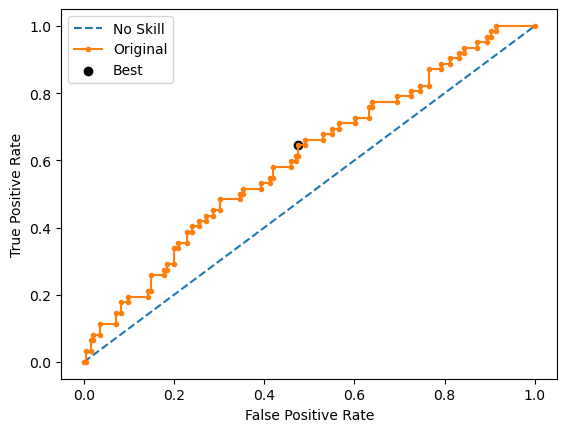

Learning rate set to 0.006754
0:	learn: 0.6912841	total: 3.81ms	remaining: 3.81s
1:	learn: 0.6900261	total: 7.11ms	remaining: 3.55s
2:	learn: 0.6889845	total: 10.3ms	remaining: 3.41s
3:	learn: 0.6882180	total: 13.2ms	remaining: 3.29s
4:	learn: 0.6870207	total: 15.7ms	remaining: 3.12s
5:	learn: 0.6858179	total: 18.8ms	remaining: 3.12s
6:	learn: 0.6851150	total: 21.4ms	remaining: 3.04s
7:	learn: 0.6832779	total: 23.8ms	remaining: 2.95s
8:	learn: 0.6823443	total: 25.8ms	remaining: 2.84s
9:	learn: 0.6812690	total: 27.5ms	remaining: 2.72s
10:	learn: 0.6800280	total: 29.5ms	remaining: 2.65s
11:	learn: 0.6792044	total: 31.4ms	remaining: 2.59s
12:	learn: 0.6783522	total: 33.3ms	remaining: 2.52s
13:	learn: 0.6772651	total: 35.5ms	remaining: 2.5s
14:	learn: 0.6763484	total: 37.2ms	remaining: 2.44s
15:	learn: 0.6753359	total: 39ms	remaining: 2.4s
16:	learn: 0.6745798	total: 41ms	remaining: 2.37s
17:	learn: 0.6740406	total: 42.8ms	remaining: 2.34s
18:	learn: 0.6730462	total: 44.7ms	remaining: 2.31

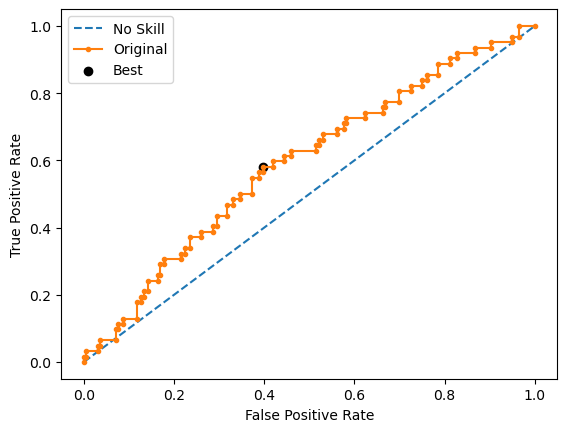

Learning rate set to 0.006754
0:	learn: 0.6916853	total: 4.3ms	remaining: 4.29s
1:	learn: 0.6903289	total: 9.16ms	remaining: 4.57s
2:	learn: 0.6890073	total: 11.5ms	remaining: 3.84s
3:	learn: 0.6876582	total: 14.8ms	remaining: 3.69s
4:	learn: 0.6870475	total: 17.5ms	remaining: 3.49s
5:	learn: 0.6853816	total: 19.5ms	remaining: 3.23s
6:	learn: 0.6842847	total: 21.4ms	remaining: 3.03s
7:	learn: 0.6824566	total: 24.3ms	remaining: 3.02s
8:	learn: 0.6813194	total: 27.5ms	remaining: 3.03s
9:	learn: 0.6800294	total: 30.8ms	remaining: 3.04s
10:	learn: 0.6789221	total: 32.9ms	remaining: 2.95s
11:	learn: 0.6774388	total: 34.8ms	remaining: 2.87s
12:	learn: 0.6757157	total: 36.6ms	remaining: 2.77s
13:	learn: 0.6746996	total: 38.4ms	remaining: 2.7s
14:	learn: 0.6730859	total: 40.6ms	remaining: 2.66s
15:	learn: 0.6718456	total: 42.6ms	remaining: 2.62s
16:	learn: 0.6709146	total: 44.5ms	remaining: 2.57s
17:	learn: 0.6697991	total: 46.6ms	remaining: 2.54s
18:	learn: 0.6687022	total: 48.2ms	remaining: 

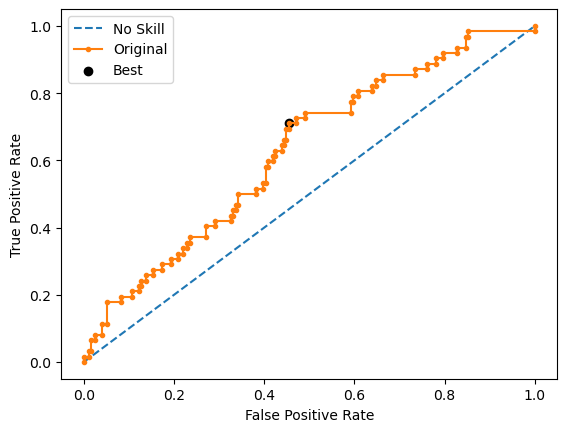

Learning rate set to 0.006754
0:	learn: 0.6921356	total: 7.1ms	remaining: 7.09s
1:	learn: 0.6914337	total: 12.6ms	remaining: 6.31s
2:	learn: 0.6905395	total: 18.7ms	remaining: 6.22s
3:	learn: 0.6893376	total: 24.1ms	remaining: 5.99s
4:	learn: 0.6886264	total: 29.6ms	remaining: 5.89s
5:	learn: 0.6873547	total: 36.1ms	remaining: 5.99s
6:	learn: 0.6865741	total: 41.9ms	remaining: 5.94s
7:	learn: 0.6851301	total: 48.2ms	remaining: 5.98s
8:	learn: 0.6836135	total: 54.3ms	remaining: 5.98s
9:	learn: 0.6819828	total: 59.6ms	remaining: 5.9s
10:	learn: 0.6807787	total: 65.1ms	remaining: 5.86s
11:	learn: 0.6794977	total: 70.6ms	remaining: 5.82s
12:	learn: 0.6787670	total: 75.5ms	remaining: 5.73s
13:	learn: 0.6780396	total: 78.3ms	remaining: 5.51s
14:	learn: 0.6766027	total: 82.7ms	remaining: 5.43s
15:	learn: 0.6753885	total: 85.8ms	remaining: 5.28s
16:	learn: 0.6744288	total: 88.7ms	remaining: 5.13s
17:	learn: 0.6732602	total: 91.9ms	remaining: 5.01s
18:	learn: 0.6727781	total: 93.8ms	remaining: 

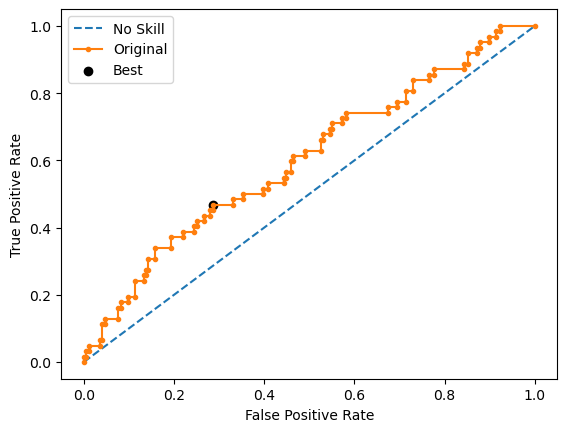

Ave Test G-mean: 0.5780613563062795
Stdev Test G-mean: 0.021632265673870815
Ave Test Specificity: 0.6091836734693878
Ave Test Recall: 0.5516129032258064
Ave Test NPV: 0.8112190842702608
Ave Test Accuracy: 0.5953488372093023
Ave Test Precision: 0.30989017763489235
Ave Test F1-Score: 0.3958123097316304
Ave Runtime: 2.033609962463379


In [250]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [249]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.611160,0.041101,0.586133,0.504563,0.589796,0.635484
4,Random Forest,0.601543,0.031002,0.576754,0.619683,0.638776,0.567742
7,Extreme Gradient Boosting (XGBoost),0.598752,0.037482,0.569527,0.864548,0.642857,0.561290
6,LightGBM,0.590686,0.024111,0.577999,0.759867,0.611224,0.570968
1,SVM Classifier,0.579030,0.019596,0.583602,0.521988,0.643878,0.522581
8,AdaBoost,0.569993,0.025485,0.570802,0.947686,0.604082,0.541935
5,Gradient Boosting Machine (GBM),0.548885,0.042685,0.568090,0.877110,0.584694,0.525806
2,Logistic Regression,0.547066,0.019058,0.551183,NaN,0.663265,0.451613
0,k-Nearest Neighbors,0.521198,0.040743,0.561944,0.692605,0.601020,0.454839


# HO-T07 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.594305156716838
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(max_depth=2, random_state=0))])
Mean Train Score (G-mean) 0.5046837575262252
Std Train Score (G-mean) 0.06523744177119856
GridSearchCV Runtime: 109.23559808731079 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.571125, G-Mean=0.647


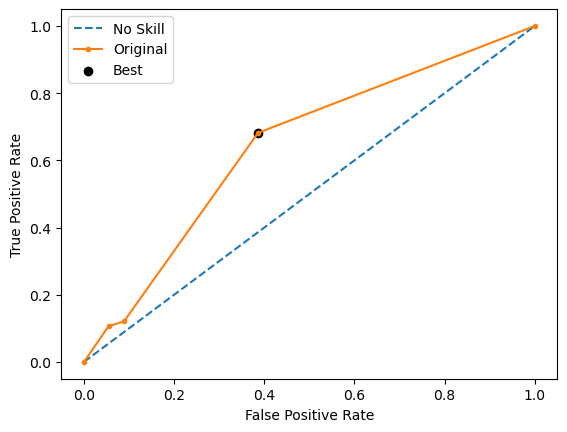

Run 2 - Random State: 1
Test G-mean: 0.6221243475949056
Best Threshold=0.549689, G-Mean=0.622


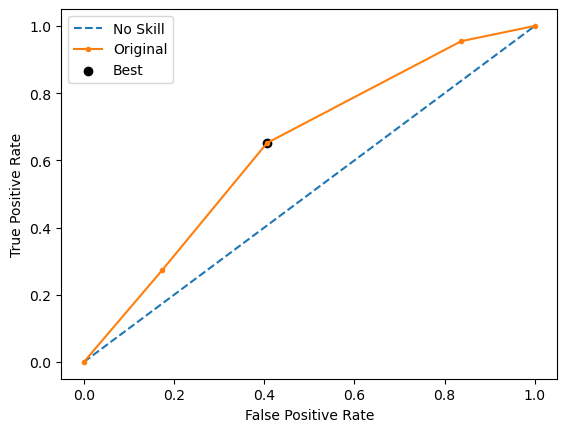

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.575309, G-Mean=0.587


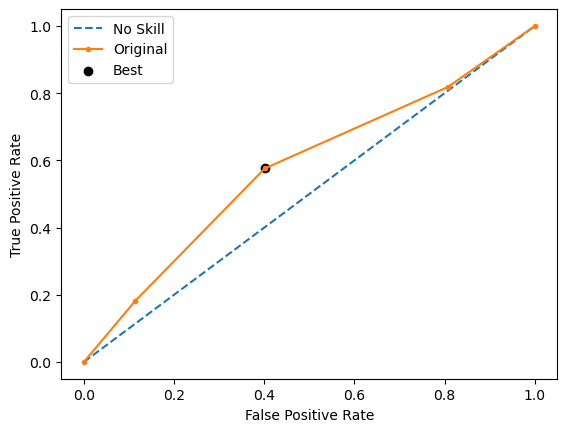

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.567033, G-Mean=0.647


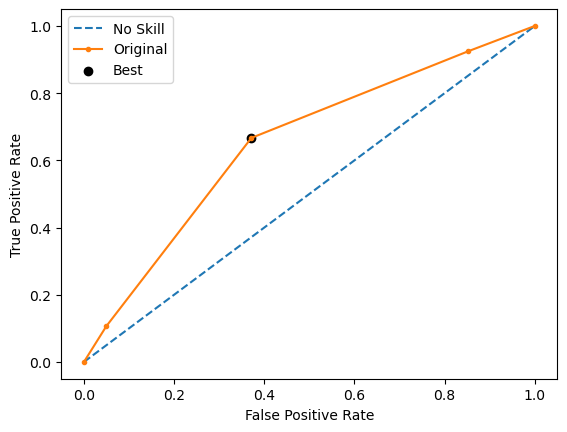

Run 5 - Random State: 4
Test G-mean: 0.6180114835659464
Best Threshold=0.556373, G-Mean=0.618


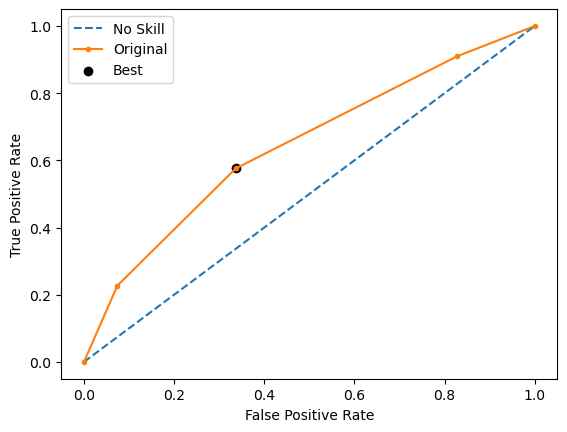

Ave Test G-mean: 0.6243528621539446
Stdev Test G-mean: 0.024812658646035383
Ave Test Specificity: 0.6198019801980198
Ave Test Recall: 0.6303030303030303
Ave Test NPV: 0.837184655396489
Ave Test Accuracy: 0.6223880597014926
Ave Test Precision: 0.3514839709652844
Ave Test F1-Score: 0.45095984157959074
Ave Runtime: 0.044297981262207034


In [253]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 1.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6028860756941616
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 103.42858576774597 secs
Run 1 - Random State: 0
Test G-mean: 0.6052574936862545
Best Threshold=0.516985, G-Mean=0.613


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


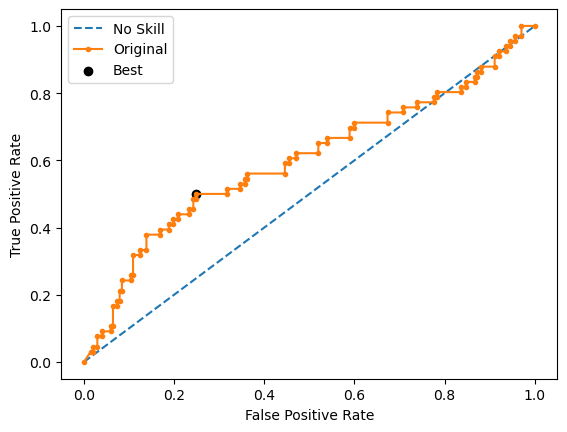

Run 2 - Random State: 1
Test G-mean: 0.5818795909686458
Best Threshold=0.494786, G-Mean=0.585


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


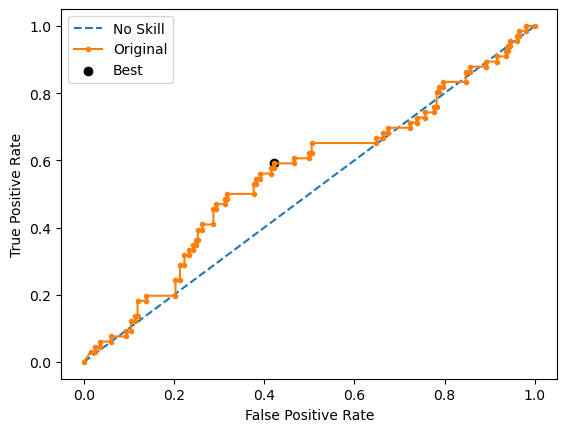

Run 3 - Random State: 2
Test G-mean: 0.6000300022501874
Best Threshold=0.507981, G-Mean=0.610


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


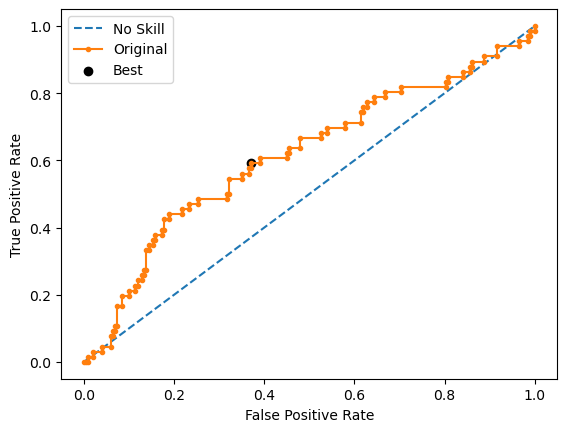

Run 4 - Random State: 3
Test G-mean: 0.5794899316278807
Best Threshold=0.517572, G-Mean=0.582


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


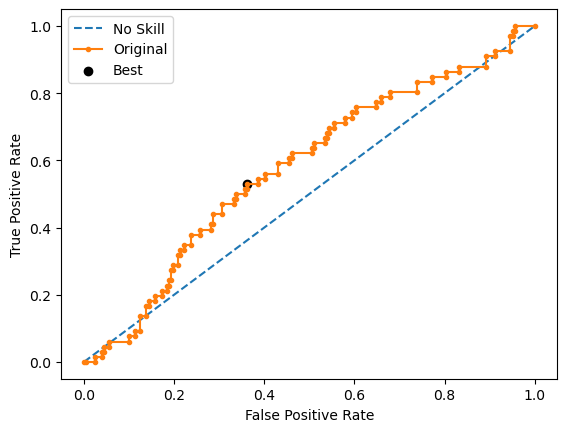

Run 5 - Random State: 4
Test G-mean: 0.5498001709919726
Best Threshold=0.455935, G-Mean=0.567


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


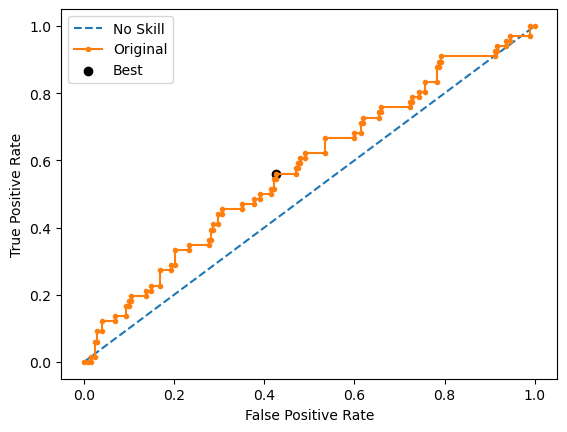

Ave Test G-mean: 0.5832914379049882
Stdev Test G-mean: 0.02179906456771411
Ave Test Specificity: 0.6346534653465347
Ave Test Recall: 0.5393939393939393
Ave Test NPV: 0.8084179681286464
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.327589741869245
Ave Test F1-Score: 0.4060627733963201
Ave Runtime: 0.6266489505767823


In [254]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': ADASYN(random_state=0)}
Best Validation Score (G-mean): 0.525756832540497
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', ADASYN(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.252068334547509
Std Train Score (G-mean) 0.05114472320145939
GridSearchCV Runtime: 182.0276017189026 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5222329678670935
Best Threshold=0.505154, G-Mean=0.297


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


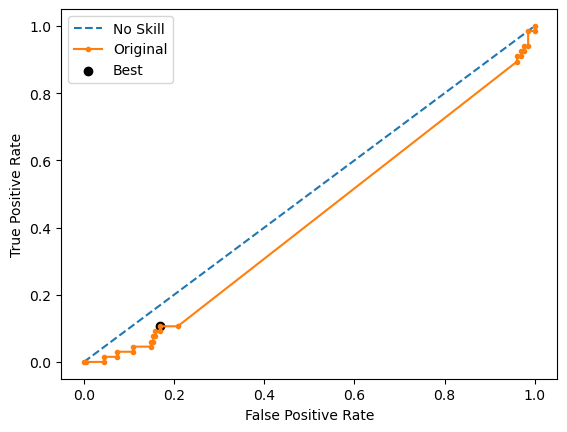

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5620779244547112
Best Threshold=0.500000, G-Mean=0.236


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


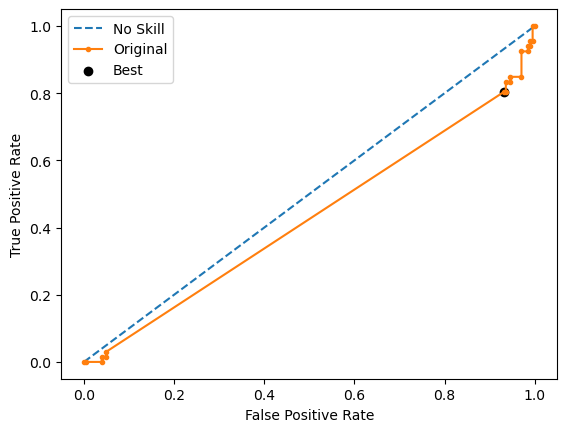

[LibSVM]

Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


Run 3 - Random State: 2
Test G-mean: 0.5035130112869513
Best Threshold=0.494625, G-Mean=0.373


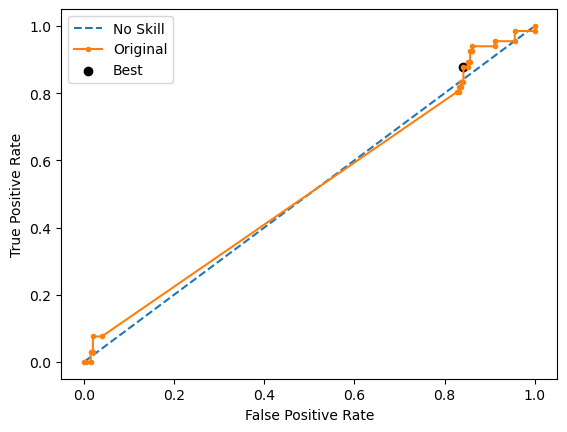

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.49358318694647985
Best Threshold=0.506519, G-Mean=0.359


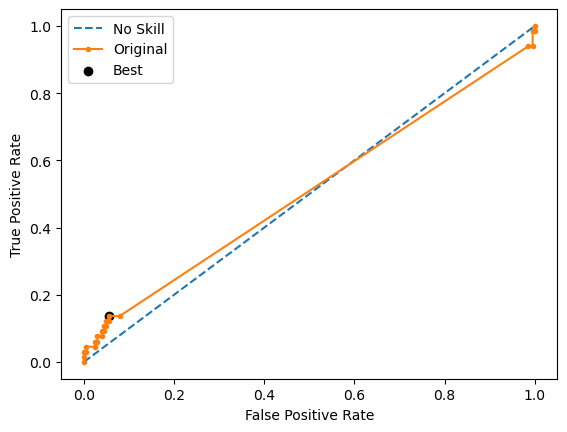

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5260253513539311
Best Threshold=0.505944, G-Mean=0.475


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


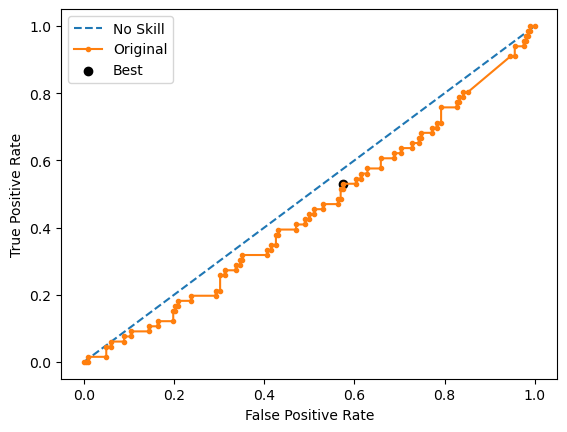

Ave Test G-mean: 0.5214864883818333
Stdev Test G-mean: 0.026317595354782956
Ave Test Specificity: 0.5643564356435644
Ave Test Recall: 0.4878787878787879
Ave Test NPV: 0.7720206747682841
Ave Test Accuracy: 0.5455223880597014
Ave Test Precision: 0.2673880462672968
Ave Test F1-Score: 0.344334146128061
Ave Runtime: 0.3679812431335449


In [255]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [256]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 14, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5616302635069764
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=14))])
Mean Train Score (G-mean) 0.6886934920016934
Std Train Score (G-mean) 0.014052201123921772
GridSearchCV Runtime: 117.2994921207428 secs
Run 1 - Random State: 0
Test G-mean: 0.5545545537413857
Run 2 - Random State: 1
Test G-mean: 0.5148558124861417
Run 3 - Random State: 2
Test G-mean: 0.5405129188294597
Run 4 - Random State: 3
Test G-mean: 0.5664645515906718
Run 5 - Random State: 4
Test G-mean: 0.495251983794861
Ave Test G-mean: 0.534327964088504
Stdev Test G-mean: 0.02909564303445095
Ave Test Specificity: 

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5923832184748289
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7420279935572658
Std Train Score (G-mean) 0.02116929085852266
GridSearchCV Runtime: 45.67667579650879 secs
Run 1 - Random State: 0
Test G-mean: 0.6469481077995503
Best Threshold=0.527040, G-Mean=0.690


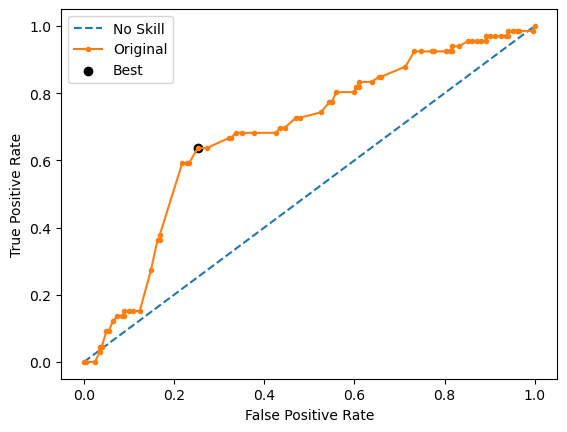

Run 2 - Random State: 1
Test G-mean: 0.6224859427126748
Best Threshold=0.515278, G-Mean=0.642


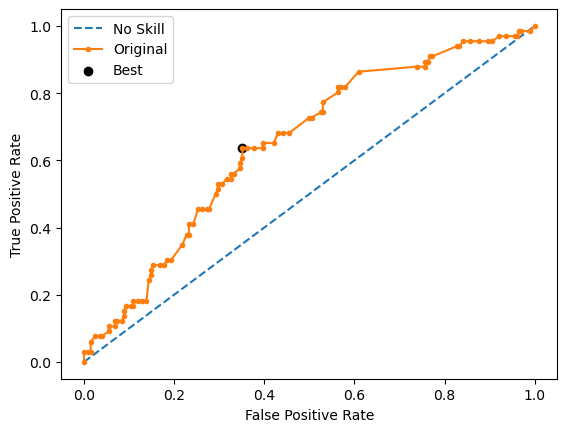

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.534545, G-Mean=0.587


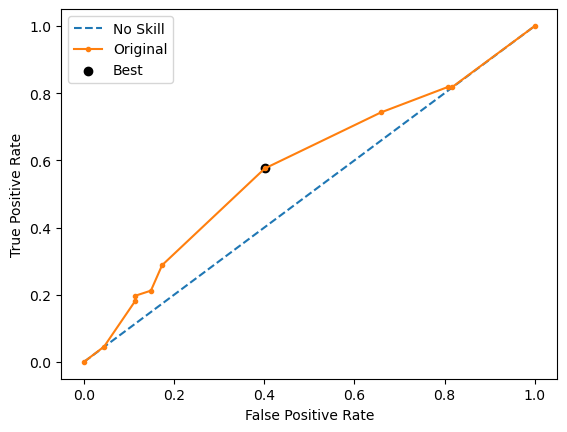

Run 4 - Random State: 3
Test G-mean: 0.6374877560109734
Best Threshold=0.527584, G-Mean=0.665


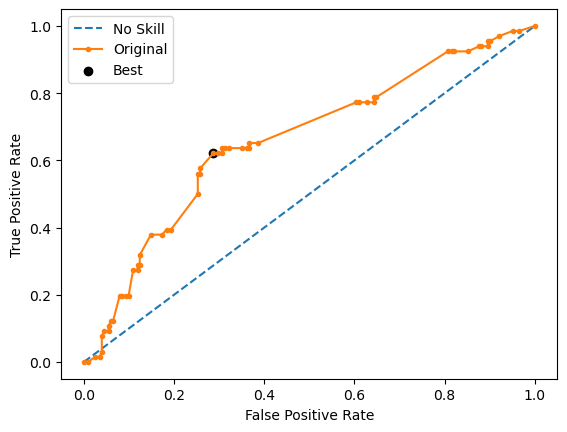

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


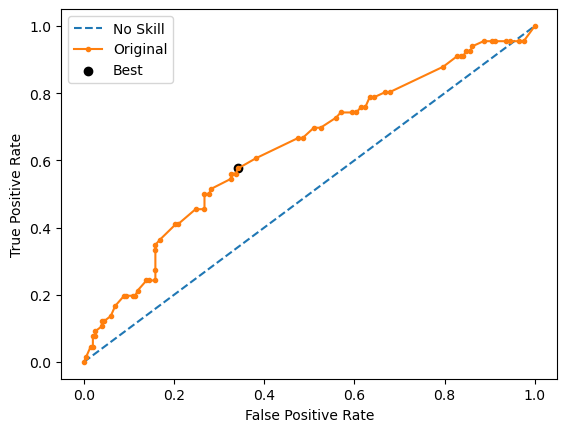

Ave Test G-mean: 0.6213187062333223
Stdev Test G-mean: 0.023230156834298615
Ave Test Specificity: 0.6158415841584158
Ave Test Recall: 0.6272727272727272
Ave Test NPV: 0.8349878938043582
Ave Test Accuracy: 0.6186567164179103
Ave Test Precision: 0.3478773121660482
Ave Test F1-Score: 0.4474892031398528
Ave Runtime: 0.3838043689727783


In [258]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6020912873576488
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9436587297011378
Std Train Score (G-mean) 0.004484499732313889
GridSearchCV Runtime: 12.505472421646118 secs
Run 1 - Random State: 0
Test G-mean: 0.596896664895069
Best Threshold=0.731059, G-Mean=0.597


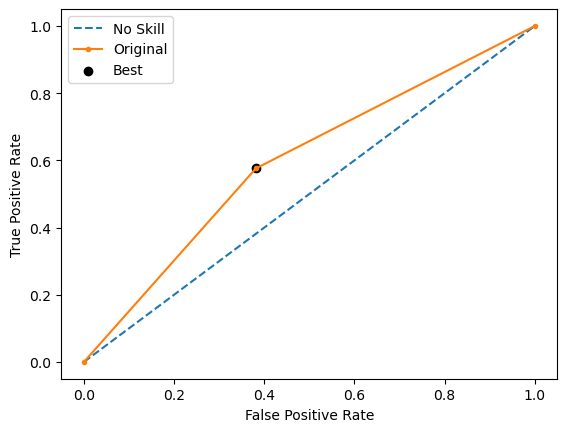

Run 2 - Random State: 1
Test G-mean: 0.5757891569970136
Best Threshold=0.731059, G-Mean=0.576


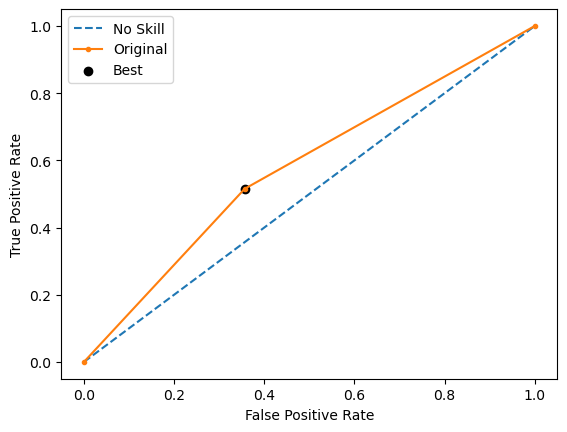

Run 3 - Random State: 2
Test G-mean: 0.5518427792816578
Best Threshold=0.731059, G-Mean=0.552


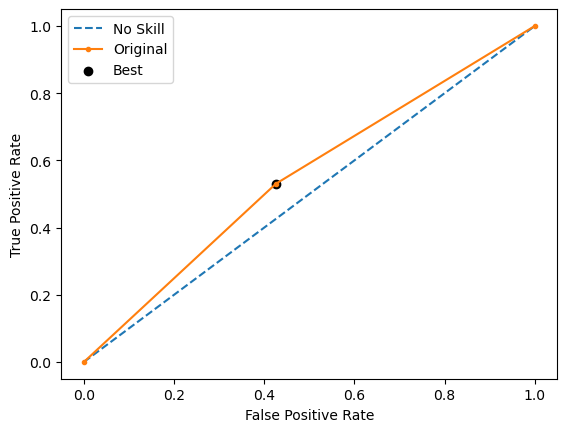

Run 4 - Random State: 3
Test G-mean: 0.5682493209226676
Best Threshold=0.731059, G-Mean=0.568


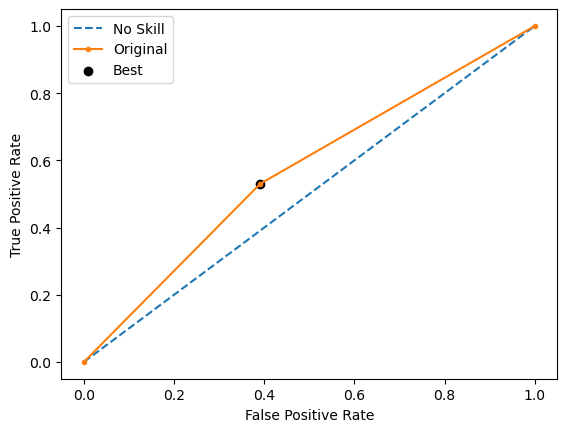

Run 5 - Random State: 4
Test G-mean: 0.58458033957476
Best Threshold=0.731059, G-Mean=0.585


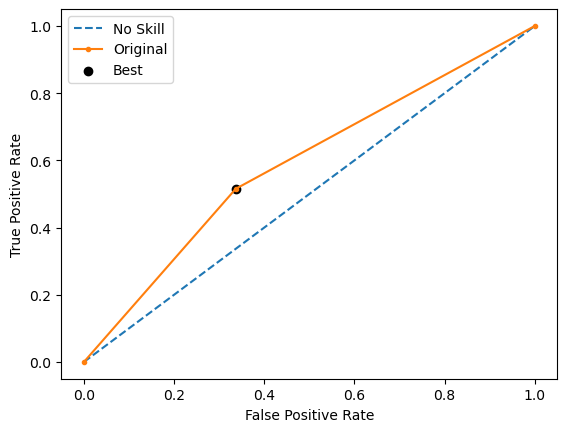

Ave Test G-mean: 0.5754716523342337
Stdev Test G-mean: 0.016974877528584738
Ave Test Specificity: 0.6217821782178218
Ave Test Recall: 0.5333333333333333
Ave Test NPV: 0.8029016920954419
Ave Test Accuracy: 0.6
Ave Test Precision: 0.3161593150259835
Ave Test F1-Score: 0.3966441368849332
Ave Runtime: 0.26468625068664553


In [259]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5820526945931113
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=2,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8829407400855935
Std Train Score (G-mean) 0.010635227990922288
GridSearchCV Runtime: 147.33878827095032 secs
Run 1 - Random State: 0
Test G-mean: 0.5650725003865162
Best Threshold=0.373778, G-Mean=0.622


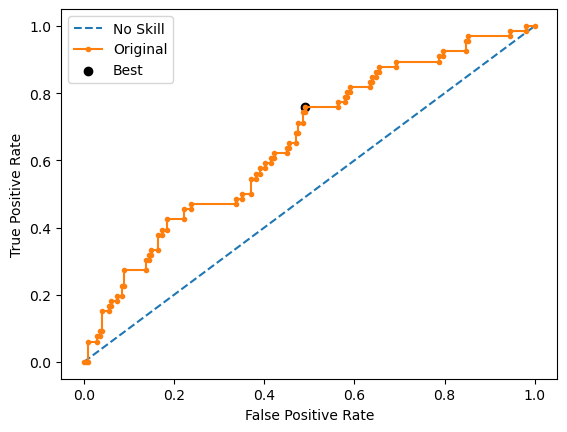

Run 2 - Random State: 1
Test G-mean: 0.5347930444200224
Best Threshold=0.434090, G-Mean=0.562


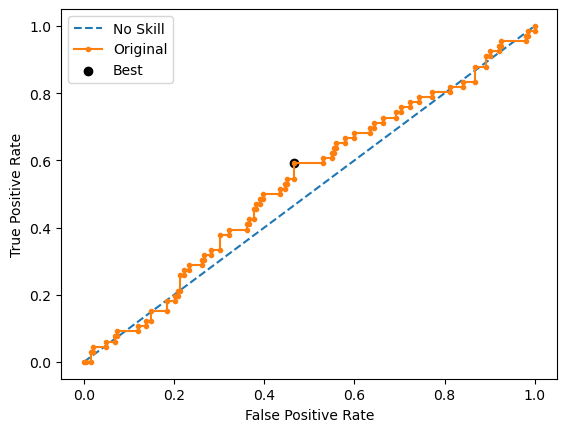

Run 3 - Random State: 2
Test G-mean: 0.6082244599647156
Best Threshold=0.514068, G-Mean=0.608


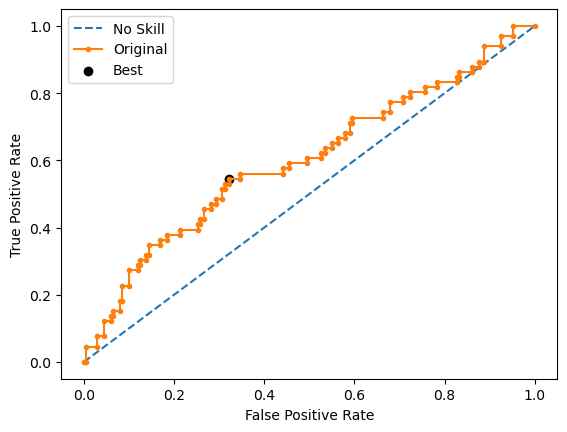

Run 4 - Random State: 3
Test G-mean: 0.541898851665644
Best Threshold=0.355166, G-Mean=0.584


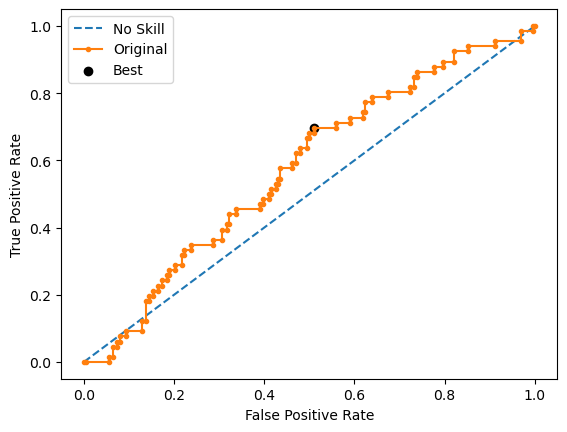

Run 5 - Random State: 4
Test G-mean: 0.5324738048348328
Best Threshold=0.431802, G-Mean=0.600


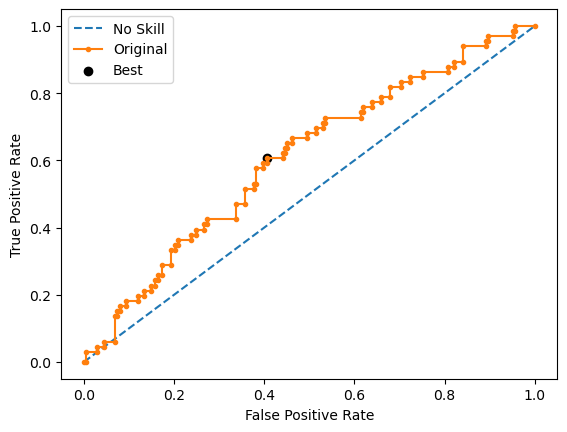

Ave Test G-mean: 0.5564925322543463
Stdev Test G-mean: 0.031664454637771115
Ave Test Specificity: 0.6524752475247525
Ave Test Recall: 0.47575757575757577
Ave Test NPV: 0.7920734264262264
Ave Test Accuracy: 0.608955223880597
Ave Test Precision: 0.30927895110762316
Ave Test F1-Score: 0.374596432074146
Ave Runtime: 0.6857966423034668


In [260]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 1, 'classifier__max_depth': None, 'classifier__max_leaves': 10, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.594776223443463
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_type=None,
       

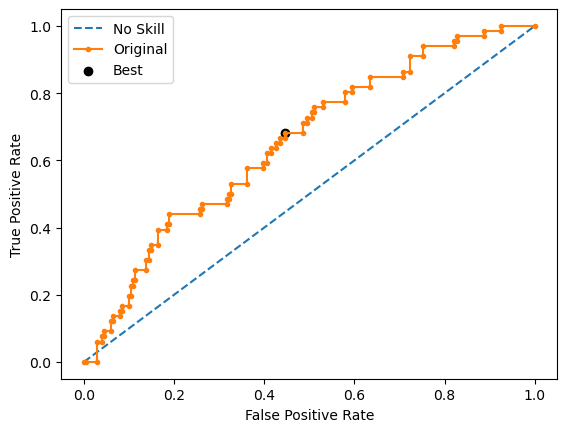

Run 2 - Random State: 1
Test G-mean: 0.5455545462887259
Best Threshold=0.390412, G-Mean=0.577


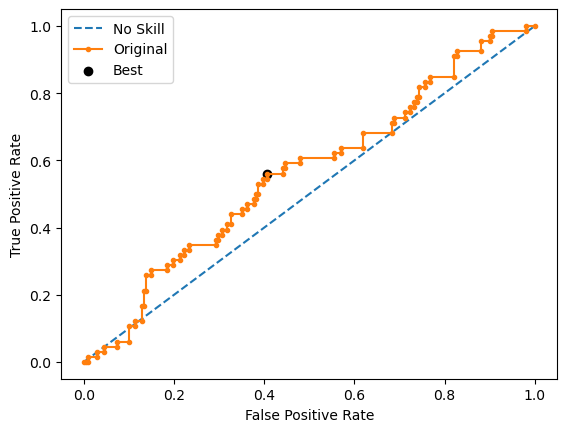

Run 3 - Random State: 2
Test G-mean: 0.60296049301394
Best Threshold=0.345868, G-Mean=0.610


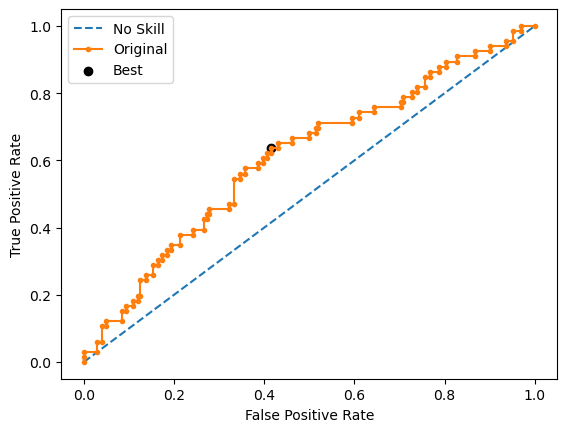

Run 4 - Random State: 3
Test G-mean: 0.5776100443520124
Best Threshold=0.746747, G-Mean=0.614


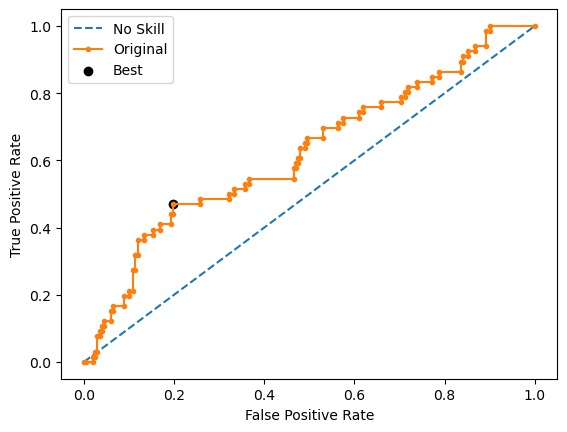

Run 5 - Random State: 4
Test G-mean: 0.5228788963364495
Best Threshold=0.370161, G-Mean=0.577


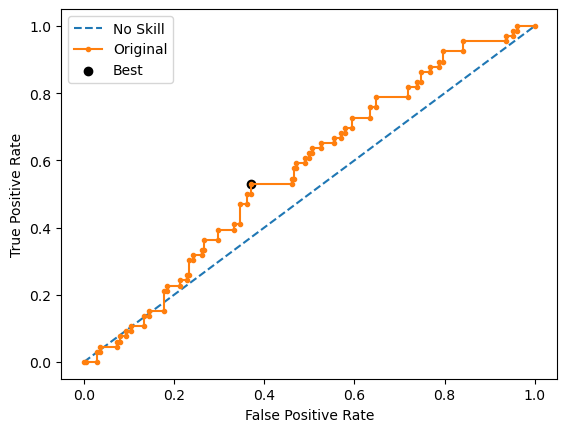

Ave Test G-mean: 0.5671267374504626
Stdev Test G-mean: 0.032394268272267525
Ave Test Specificity: 0.6742574257425742
Ave Test Recall: 0.4787878787878788
Ave Test NPV: 0.7984199040153084
Ave Test Accuracy: 0.6261194029850746
Ave Test Precision: 0.3253225435999957
Ave Test F1-Score: 0.38669440203548416
Ave Runtime: 0.3103505611419678


In [261]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 2, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6016644629517163
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=2,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6227262963253994
Std Train Score (G-mean) 0.022477704456260326
GridSearchCV Runtime: 392.5867874622345 secs
Run 1 - Random State: 0
Test G-mean: 0.6467161851866847
Best Threshold=0.504757, G-Mean=0.653


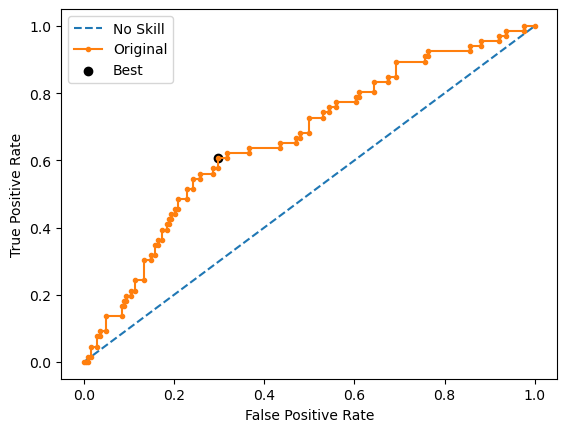

Run 2 - Random State: 1
Test G-mean: 0.563610473355994
Best Threshold=0.477636, G-Mean=0.573


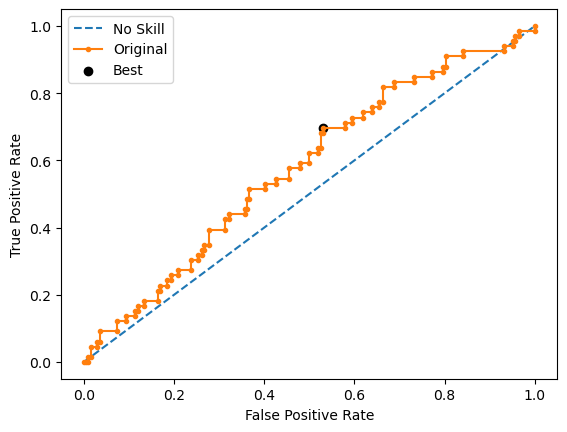

Run 3 - Random State: 2
Test G-mean: 0.6074840769027358
Best Threshold=0.503476, G-Mean=0.619


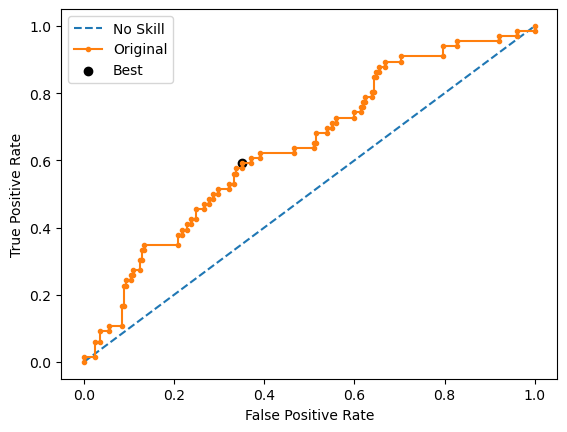

Run 4 - Random State: 3
Test G-mean: 0.6500132704223603
Best Threshold=0.508920, G-Mean=0.665


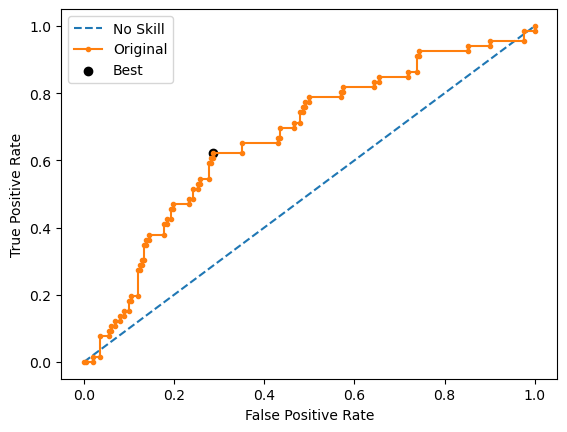

Run 5 - Random State: 4
Test G-mean: 0.584452015494721
Best Threshold=0.476340, G-Mean=0.612


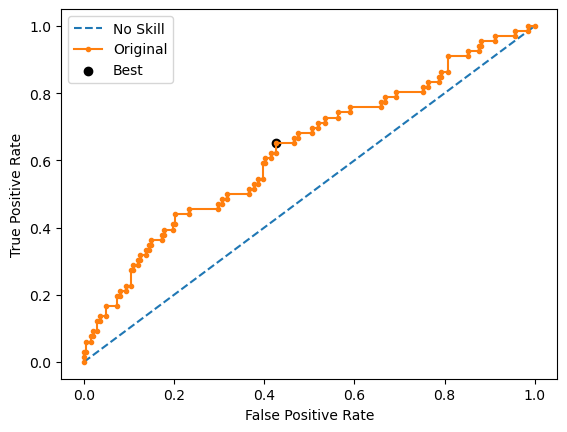

Ave Test G-mean: 0.6104552042724991
Stdev Test G-mean: 0.037944438240259996
Ave Test Specificity: 0.6425742574257426
Ave Test Recall: 0.5818181818181818
Ave Test NPV: 0.8247886757374111
Ave Test Accuracy: 0.6276119402985074
Ave Test Precision: 0.3476870659658312
Ave Test F1-Score: 0.43474440191841524
Ave Runtime: 0.5993012905120849


In [262]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6925932	total: 3.02ms	remaining: 3.01s
1:	learn: 0.6915944	total: 5.72ms	remaining: 2.85s
2:	learn: 0.6907981	total: 8.29ms	remaining: 2.75s
3:	learn: 0.6899970	total: 11ms	remaining: 2.73s
4:	learn: 0.6889704	total: 13.6ms	remaining: 2.7s
5:	learn: 0.6878691	total: 16.1ms	remaining: 2.67s
6:	learn: 0.6866138	total: 18.7ms	remaining: 2.65s
7:	learn: 0.6859139	total: 21ms	remaining: 2.6s
8:	learn: 0.6848884	total: 23.4ms	remaining: 2.58s
9:	learn: 0.6836013	total: 25.9ms	remaining: 2.57s
10:	learn: 0.6821693	total: 28.7ms	remaining: 2.58s
11:	learn: 0.6817355	total: 31.1ms	remaining: 2.56s
12:	learn: 0.6805076	total: 33.5ms	remaining: 2.54s
13:	learn: 0.6794318	total: 36.1ms	remaining: 2.54s
14:	learn: 0.6788873	total: 38.7ms	remaining: 2.54s
15:	learn: 0.6779862	total: 41.2ms	remaining: 2.53s
16:	learn: 0.6769858	total: 44.1ms	remaining: 2.55s
17:	learn: 0.6760934	total: 46.8ms	remain

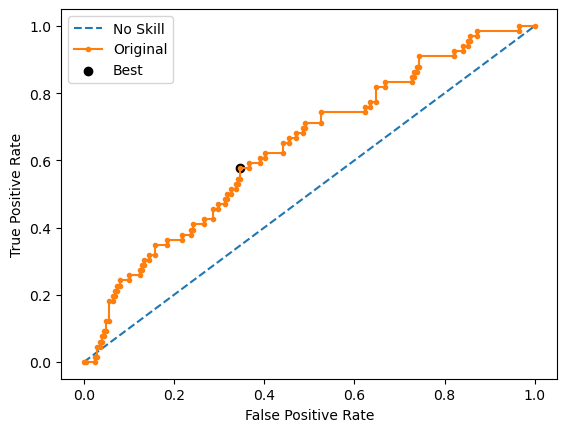

Learning rate set to 0.006922
0:	learn: 0.6917757	total: 3.66ms	remaining: 3.66s
1:	learn: 0.6907574	total: 6.14ms	remaining: 3.07s
2:	learn: 0.6899608	total: 8.73ms	remaining: 2.9s
3:	learn: 0.6885274	total: 11.5ms	remaining: 2.85s
4:	learn: 0.6877070	total: 14ms	remaining: 2.78s
5:	learn: 0.6868436	total: 16.6ms	remaining: 2.75s
6:	learn: 0.6854144	total: 19.1ms	remaining: 2.71s
7:	learn: 0.6841373	total: 21.5ms	remaining: 2.67s
8:	learn: 0.6827903	total: 24.1ms	remaining: 2.65s
9:	learn: 0.6816773	total: 26.5ms	remaining: 2.63s
10:	learn: 0.6802913	total: 28.8ms	remaining: 2.59s
11:	learn: 0.6790553	total: 31.4ms	remaining: 2.58s
12:	learn: 0.6782002	total: 33.9ms	remaining: 2.58s
13:	learn: 0.6771877	total: 36.5ms	remaining: 2.57s
14:	learn: 0.6758085	total: 38.8ms	remaining: 2.55s
15:	learn: 0.6743024	total: 41.4ms	remaining: 2.55s
16:	learn: 0.6727772	total: 44ms	remaining: 2.54s
17:	learn: 0.6723835	total: 46.3ms	remaining: 2.53s
18:	learn: 0.6711152	total: 48.9ms	remaining: 2.5

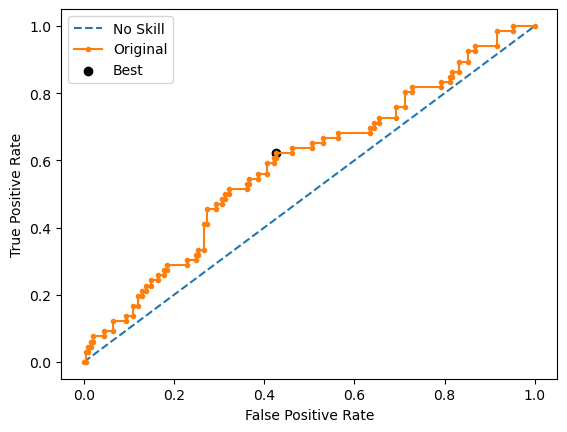

Learning rate set to 0.006922
0:	learn: 0.6915608	total: 2.64ms	remaining: 2.63s
1:	learn: 0.6891043	total: 5.35ms	remaining: 2.67s
2:	learn: 0.6877437	total: 7.9ms	remaining: 2.63s
3:	learn: 0.6859936	total: 10.4ms	remaining: 2.6s
4:	learn: 0.6848356	total: 13ms	remaining: 2.6s
5:	learn: 0.6837831	total: 15.4ms	remaining: 2.55s
6:	learn: 0.6822884	total: 17.7ms	remaining: 2.51s
7:	learn: 0.6811639	total: 20.1ms	remaining: 2.49s
8:	learn: 0.6797561	total: 22.7ms	remaining: 2.5s
9:	learn: 0.6786867	total: 25.2ms	remaining: 2.49s
10:	learn: 0.6777130	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6771724	total: 30.3ms	remaining: 2.5s
12:	learn: 0.6759269	total: 32.8ms	remaining: 2.49s
13:	learn: 0.6743493	total: 35.2ms	remaining: 2.48s
14:	learn: 0.6731938	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6728976	total: 40.4ms	remaining: 2.48s
16:	learn: 0.6712511	total: 43ms	remaining: 2.48s
17:	learn: 0.6699981	total: 45.4ms	remaining: 2.48s
18:	learn: 0.6688468	total: 47.8ms	remaining: 2.47s
1

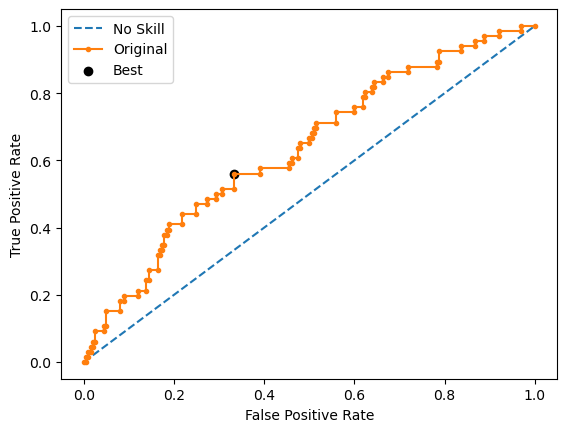

Learning rate set to 0.006922
0:	learn: 0.6922818	total: 2.8ms	remaining: 2.8s
1:	learn: 0.6910777	total: 5.41ms	remaining: 2.7s
2:	learn: 0.6898807	total: 7.77ms	remaining: 2.58s
3:	learn: 0.6889244	total: 10.2ms	remaining: 2.53s
4:	learn: 0.6879907	total: 12.7ms	remaining: 2.52s
5:	learn: 0.6867908	total: 15ms	remaining: 2.49s
6:	learn: 0.6857551	total: 17.5ms	remaining: 2.49s
7:	learn: 0.6846771	total: 19.9ms	remaining: 2.47s
8:	learn: 0.6838094	total: 22.2ms	remaining: 2.44s
9:	learn: 0.6831921	total: 24.7ms	remaining: 2.44s
10:	learn: 0.6820158	total: 27.1ms	remaining: 2.43s
11:	learn: 0.6807095	total: 29.7ms	remaining: 2.44s
12:	learn: 0.6797208	total: 32.3ms	remaining: 2.45s
13:	learn: 0.6781180	total: 34.9ms	remaining: 2.45s
14:	learn: 0.6774925	total: 37.1ms	remaining: 2.44s
15:	learn: 0.6767942	total: 39.8ms	remaining: 2.44s
16:	learn: 0.6758322	total: 42.1ms	remaining: 2.43s
17:	learn: 0.6749166	total: 44.5ms	remaining: 2.43s
18:	learn: 0.6740625	total: 46.8ms	remaining: 2.4

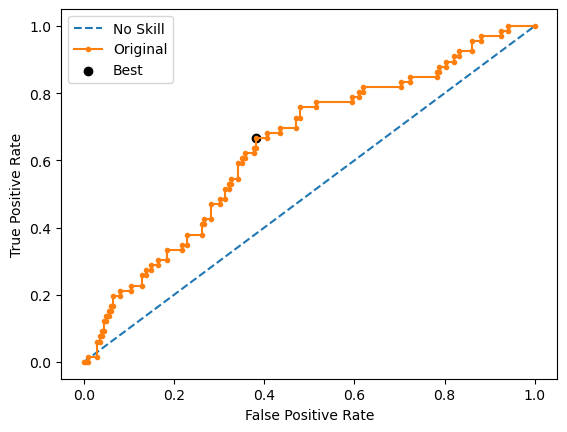

Learning rate set to 0.006922
0:	learn: 0.6918770	total: 3.03ms	remaining: 3.03s
1:	learn: 0.6908344	total: 5.73ms	remaining: 2.86s
2:	learn: 0.6898347	total: 8.16ms	remaining: 2.71s
3:	learn: 0.6889398	total: 10.7ms	remaining: 2.66s
4:	learn: 0.6877485	total: 13.2ms	remaining: 2.62s
5:	learn: 0.6863435	total: 15.8ms	remaining: 2.61s
6:	learn: 0.6851576	total: 18.2ms	remaining: 2.59s
7:	learn: 0.6840617	total: 20.7ms	remaining: 2.56s
8:	learn: 0.6824181	total: 22.9ms	remaining: 2.53s
9:	learn: 0.6812613	total: 25.4ms	remaining: 2.51s
10:	learn: 0.6794770	total: 27.7ms	remaining: 2.49s
11:	learn: 0.6782449	total: 30.3ms	remaining: 2.49s
12:	learn: 0.6774971	total: 32.9ms	remaining: 2.5s
13:	learn: 0.6764224	total: 35.4ms	remaining: 2.49s
14:	learn: 0.6747983	total: 37.8ms	remaining: 2.48s
15:	learn: 0.6737534	total: 40.2ms	remaining: 2.47s
16:	learn: 0.6723031	total: 42.6ms	remaining: 2.46s
17:	learn: 0.6708492	total: 45.2ms	remaining: 2.47s
18:	learn: 0.6697755	total: 47.7ms	remaining:

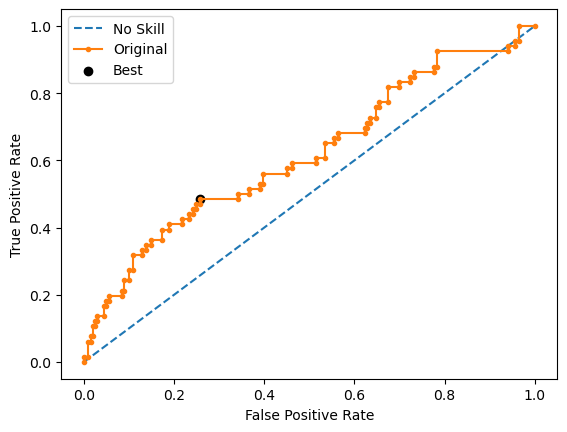

Ave Test G-mean: 0.5978506203204994
Stdev Test G-mean: 0.026702887539368426
Ave Test Specificity: 0.6227722772277228
Ave Test Recall: 0.5757575757575757
Ave Test NPV: 0.8185451642933618
Ave Test Accuracy: 0.6111940298507463
Ave Test Precision: 0.33207704455584613
Ave Test F1-Score: 0.4209373515085228
Ave Runtime: 2.6942410469055176


In [263]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [264]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
3,Decision Tree,0.624353,0.024813,0.594305,0.504684,0.619802,0.630303
6,LightGBM,0.621319,0.023230,0.592383,0.742028,0.615842,0.627273
4,Random Forest,0.610455,0.037944,0.601664,0.622726,0.642574,0.581818
2,Logistic Regression,0.583291,0.021799,0.602886,NaN,0.634653,0.539394
8,AdaBoost,0.575472,0.016975,0.602091,0.943659,0.621782,0.533333
7,Extreme Gradient Boosting (XGBoost),0.567127,0.032394,0.594776,0.850648,0.674257,0.478788
5,Gradient Boosting Machine (GBM),0.556493,0.031664,0.582053,0.882941,0.652475,0.475758
0,k-Nearest Neighbors,0.534328,0.029096,0.561630,0.688693,0.550495,0.527273
1,SVM Classifier,0.521486,0.026318,0.525757,0.252068,0.564356,0.487879


# HO-T08 Runs: RobustScaler

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 3, 'classifier__max_features': 'log2', 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5966131815002639
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=3,
                                        max_features='log2', random_state=0))])
Mean Train Score (G-mean) 0.5520784197104317
Std Train Score (G-mean) 0.049809375846590453
GridSearchCV Runtime: 66.08575892448425 secs
Run 1 - Random State: 0
Test G-mean: 0.6547273224684294
Best Threshold=0.582692, G-Mean=0.663


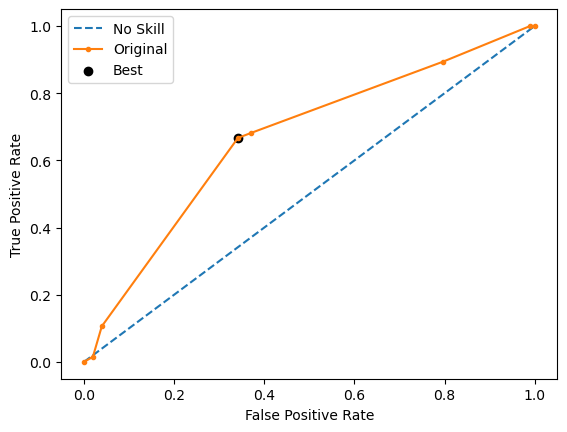

Run 2 - Random State: 1
Test G-mean: 0.596016378594041
Best Threshold=0.655556, G-Mean=0.596


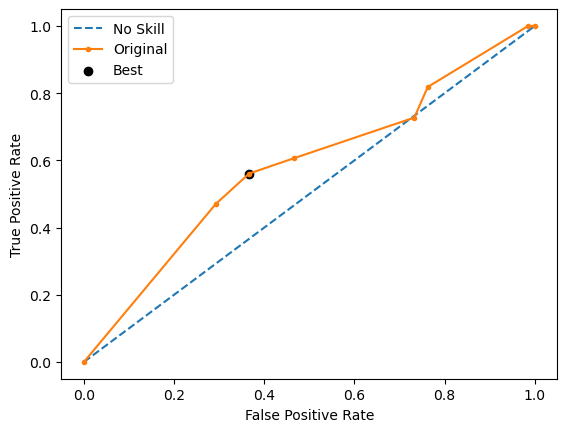

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.612648, G-Mean=0.587


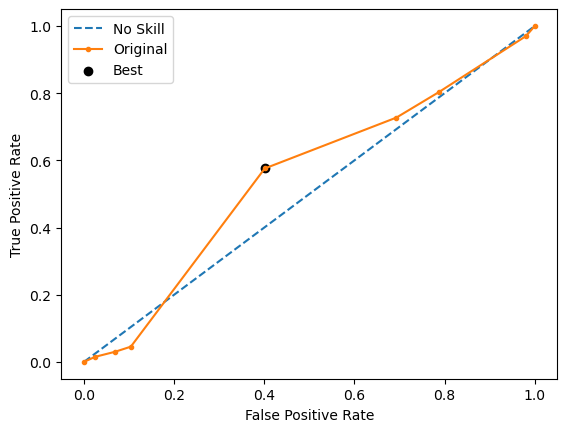

Run 4 - Random State: 3
Test G-mean: 0.6371346749780661
Best Threshold=0.592937, G-Mean=0.637


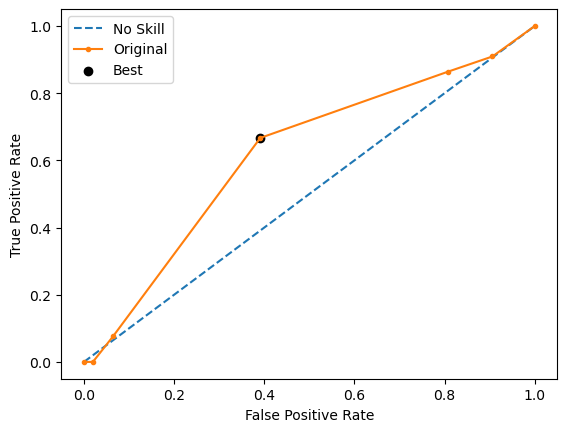

Run 5 - Random State: 4
Test G-mean: 0.5996548662321182
Best Threshold=0.564576, G-Mean=0.600


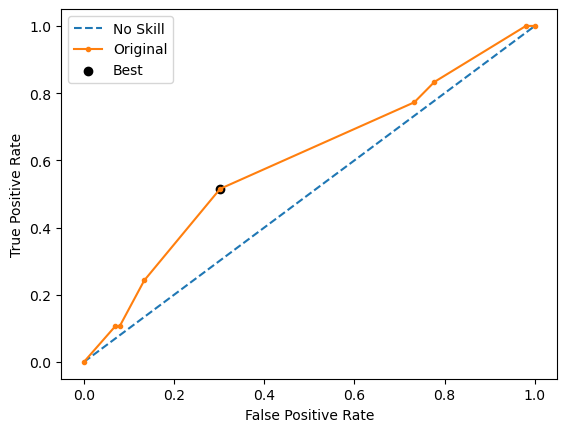

Ave Test G-mean: 0.6149603820603801
Stdev Test G-mean: 0.029296219567977642
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.5999999999999999
Ave Test NPV: 0.8297560066055503
Ave Test Accuracy: 0.6253731343283582
Ave Test Precision: 0.34865587570072953
Ave Test F1-Score: 0.4401459177307229
Ave Runtime: 0.025896835327148437


In [281]:
ho_t08_dt_gs, ho_t08_dt_be, ho_t08_dt_model_info, ho_t08_dt_metrics_df = dt_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

Best Hyperparameters: {'classifier__C': 100.0, 'classifier__penalty': 'l2', 'classifier__solver': 'lbfgs', 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6078975550078626
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=100.0, max_iter=1000, random_state=0))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 52.069857358932495 secs
Run 1 - Random State: 0
Test G-mean: 0.6188604841399094
Best Threshold=0.512718, G-Mean=0.634


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


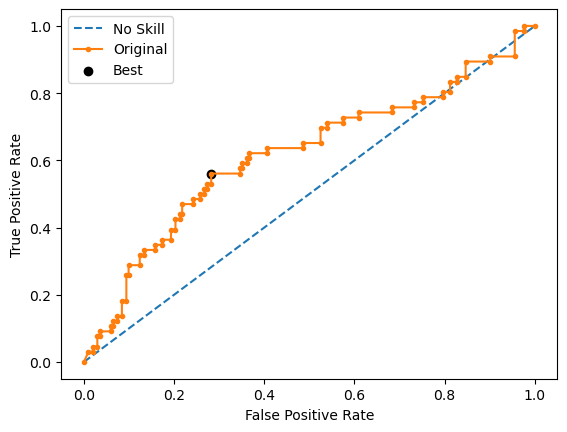

Run 2 - Random State: 1
Test G-mean: 0.5763099975892594
Best Threshold=0.494359, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


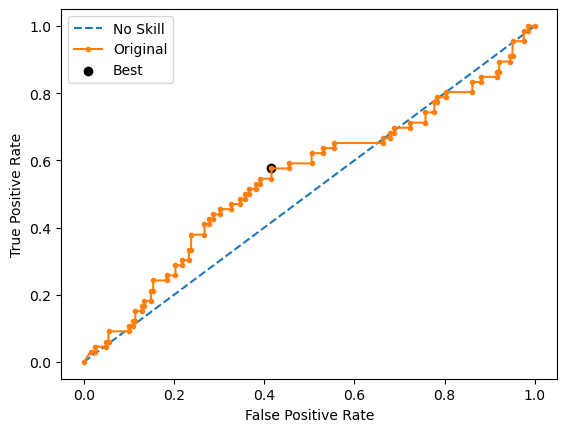

Run 3 - Random State: 2
Test G-mean: 0.6150307523064422
Best Threshold=0.499350, G-Mean=0.620


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


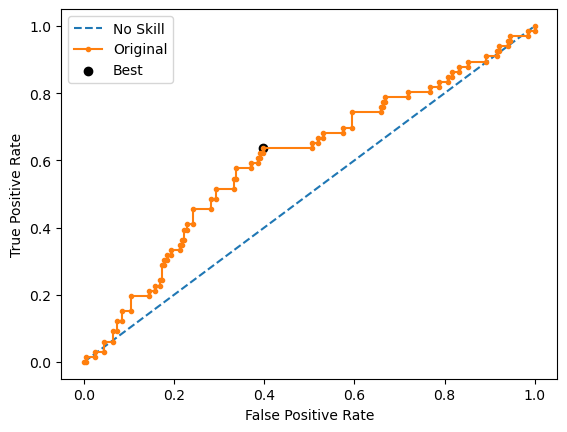

Run 4 - Random State: 3
Test G-mean: 0.5624781223868323
Best Threshold=0.497402, G-Mean=0.592


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


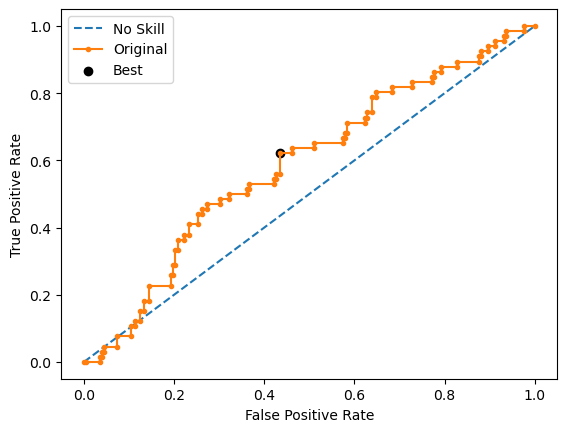

Run 5 - Random State: 4
Test G-mean: 0.560273496284684
Best Threshold=0.486683, G-Mean=0.580


lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression


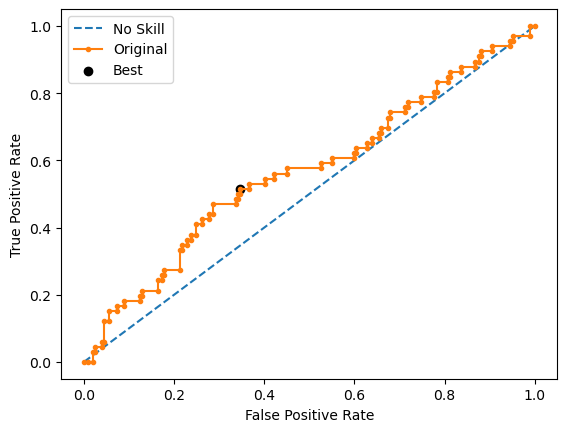

Ave Test G-mean: 0.5865905705414255
Stdev Test G-mean: 0.028416016593412613
Ave Test Specificity: 0.6267326732673267
Ave Test Recall: 0.5515151515151515
Ave Test NPV: 0.8105340798718748
Ave Test Accuracy: 0.6082089552238805
Ave Test Precision: 0.3266746618406295
Ave Test F1-Score: 0.4094494756438197
Ave Runtime: 0.369551420211792


In [282]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1000000.0, 'classifier__kernel': 'sigmoid', 'classifier__probability': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5271837717242484
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 SVC(C=1000000.0, kernel='sigmoid', max_iter=1000,
                     probability=True, random_state=0, verbose=True))])
Mean Train Score (G-mean) 0.25173061573833866
Std Train Score (G-mean) 0.05385039016863185
GridSearchCV Runtime: 118.15375328063965 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.5470648297896689
Best Threshold=0.494878, G-Mean=0.567


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.
Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


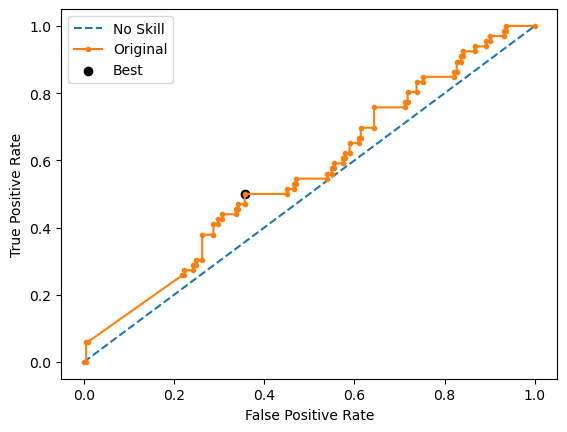

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.50714960324544
Best Threshold=0.521705, G-Mean=0.293


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


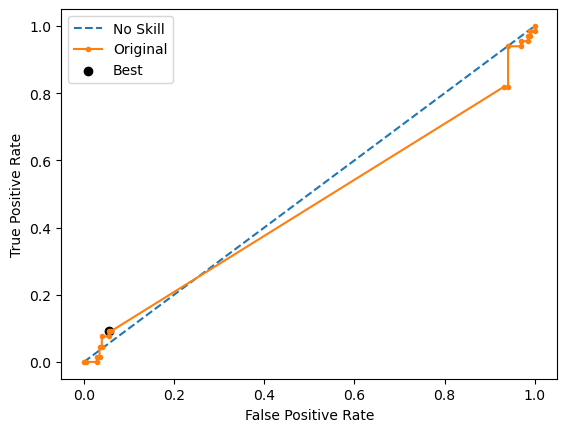

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.5199298344039033
Best Threshold=0.519037, G-Mean=0.401


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


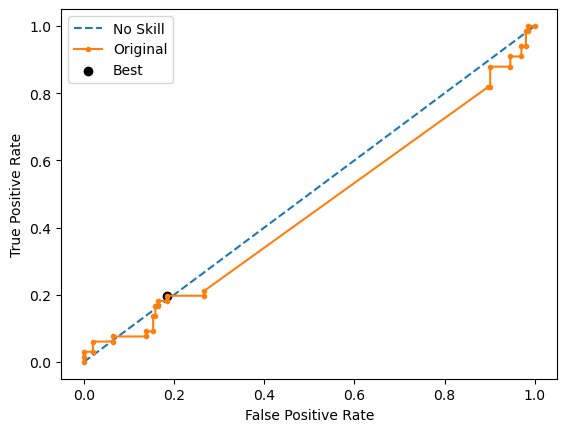

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.4756286600513327
Best Threshold=0.500000, G-Mean=0.118


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


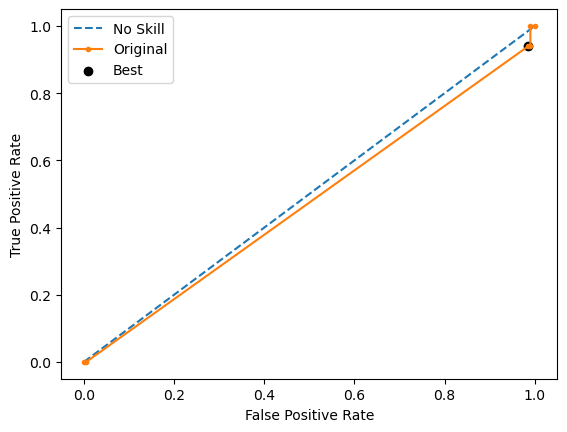

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5391929829915173
Best Threshold=0.493064, G-Mean=0.287


Solver terminated early (max_iter=1000).  Consider pre-processing your data with StandardScaler or MinMaxScaler.


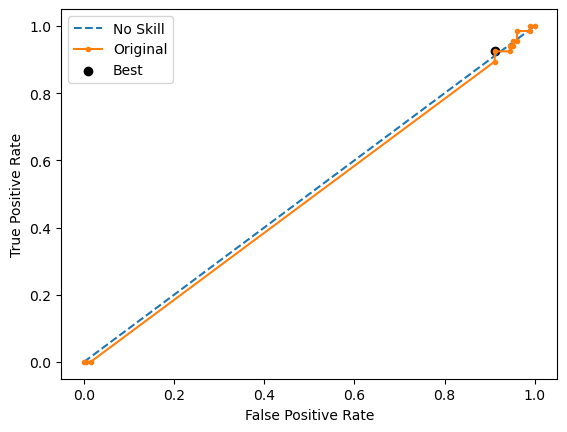

Ave Test G-mean: 0.5177931820963725
Stdev Test G-mean: 0.02833054363296901
Ave Test Specificity: 0.5900990099009901
Ave Test Recall: 0.45757575757575764
Ave Test NPV: 0.7689140185823027
Ave Test Accuracy: 0.5574626865671642
Ave Test Precision: 0.2680212057309454
Ave Test F1-Score: 0.3371681339390776
Ave Runtime: 0.060284757614135744


In [283]:
ho_t08_svm_gs, ho_t08_svm_be, ho_t08_svm_model_info, ho_t08_svm_metrics_df = svm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [284]:
ho_t08_knn_gs, ho_t08_knn_be, ho_t08_knn_model_info, ho_t08_knn_metrics_df = knn_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'cosine', 'classifier__n_neighbors': 3, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5594153075270116
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 KNeighborsClassifier(metric='cosine', n_neighbors=3))])
Mean Train Score (G-mean) 0.686828076239181
Std Train Score (G-mean) 0.01544186972704155
GridSearchCV Runtime: 77.13261294364929 secs
Run 1 - Random State: 0
Test G-mean: 0.5682493209226677
Run 2 - Random State: 1
Test G-mean: 0.487004843273388
Run 3 - Random State: 2
Test G-mean: 0.5098048549190267
Run 4 - Random State: 3
Test G-mean: 0.4846116845975599
Run 5 - Random State: 4
Test G-mean: 0.5447289903863175
Ave Test G-mean: 0.5188799388197919
Stdev Test G-mean: 0.036668111034816334
Ave Test Specificity: 0.4851

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
Best Hyperparameters: {'classifier__boosting_type': 'dart', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5965566786253891
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 LGBMClassifier(boosting_type='dart', learning_rate=0.01,
                                max_depth=2, n_estimators=200,
                                random_state=0))])
Mean Train Score (G-mean) 0.7460883092264341
Std Train Score (G-mean) 0.01766791496110193
GridSearchCV Runtime: 38.253618001937866 secs
Run 1 - Random State: 0
Test G-mean: 0.6575281243592797
Best Threshold=0.526146, G-Mean=0.684


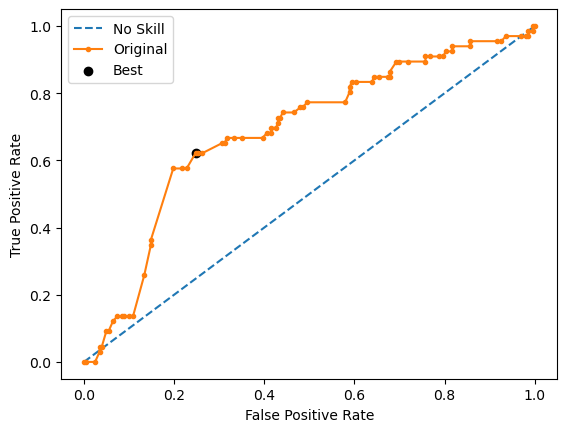

Run 2 - Random State: 1
Test G-mean: 0.6247111543766769
Best Threshold=0.507078, G-Mean=0.632


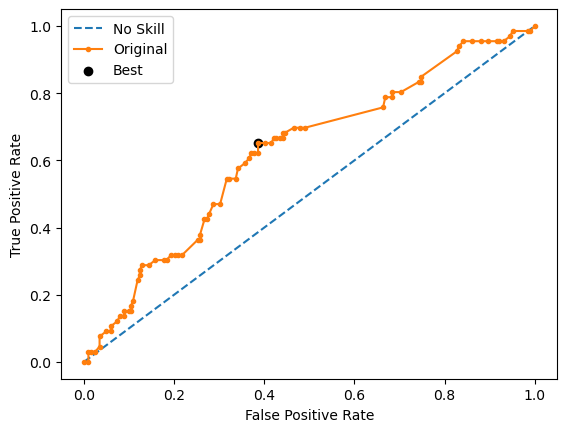

Run 3 - Random State: 2
Test G-mean: 0.5872686680292462
Best Threshold=0.533153, G-Mean=0.587


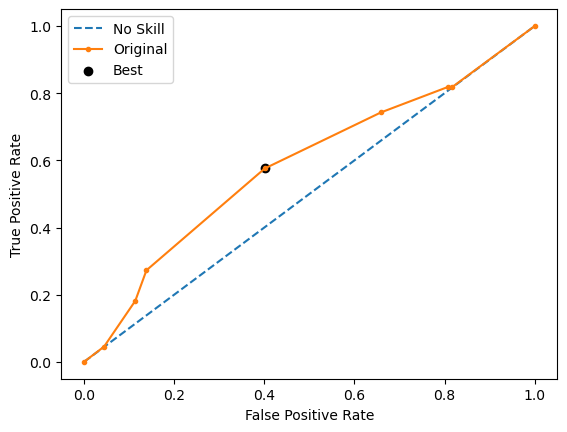

Run 4 - Random State: 3
Test G-mean: 0.6474117037800746
Best Threshold=0.503032, G-Mean=0.663


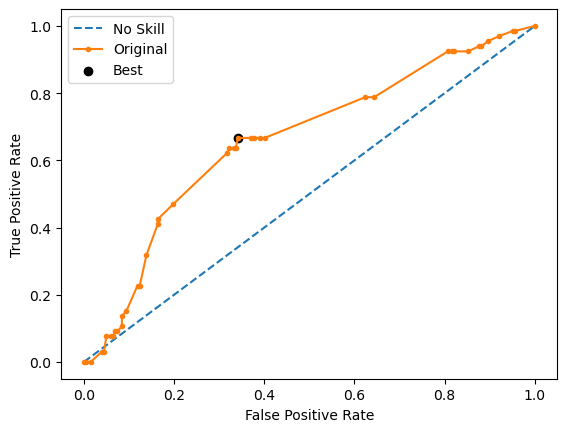

Run 5 - Random State: 4
Test G-mean: 0.6124030566141673
Best Threshold=0.500422, G-Mean=0.616


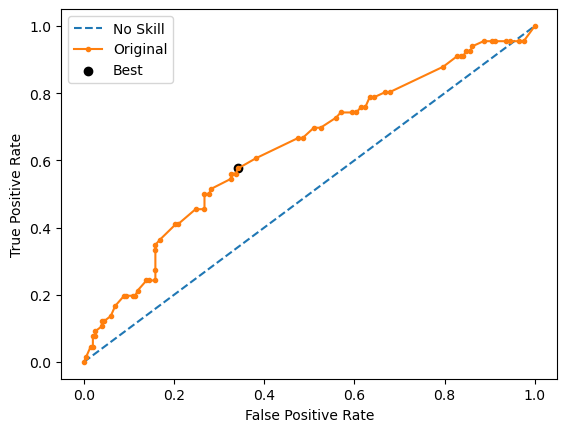

Ave Test G-mean: 0.6258645414318889
Stdev Test G-mean: 0.02801359494945503
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.6333333333333333
Ave Test NPV: 0.8377462055684683
Ave Test Accuracy: 0.6223880597014925
Ave Test Precision: 0.3520677722666008
Ave Test F1-Score: 0.4524928761366155
Ave Runtime: 0.36489238739013674


In [285]:
ho_t08_lgbm_gs, ho_t08_lgbm_be, ho_t08_lgbm_model_info, ho_t08_lgbm_metrics_df = lgbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
Best Hyperparameters: {'classifier__algorithm': 'SAMME', 'classifier__estimator': RandomForestClassifier(random_state=0), 'classifier__n_estimators': 200, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.5684631509057696
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 AdaBoostClassifier(algorithm='SAMME',
                                    estimator=RandomForestClassifier(random_state=0),
                                    n_estimators=200, random_state=0))])
Mean Train Score (G-mean) 0.9439618467435441
Std Train Score (G-mean) 0.004924049647730128
GridSearchCV Runtime: 10.690007209777832 secs
Run 1 - Random State: 0
Test G-mean: 0.6150307523064422
Best Threshold=0.731059, G-Mean=0.615


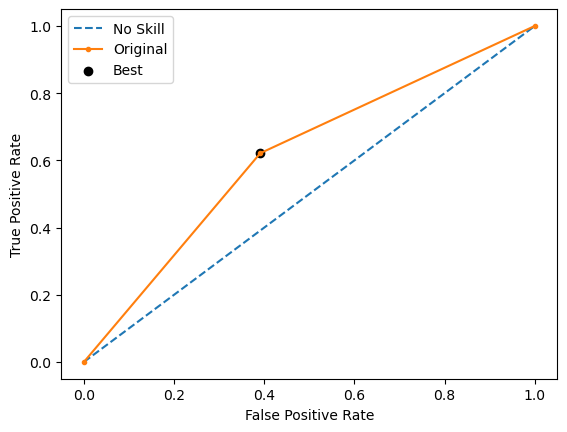

Run 2 - Random State: 1
Test G-mean: 0.5866297072611855
Best Threshold=0.731059, G-Mean=0.587


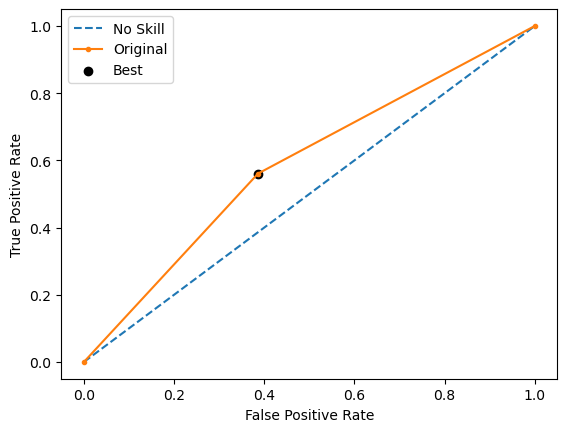

Run 3 - Random State: 2
Test G-mean: 0.5705546014671388
Best Threshold=0.731059, G-Mean=0.571


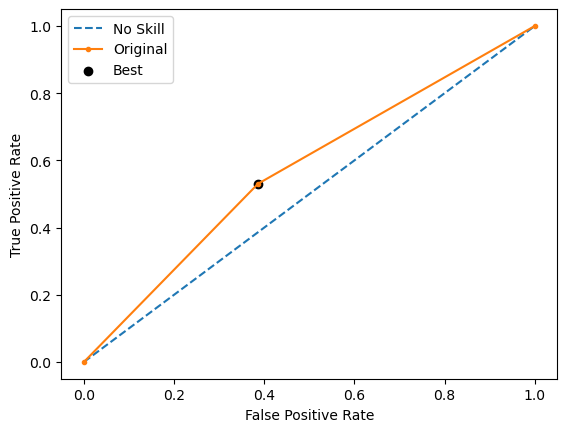

Run 4 - Random State: 3
Test G-mean: 0.5945042838654349
Best Threshold=0.731059, G-Mean=0.595


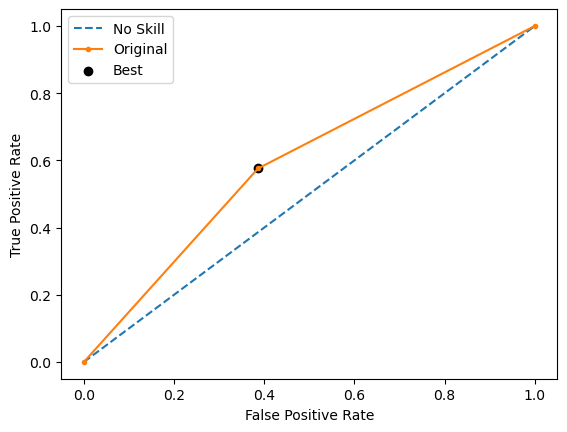

Run 5 - Random State: 4
Test G-mean: 0.5841952827718153
Best Threshold=0.731059, G-Mean=0.584


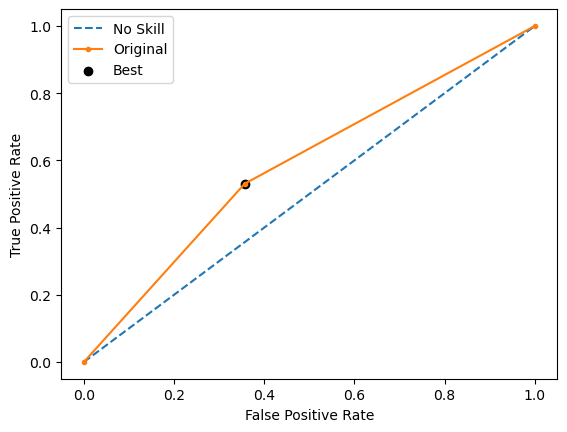

Ave Test G-mean: 0.5901829255344033
Stdev Test G-mean: 0.01635418115312937
Ave Test Specificity: 0.6188118811881188
Ave Test Recall: 0.5636363636363636
Ave Test NPV: 0.812956297450846
Ave Test Accuracy: 0.6052238805970149
Ave Test Precision: 0.325565864202131
Ave Test F1-Score: 0.41259362832246393
Ave Runtime: 0.24993081092834474


In [286]:
ho_t08_adaboost_gs, ho_t08_adaboost_be, ho_t08_adaboost_model_info, ho_t08_adaboost_metrics_df = adaboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 80 candidates, totalling 800 fits
Best Hyperparameters: {'classifier__learning_rate': 0.1, 'classifier__max_depth': 2, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 250, 'resampling': EditedNearestNeighbours()}
Best Validation Score (G-mean): 0.5554183683577887
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 GradientBoostingClassifier(max_depth=2, min_samples_leaf=3,
                                            n_estimators=250,
                                            random_state=0))])
Mean Train Score (G-mean) 0.8739859712005135
Std Train Score (G-mean) 0.010264201605379183
GridSearchCV Runtime: 95.3643696308136 secs
Run 1 - Random State: 0
Test G-mean: 0.5705546014671388
Best Threshold=0.317432, G-Mean=0.606


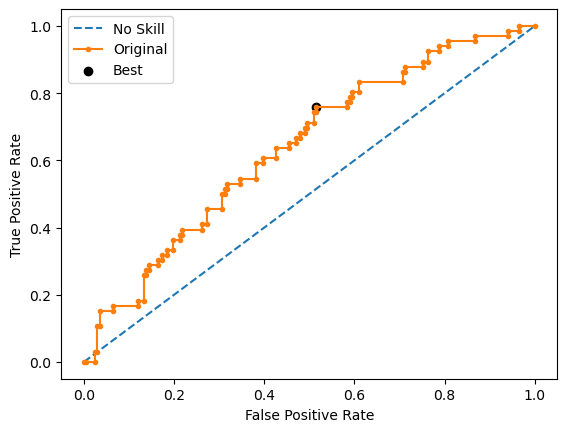

Run 2 - Random State: 1
Test G-mean: 0.5412756210377417
Best Threshold=0.352152, G-Mean=0.557


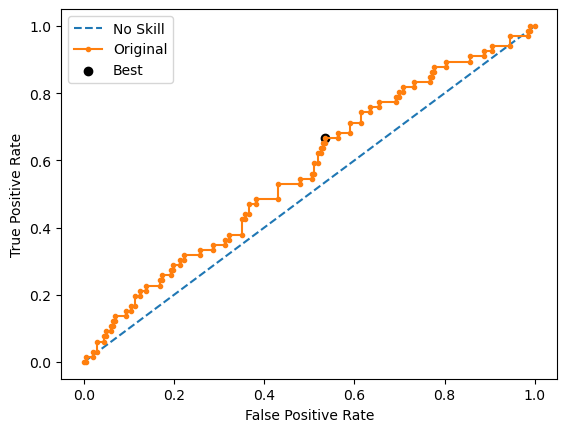

Run 3 - Random State: 2
Test G-mean: 0.5997174051973226
Best Threshold=0.461918, G-Mean=0.606


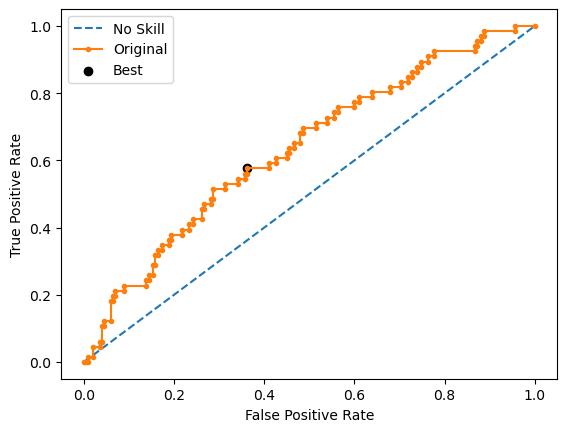

Run 4 - Random State: 3
Test G-mean: 0.5285148368714726
Best Threshold=0.386964, G-Mean=0.562


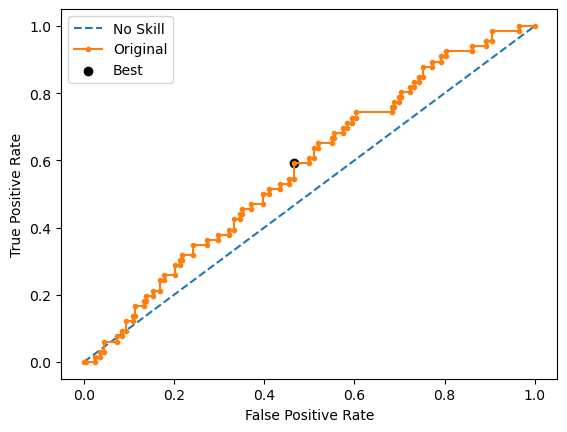

Run 5 - Random State: 4
Test G-mean: 0.5632776652529525
Best Threshold=0.553565, G-Mean=0.575


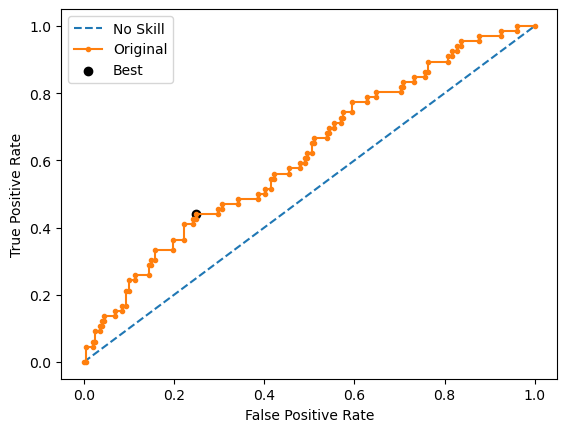

Ave Test G-mean: 0.5606680259653257
Stdev Test G-mean: 0.02756493038513496
Ave Test Specificity: 0.6702970297029702
Ave Test Recall: 0.4696969696969697
Ave Test NPV: 0.7944945666795336
Ave Test Accuracy: 0.6208955223880597
Ave Test Precision: 0.31827661659726403
Ave Test F1-Score: 0.37914584882009894
Ave Runtime: 0.4677495002746582


In [287]:
ho_t08_gbm_gs, ho_t08_gbm_be, ho_t08_gbm_model_info, ho_t08_gbm_metrics_df = gbm_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits
Best Hyperparameters: {'classifier__grow_policy': 'depthwise', 'classifier__learning_rate': 0.01, 'classifier__max_depth': 2, 'classifier__max_leaves': 10, 'classifier__n_estimators': 200, 'resampling': RandomOverSampler(random_state=0)}
Best Validation Score (G-mean): 0.5948596762089723
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 XGBClassifier(base_score=None, booster=None, callbacks=None,
                               colsample_bylevel=None, colsample_bynode=None,
                               colsample_bytree=None,
                               early_stopping_rounds=None,
                               enable_categorical=False, eval_metric=None,
                               feature_types=None, gamma=None, gpu_id=None,
                               grow_policy='depthwise', importance_t

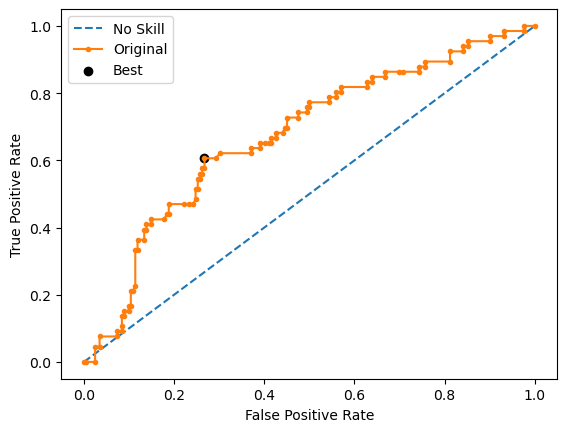

Run 2 - Random State: 1
Test G-mean: 0.5841952827718153
Best Threshold=0.457776, G-Mean=0.616


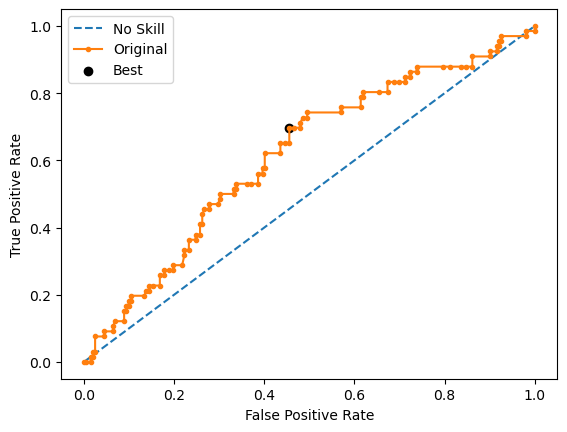

Run 3 - Random State: 2
Test G-mean: 0.6063718072905993
Best Threshold=0.508422, G-Mean=0.616


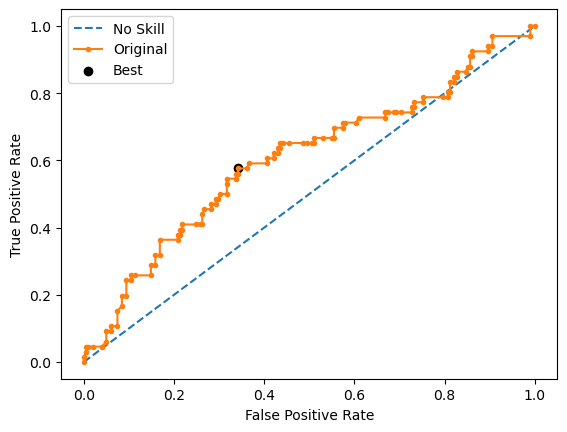

Run 4 - Random State: 3
Test G-mean: 0.644334165361162
Best Threshold=0.497775, G-Mean=0.648


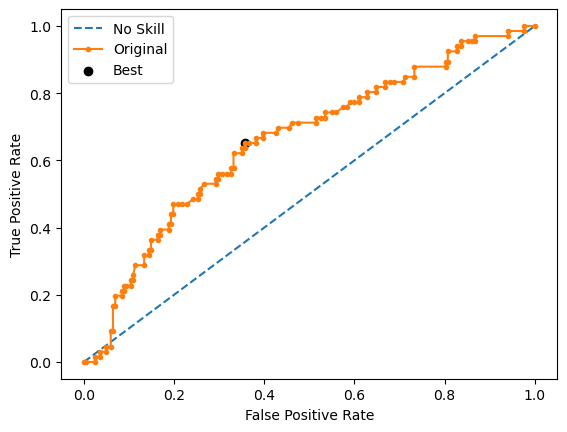

Run 5 - Random State: 4
Test G-mean: 0.6275263970048541
Best Threshold=0.484426, G-Mean=0.635


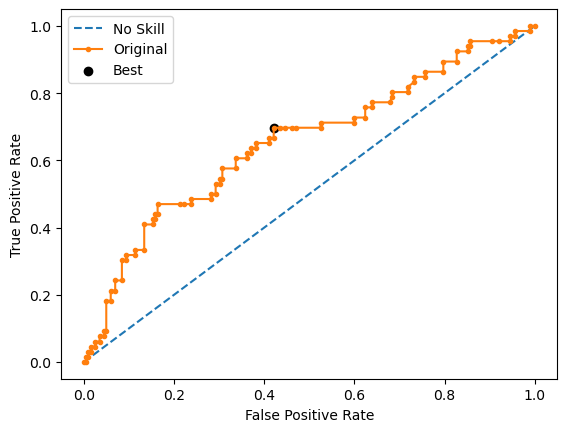

Ave Test G-mean: 0.6218287675230231
Stdev Test G-mean: 0.02652138884785633
Ave Test Specificity: 0.6485148514851485
Ave Test Recall: 0.5969696969696969
Ave Test NPV: 0.8313012276991074
Ave Test Accuracy: 0.6358208955223881
Ave Test Precision: 0.3570387044548672
Ave Test F1-Score: 0.4466619339413196
Ave Runtime: 0.19590449333190918


In [288]:
ho_t08_xgb_gs, ho_t08_xgb_be, ho_t08_xgb_model_info, ho_t08_xgb_metrics_df = xgb_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 5 candidates, totalling 50 fits
Learning rate set to 0.006922
0:	learn: 0.6919902	total: 1.94ms	remaining: 1.93s
1:	learn: 0.6910596	total: 3.72ms	remaining: 1.85s
2:	learn: 0.6904154	total: 5.02ms	remaining: 1.67s
3:	learn: 0.6893298	total: 6.74ms	remaining: 1.68s
4:	learn: 0.6880167	total: 8.41ms	remaining: 1.67s
5:	learn: 0.6868941	total: 10.1ms	remaining: 1.67s
6:	learn: 0.6859046	total: 11.8ms	remaining: 1.67s
7:	learn: 0.6851172	total: 13.5ms	remaining: 1.67s
8:	learn: 0.6846377	total: 15.1ms	remaining: 1.66s
9:	learn: 0.6838396	total: 16.9ms	remaining: 1.67s
10:	learn: 0.6830388	total: 18.6ms	remaining: 1.67s
11:	learn: 0.6817997	total: 20.5ms	remaining: 1.68s
12:	learn: 0.6811250	total: 22.1ms	remaining: 1.68s
13:	learn: 0.6803405	total: 23.6ms	remaining: 1.66s
14:	learn: 0.6795190	total: 25.3ms	remaining: 1.66s
15:	learn: 0.6786109	total: 27ms	remaining: 1.66s
16:	learn: 0.6777963	total: 28.6ms	remaining: 1.66s
17:	learn: 0.6776718	total: 29.4ms	re

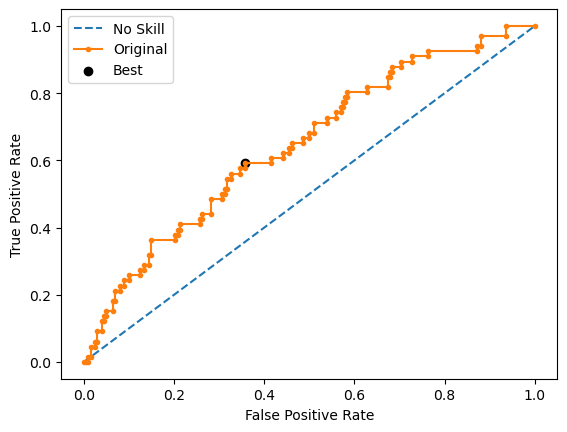

Learning rate set to 0.006922
0:	learn: 0.6914947	total: 2.43ms	remaining: 2.43s
1:	learn: 0.6902797	total: 5.23ms	remaining: 2.61s
2:	learn: 0.6895612	total: 8.84ms	remaining: 2.94s
3:	learn: 0.6881041	total: 12.1ms	remaining: 3s
4:	learn: 0.6871697	total: 15.5ms	remaining: 3.09s
5:	learn: 0.6860296	total: 18.7ms	remaining: 3.09s
6:	learn: 0.6848762	total: 22.1ms	remaining: 3.13s
7:	learn: 0.6838265	total: 24.8ms	remaining: 3.07s
8:	learn: 0.6823009	total: 27.5ms	remaining: 3.02s
9:	learn: 0.6812723	total: 30ms	remaining: 2.97s
10:	learn: 0.6799702	total: 32.4ms	remaining: 2.92s
11:	learn: 0.6782471	total: 35.1ms	remaining: 2.89s
12:	learn: 0.6767136	total: 37.2ms	remaining: 2.82s
13:	learn: 0.6753772	total: 39.3ms	remaining: 2.77s
14:	learn: 0.6740560	total: 41.1ms	remaining: 2.7s
15:	learn: 0.6733935	total: 43ms	remaining: 2.65s
16:	learn: 0.6724746	total: 44.9ms	remaining: 2.6s
17:	learn: 0.6715246	total: 46.9ms	remaining: 2.56s
18:	learn: 0.6703512	total: 48.7ms	remaining: 2.52s
1

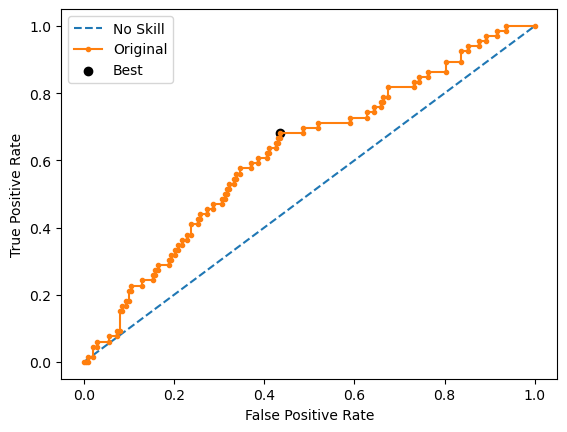

Learning rate set to 0.006922
0:	learn: 0.6916007	total: 2.8ms	remaining: 2.79s
1:	learn: 0.6906099	total: 4.75ms	remaining: 2.37s
2:	learn: 0.6896611	total: 6.39ms	remaining: 2.12s
3:	learn: 0.6885565	total: 8.21ms	remaining: 2.04s
4:	learn: 0.6874643	total: 9.97ms	remaining: 1.98s
5:	learn: 0.6855903	total: 11.6ms	remaining: 1.92s
6:	learn: 0.6845379	total: 14.1ms	remaining: 2s
7:	learn: 0.6830962	total: 16ms	remaining: 1.99s
8:	learn: 0.6819924	total: 17.8ms	remaining: 1.96s
9:	learn: 0.6802917	total: 19.7ms	remaining: 1.95s
10:	learn: 0.6793248	total: 21.3ms	remaining: 1.91s
11:	learn: 0.6779212	total: 23ms	remaining: 1.9s
12:	learn: 0.6760875	total: 24.7ms	remaining: 1.87s
13:	learn: 0.6749760	total: 26.3ms	remaining: 1.85s
14:	learn: 0.6737902	total: 27.8ms	remaining: 1.83s
15:	learn: 0.6727685	total: 29.6ms	remaining: 1.82s
16:	learn: 0.6716598	total: 31.3ms	remaining: 1.81s
17:	learn: 0.6705489	total: 32.8ms	remaining: 1.79s
18:	learn: 0.6692961	total: 34.5ms	remaining: 1.78s
1

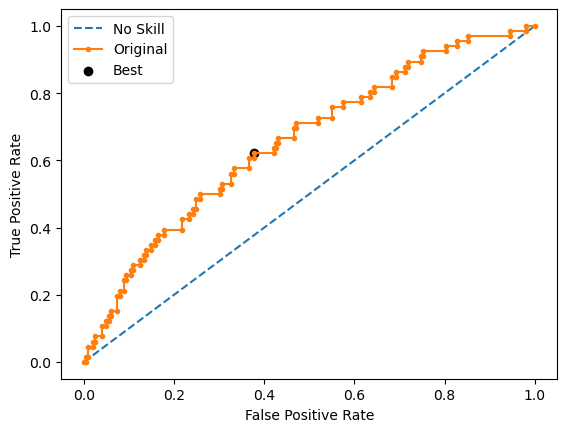

Learning rate set to 0.006922
0:	learn: 0.6921436	total: 2.39ms	remaining: 2.39s
1:	learn: 0.6907547	total: 4.16ms	remaining: 2.07s
2:	learn: 0.6900516	total: 6ms	remaining: 2s
3:	learn: 0.6892551	total: 7.88ms	remaining: 1.96s
4:	learn: 0.6882943	total: 9.63ms	remaining: 1.92s
5:	learn: 0.6872237	total: 11.4ms	remaining: 1.9s
6:	learn: 0.6865761	total: 13ms	remaining: 1.84s
7:	learn: 0.6848859	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6838586	total: 16.3ms	remaining: 1.79s
9:	learn: 0.6831848	total: 17.9ms	remaining: 1.77s
10:	learn: 0.6820082	total: 19.5ms	remaining: 1.76s
11:	learn: 0.6806971	total: 21.2ms	remaining: 1.74s
12:	learn: 0.6795370	total: 22.8ms	remaining: 1.73s
13:	learn: 0.6787919	total: 24.5ms	remaining: 1.73s
14:	learn: 0.6776370	total: 26.1ms	remaining: 1.71s
15:	learn: 0.6763227	total: 27.8ms	remaining: 1.71s
16:	learn: 0.6756414	total: 29.4ms	remaining: 1.7s
17:	learn: 0.6746330	total: 31.1ms	remaining: 1.7s
18:	learn: 0.6734429	total: 32.9ms	remaining: 1.7s
19:	

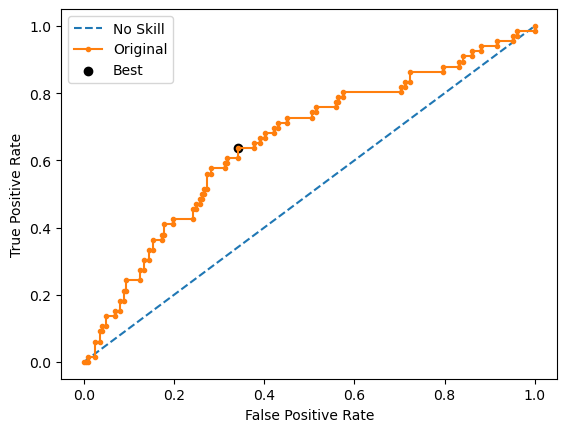

Learning rate set to 0.006922
0:	learn: 0.6914900	total: 2.05ms	remaining: 2.05s
1:	learn: 0.6902983	total: 4.27ms	remaining: 2.13s
2:	learn: 0.6895627	total: 5.91ms	remaining: 1.96s
3:	learn: 0.6890878	total: 7.64ms	remaining: 1.9s
4:	learn: 0.6880513	total: 9.66ms	remaining: 1.92s
5:	learn: 0.6862832	total: 11.2ms	remaining: 1.85s
6:	learn: 0.6854552	total: 12.8ms	remaining: 1.82s
7:	learn: 0.6838742	total: 14.6ms	remaining: 1.81s
8:	learn: 0.6822738	total: 16.2ms	remaining: 1.78s
9:	learn: 0.6812647	total: 17.7ms	remaining: 1.75s
10:	learn: 0.6803056	total: 19.3ms	remaining: 1.74s
11:	learn: 0.6787749	total: 20.9ms	remaining: 1.72s
12:	learn: 0.6771524	total: 22.5ms	remaining: 1.71s
13:	learn: 0.6759314	total: 24.1ms	remaining: 1.7s
14:	learn: 0.6745352	total: 25.7ms	remaining: 1.69s
15:	learn: 0.6733417	total: 27.3ms	remaining: 1.68s
16:	learn: 0.6725769	total: 29.2ms	remaining: 1.69s
17:	learn: 0.6714911	total: 30.8ms	remaining: 1.68s
18:	learn: 0.6702564	total: 32.6ms	remaining: 

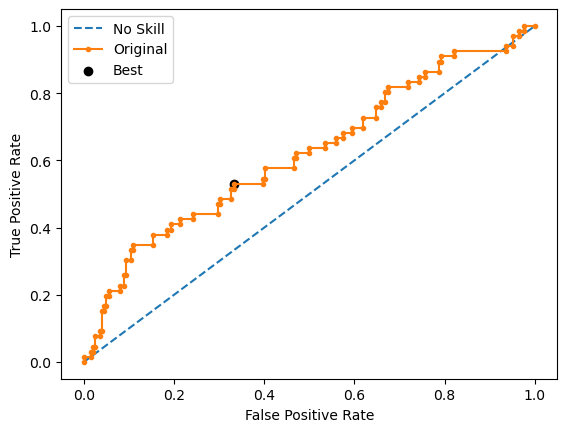

Ave Test G-mean: 0.6129672258498672
Stdev Test G-mean: 0.014948695302344868
Ave Test Specificity: 0.6336633663366337
Ave Test Recall: 0.593939393939394
Ave Test NPV: 0.8271293923959459
Ave Test Accuracy: 0.6238805970149255
Ave Test Precision: 0.3461636342354292
Ave Test F1-Score: 0.43716737663412797
Ave Runtime: 1.8529942512512207


In [289]:
ho_t08_catboost_gs, ho_t08_catboost_be, ho_t08_catboost_model_info, ho_t08_catboost_metrics_df = catboost_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 480 candidates, totalling 4800 fits
Best Hyperparameters: {'classifier__criterion': 'gini', 'classifier__max_depth': 3, 'classifier__min_samples_leaf': 3, 'classifier__min_samples_split': 2, 'classifier__n_estimators': 300, 'classifier__oob_score': True, 'resampling': RandomUnderSampler(random_state=0)}
Best Validation Score (G-mean): 0.6002747134052935
Best Estimator: Pipeline(steps=[('scaler', RobustScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 RandomForestClassifier(max_depth=3, min_samples_leaf=3,
                                        n_estimators=300, oob_score=True,
                                        random_state=0))])
Mean Train Score (G-mean) 0.6277561829255867
Std Train Score (G-mean) 0.01965083989099662
GridSearchCV Runtime: 363.1061005592346 secs
Run 1 - Random State: 0
Test G-mean: 0.6350120660526092
Best Threshold=0.515332, G-Mean=0.652


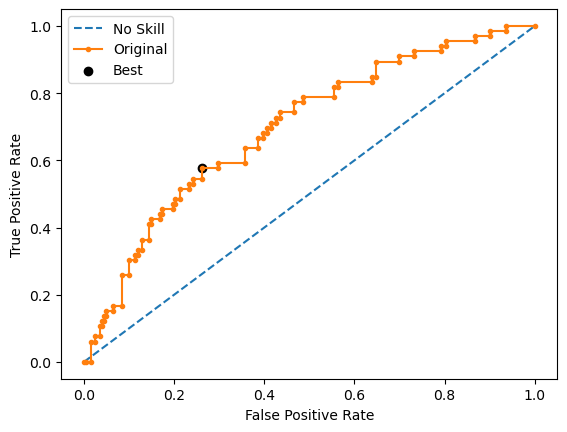

Run 2 - Random State: 1
Test G-mean: 0.5896904047696111
Best Threshold=0.498371, G-Mean=0.603


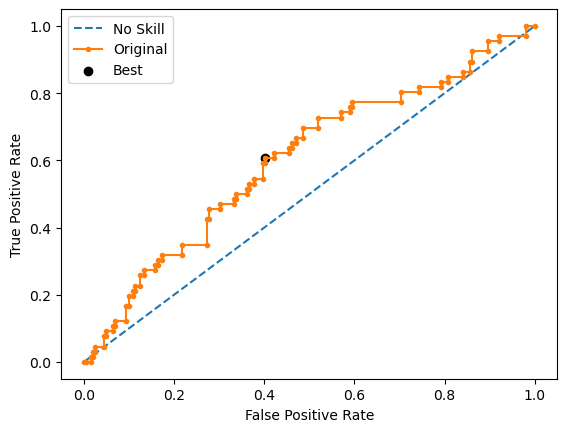

Run 3 - Random State: 2
Test G-mean: 0.5823949848615106
Best Threshold=0.523332, G-Mean=0.628


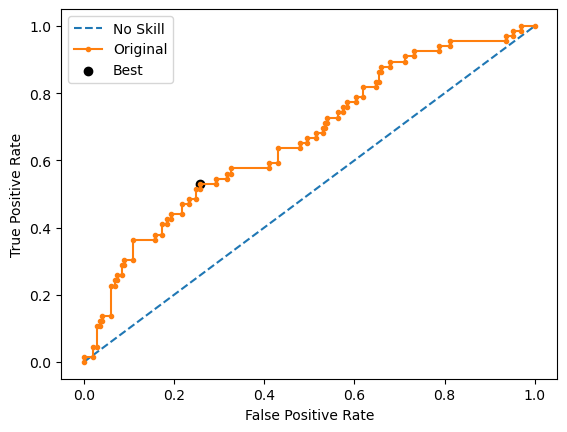

Run 4 - Random State: 3
Test G-mean: 0.659350797639189
Best Threshold=0.495704, G-Mean=0.668


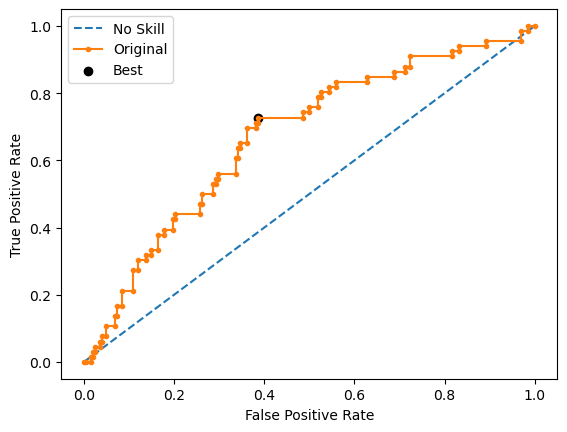

Run 5 - Random State: 4
Test G-mean: 0.5823305855706784
Best Threshold=0.536047, G-Mean=0.611


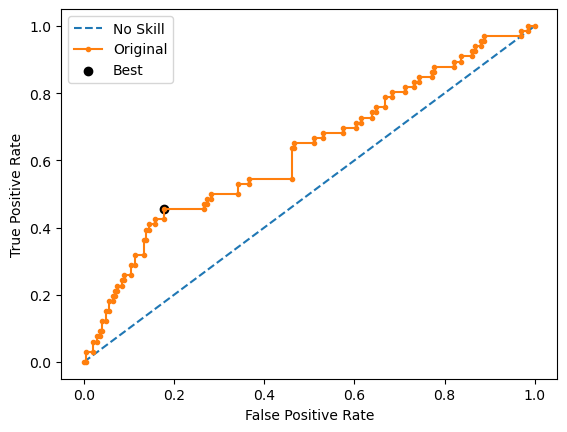

Ave Test G-mean: 0.6097557677787196
Stdev Test G-mean: 0.03535858963192227
Ave Test Specificity: 0.6257425742574257
Ave Test Recall: 0.596969696969697
Ave Test NPV: 0.8267716915172703
Ave Test Accuracy: 0.6186567164179105
Ave Test Precision: 0.3423872649609211
Ave Test F1-Score: 0.43455995572334
Ave Runtime: 0.5589699268341064


In [290]:
ho_t08_rf_gs, ho_t08_rf_be, ho_t08_rf_model_info, ho_t08_rf_metrics_df = rf_class2(ho_t08, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [291]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t08_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t08_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t08_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

,Classifier model,Average Test G-mean,Stdev Test G-mean,Mean Val G-mean,Mean Train G-mean,Average Test Specificity,Average Test Recall
6,LightGBM,0.625865,0.028014,0.596557,0.746088,0.618812,0.633333
7,Extreme Gradient Boosting (XGBoost),0.621829,0.026521,0.594860,0.853936,0.648515,0.596970
3,Decision Tree,0.614960,0.029296,0.596613,0.552078,0.633663,0.600000
4,Random Forest,0.609756,0.035359,0.600275,0.627756,0.625743,0.596970
8,AdaBoost,0.590183,0.016354,0.568463,0.943962,0.618812,0.563636
2,Logistic Regression,0.586591,0.028416,0.607898,NaN,0.626733,0.551515
5,Gradient Boosting Machine (GBM),0.560668,0.027565,0.555418,0.873986,0.670297,0.469697
0,k-Nearest Neighbors,0.518880,0.036668,0.559415,0.686828,0.485149,0.557576
1,SVM Classifier,0.517793,0.028331,0.527184,0.251731,0.590099,0.457576


# HO-T07 Runs: Retain Top 30 Features

In [ ]:
model = ho_t07_logreg_be.named_steps['classifier']
coefficients = model.coef_[0]

# 3. Get Absolute Values of Coefficients
abs_coefficients = abs(coefficients)

# 4. Sort Features Based on Absolute Coefficient Values
sorted_idx = abs_coefficients.argsort()[::-1]
top_20_features = sorted_idx[:20]

# 5. Retain Only the Top 20 Features and Extract the Feature Names
feature_names = list(ho_t07_X_num.columns)  # Assuming X is a DataFrame before train-test split
top_20_feature_names = [feature_names[i] for i in top_20_features]

# Place all dropped features into a list
dropped_features = [feature for feature in feature_names if feature not in top_20_feature_names]

# 6. (Optional) Print the Top 20 Features and Dropped Features
print("Top 20 Features:", top_20_feature_names)
print("Dropped Features:", dropped_features)

sorted_indices = abs_coefficients.argsort()[::-1]
top_20_indices = sorted_indices[:20]
top_20_importances = coefficients[top_20_indices]
# Plot
plt.figure(figsize=(10, 8))
plt.barh(top_20_feature_names, top_20_importances, align='center')
plt.xlabel('Importance')
plt.title('Top 20 Feature Importances from Logistic Regression')
plt.gca().invert_yaxis()  # To display the feature with the highest importance at the top
plt.show()

ho_t08_full = ho_t07_full.copy()
ho_t08_logreg = ho_t08_full.copy().drop(columns=dropped_features).drop(['gender', 'province', 'job'], axis=1)

In [ ]:
ho_t08_logreg_gs, ho_t08_logreg_be, ho_t08_logreg_model_info, ho_t08_logreg_metrics_df = logreg_class2(ho_t08_logreg, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

Fitting 10 folds for each of 1728 candidates, totalling 17280 fits
Best Hyperparameters: {'classifier__criterion': 'entropy', 'classifier__max_depth': 2, 'classifier__max_features': None, 'classifier__min_samples_leaf': 1, 'classifier__min_samples_split': 2, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5861334092522169
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 DecisionTreeClassifier(criterion='entropy', max_depth=2,
                                        random_state=0))])
Mean Train Score (G-mean) 0.5045626356168336
Std Train Score (G-mean) 0.04940561535709203
GridSearchCV Runtime: 45.98888087272644 secs
Run 1 - Random State: 0
Test G-mean: 0.656661815518841
Best Threshold=0.534946, G-Mean=0.657


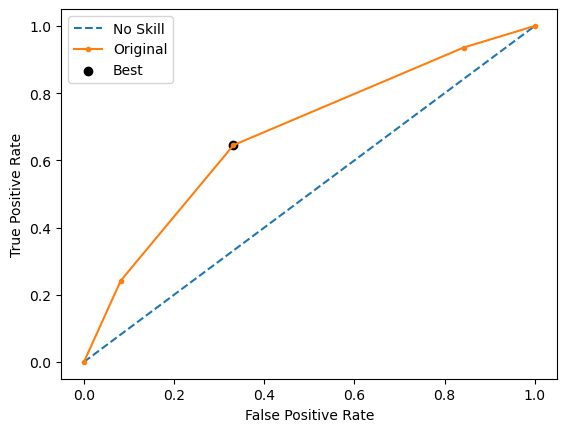

Run 2 - Random State: 1
Test G-mean: 0.6201838798020258
Best Threshold=0.544959, G-Mean=0.620


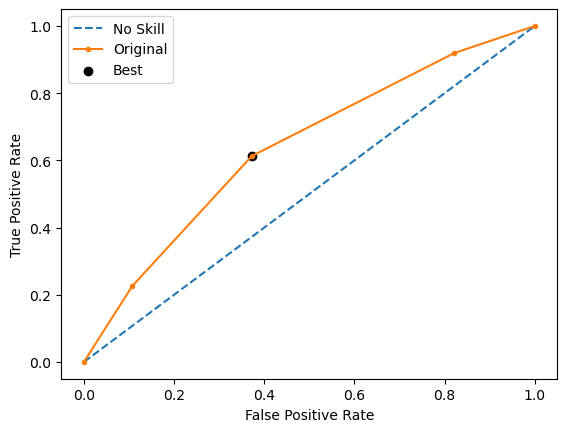

Run 3 - Random State: 2
Test G-mean: 0.6389409646336904
Best Threshold=0.544160, G-Mean=0.639


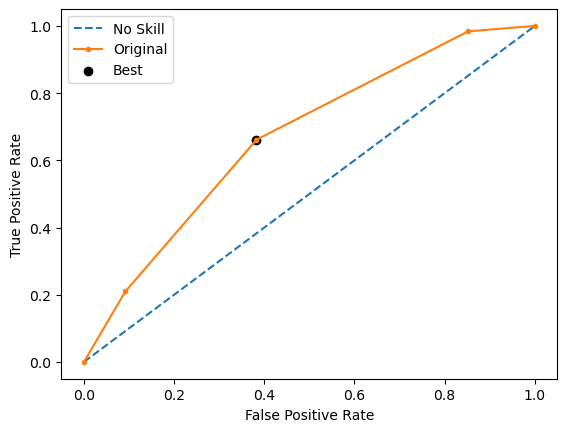

Run 4 - Random State: 3
Test G-mean: 0.5849494838167749
Best Threshold=0.627750, G-Mean=0.598


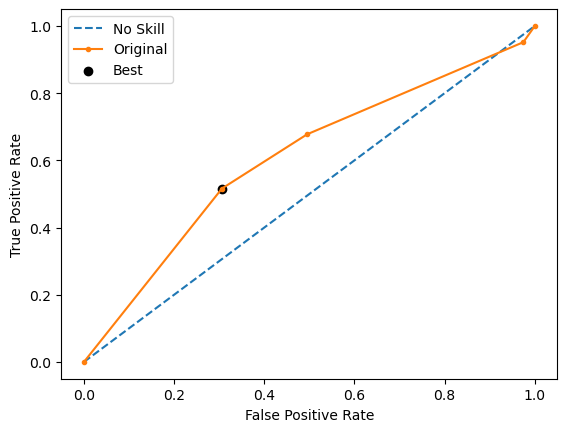

Run 5 - Random State: 4
Test G-mean: 0.5550652506880571
Best Threshold=0.665988, G-Mean=0.578


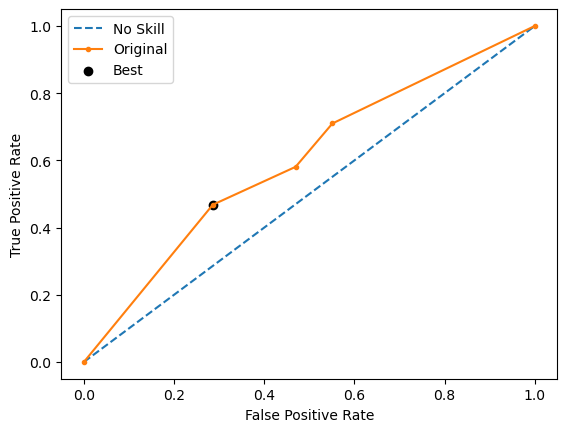

Ave Test G-mean: 0.6111602788918779
Stdev Test G-mean: 0.041101215543893344
Ave Test Specificity: 0.5897959183673469
Ave Test Recall: 0.635483870967742
Ave Test NPV: 0.835397858673986
Ave Test Accuracy: 0.6007751937984496
Ave Test Precision: 0.3320302545076174
Ave Test F1-Score: 0.435176049606957
Ave Runtime: 0.01431121826171875


In [218]:
ho_t06_dt_gs, ho_t06_dt_be, ho_t06_dt_model_info, ho_t06_dt_metrics_df = dt_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 390 candidates, totalling 3900 fits
Best Hyperparameters: {'classifier__C': 0.0001, 'classifier__penalty': 'l2', 'classifier__solver': 'newton-cholesky', 'resampling': RandomUnderSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5511833423722067
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomUnderSampler(random_state=0)),
                ('classifier',
                 LogisticRegression(C=0.0001, max_iter=1000, random_state=0,
                                    solver='newton-cholesky'))])
Mean Train Score (G-mean) nan
Std Train Score (G-mean) nan
GridSearchCV Runtime: 10.8058762550354 secs
Run 1 - Random State: 0
Test G-mean: 0.5659297639246875
Best Threshold=0.499760, G-Mean=0.608



650 fits failed out of a total of 3900.
The score on these train-test partitions for these parameters will be set to nan.
If these failures are not expected, you can try to debug them by setting error_score='raise'.

Below are more details about the failures:
--------------------------------------------------------------------------------
650 fits failed with the following error:
Traceback (most recent call last):
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\model_selection\_validation.py", line 686, in _fit_and_score
    estimator.fit(X_train, y_train, **fit_params)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\imblearn\pipeline.py", line 297, in fit
    self._final_estimator.fit(Xt, yt, **fit_params_last_step)
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\site-packages\sklearn\linear_model\_logistic.py", line 1216, in fit
    self.coef_, self.intercept_, self.n_iter_ = _fit_liblinear(
  File "C:\Users\Carlo\anaconda3\envs\ds_cuda\lib\

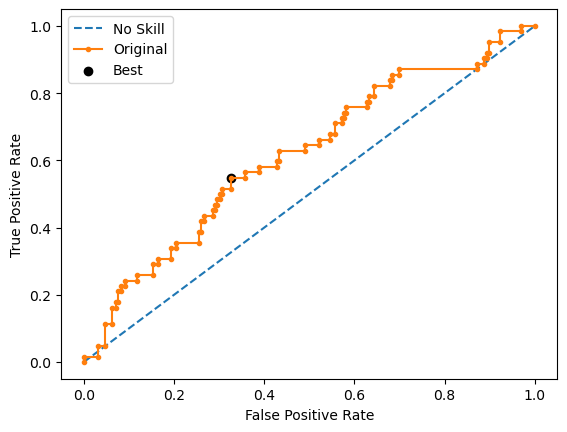

Run 2 - Random State: 1
Test G-mean: 0.5654933702621115
Best Threshold=0.499058, G-Mean=0.611


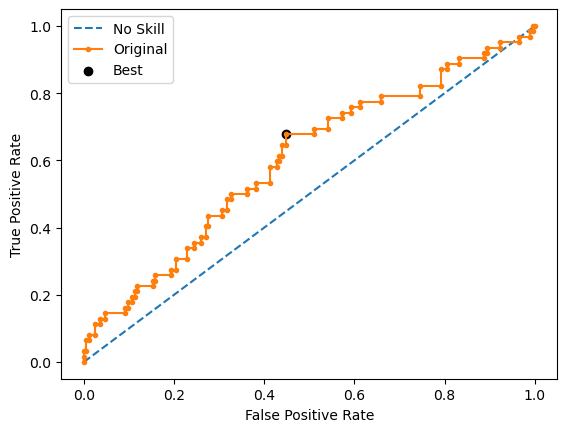

Run 3 - Random State: 2
Test G-mean: 0.5301942953139067
Best Threshold=0.499201, G-Mean=0.573


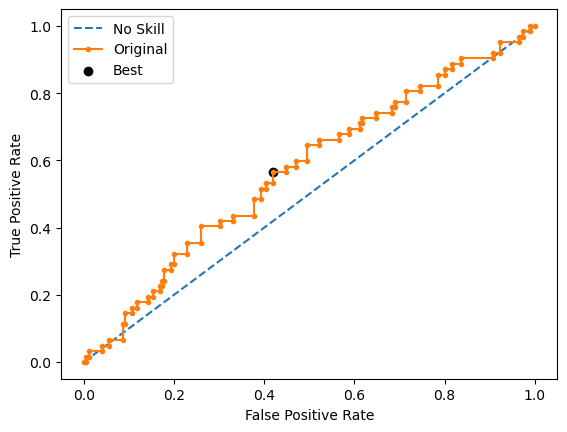

Run 4 - Random State: 3
Test G-mean: 0.5483532112057258
Best Threshold=0.498981, G-Mean=0.594


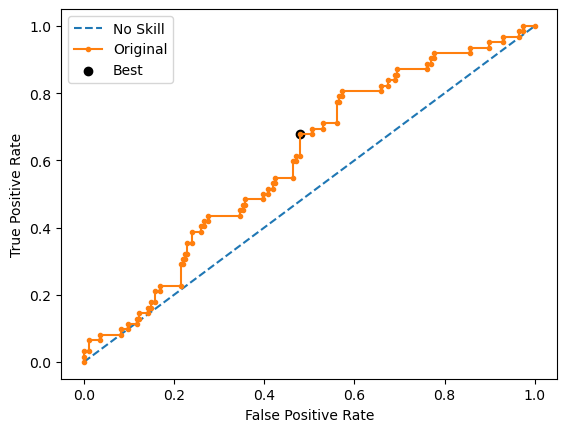

Run 5 - Random State: 4
Test G-mean: 0.5253607807660214
Best Threshold=0.498774, G-Mean=0.565


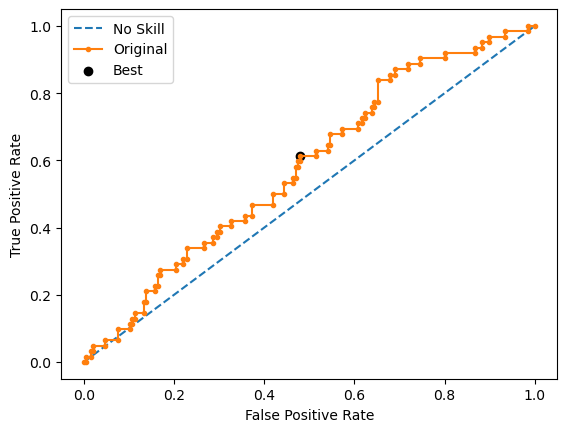

Ave Test G-mean: 0.5470662842944906
Stdev Test G-mean: 0.019058052349841127
Ave Test Specificity: 0.6632653061224489
Ave Test Recall: 0.4516129032258064
Ave Test NPV: 0.7924371423462934
Ave Test Accuracy: 0.6124031007751938
Ave Test Precision: 0.29902041454223616
Ave Test F1-Score: 0.3594466162158999
Ave Runtime: 0.02246723175048828


In [219]:
ho_t06_logreg_gs, ho_t06_logreg_be, ho_t06_logreg_model_info, ho_t06_logreg_metrics_df = logreg_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 520 candidates, totalling 5200 fits
[LibSVM]Best Hyperparameters: {'classifier__C': 1e-06, 'classifier__kernel': 'rbf', 'classifier__probability': True, 'resampling': RandomOverSampler(random_state=0), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5836024379939667
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', RandomOverSampler(random_state=0)),
                ('classifier',
                 SVC(C=1e-06, max_iter=1000, probability=True, random_state=0,
                     verbose=True))])
Mean Train Score (G-mean) 0.5219879195852732
Std Train Score (G-mean) 0.020408923537523802
GridSearchCV Runtime: 95.23027992248535 secs
[LibSVM]Run 1 - Random State: 0
Test G-mean: 0.585792958636764
Best Threshold=0.486451, G-Mean=0.421


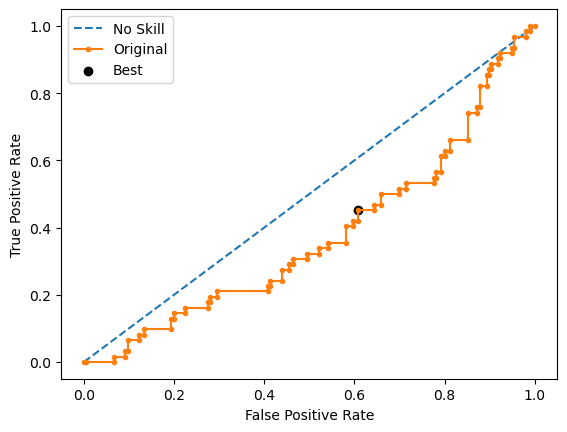

[LibSVM]Run 2 - Random State: 1
Test G-mean: 0.5745880397335743
Best Threshold=0.486451, G-Mean=0.432


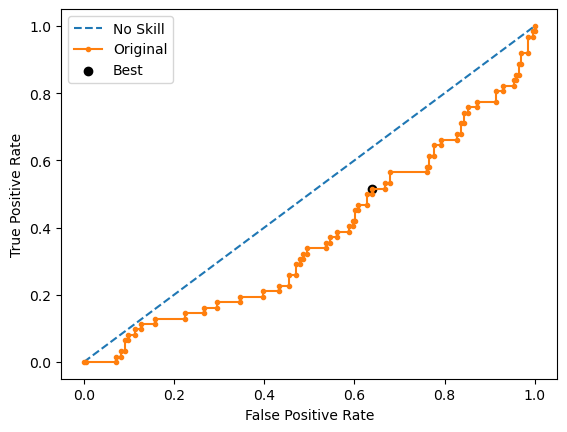

[LibSVM]Run 3 - Random State: 2
Test G-mean: 0.6000192009216492
Best Threshold=0.486451, G-Mean=0.416


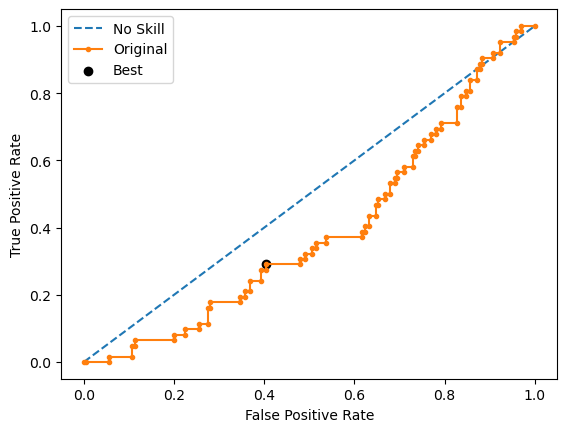

[LibSVM]Run 4 - Random State: 3
Test G-mean: 0.5868455973269637
Best Threshold=0.486451, G-Mean=0.429


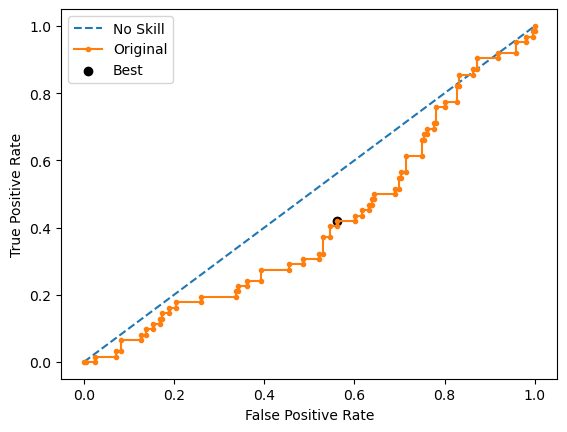

[LibSVM]Run 5 - Random State: 4
Test G-mean: 0.5479028183484553
Best Threshold=0.486451, G-Mean=0.468


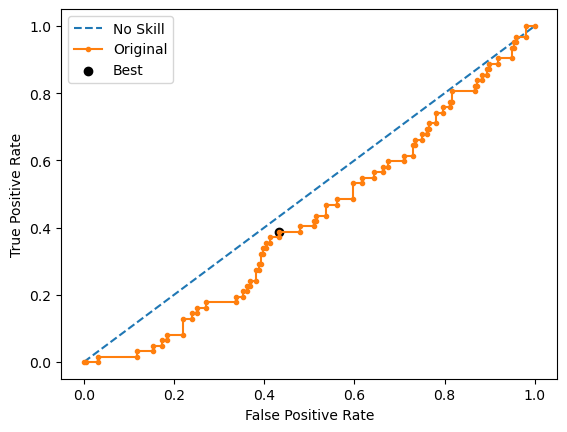

Ave Test G-mean: 0.5790297229934813
Stdev Test G-mean: 0.019595919056159893
Ave Test Specificity: 0.6438775510204081
Ave Test Recall: 0.5225806451612903
Ave Test NPV: 0.8096745549851413
Ave Test Accuracy: 0.6147286821705427
Ave Test Precision: 0.3192491940297407
Ave Test F1-Score: 0.3952779188719943
Ave Runtime: 0.5335601806640625


In [222]:
ho_t06_svm_gs, ho_t06_svm_be, ho_t06_svm_model_info, ho_t06_svm_metrics_df = svm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [223]:
ho_t06_knn_gs, ho_t06_knn_be, ho_t06_knn_model_info, ho_t06_knn_metrics_df = knn_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 600 candidates, totalling 6000 fits
Best Hyperparameters: {'classifier__metric': 'canberra', 'classifier__n_neighbors': 1, 'resampling': EditedNearestNeighbours(), 'scaler': StandardScaler()}
Best Validation Score (G-mean): 0.5619438248924814
Best Estimator: Pipeline(steps=[('scaler', StandardScaler()),
                ('resampling', EditedNearestNeighbours()),
                ('classifier',
                 KNeighborsClassifier(metric='canberra', n_neighbors=1))])
Mean Train Score (G-mean) 0.6926051073868732
Std Train Score (G-mean) 0.01508746870546176
GridSearchCV Runtime: 63.536158084869385 secs
Run 1 - Random State: 0
Test G-mean: 0.5439837932759934
Run 2 - Random State: 1
Test G-mean: 0.5794369699170472
Run 3 - Random State: 2
Test G-mean: 0.47657434604418136
Run 4 - Random State: 3
Test G-mean: 0.509133174976598
Run 5 - Random State: 4
Test G-mean: 0.4968631026001803
Ave Test G-mean: 0.5211982773628001
Stdev Test G-mean: 0.040743059895226606
Ave Test 

In [ ]:
ho_t06_xgb_gs, ho_t06_xgb_be, ho_t06_xgb_model_info, ho_t06_xgb_metrics_df = xgb_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

Fitting 10 folds for each of 540 candidates, totalling 5400 fits


In [ ]:
ho_t06_lgbm_gs, ho_t06_lgbm_be, ho_t06_lgbm_model_info, ho_t06_lgbm_metrics_df = lgbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_adaboost_gs, ho_t06_adaboost_be, ho_t06_adaboost_model_info, ho_t06_adaboost_metrics_df = adaboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_rf_gs, ho_t06_rf_be, ho_t06_rf_model_info, ho_t06_rf_metrics_df = rf_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_gbm_gs, ho_t06_gbm_be, ho_t06_gbm_model_info, ho_t06_gbm_metrics_df = gbm_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t06_catboost_gs, ho_t06_catboost_be, ho_t06_catboost_model_info, ho_t06_catboost_metrics_df = catboost_class2(ho_t06, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t06_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t06_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t06_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# HO-T07 Runs

In [ ]:
ho_t07_dt_gs, ho_t07_dt_be, ho_t07_dt_model_info, ho_t07_dt_metrics_df = dt_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_logreg_gs, ho_t07_logreg_be, ho_t07_logreg_model_info, ho_t07_logreg_metrics_df = logreg_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_svm_gs, ho_t07_svm_be, ho_t07_svm_model_info, ho_t07_svm_metrics_df = svm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_knn_gs, ho_t07_knn_be, ho_t07_knn_model_info, ho_t07_knn_metrics_df = knn_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_xgb_gs, ho_t07_xgb_be, ho_t07_xgb_model_info, ho_t07_xgb_metrics_df = xgb_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_lgbm_gs, ho_t07_lgbm_be, ho_t07_lgbm_model_info, ho_t07_lgbm_metrics_df = lgbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_adaboost_gs, ho_t07_adaboost_be, ho_t07_adaboost_model_info, ho_t07_adaboost_metrics_df = adaboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_rf_gs, ho_t07_rf_be, ho_t07_rf_model_info, ho_t07_rf_metrics_df = rf_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_gbm_gs, ho_t07_gbm_be, ho_t07_gbm_model_info, ho_t07_gbm_metrics_df = gbm_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
ho_t07_catboost_gs, ho_t07_catboost_be, ho_t07_catboost_model_info, ho_t07_catboost_metrics_df = catboost_class2(ho_t07, g_mean_scorer,
                                                            'home_ownership_class', random_state=0)

In [ ]:
model_vars = ['knn', 'svm', 'logreg', 'dt', 'rf', 'gbm', 'lgbm', 'xgb', 'adaboost']
# model_vars = ['dt', 'rf', 'lgbm', 'xgb', 'adaboost']

var_df = {
    'Classifier model': [
        'k-Nearest Neighbors', 'SVM Classifier',
        'Logistic Regression', 'Decision Tree', 'Random Forest',
        'Gradient Boosting Machine (GBM)',
        'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
        'AdaBoost'
    ],
#     'Classifier model': [
#         'Decision Tree', 'Random Forest',
#         'LightGBM', 'Extreme Gradient Boosting (XGBoost)',
#         'AdaBoost'
#     ],
    'Best Hyperparameters': [],
    'Mean Val G-mean': [],
    'Mean Train G-mean': [],
    'Stdev Train G-mean': [],
    'Average Runtime': [],
    'Average Test G-mean': [],
    'Stdev Test G-mean': [],
    'Average Test Specificity': [],
    'Average Test Recall': [],
    'Average Test NPV': [],
    'Average Test Accuracy': [],
    'Average Test Precision': [],
    'Average Test F1-score': [],
}

prefix = 'ho_t07_'
for name in model_vars:
    var_df['Best Hyperparameters'].append(globals()[prefix+name+'_model_info']['best_params'])
    var_df['Mean Val G-mean'].append(globals()[prefix+name+'_model_info']['best_cv_score'])
    var_df['Mean Train G-mean'].append(globals()[prefix+name+'_model_info']['mean_train_score'])
    var_df['Stdev Train G-mean'].append(globals()[prefix+name+'_model_info']['std_train_score'])
    var_df['Average Runtime'].append(globals()[prefix+name+'_model_info']['average_runtime'])
    var_df['Average Test G-mean'].append(globals()[prefix+name+'_model_info']['average_test_g_mean'])
    var_df['Stdev Test G-mean'].append(globals()[prefix+name+'_model_info']['stdev_test_g_mean'])
    var_df['Average Test Specificity'].append(globals()[prefix+name+'_model_info']['average_test_specificity'])
    var_df['Average Test Recall'].append(globals()[prefix+name+'_model_info']['average_test_recall'])
    var_df['Average Test NPV'].append(globals()[prefix+name+'_model_info']['average_test_npv'])
    var_df['Average Test Accuracy'].append(globals()[prefix+name+'_model_info']['average_test_accuracy'])
    var_df['Average Test Precision'].append(globals()[prefix+name+'_model_info']['average_test_precision'])
    var_df['Average Test F1-score'].append(globals()[prefix+name+'_model_info']['average_test_f1_score'])

# display(ho_t02_model_summ)
ho_t07_summ = pd.DataFrame(var_df)

# columns_to_exclude = ['Best Hyperparameters', 'Average Runtime']


# selected_columns = [col for col in ho_t1__summ.columns if col not in columns_to_exclude]
# ho_t1__summ[selected_columns]

ho_t07_summ[[
    'Classifier model', 'Average Test G-mean',
    'Stdev Test G-mean', 'Mean Val G-mean',
    'Mean Train G-mean', 'Average Test Specificity',
    'Average Test Recall'
]].sort_values(by='Average Test G-mean', ascending=False)

# Best Model Explainability Methods

In [301]:
from sklearn.tree import plot_tree
import matplotlib.pyplot as plt

# Access the trained Random Forest model from the dictionary
model = ho_t02_xgb_be.named_steps.classifier

# Ensure the model has been trained
if hasattr(model, "estimators_"):
    # Visualize the first tree
    plt.figure(figsize=(20, 10))
    plot_tree(model.estimators_[0], filled=True, feature_names=X_train.columns, class_names=True, rounded=True)
    plt.show()
else:
    print("The model hasn't been trained yet.")

The model hasn't been trained yet.


In [302]:
from sklearn.tree import _tree

def tree_rules(tree, feature_names):
    tree_ = tree.tree_
    feature_name = [
        feature_names[i] if i != _tree.TREE_UNDEFINED else "undefined!"
        for i in tree_.feature
    ]

    def recurse(node, depth):
        indent = "  " * depth
        if tree_.feature[node] != _tree.TREE_UNDEFINED:
            name = feature_name[node]
            threshold = tree_.threshold[node]
            yield f"{indent}if {name} <= {threshold:.2f}:"
            yield from recurse(tree_.children_left[node], depth + 1)
            yield f"{indent}else:  # if {name} > {threshold:.2f}"
            yield from recurse(tree_.children_right[node], depth + 1)
        else:
            yield f"{indent}return Class {tree_.value[node].argmax()}"

    return "\n".join(recurse(0, 1))

In [303]:
model = ho_t02_xgb_be.named_steps.classifier
rules = tree_rules(model.estimators_[0], X_train.columns)
print(rules)

AttributeError: 'XGBClassifier' object has no attribute 'estimators_'

In [304]:
from xgboost import plot_tree

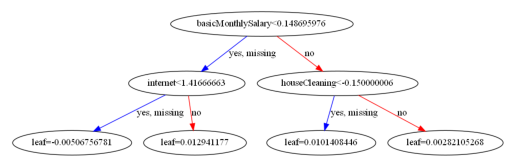

In [313]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)

model.named_steps['classifier'].get_booster().feature_names = X.columns.to_list()

plot_tree(model.named_steps['classifier'],
          rank_dir='LR'); plt.show()

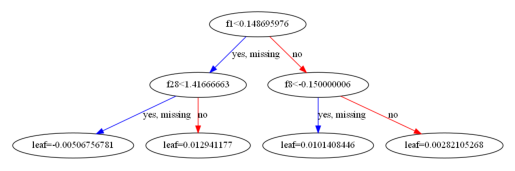

In [118]:
# model.named_steps['classifier'].feature_importances_

Permutation explainer: 269it [00:13,  4.83it/s]                         


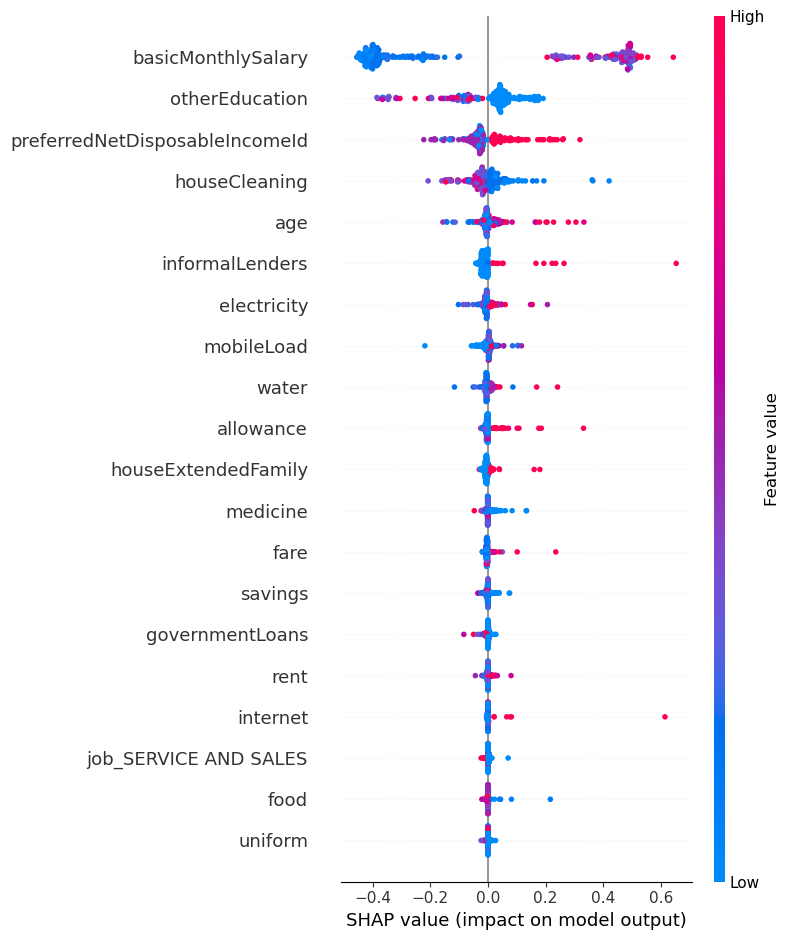

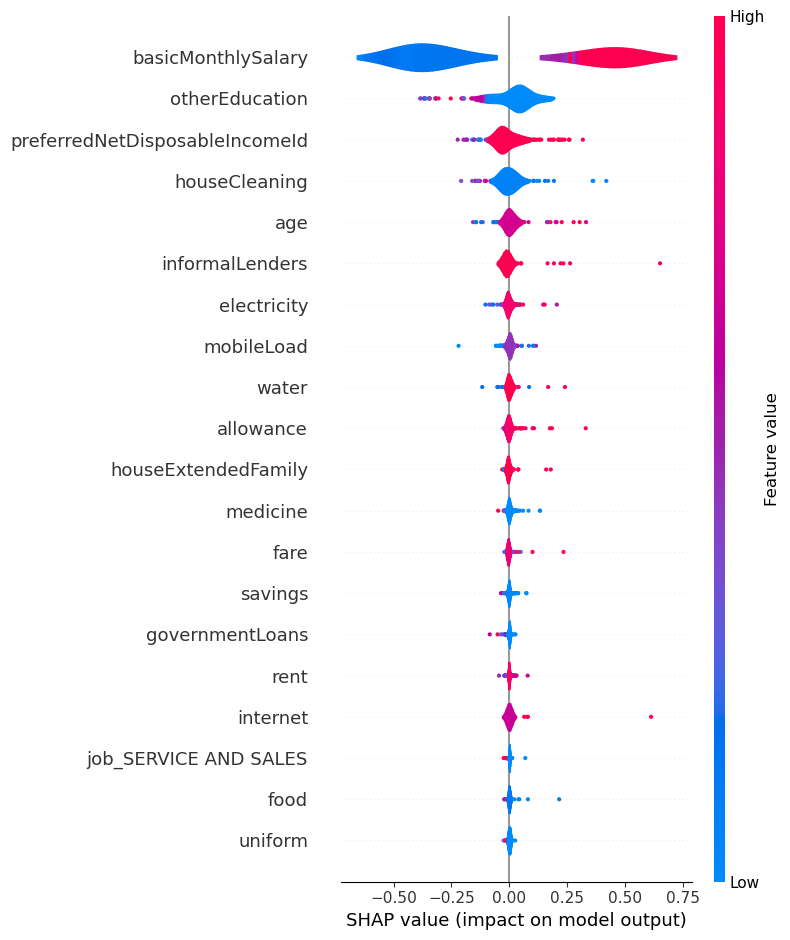

In [325]:
df = ho_t02
# model = ho_t02_xgb_be.named_steps['classifier']
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)
# explainer = shap.TreeExplainer(model=model,
#                                data=X_test,
#                                model_output='raw',
# #                                feature_perturbation='tree_path_dependent'
#                               )

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)
# shap_values = explainer.shap_values(X_test)


feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

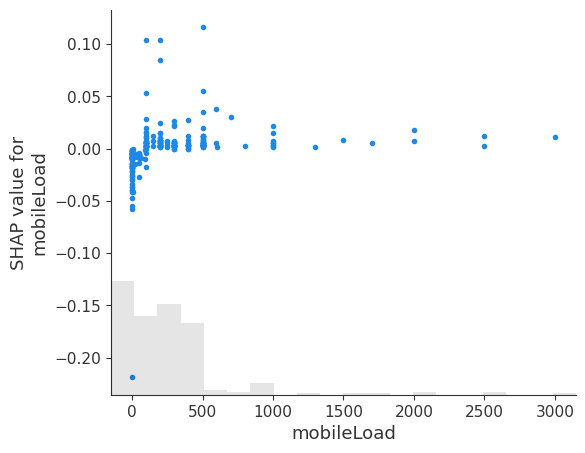

In [354]:
feature_name = 'mobileLoad' # Replace with the name of the feature you're interested in

shap.plots.scatter(shap_values[:, feature_name])
plt.show()

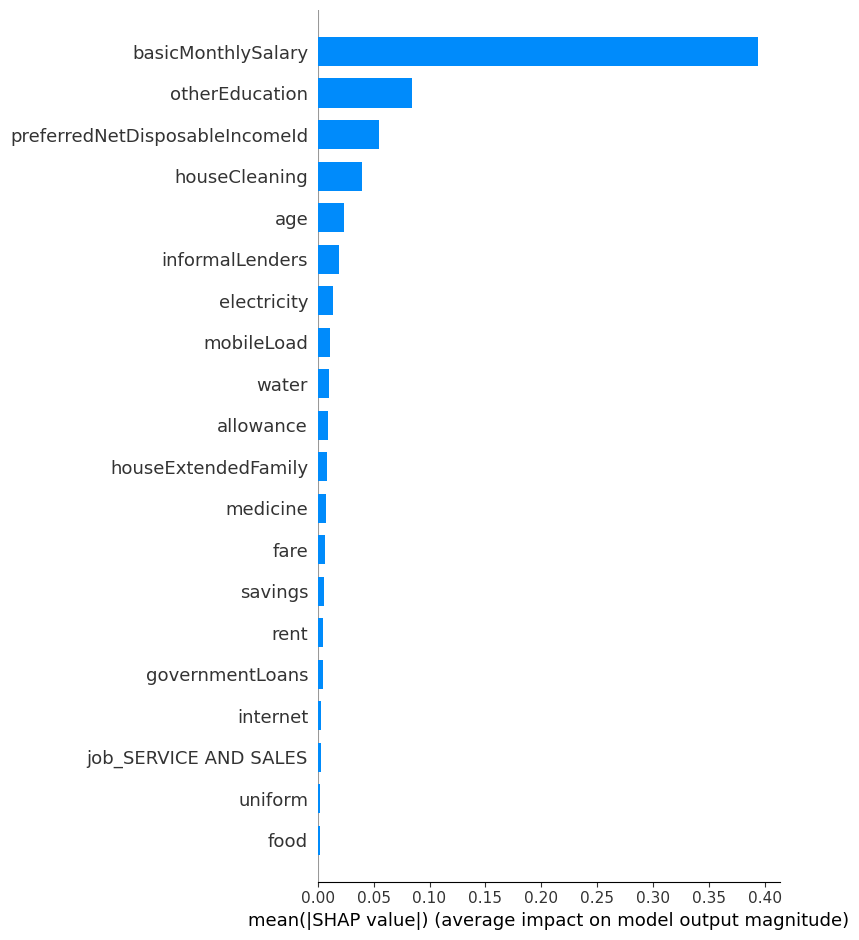

In [315]:
shap.summary_plot(shap_values, feature_names=feature_names,
                  plot_type='bar')

Permutation explainer: 269it [00:13,  4.92it/s]                         


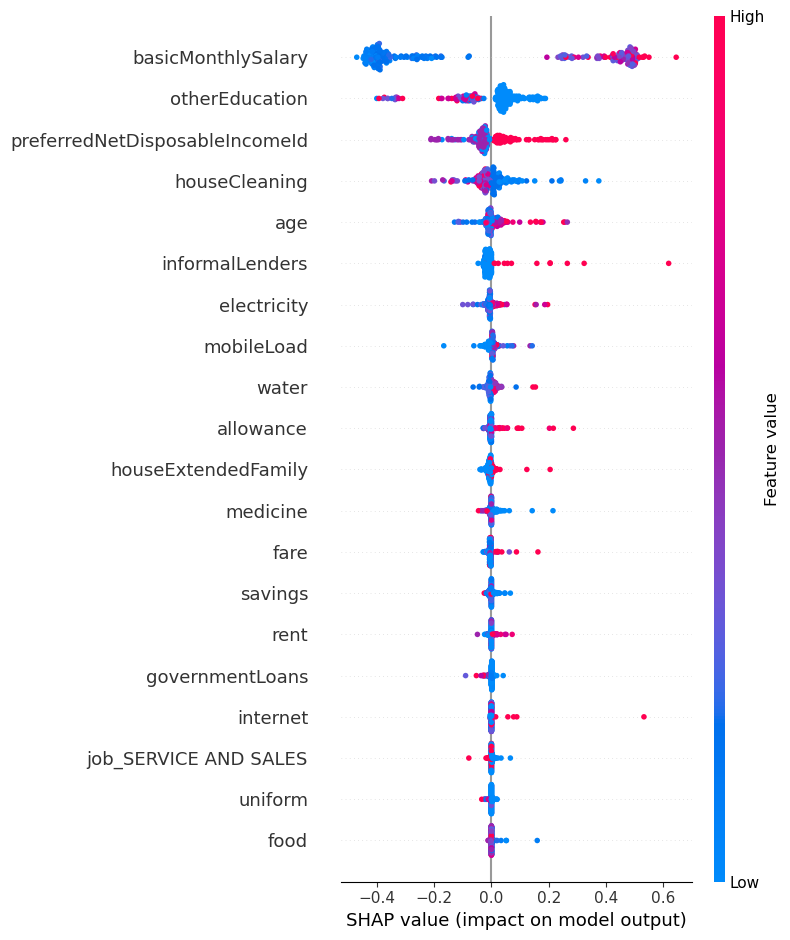

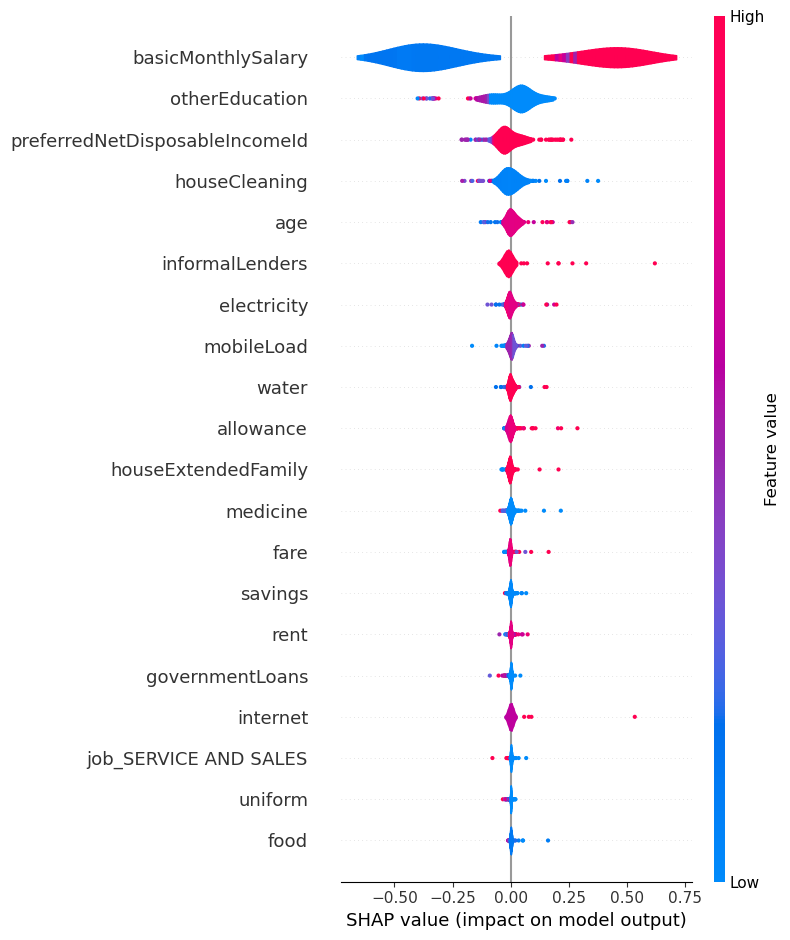

In [296]:
df = ho_t02
model = ho_t02_xgb_be
label_col = 'home_ownership_class'
X = df.drop(['userId', 'lastFirstName', label_col], axis=1)
y = df.loc[:, label_col]
X_train, X_test, y_train, y_test = train_test_split(X, y,
                                                    test_size=0.25,
                                                    stratify=y,
                                                    random_state=0)

# input = ho_t12_adaboost_c0.drop(['user_id', 'lastFirstName', 'home_ownership_class'], axis=1)
# Fits the explainer
explainer = shap.Explainer(model.predict, X_test)

# Calculates the SHAP values - It takes some time
shap_values = explainer(X_test)

feature_names = X.columns

shap.summary_plot(shap_values, feature_names=feature_names, plot_type='dot')
shap.summary_plot(shap_values, feature_names=feature_names, plot_type='violin')

In [47]:
def adjust_data_types(df):
    for col in df.columns:
        unique_vals = df[col].unique()
        if df[col].dtypes == 'object':
            None
#         elif (set(unique_vals) == {0, 1}) or col == 'userId':
#             df[col] = df[col].astype('int64')
#         else:
#             df[col] = df[col].astype('float64')
        elif (set(unique_vals) != {0, 1}):
            df[col] = df[col].astype('float64')
        else:
            df[col] = df[col].astype('int64')
    return df

In [355]:
ho_t02
df = ho_t02.copy()
df['userId'] = df['userId'].astype('str')
df = adjust_data_types(df)

# ho_t03_dice['gender_MALE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_CAVITE'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['province_METRO MANILA'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_ASSOCIATE PROFESSIONAL'] = ho_t03_dice['userId'].astype('str')
# ho_t03_dice['job_SERVICE AND SALES'] = ho_t03_dice['userId'].astype('str')
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1070 entries, 0 to 1069
Data columns (total 55 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   userId                          1070 non-null   object 
 1   lastFirstName                   1070 non-null   object 
 2   age                             1070 non-null   float64
 3   basicMonthlySalary              1070 non-null   float64
 4   preferredNetDisposableIncomeId  1070 non-null   float64
 5   workingFamilyCount              1070 non-null   float64
 6   residentsCount                  1070 non-null   float64
 7   monthlyFamilyIncome             1070 non-null   float64
 8   food                            1070 non-null   float64
 9   hygiene                         1070 non-null   float64
 10  houseCleaning                   1070 non-null   float64
 11  fare                            1070 non-null   float64
 12  parking                         10

In [359]:
items_list = [
    'food', 'hygiene', 'houseCleaning',
    'fare', 'parking', 'gasoline', 'tuition', 'allowance',
    'uniform', 'otherEducation', 'emergency', 'medicine',
    'water', 'electricity', 'rent', 'repair', 
    'dineOut', 'leisure', 'personalCare', 'clothing',
    'mobileLoad', 'internet', 
    'smoking', 'gambling',
]

result_dict = {}
for item in items_list:
    result_dict[item] = [0, query_instance[item].values[0]]

print(result_dict)

{'food': [0, 3000.0], 'hygiene': [0, 1000.0], 'houseCleaning': [0, 1000.0], 'fare': [0, 2000.0], 'parking': [0, 0.0], 'gasoline': [0, 0.0], 'tuition': [0, 0.0], 'allowance': [0, 0.0], 'uniform': [0, 0.0], 'otherEducation': [0, 0.0], 'emergency': [0, 1000.0], 'medicine': [0, 1000.0], 'water': [0, 500.0], 'electricity': [0, 1500.0], 'rent': [0, 500.0], 'repair': [0, 0.0], 'dineOut': [0, 0.0], 'leisure': [0, 0.0], 'personalCare': [0, 0.0], 'clothing': [0, 1000.0], 'mobileLoad': [0, 2000.0], 'internet': [0, 0.0], 'smoking': [0, 0.0], 'gambling': [0, 0.0]}


In [419]:
df = df
model = ho_t02_xgb_be


X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
# exp = dice_ml.Dice(d, m, method='genetic')
exp = dice_ml.Dice(d, m)

In [421]:
max_limit = len(X_test[X_test['home_ownership_class'] == 0])

init = 40
for i in range(init, max_limit):
    try:
        # Generate counterfactual examples
        query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
        dice_exp = exp.generate_counterfactuals(
            query_instance, total_CFs=1,
            desired_class="opposite", verbose=True,
           features_to_vary=[
                'food', 'hygiene', 'houseCleaning',
                'fare', 'parking', 'gasoline', 'tuition', 'allowance',
                'uniform', 'otherEducation', 'emergency', 'medicine',
                'water', 'electricity', 'rent', 'repair', 
                'dineOut', 'leisure', 'personalCare', 'clothing',
                'mobileLoad', 'internet', 
                'smoking', 'gambling', 'savings', 'payFamilySupport'
            ],
            permitted_range=result_dict
        )
        # Visualize counterfactual explanation
        dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                        show_only_changes=True)
        break
    except Exception as e:
        print(f"Error at i={i}: {e}")
        continue


100%|██████████| 1/1 [00:01<00:00,  1.20s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=40: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:01<00:00,  1.22s/it]


No Counterfactuals found for the given configuration, perhaps try with different parameters... ; total time taken: 00 min 01 sec
Error at i=41: No counterfactuals found for any of the query points! Kindly check your configuration.


100%|██████████| 1/1 [00:00<00:00,  2.66it/s]

Diverse Counterfactuals found! total time taken: 00 min 00 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1,1,1,1,0,1,0,1,0,0,0,0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0.0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,159.3,-,-,-,-,-,-,95.9,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,-,0.0


In [422]:
df = df
model = ho_t02_xgb_be
i = 42

X = df.drop(['userId', 'lastFirstName'], axis=1)
y = df.loc[:, label_col]
X_train, X_test, _, _ = train_test_split(X, y,
                                         test_size=0.25,
                                         stratify=y,
                                         random_state=0)

X_train
# Dataset for training an ML model
d = dice_ml.Data(dataframe=X_train,
                 continuous_features=X_train.drop(columns='home_ownership_class').columns.to_list(),
                 outcome_name='home_ownership_class')

# Pre-trained ML model
m = dice_ml.Model(model=model, backend='sklearn')
#                   backend='TF2', func="ohe-min-max")
# DiCE explanation instance
exp = dice_ml.Dice(d, m, method='genetic')
# exp = dice_ml.Dice(d, m)


# Generate counterfactual examples
query_instance = X_test[X_test['home_ownership_class'] == 0].drop(columns="home_ownership_class")[i:i+1]
dice_exp = exp.generate_counterfactuals(
    query_instance, total_CFs=30,
    desired_class="opposite", verbose=True,
   features_to_vary=[
        'food', 'hygiene', 'houseCleaning',
        'fare', 'parking', 'gasoline', 'tuition', 'allowance',
        'uniform', 'otherEducation', 'emergency', 'medicine',
        'water', 'electricity', 'rent', 'repair', 
        'dineOut', 'leisure', 'personalCare', 'clothing',
        'mobileLoad', 'internet', 
        'smoking', 'gambling', 'savings', 'payFamilySupport'
    ],
    permitted_range=result_dict
)

# Visualize counterfactual explanation
dice_exp.visualize_as_dataframe(display_sparse_df=False,
                                show_only_changes=True)

  0%|          | 0/1 [00:00<?, ?it/s]

Initializing initial parameters to the genetic algorithm...
Initialization complete! Generating counterfactuals...


100%|██████████| 1/1 [00:16<00:00, 16.78s/it]

Only 16 (required 30)  Diverse Counterfactuals found for the given configuation, perhaps  change the query instance or the features to vary...; total time taken: 00 min 16 sec
Query instance (original outcome : 1)


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,38.0,31000.0,2.0,1.0,4.0,31000.0,4000.0,1000.0,1000.0,2000.0,0.0,0.0,0.0,1000.0,500.0,0.0,2000.0,1000.0,1000.0,500.0,0.0,0.0,0.0,0.0,0.0,500.0,0.0,500.0,500.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,2000.0,1.0,1.0,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,1



Diverse Counterfactual set without sparsity correction (new outcome:  0


,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES,home_ownership_class
0,-,-,-,-,-,-,331.6,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,3000.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,-,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,0.0,-,300.0,0.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,3000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,0.0,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,500.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,30.6,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,-,500.0,-,-,-,-,-,-,0.0,300.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1799.1,-,-,0.0,-,-,-,0.0,0.0,-,1000.0,500.0,300.0,400.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,-,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1282.3,-,-,-,-,-,-,0.0,0.0,-,1000.0,-,500.0,1000.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,2450.2,-,-,-,-,-,-,0.0,0.0,-,496.0,-,300.0,750.0,-,-,-,-,-,0.0,500.0,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,1982.1,-,-,1000.0,-,-,-,0.0,0.0,-,500.0,500.0,350.0,1000.0,-,-,-,-,-,0.0,-,50.0,0.0,-,-,-,-,-,-,-,-,-,-,5000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0
0,-,-,-,-,-,-,805.2,-,-,0.0,-,-,-,0.0,0.0,-,500.0,500.0,500.0,1000.0,-,-,-,-,-,0.0,-,0.0,0.0,-,-,-,-,-,-,-,-,-,-,4000.0,-,0.0,-,-,-,-,-,-,-,-,-,-,0.0


In [410]:
ho_t02[
    (ho_t02['age'] == 40) &
    (ho_t02['basicMonthlySalary'] == 30000) &
    (ho_t02['monthlyFamilyIncome'] == 30000) &
    (ho_t02['residentsCount'] == 5)
]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
69,10492,"GARCIA, FRANCO",40,30000,2,1,5,30000.0,4000,2000,1000,0,0,400,0,500,500,500,5000,2000,250,1000,4000,0,0,500,500,200,500,0,1000,0,0,0,0,374,0,0,0,0,0,1000,0,0,1,1,0,1,0,0,1,0,0,0,0


In [394]:
ho_t02[ho_t02['userId'] == 11666]

,userId,lastFirstName,age,basicMonthlySalary,preferredNetDisposableIncomeId,workingFamilyCount,residentsCount,monthlyFamilyIncome,food,hygiene,houseCleaning,fare,parking,gasoline,tuition,allowance,uniform,otherEducation,emergency,medicine,water,electricity,rent,repair,cinema,dineOut,leisure,personalCare,clothing,mobileLoad,internet,vehicleLoan,informalLenders,companyLoan,privateLoans,governmentLoans,smoking,alcohol,gambling,smallLottery,otherVices,savings,loanSSS,payFamilySupport,loanPagIbig,houseHasPrivateEmployee,houseHasOFW,houseOnlyFamily,houseExtendedFamily,home_ownership_class,gender_MALE,province_CAVITE,province_METRO MANILA,job_ASSOCIATE PROFESSIONAL,job_SERVICE AND SALES
607,11742,"DAYAO, ANGELO",27,26000,2,3,4,35000.0,5000,5000,5000,0,0,0,0,0,0,3000,3000,0,1000,1000,5000,0,0,0,0,500,0,0,0,0,0,0,0,0,0,0,0,0,0,3000,0,0,0,1,0,1,0,0,1,0,1,0,0


In [414]:
# Saving examples to csv
dice_exp.cf_examples_list[0].final_cfs_df.to_csv('new_10492.csv')

In [ ]:
#     permitted_range={'food': [0, query_instance['food'].values[0]]}
#     features_to_vary = [
#         'monthlyVices',
#         'monthlyUtilityBills',
#         'totalMonthlyExpenses',
# #         'monthlyFamilyIncome - totalMonthlyExpenses',
# #         'basicMonthlySalary - totalMonthlyExpenses',
#         'monthlyFamilyIncome / workingFamilyCount',
# #         'monthlyFamilyIncome / residentsCount',
#         'basicMonthlySalary / monthlyFamilyIncome',
#         'totalMonthlyExpenses / basicMonthlySalary',
#         'totalMonthlyExpenses / monthlyFamilyIncome'
#     ]

#     features_to_vary=[
#         'food', 'hygiene', 'houseCleaning',
#         'fare', 'parking', 'gasoline', 'tuition', 'allowance',
#         'uniform', 'otherEducation', 'emergency', 'medicine',
#         'water', 'electricity', 'rent', 'repair', 
#         'dineOut', 'leisure', 'personalCare', 'clothing',
#         'mobileLoad', 'internet', 'vehicleLoan', 'informalLenders',
#         'companyLoan', 'privateLoans', 'governmentLoans',
#         'smoking', 'gambling', 'savings', 'loanSSS', 'payFamilySupport',
#         'houseHasPrivateEmployee', 'houseHasOFW',
#         'houseOnlyFamily', 'houseExtendedFamily'
#     ]
#     features_to_vary=[
#         'water', 'electricity', 'rent',
# #         'preferredNetDisposableIncomeId',
#         'mobileLoad', 'internet'
#     ]

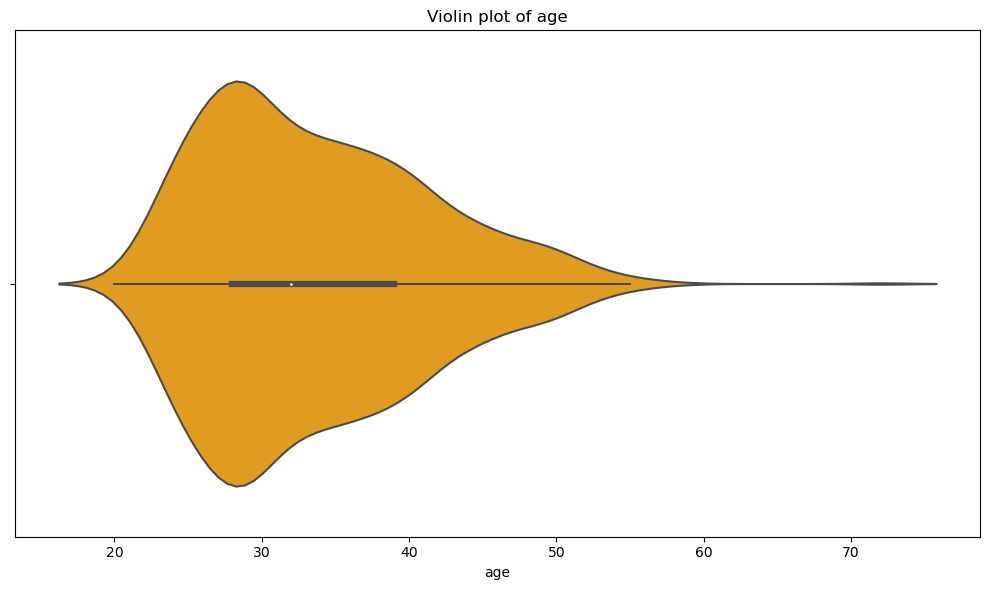

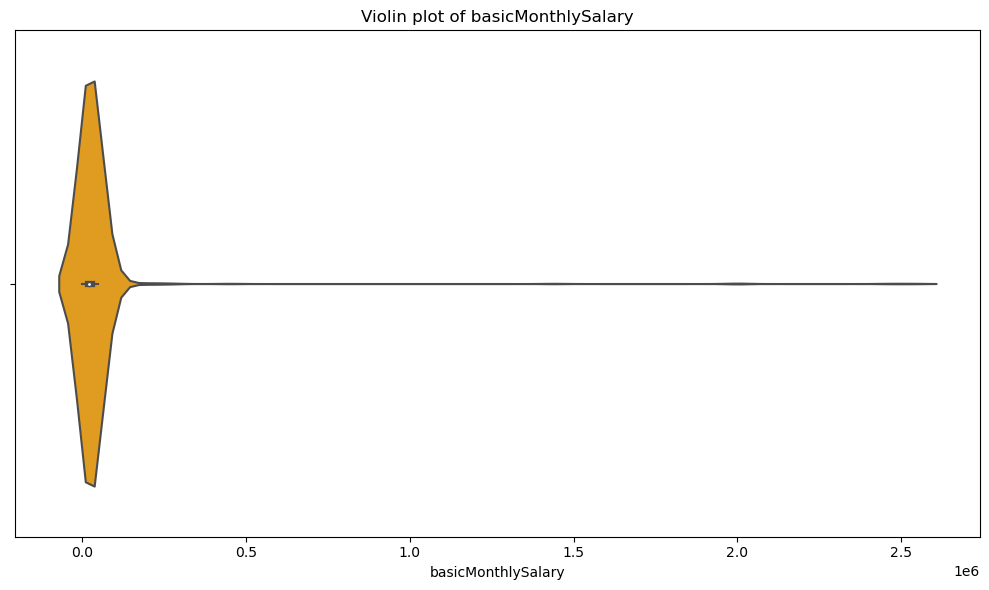

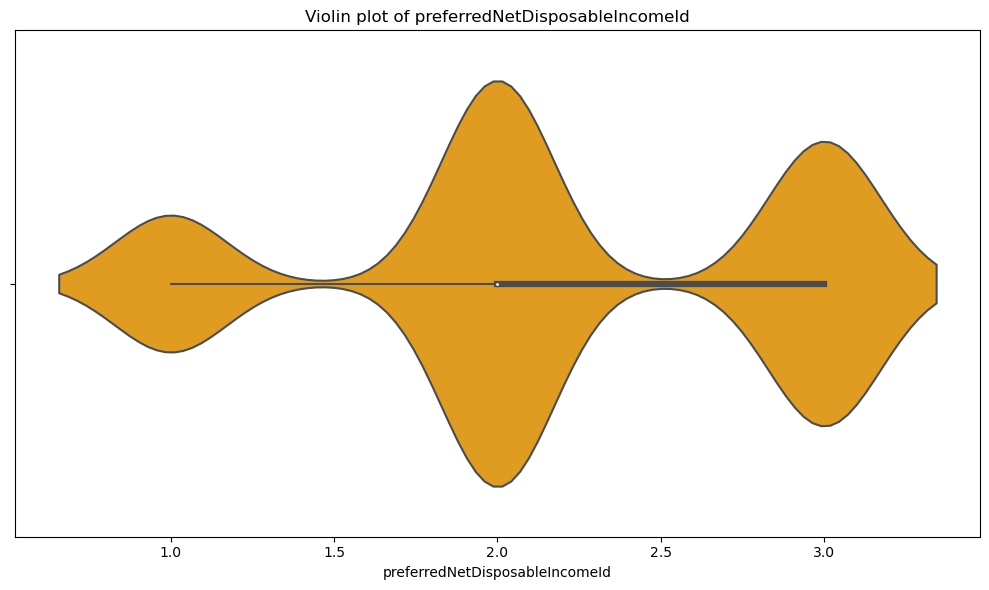

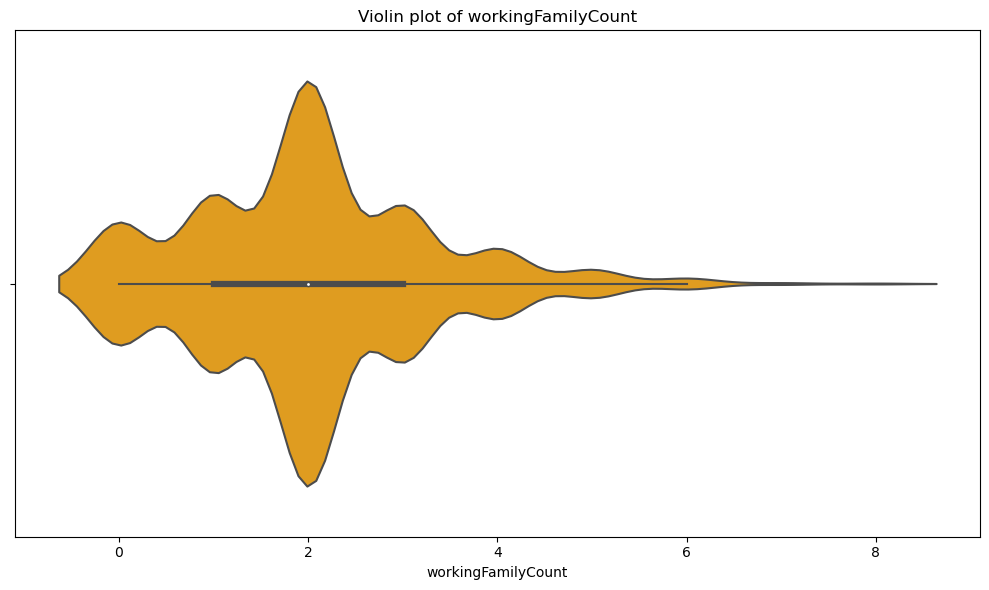

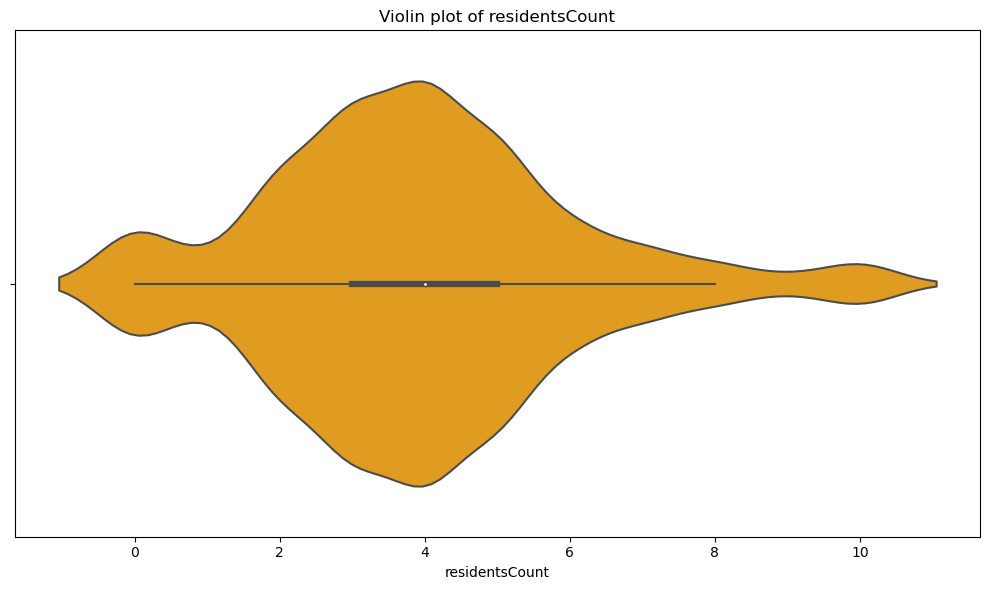

...

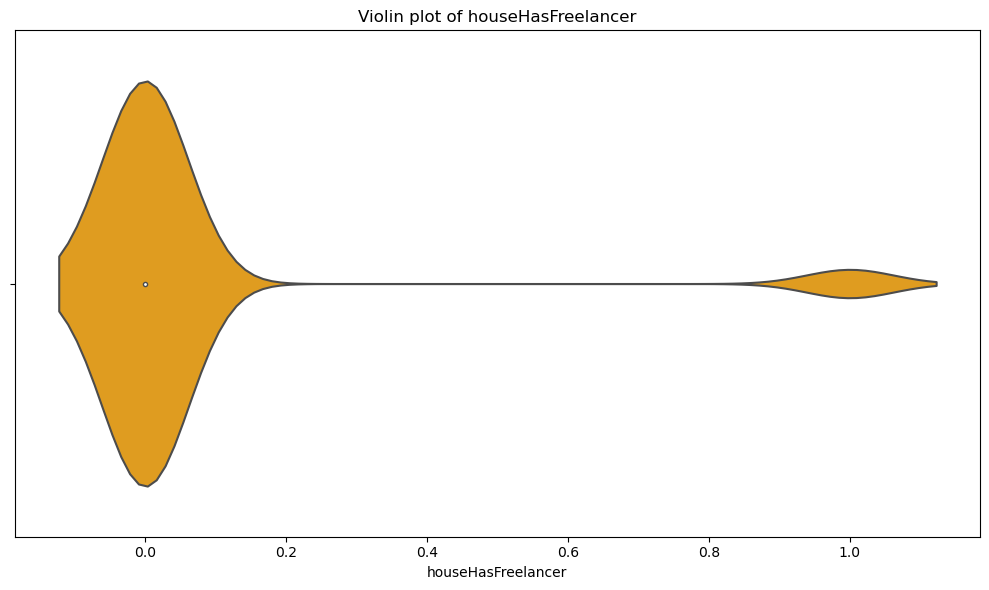

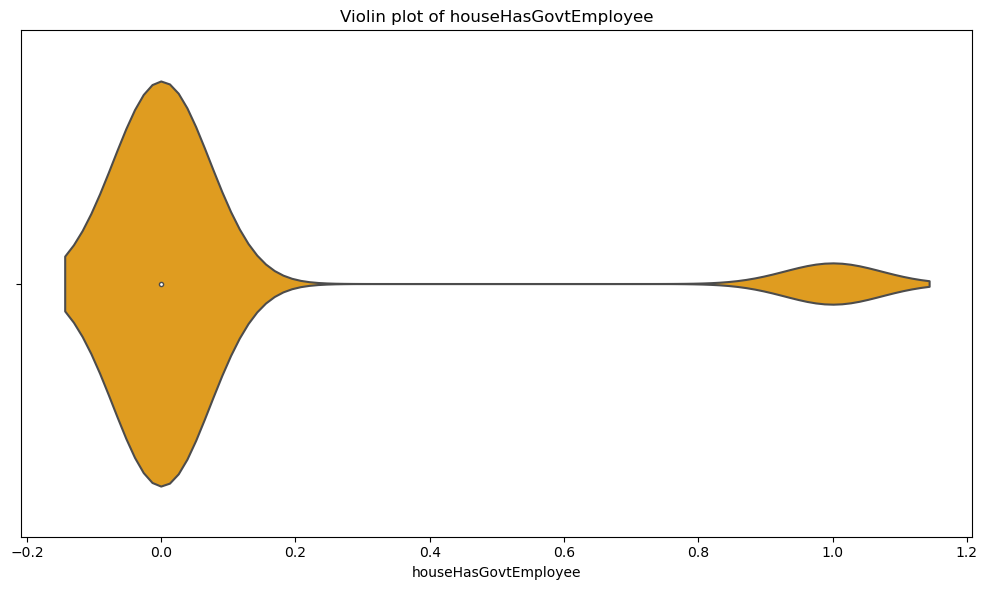

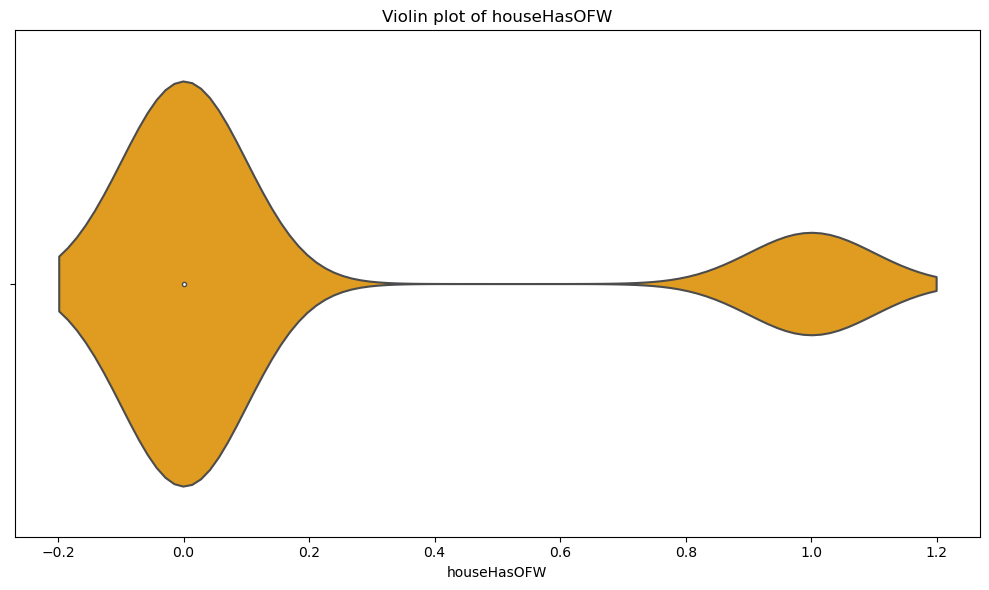

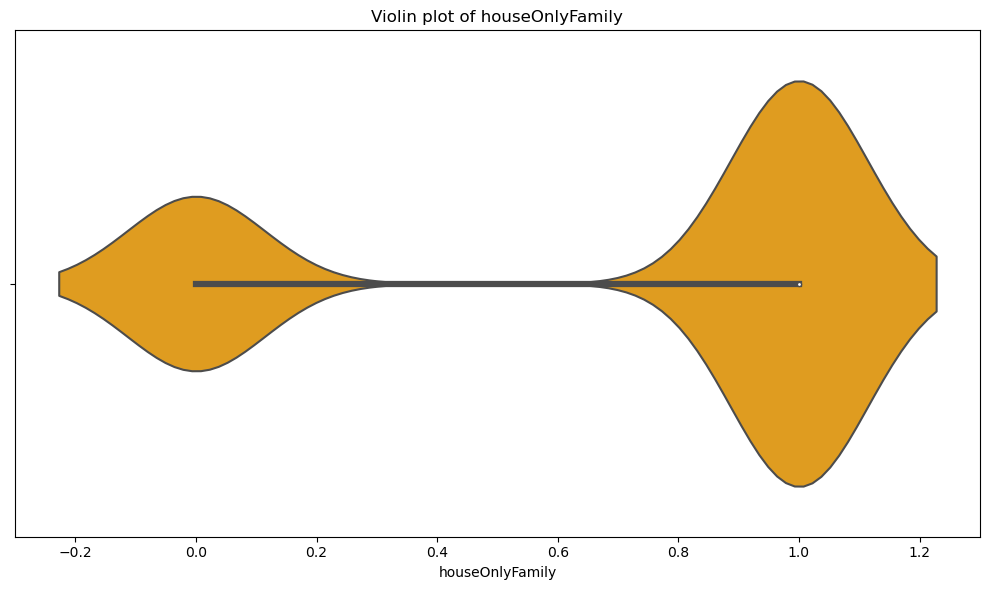

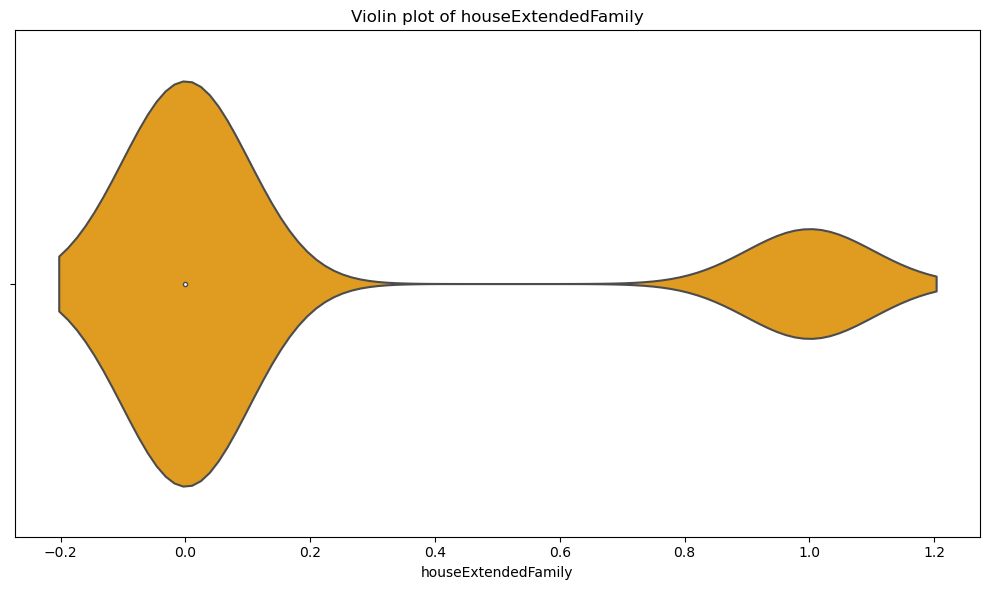

In [435]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming 'df' is your dataframe
df = ho_t01.drop(columns=['userId', 'lastFirstName', 'home_ownership_class', 'gender', 'job', 'province'])
features = df.columns

for feature in features:
    plt.figure(figsize=(10, 6))
    sns.violinplot(x=df[feature], color='orange')
    plt.title('Violin plot of {}'.format(feature))
    plt.tight_layout()
    plt.show()


In [8]:
1/(1+np.exp(-1*0.0101408446))

0.5025351894241549